## Cluster Distribution

Total clusters: 40
Cluster 0: 181 images
Cluster 1: 1496 images
Cluster 2: 19 images
Cluster 3: 43 images
Cluster 4: 14 images
Cluster 5: 28 images
Cluster 6: 13 images
Cluster 7: 5 images
Cluster 8: 90 images
Cluster 9: 8 images
Cluster 10: 8 images
Cluster 11: 5 images
Cluster 12: 22 images
Cluster 13: 5 images
Cluster 14: 8 images
Cluster 15: 6 images
Cluster 16: 5 images
Cluster 17: 8 images
Cluster 18: 6 images
Cluster 19: 21 images
Cluster 20: 10 images
Cluster 21: 5 images
Cluster 22: 8 images
Cluster 23: 5 images
Cluster 24: 6 images
Cluster 25: 5 images
Cluster 26: 5 images
Cluster 27: 5 images
Cluster 28: 5 images
Cluster 29: 5 images
Cluster 30: 5 images
Cluster 31: 5 images
Cluster 32: 5 images
Cluster 33: 5 images
Cluster 34: 8 images
Cluster 35: 4 images
Cluster 36: 6 images
Cluster 37: 5 images
Cluster 38: 5 images
Cluster 39: 5 images


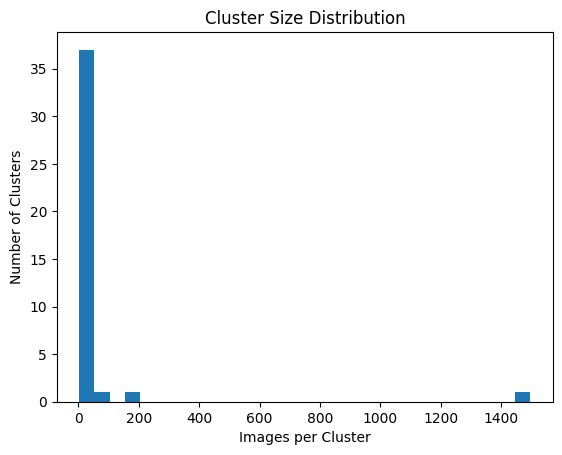

In [1]:
import json
from collections import Counter
import matplotlib.pyplot as plt

img_cluster_file_path = "/home/xiang_fang1/Desktop/meme/icwsm2021-memes-chans/icwsm2021-memes-chans/imgs-diffs.clusters"
clusters = []

with open(img_cluster_file_path, "r") as f:
    for line in f:
        if line.strip():
            clusters.append(json.loads(line))

print(f"Total clusters: {len(clusters)}")
for c in clusters:
    print(f"Cluster {c['cluster_no']}: {len(c['images'])} images")

sizes = [len(c["images"]) for c in clusters]
plt.hist(sizes, bins=30)
plt.xlabel("Images per Cluster")
plt.ylabel("Number of Clusters")
plt.title("Cluster Size Distribution")
plt.show()


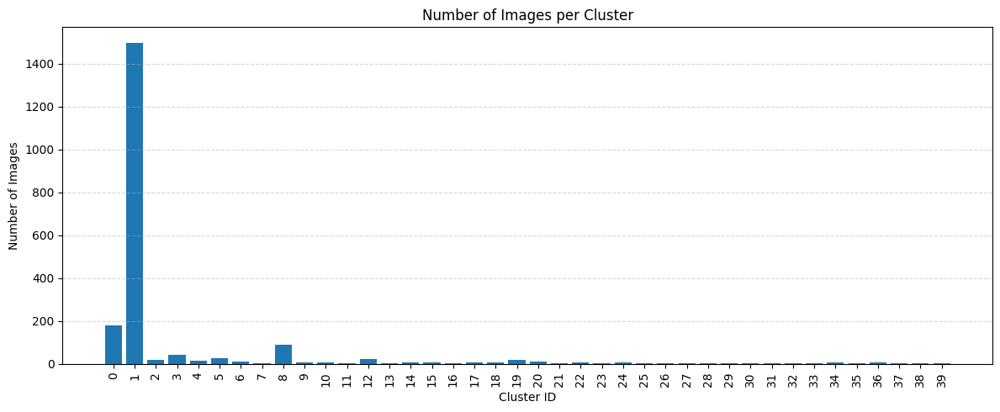

In [2]:
# X: cluster IDs, Y: number of images in each cluster
cluster_ids = [c["cluster_no"] for c in clusters]
cluster_sizes = [len(c["images"]) for c in clusters]

plt.figure(figsize=(12, 5))
plt.bar(cluster_ids, cluster_sizes)

plt.xlabel("Cluster ID")
plt.ylabel("Number of Images")
plt.title("Number of Images per Cluster")
plt.xticks(cluster_ids, rotation=90)  # show all cluster ids if many
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

## Sample per Cluster

In [3]:
clusters

[{'cluster_no': 0,
  'images': ['fb1079792adfcbefaa14248df880e32f79025939a024f6a7df0c288d76dc99f8',
   'e32b90c271e9439d462fae2b04e131309b1b96628a74c9301e39e0d93f408950',
   '24821be57b2a2a177a4d775aaf913fe2ab6aa39216633f087e479e2b4a953939',
   '08ebed4f1875b4b415ab1f45d0ee7b03e67ba591da478512421d8b60671d2245',
   '44bbc04aab61ccbc5b3e8c8805741e8eacab7a3cc3e2f05aa193be9e22c3f8e8',
   'cfd95038c3da9c5723790836128f9b314a0be8b881d7ad00acd428fc46a04664',
   '50ef788e2b9dd01d999a9949e958daf0e07601e7211f6541dfa284dc472dc8df',
   'dc6dd79fc81a2748dcb7262264ab4e943307aef87124838acb84d3a6ff6149c5',
   '9fc6ed3a614a98190447d9ea8c6a6a0aa9f9c455c7b1db53993276c320bac61f',
   '3ed1597a400965c0f3c145f02e9b082a6addb9df5faed34449bd520da05e5359',
   '724b35b47d3512439f0a7cf1a4752f01558463f71c46663c88d996003c39f71a',
   '719df8c7ba1e50f851d0c8b47b459d867d3de8126f6ef15f0aabcf29ab9b89f4',
   'b30a07853b9e5f9c34339fb2bdcc58f63e6b4842d6dd736ab495362bc2e6777a',
   '842b99dfbc5202c426702b68266f003386c349ab5245

In [4]:
import random

sampled_per_cluster = {
    c["cluster_no"]: random.sample(c["images"], min(5, len(c["images"])))
    for c in clusters
}

for cluster_id, samples in sampled_per_cluster.items():
    medoid_hash = clusters[cluster_id]['medoid_hash']
    if medoid_hash not in samples:
        sampled_per_cluster[cluster_id].append(medoid_hash)

In [5]:
sampled_per_cluster

{0: ['94d6e8321e98cab7691a36c6a4d58fbabb6c52c790784b66ed18f777061435d9',
  'c92a8f831a1cd760516d49a49e5e5c08245cdf84eceda856722660291065a663',
  '620632244952b8239b11bb12e23cc0a687877d9d00797cba0cbbd90cfd147a1f',
  'e9868a57d1434e263e8e79d1df247c9a0dd20ac2293e5c53ba9dd4d9e1b91a1d',
  '24821be57b2a2a177a4d775aaf913fe2ab6aa39216633f087e479e2b4a953939'],
 1: ['adaae615ec0cfbf45032a79cb5dfaea853c43c146386d8de277ca34e761fe6b3',
  '99f65efe1f7e640413bb1fba8a0cf001c801442890dade526f761e82694be599',
  '2077450afb9c4799fb75b81ed37564d7d24955bf88a7e11dbf85d126342b50b3',
  'f8e6721a65ba0832aeb85df273373d6b4d573316425142810e2851915df6f8e8',
  'e66524db622c102bdd91337064add662a7420f9d05d6d2231cd80b94c004a8ce',
  '1a88420792ab176a5a67ae1e30096b33e577b4041dfb19da06cebad4e3bbe2af'],
 2: ['897c55e61edd6f70b7332132087073cd5aa6a58de42794171e2f94942f147fbf',
  '032db4be448b9b1375198a84ace4b0c776dd941b9e3af48a819594d1ebdf0d07',
  '4309f2ceb750e9e36bd032216a038fb9f11f0d90f21c64d323f15100a85f4904',
  'c3d618

## Sample Imgs

In [6]:
import json
import csv


metadata_hash_path = "/home/xiang_fang1/Desktop/meme/icwsm2021-memes-chans/icwsm2021-memes-chans/metadata_hashes.json"

with open(metadata_hash_path, "r") as f:
    metadata_hash = json.load(f)


In [7]:
metadata_hash.keys()

dict_keys(['md5', 'sha256', 'pHash'])

In [8]:
metadata_hash["sha256"]

{'c528464287d0af3b68bda530b9fbe8c4a5d6cd2e92664dc06ae9b2ba111331a2': {'sha256': 'c528464287d0af3b68bda530b9fbe8c4a5d6cd2e92664dc06ae9b2ba111331a2',
  'md5': '88ba80858f5a6ca5c0cc835a5822055e',
  'pHash': '882d7ced028f1d3e',
  'ftype': 'JPEG image data, JFIF standard 1.02, resolution (DPI), density 72x72, segment length 16, comment: "File written by Adobe Photoshop\\250 4.0", progressive, precision 8, 480x352, frames 3',
  'path': 'output/images/c528464287d0af3b68bda530b9fbe8c4a5d6cd2e92664dc06ae9b2ba111331a2.gz'},
 '9dbf01255af84d1d36ecd48c536dfb5b56b7c30a0eb182cfb3818362637bda10': {'sha256': '9dbf01255af84d1d36ecd48c536dfb5b56b7c30a0eb182cfb3818362637bda10',
  'md5': '948b3da88e4d6befb5b5d18f860a56f7',
  'pHash': 'd0eb1f433426ce3c',
  'ftype': 'JPEG image data, JFIF standard 1.02, resolution (DPI), density 72x72, segment length 16, Exif Standard: [TIFF image data, big-endian, direntries=5, description=Bourdon, Sebastien; The Judgement of Midas; National Trust, Kingston Lacy; http://ww

In [9]:
len(metadata_hash["sha256"])

124052

In [10]:
folder_prefix = "/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images"

with open("sampled_images.csv", "w", newline='') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(["sha256_hash", "cluster_id", "image_path", "is_radical", "notes"])

    for cluster_id, sha_list in sampled_per_cluster.items():
        for sha in sha_list:
            path = metadata_hash["sha256"].get(sha, {}).get("path")
            if path: # some sha256 is not found in the data folder
                writer.writerow([sha, cluster_id, f"{folder_prefix}/{path}", "", ""])

## Mannually labeling imgs in CSV

In [13]:
import gzip
from PIL import Image
from IPython.display import display, clear_output
import io
import pandas as pd


In [14]:
# df = pd.read_csv("sampled_images.csv")

# # Only label rows without existing label
# unlabeled = df[df['is_radical'].isna() | (df['is_radical'] == '')].copy()

# # Start labeling
# for idx, row in unlabeled.iterrows():
#     clear_output(wait=True)

#     sha = row["sha256_hash"]
#     cid = row["cluster_id"]
#     gz_path = row["image_path"]

#     print(f"\nCluster: {cid} | SHA256: {sha}")
#     print(f"Path: {gz_path}")

#     # Open and display gzipped image on-the-fly
#     try:
#         with gzip.open(gz_path, "rb") as f:
#             img = Image.open(io.BytesIO(f.read()))
#             display(img)
#     except Exception as e:
#         print(f"[Failed to load image: {gz_path}]\n{e}")
#         continue

#     # Input label
#     label = input("Label as [r]adical / [n]on-radical / [s]kip: ").strip().lower()

#     if label == 'r':
#         df.loc[idx, "is_radical"] = "radical"
#     elif label == 'n':
#         df.loc[idx, "is_radical"] = "non-radical"
#     elif label == 's':
#         continue
#     else:
#         print("Invalid input. Skipped.")
#         continue

#     # Optional notes
#     # note = input("Notes (ENTER to skip): ").strip()
#     # df.loc[idx, "notes"] = note

#     # Save progress
#     df.to_csv("sampled_images_labeled.csv", index=False)


In [15]:
def plot_radical_nonradical_images_grid(csv_path, n_rows=3, n_cols=5, figsize=(15, 9), radical=True):
    """
    Plots a grid of images labeled as 'radical' in the CSV.
    Supports .gz-compressed JPEG files.
    
    Args:
        csv_path (str): Path to the labeled CSV.
        n_rows (int): Number of rows in the grid.
        n_cols (int): Number of columns in the grid.
        figsize (tuple): Size of the figure.
    """
    df = pd.read_csv(csv_path)
    if radical:
        df_selected = df[df["is_radical"] == "radical"]
    else:
        df_selected = df[df["is_radical"] == "non-radical"]

    images = df_selected["image_path"].tolist()[:n_rows * n_cols]

    fig, axes = plt.subplots(n_rows, n_cols, figsize=figsize)
    axes = axes.flatten()

    for i, img_path in enumerate(images):
        ax = axes[i]
        try:
            with gzip.open(img_path, 'rb') as f:
                img = Image.open(io.BytesIO(f.read()))
                ax.imshow(img)
                ax.set_title(f"#{i+1}")
        except Exception as e:
            ax.text(0.5, 0.5, "Error", ha='center', va='center')
            print(f"Failed to load {img_path}: {e}")
        ax.axis("off")

    # Turn off extra axes if any
    for i in range(len(images), len(axes)):
        axes[i].axis("off")

    plt.tight_layout()
    plt.show()

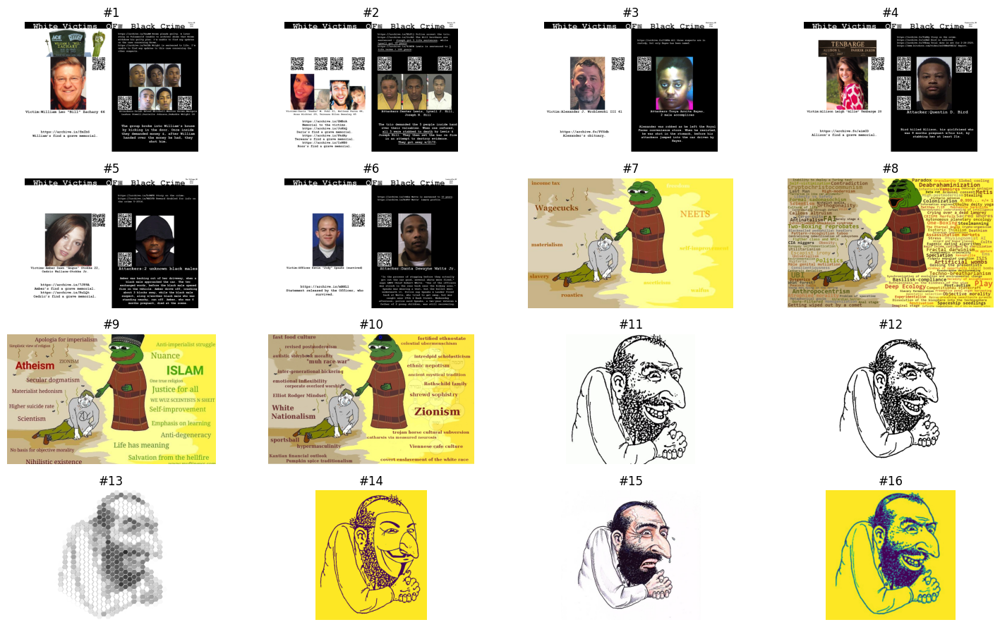

In [16]:
plot_radical_nonradical_images_grid("sampled_images_labeled.csv", n_rows=4, n_cols=4)

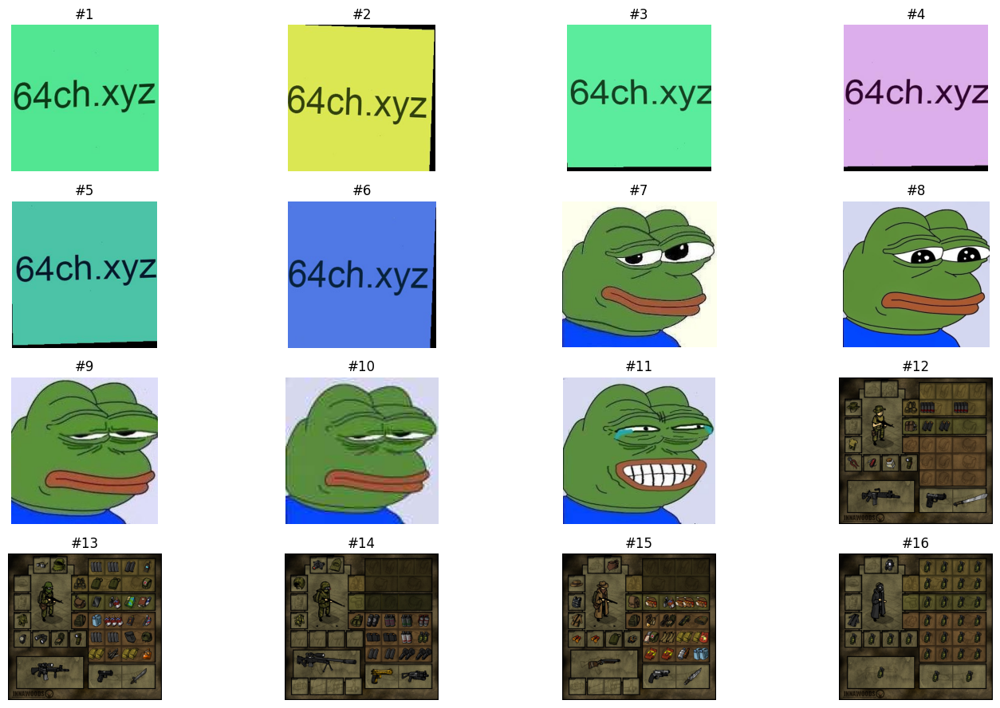

In [17]:
plot_radical_nonradical_images_grid("sampled_images_labeled.csv", n_rows=4, n_cols=4, radical=False)

In [18]:
import base64
from IPython.display import display, HTML


def show_radical_imgs(csv_path):
    df = pd.read_csv(csv_path)
    df_selected = df[df["is_radical"] == "radical"]

    for i, row in df_selected.iterrows():
        img_path = row["image_path"]
        sha_id = row["sha256_hash"] if "sha256_hash" in row else img_path  # fallback to path if hash missing

        try:
            with gzip.open(img_path, 'rb') as f:
                img = Image.open(io.BytesIO(f.read())).convert("RGB")
                buffer = io.BytesIO()
                img.thumbnail((300, 300))
                img.save(buffer, format="JPEG")
                img_base64 = base64.b64encode(buffer.getvalue()).decode()

                html = f"""
                <div style='margin-bottom: 20px;'>
                    <strong>SHA256 ID:</strong> {sha_id}<br>
                    <img src="data:image/jpeg;base64,{img_base64}" style="border:1px solid #ccc; margin-top:5px;">
                </div>
                """
                display(HTML(html))

        except Exception as e:
            print(f"[Error loading {img_path}]\n{e}")


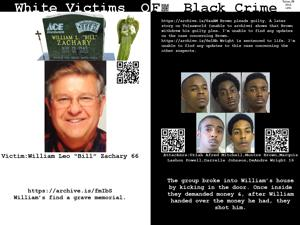


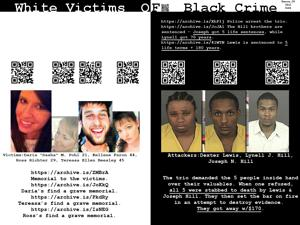


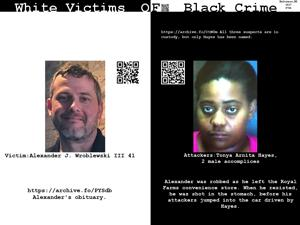


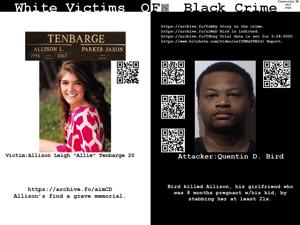


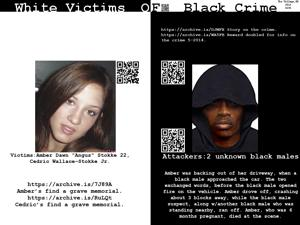


...


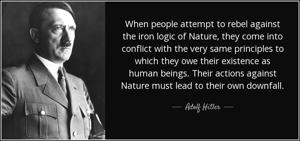


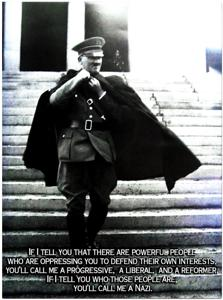


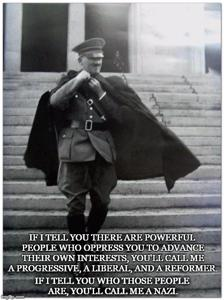


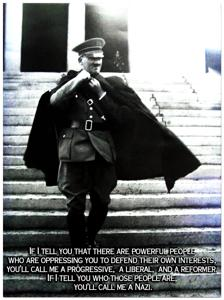


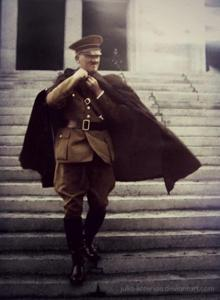

In [19]:
show_radical_imgs("sampled_images_labeled.csv")

## Semi-Supervised Learning

In [20]:
metadata_hash["sha256"]

{'c528464287d0af3b68bda530b9fbe8c4a5d6cd2e92664dc06ae9b2ba111331a2': {'sha256': 'c528464287d0af3b68bda530b9fbe8c4a5d6cd2e92664dc06ae9b2ba111331a2',
  'md5': '88ba80858f5a6ca5c0cc835a5822055e',
  'pHash': '882d7ced028f1d3e',
  'ftype': 'JPEG image data, JFIF standard 1.02, resolution (DPI), density 72x72, segment length 16, comment: "File written by Adobe Photoshop\\250 4.0", progressive, precision 8, 480x352, frames 3',
  'path': 'output/images/c528464287d0af3b68bda530b9fbe8c4a5d6cd2e92664dc06ae9b2ba111331a2.gz'},
 '9dbf01255af84d1d36ecd48c536dfb5b56b7c30a0eb182cfb3818362637bda10': {'sha256': '9dbf01255af84d1d36ecd48c536dfb5b56b7c30a0eb182cfb3818362637bda10',
  'md5': '948b3da88e4d6befb5b5d18f860a56f7',
  'pHash': 'd0eb1f433426ce3c',
  'ftype': 'JPEG image data, JFIF standard 1.02, resolution (DPI), density 72x72, segment length 16, Exif Standard: [TIFF image data, big-endian, direntries=5, description=Bourdon, Sebastien; The Judgement of Midas; National Trust, Kingston Lacy; http://ww

In [21]:
img_sha_list = list(metadata_hash["sha256"].keys())
df_manually_labeld = pd.read_csv("sampled_images_labeled.csv")
img_sha_list_labeled = list(df_manually_labeld['sha256_hash'])

filter_img_sha_list = [sha for sha in img_sha_list if sha not in img_sha_list_labeled]

In [22]:
filter_img_sha_list

['c528464287d0af3b68bda530b9fbe8c4a5d6cd2e92664dc06ae9b2ba111331a2',
 '9dbf01255af84d1d36ecd48c536dfb5b56b7c30a0eb182cfb3818362637bda10',
 '535e21e532f18e715612253c764cffd6494f2779d8f003181acffbc0577f599a',
 'ea1cbbb65081cad2c65b83c3443f5a7c3924228768d6b6794b3cc84f9241c79a',
 '02888c770a08b8340f366f64118f5fbdc4b7217c111e6af392033539f5989e43',
 '1f8cc3b3be1f63687d0de50b904919939bed8f7065b6389edaa12a48ea88c23a',
 'b01d9d72a611fb2ef68376db722adc63197bfead00b7a472c5a7c4cd98c391bb',
 '292dee6ba477d87d40bd3d5a10322bfff3d81695893b1971f30e41ca1ac5f080',
 '83990bbb6bcff6b47da175fb4b294b27152ff1203d7226b0dc4f81c3f3a9d6a5',
 'a4d27844ef31d41e91a05a02f330ee4690766d3ebc7aaeffa22e0ea5bafa607d',
 '23e3359c97003a3dabb493c2e9986a31477be95712d65200bce956e925d62fe8',
 'bddea791fdb7026d260cc389e54d09d8d783e3a6992cb2cd281cac9c91edf654',
 '8996a32c9ec1228544232119318facccfd04b84def0f815363c286db2f922ac9',
 '39b4c84700fefa1d7b1529c7030931f53abea6c49b5e17b57200a9f993e12298',
 '95e2d5e650bcba37d0fd1c45db237b5a

In [23]:
import random

folder_prefix = "/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images"


img_sha_list_2000 = random.sample(filter_img_sha_list, 2000)
df_2000 =pd.DataFrame({'sha256_hash':img_sha_list_2000, 
                       "img_path":[f'{folder_prefix}/{sha}.gz' for sha in img_sha_list_2000],
                       "is_radical":["" for _ in img_sha_list_2000]
                       })

In [24]:
df_2000

,sha256_hash,img_path,is_radical
0,475a60e0bd9b497d4482adef0647c31edea8a58a8a3e4c...,/home/xiang_fang1/Desktop/meme/icwsm2021-memes...,
1,78309b02a4e0ad28e78feaffc047357b72980ccaf4cd8b...,/home/xiang_fang1/Desktop/meme/icwsm2021-memes...,
2,bc4f59bf7f6587fa1fef4009b37e1d83e0acaebea1e393...,/home/xiang_fang1/Desktop/meme/icwsm2021-memes...,
3,ffce711a11d1338ad4df4a24b0f9dbc30bc76d90cbc44d...,/home/xiang_fang1/Desktop/meme/icwsm2021-memes...,
4,425494b9975aae4550206d6dc6e2db442bc9f1f8b1765a...,/home/xiang_fang1/Desktop/meme/icwsm2021-memes...,
...,...,...,...
1995,7ff23b3c7e5b026b097cce5d1775edf07a2e5f162c3552...,/home/xiang_fang1/Desktop/meme/icwsm2021-memes...,
1996,95a0d1b32445023572433af40640c611c725717f6c6a3b...,/home/xiang_fang1/Desktop/meme/icwsm2021-memes...,
1997,275131eeb8c378431f0fd8a53c4997ca5a4bfcdca4a281...,/home/xiang_fang1/Desktop/meme/icwsm2021-memes...,
1998,3c40a5bb4e544d71e17ea98e8a2bdfd3e49aebe8501604...,/home/xiang_fang1/Desktop/meme/icwsm2021-memes...,


In [25]:
df_2000.to_csv("unlabeled_2000.csv", index=False)

In [26]:
selected_fewshot_radical_images_hashes = ['421770e99afe9e12db91eef1b156d8df41016cfaa0cb51e34a9360a54ce5e76d',
                                          '629439035092ebd8f2afa77d243031ec0af9664e78b0a4afc3db65acbc83a3b8',
                                          '44d51e2b1d38bd59b0fdbc9da4790748afd2a7783ec13689df6eb7802170aeef',
                                          '5b205ffd9969785bc9e1a149c7473023154db5b080797b116c89fc8dc4d5502f',
                                          '68adca644b9a2b0329f40c35333610e2f9a0922dbf8f55b5165768d8173c86d2']
selected_fewshot_radical_images_df = pd.DataFrame({"sha256_hash":selected_fewshot_radical_images_hashes,
                                                   "image_path":[f'{folder_prefix}/{sha}.gz' for sha in selected_fewshot_radical_images_hashes],
                                                   "is_radical": ["radical" for sha in selected_fewshot_radical_images_hashes]})
selected_fewshot_radical_images_df.to_csv("few_shot_examples.csv", index=False)

In [79]:
import gzip
import io
import base64
from PIL import Image
import pandas as pd
import ollama
import os
import re


def load_image_base64(gz_path):
    try:
        with gzip.open(gz_path, "rb") as f:
            img = Image.open(io.BytesIO(f.read())).convert("RGB")
            buffer = io.BytesIO()
            img.save(buffer, format="JPEG")
            return base64.b64encode(buffer.getvalue()).decode()
    except Exception as e:
        print(f"[Image error: {gz_path}]\n{e}")
        return None

def classify_with_explanation(few_shot_df, target_path, model="mistral-small3.1:24b"):
    prompt = (
        "You are a vision-language model trained to detect radical content in memes.\n"
        "You should be accurate, any type of radical you detecetd especially extremism: Radically different ideas about society and governance. Pursuing their extremist aims byviolent means."
        "Also you should need to identify the text in the image if there are texts before falling to the image content"
        "You will be shown 6 images:\n"
        "- The first 5 are labeled (either 'radical' or 'non-radical')\n"
        "- The 6th is unlabeled\n\n"
        "Your task:\n"
        "1. Predict whether the 6th image is radical or not\n"
        "2. Provide a short explanation for your prediction\n"
        "3. Estimate the radical probability between 0.0 and 1.0\n\n"
        "Respond in this JSON format:\n"
        "{\n"
        "  \"is_radical\": \"radical\" or \"non-radical\",\n"
        "  \"reason\": \"...\",\n"
        "  \"radical_prob\": float between 0 and 1\n"
        "}\n\n"
        "Please be NOTICE that the first 5 images are just reference for you to judge, it is not your image to classify"
        "Labeled examples:\n"
    )

    image_list = []

    for i, row in enumerate(few_shot_df.itertuples(), 1):
        img_b64 = load_image_base64(row.image_path)
        if img_b64:
            image_list.append(img_b64)
            prompt += f"Image {i}: {row.is_radical}\n"

    # Add target image
    img_b64 = load_image_base64(target_path)
    if img_b64:
        image_list.append(img_b64)
        prompt += "\nImage 6: Please classify this image."

    else:
        print("Failed to load target image.")
        return {"is_radical": "error", "reason": "Failed to load image", "radical_prob": 0.0}

    # print(prompt)
    # Send to Ollama
    try:
        response = ollama.generate(
            model=model,
            prompt=prompt,
            images=image_list,
            stream=False
        )
        # print(response["response"])
        json_match = re.search(r"```(?:json)?\s*(\{.*?\})\s*```", response['response'].strip(), re.DOTALL)

        if json_match:
            try:
                result = json.loads(json_match.group(1))
            except Exception as e:
                result = {"is_radical": "error", "reason": f"JSON decode error: {e}", "radical_prob": 0.0}
        else:
            result = {"is_radical": "error", "reason": "No JSON found in response", "radical_prob": 0.0}

        return {
                "is_radical": result.get("is_radical", "unknown"),
                "reason": result.get("reason", ""),
                "radical_prob": float(result.get("radical_prob", 0.0))
            }
    except Exception as e:
        return {"is_radical": "error", "reason": str(e), "radical_prob": 0.0}


In [28]:
def show_random_gz_image(folder_path, ext=".gz"):
    # List all matching files
    all_files = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith(ext)]
    
    if not all_files:
        print("No .jpg.gz files found.")
        return None

    # Randomly select
    chosen_file = random.choice(all_files)
    print(f"Selected file: {chosen_file}")

    try:
        with gzip.open(chosen_file, 'rb') as f:
            img = Image.open(io.BytesIO(f.read())).convert("RGB")
            display(img)
    except Exception as e:
        print(f"Failed to load image: {chosen_file}\n{e}")
        return None

    return chosen_file

Selected file: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a29606c5df26eb8ad297cca9258c6206ecbf4c54a443cfab7d7871109a7d9821.gz


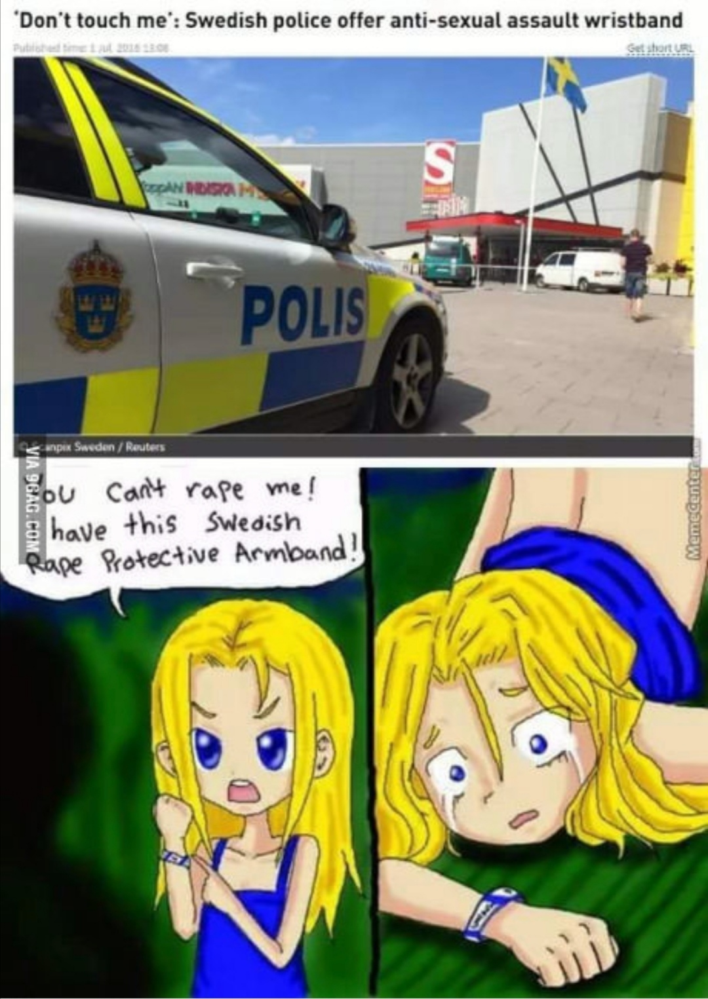

'/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a29606c5df26eb8ad297cca9258c6206ecbf4c54a443cfab7d7871109a7d9821.gz'

In [108]:
show_random_gz_image(folder_prefix)

In [29]:
import os
os.environ.pop("CUDA_VISIBLE_DEVICES", None)

In [30]:
import torch
print(torch.cuda.is_available())

True


In [31]:
import requests

try:
    res = requests.get("http://localhost:11434")
    print("✅ Ollama server is running.")
except requests.exceptions.ConnectionError:
    print("❌ Ollama server is not running.")

✅ Ollama server is running.


In [80]:
few_shot_df = pd.read_csv("few_shot_examples.csv")
target_img_path = f"{folder_prefix}/a29606c5df26eb8ad297cca9258c6206ecbf4c54a443cfab7d7871109a7d9821.gz"

result = classify_with_explanation(few_shot_df, target_img_path)
print(result)

{'is_radical': 'radical', 'reason': "The image contains a police car with the word 'POLIS' on it, indicating a Swedish context. The text mentions 'Swedish police offer anti-sexual assault wristband,' which is a real initiative but is being used in a meme to mock or trivialise the issue of sexual assault. The meme features an anime-style character claiming that wearing the wristband will prevent rape, which is a highly insensitive and radical interpretation of the initiative. The combination of mockery and trivialization of a serious issue like sexual assault indicates a radical stance.", 'radical_prob': 0.85}


In [69]:
def display_classified_result(sha_id, img_path, reason, radical_prob):
    try:
        with gzip.open(img_path, 'rb') as f:
            img = Image.open(io.BytesIO(f.read())).convert("RGB")
            buffer = io.BytesIO()
            img.thumbnail((500, 500))
            img.save(buffer, format="JPEG")
            img_base64 = base64.b64encode(buffer.getvalue()).decode()

            html = f"""
            <div style='margin-bottom: 25px; padding:10px; border:1px solid #ccc; border-radius:6px; background:#f9f9f9; color: black;'>
                <strong>SHA256 ID:</strong> {sha_id}<br>
                <strong>Radical Probability:</strong> {radical_prob:.2f}<br>
                <strong>Reason:</strong> {reason}<br>
                <img src="data:image/jpeg;base64,{img_base64}" style="margin-top:10px; border:1px solid #aaa; max-width:100%;">
            </div>
            """
            display(HTML(html))

    except Exception as e:
        print(f"[Error loading {img_path}]\n{e}")


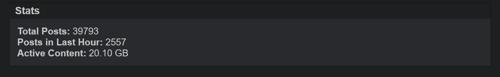

In [75]:
display_classified_result('e93e2fc942bee1eea718b612981d0a30095982b663a5033574c34b63bf80b6d6',f'{folder_prefix}/2ea4b05a664dd123bf4c3c8f09a57160b7fbb485a456b3d44fba1d3df324bfb2.gz','test', 0)

[1/2000] 475a60e0bd9b497d4482adef0647c31edea8a58a8a3e4c8ae6148c07fcf920b1
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/475a60e0bd9b497d4482adef0647c31edea8a58a8a3e4c8ae6148c07fcf920b1.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/475a60e0bd9b497d4482adef0647c31edea8a58a8a3e4c8ae6148c07fcf920b1.gz'
Failed to load target image.
[2/2000] 78309b02a4e0ad28e78feaffc047357b72980ccaf4cd8bbc0f128f27942564dc
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/78309b02a4e0ad28e78feaffc047357b72980ccaf4cd8bbc0f128f27942564dc.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/78309b02a4e0ad28e78feaffc047357b72980ccaf4cd8bbc0f128f27942564dc.gz'
Failed to load target image.
[3/2000] bc4f59bf7f6587fa1fef4009b37e1d83e0acaebea1e3931a7958cceb7102f6ee
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/

/tmp/ipykernel_6695/3654818457.py:14: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'error' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  unlabeled_df.loc[i, "is_radical"] = result.get("is_radical")


[6/2000] ebf90d1c8ae6581d22c3a29f33187cf379962810c4d8bcfbee763cc96b655593
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ebf90d1c8ae6581d22c3a29f33187cf379962810c4d8bcfbee763cc96b655593.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ebf90d1c8ae6581d22c3a29f33187cf379962810c4d8bcfbee763cc96b655593.gz'
Failed to load target image.
[7/2000] 31270b00ed92502ede2efc562b5cf7dadf09d21ccff4ffa5e765fe8e55a6634b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/31270b00ed92502ede2efc562b5cf7dadf09d21ccff4ffa5e765fe8e55a6634b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/31270b00ed92502ede2efc562b5cf7dadf09d21ccff4ffa5e765fe8e55a6634b.gz'
Failed to load target image.
[8/2000] e93e2fc942bee1eea718b612981d0a30095982b663a5033574c34b63bf80b6d6



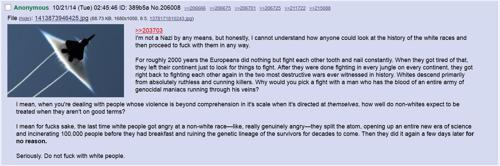

[9/2000] 4f55749a47b45299e31c431674943b4e84c7f7350a5af6a9bebf89d32ae1bdda
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4f55749a47b45299e31c431674943b4e84c7f7350a5af6a9bebf89d32ae1bdda.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4f55749a47b45299e31c431674943b4e84c7f7350a5af6a9bebf89d32ae1bdda.gz'
Failed to load target image.
[10/2000] da1d15fbe6abc965b8a1ae6efcba0bbec4a772072cfe0602271f3698aeab9981



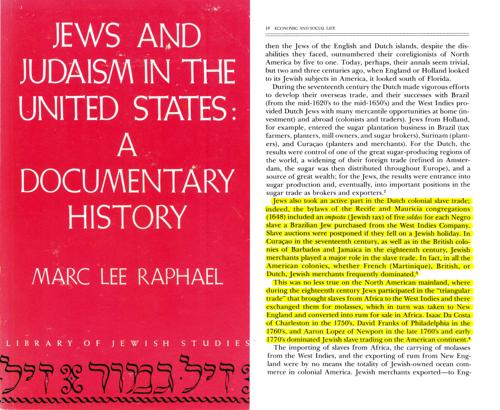

[11/2000] 11825d153ee1bdea1f59298ae18e0f57675a4f63e980c518cf4a737e7c7fd69e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/11825d153ee1bdea1f59298ae18e0f57675a4f63e980c518cf4a737e7c7fd69e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/11825d153ee1bdea1f59298ae18e0f57675a4f63e980c518cf4a737e7c7fd69e.gz'
Failed to load target image.
[12/2000] 5a5b71d7840e81e14714c2714a79b40f218403eaec2015b83eb42f2d61959dc1
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5a5b71d7840e81e14714c2714a79b40f218403eaec2015b83eb42f2d61959dc1.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5a5b71d7840e81e14714c2714a79b40f218403eaec2015b83eb42f2d61959dc1.gz'
Failed to load target image.
[13/2000] 0e3d98fa21c014bf7c376ade16b61dd9396a185a0d43eab82cd04bbf9a67898a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-imag


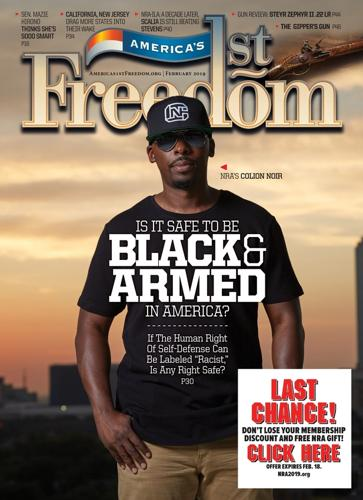

[19/2000] f68ab498ddf4be93dabee1fb538db5b0b44b6ee093c80822ca87b1ba177c5287



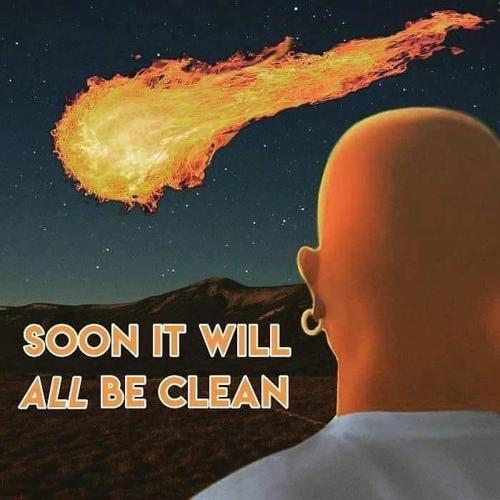

[20/2000] d354acc5cb7b5eed6f93ee81f35945adc2f310c7733ccc4b0f948734ec00fb1d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d354acc5cb7b5eed6f93ee81f35945adc2f310c7733ccc4b0f948734ec00fb1d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d354acc5cb7b5eed6f93ee81f35945adc2f310c7733ccc4b0f948734ec00fb1d.gz'
Failed to load target image.
[21/2000] 2e4f5478a2aab9d2ccf685ba9faa0c252a5e29a95a4529d144fb7a7df5635dff



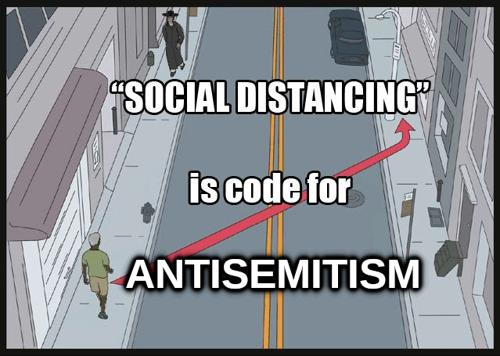

[22/2000] 66af81fa91aeb0038b9d88cc43a5138bb86aa0c6ebec2069c435b075824983eb
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/66af81fa91aeb0038b9d88cc43a5138bb86aa0c6ebec2069c435b075824983eb.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/66af81fa91aeb0038b9d88cc43a5138bb86aa0c6ebec2069c435b075824983eb.gz'
Failed to load target image.
[23/2000] 806fddc31c47edd76bd340f8991c5684bf6ae2d8025fb1096c03340b769c3453
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/806fddc31c47edd76bd340f8991c5684bf6ae2d8025fb1096c03340b769c3453.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/806fddc31c47edd76bd340f8991c5684bf6ae2d8025fb1096c03340b769c3453.gz'
Failed to load target image.
[24/2000] d0c47026d55ed610a9441410fb8ea07d8294f1446a151c1d1e02247eba23d7ca
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-imag


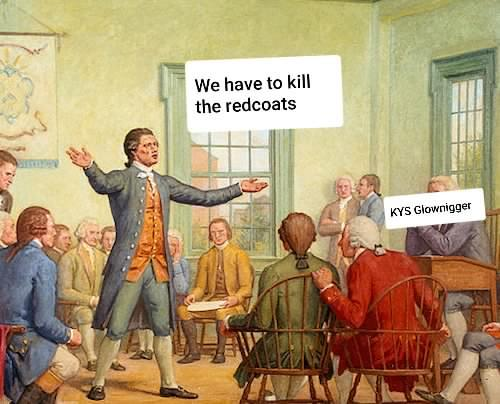

[26/2000] 43c4f2bf239b6dfe5a5fb8efa27a85c0e7925dec3a414fa4440d480a26996d4c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/43c4f2bf239b6dfe5a5fb8efa27a85c0e7925dec3a414fa4440d480a26996d4c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/43c4f2bf239b6dfe5a5fb8efa27a85c0e7925dec3a414fa4440d480a26996d4c.gz'
Failed to load target image.
[27/2000] b468e2f1261fdf285bcfd2376864beaea1175a2b62ed731bb8b3a52c230a8420
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b468e2f1261fdf285bcfd2376864beaea1175a2b62ed731bb8b3a52c230a8420.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b468e2f1261fdf285bcfd2376864beaea1175a2b62ed731bb8b3a52c230a8420.gz'
Failed to load target image.
[28/2000] 40221eb736927aa07507bff4cd1ae0db7f3ee3867846cc6e94d0d9ec0e0ac435



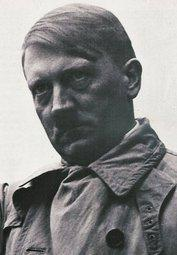

[29/2000] 41d9dd92c456d269353b700841d02fd12715c116f328d5fa01bd9b11a93769e8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/41d9dd92c456d269353b700841d02fd12715c116f328d5fa01bd9b11a93769e8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/41d9dd92c456d269353b700841d02fd12715c116f328d5fa01bd9b11a93769e8.gz'
Failed to load target image.
[30/2000] 75886cd5c4ca98849dff2c11609de53f7acbb044570cba03a3d61d3680c876be
[31/2000] 199ae3c89f15b6f64fea9f4df202d8adc5db7aae593b467373d7b4810a3c3f4e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/199ae3c89f15b6f64fea9f4df202d8adc5db7aae593b467373d7b4810a3c3f4e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/199ae3c89f15b6f64fea9f4df202d8adc5db7aae593b467373d7b4810a3c3f4e.gz'
Failed to load target image.
[32/2000] e2d72cb4e9f5cd9f488e84bfb254a1d808be2a16daee45d2ddace7c


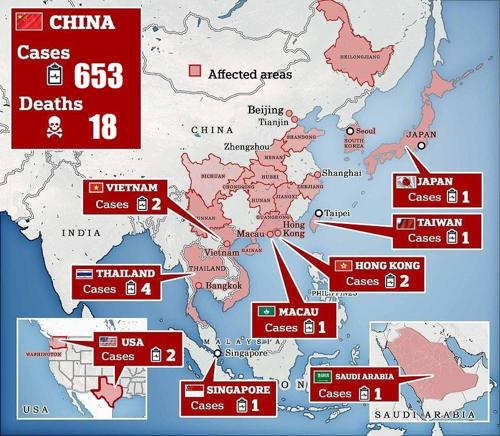

[37/2000] 8eda738680d15abc4b45094d7b269109011224462b96c8ac3e3fe9f61121fe7d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8eda738680d15abc4b45094d7b269109011224462b96c8ac3e3fe9f61121fe7d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8eda738680d15abc4b45094d7b269109011224462b96c8ac3e3fe9f61121fe7d.gz'
Failed to load target image.
[38/2000] 06c84e34fbefc73288000992231234c7a4d070880d348244a67550bdb5682c60
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/06c84e34fbefc73288000992231234c7a4d070880d348244a67550bdb5682c60.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/06c84e34fbefc73288000992231234c7a4d070880d348244a67550bdb5682c60.gz'
Failed to load target image.
[39/2000] b8f744415bec4d01854dd93661792be28879de147f141dba85a9d038bf6a40cb
[40/2000] 5db83186eb925ffacb15562dae78cf51ff34dff936561f309820ace


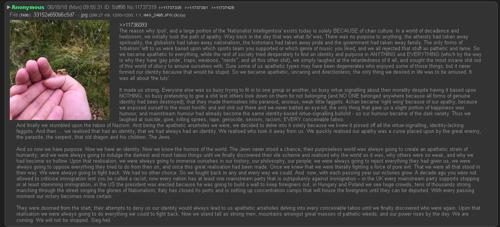

[41/2000] f9e500687d7379217c4806daeca06cc681bf89bde1dab459e939bc8821edc942
[42/2000] fa4f90084079a0610e159effc3383816bca57f3a555082368303f1c026b71b47
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fa4f90084079a0610e159effc3383816bca57f3a555082368303f1c026b71b47.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fa4f90084079a0610e159effc3383816bca57f3a555082368303f1c026b71b47.gz'
Failed to load target image.
[43/2000] 378dfe0a32c4d0ef7a1576d6df218192bbf793d712950782ef472dc8249655da
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/378dfe0a32c4d0ef7a1576d6df218192bbf793d712950782ef472dc8249655da.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/378dfe0a32c4d0ef7a1576d6df218192bbf793d712950782ef472dc8249655da.gz'
Failed to load target image.
[44/2000] 964a90ed714d268e983a863434f57540b137866912b15617d7df563


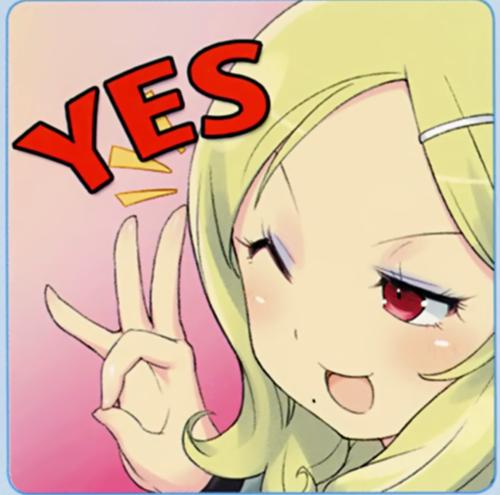

[48/2000] 16f3afdec990eee67ef740474cc08a1e36576ee4ddab5b71f9c9833fe51cc9f2
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/16f3afdec990eee67ef740474cc08a1e36576ee4ddab5b71f9c9833fe51cc9f2.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/16f3afdec990eee67ef740474cc08a1e36576ee4ddab5b71f9c9833fe51cc9f2.gz'
Failed to load target image.
[49/2000] f67229a4144571358abb16020fa3d00c10b679acdc7fd5d4f8f10004d1f5cf1e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f67229a4144571358abb16020fa3d00c10b679acdc7fd5d4f8f10004d1f5cf1e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f67229a4144571358abb16020fa3d00c10b679acdc7fd5d4f8f10004d1f5cf1e.gz'
Failed to load target image.
[50/2000] 4458d6380482be1a3149aab09add1cf64b9b64d9d1366d903f3efcd9cd029785



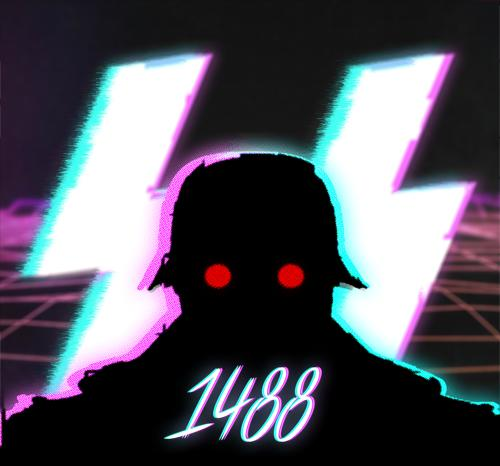

[51/2000] aeeb23b44309d07d4f8d49dfa4bc5f59e7fa5d25d6295a874703b234e5076077
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/aeeb23b44309d07d4f8d49dfa4bc5f59e7fa5d25d6295a874703b234e5076077.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/aeeb23b44309d07d4f8d49dfa4bc5f59e7fa5d25d6295a874703b234e5076077.gz'
Failed to load target image.
[52/2000] f588b3863db4fdf4ee30957482672f4600641dd7ed8e5cd664b24fd43b5567f2
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f588b3863db4fdf4ee30957482672f4600641dd7ed8e5cd664b24fd43b5567f2.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f588b3863db4fdf4ee30957482672f4600641dd7ed8e5cd664b24fd43b5567f2.gz'
Failed to load target image.
[53/2000] b0465fe5f1e2e7fa431658dcfdb9f180c0c145b3f64abca17ff0098ca4da1676
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-imag


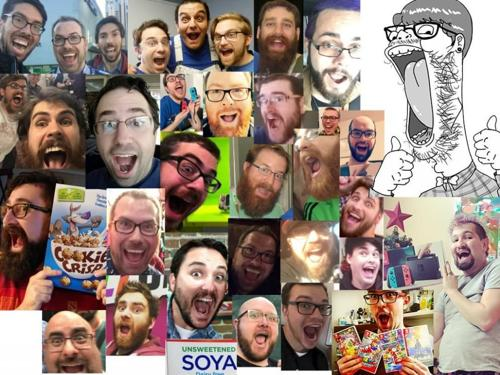

[64/2000] 7eed23ee7ca10b5ddb1e964d3227c96bf3107748a0eafaeca284050c986ccd65
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7eed23ee7ca10b5ddb1e964d3227c96bf3107748a0eafaeca284050c986ccd65.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7eed23ee7ca10b5ddb1e964d3227c96bf3107748a0eafaeca284050c986ccd65.gz'
Failed to load target image.
[65/2000] 808457a690174dbfd373aec3ac8500435149931ce541d20975eb261363fc1a1f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/808457a690174dbfd373aec3ac8500435149931ce541d20975eb261363fc1a1f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/808457a690174dbfd373aec3ac8500435149931ce541d20975eb261363fc1a1f.gz'
Failed to load target image.
[66/2000] a30898331954ad7324ec58bea5410bca88beed94574a92d3cde503b6e41d3282
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-imag


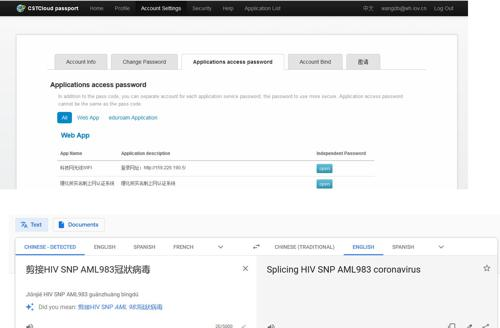

[71/2000] e24348f83af57bb4fa5883953f059351c5077c33404db5c5e23ce1021f533101
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e24348f83af57bb4fa5883953f059351c5077c33404db5c5e23ce1021f533101.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e24348f83af57bb4fa5883953f059351c5077c33404db5c5e23ce1021f533101.gz'
Failed to load target image.
[72/2000] 9e4af5ba551445996112936fbf89bded0013915b2446d48fe0dc2e6aa30535ba
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9e4af5ba551445996112936fbf89bded0013915b2446d48fe0dc2e6aa30535ba.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9e4af5ba551445996112936fbf89bded0013915b2446d48fe0dc2e6aa30535ba.gz'
Failed to load target image.
[73/2000] 53b2c77aa79826f62b216de1d91e4f13754665bf14ebcf3c49b4226ac02e644c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-imag


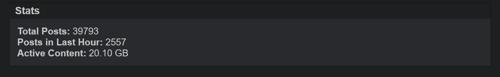

[78/2000] 19c29ccb4e5fd9dd1c75de2f8762fce8493ad238d7fce2770ccc885d4215090e



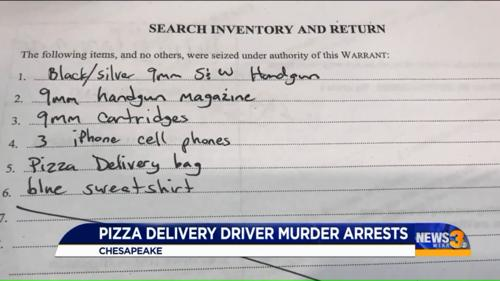

[79/2000] 2f1882e8c7d132b83ad9fcd06a48b18061b10b85d9fbbdd7e16ebba8582956cf



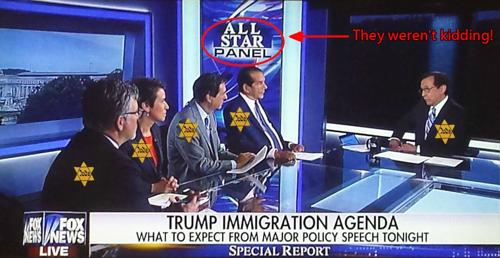

[80/2000] bfe0baa4de7e8989992f3be5d579ae55e73dee9ca45605d3e25006e49460706a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bfe0baa4de7e8989992f3be5d579ae55e73dee9ca45605d3e25006e49460706a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bfe0baa4de7e8989992f3be5d579ae55e73dee9ca45605d3e25006e49460706a.gz'
Failed to load target image.
[81/2000] bc43ac4312002bde65fa36f0ab443ef0502a83f14d1940c41d4ef389fd143581
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bc43ac4312002bde65fa36f0ab443ef0502a83f14d1940c41d4ef389fd143581.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bc43ac4312002bde65fa36f0ab443ef0502a83f14d1940c41d4ef389fd143581.gz'
Failed to load target image.
[82/2000] ac72738f6c28cab9bf9776feb2670ede642dd8bfedaf411a6a3fdd3aa7635047



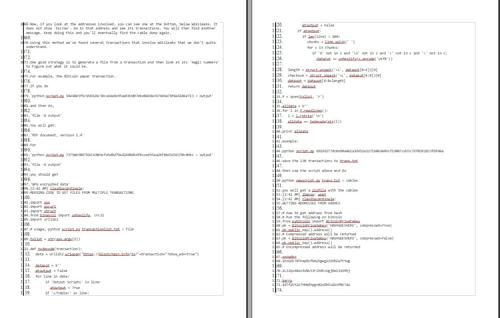

[83/2000] bae2d3494947017400987bc490307e5d618261b646a74a5c20de10a6b09264a8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bae2d3494947017400987bc490307e5d618261b646a74a5c20de10a6b09264a8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bae2d3494947017400987bc490307e5d618261b646a74a5c20de10a6b09264a8.gz'
Failed to load target image.
[84/2000] 99d6f18250eccc02b95824ec3ee5902cf8b93a7615e5984f6b5153c80c1ba09e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/99d6f18250eccc02b95824ec3ee5902cf8b93a7615e5984f6b5153c80c1ba09e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/99d6f18250eccc02b95824ec3ee5902cf8b93a7615e5984f6b5153c80c1ba09e.gz'
Failed to load target image.
[85/2000] 8a9cd1c3bb135e49c62769f0b291cc2bfb121df32c9971a3175a1211e138b8a5



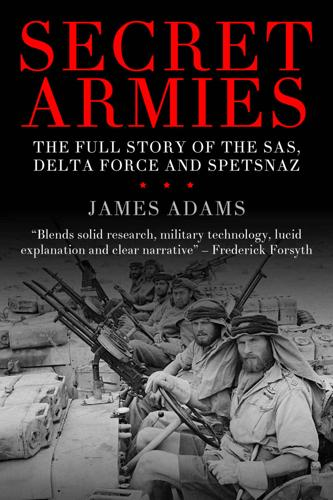

[86/2000] e2b2ee8bc3e4e4f6a2fe345e8661878f9f081e6d640840640e0bb3c9f09b2b10
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e2b2ee8bc3e4e4f6a2fe345e8661878f9f081e6d640840640e0bb3c9f09b2b10.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e2b2ee8bc3e4e4f6a2fe345e8661878f9f081e6d640840640e0bb3c9f09b2b10.gz'
Failed to load target image.
[87/2000] 79b70970b8d32f01e2f5d1afcb8769ee49c696a25973744dec660e1f6b37db32
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/79b70970b8d32f01e2f5d1afcb8769ee49c696a25973744dec660e1f6b37db32.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/79b70970b8d32f01e2f5d1afcb8769ee49c696a25973744dec660e1f6b37db32.gz'
Failed to load target image.
[88/2000] 16d7227596e809043cbd5990d62dfe4a749c5ef7ff51998ce01263629bcb63f0



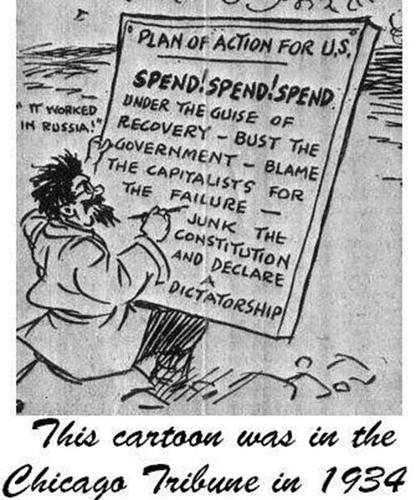

[89/2000] 98ffac2f57b1d438abb2a50b70ddbe96b4fc7b2f8d76d5ec3253c2bbb32a22b3
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/98ffac2f57b1d438abb2a50b70ddbe96b4fc7b2f8d76d5ec3253c2bbb32a22b3.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/98ffac2f57b1d438abb2a50b70ddbe96b4fc7b2f8d76d5ec3253c2bbb32a22b3.gz'
Failed to load target image.
[90/2000] fba09feb383dc719353fd0296690dc007e4d1e985232051e31c3eb8081227295
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fba09feb383dc719353fd0296690dc007e4d1e985232051e31c3eb8081227295.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fba09feb383dc719353fd0296690dc007e4d1e985232051e31c3eb8081227295.gz'
Failed to load target image.
[91/2000] d0fa49339d3fc79d0cdf7c2b4108e294005d55dfc49abdb0c57b8611110d6e57
[92/2000] f615b3627ef21320ddf3061f996e891539bbc876b9c313b989d72c7


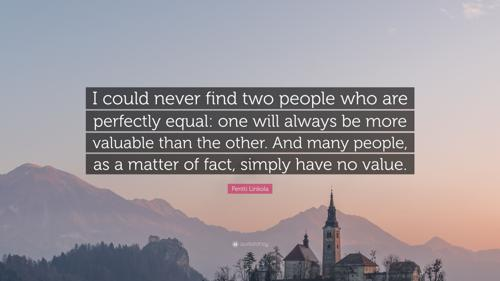

[95/2000] 690321bb04073ee0fdce47156ec7b9c37293062b2201405f2b1cc3a9b6e6b96c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/690321bb04073ee0fdce47156ec7b9c37293062b2201405f2b1cc3a9b6e6b96c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/690321bb04073ee0fdce47156ec7b9c37293062b2201405f2b1cc3a9b6e6b96c.gz'
Failed to load target image.
[96/2000] 55fdbbb33b8194c536e90397f86c6fd74a804e91674373e7a2c5e0595ce522c3
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/55fdbbb33b8194c536e90397f86c6fd74a804e91674373e7a2c5e0595ce522c3.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/55fdbbb33b8194c536e90397f86c6fd74a804e91674373e7a2c5e0595ce522c3.gz'
Failed to load target image.
[97/2000] 9257dd2604f1243686f80e235a1eef2de31ad25939fa73f8d58e0d6d558e2389
[98/2000] e9e6c9367b6abd32a7577a97e6480cbb4d929cbe5ae3b8c94a79842


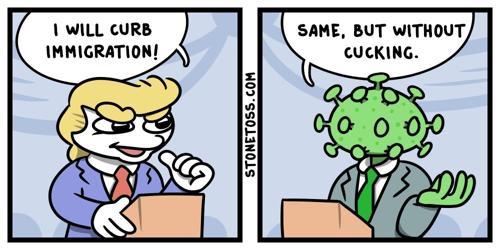

[100/2000] d00f61e7f1e890d734f9be7356d14404ad0d956c1cf5079d5a4f0ee4c2761ba2
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d00f61e7f1e890d734f9be7356d14404ad0d956c1cf5079d5a4f0ee4c2761ba2.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d00f61e7f1e890d734f9be7356d14404ad0d956c1cf5079d5a4f0ee4c2761ba2.gz'
Failed to load target image.
[101/2000] 0c88b9334b63dc480d9e478be764bd109d697f887cf6c6d6d865ebf385188821
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0c88b9334b63dc480d9e478be764bd109d697f887cf6c6d6d865ebf385188821.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0c88b9334b63dc480d9e478be764bd109d697f887cf6c6d6d865ebf385188821.gz'
Failed to load target image.
[102/2000] 65e4fe136d186ff51c9d222b657a2271a0a499b330646fcb1477bbb19111e891
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


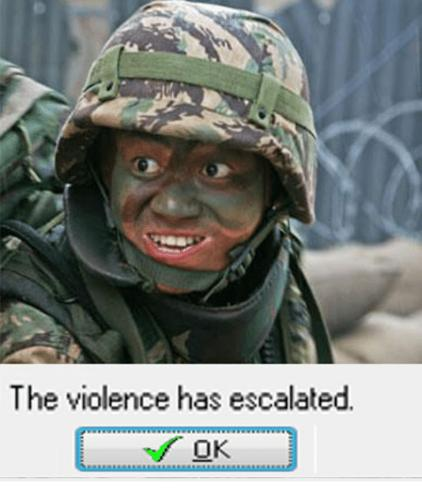

[104/2000] 7b0df9cf8a3e87f39a77de39ca28d1fb6aaf486da05642c58cd0a79c336f1eec
[105/2000] 590abdbdfec6263d04ca880198da538f87aa09a54926a9285c959cb26c72a0bc
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/590abdbdfec6263d04ca880198da538f87aa09a54926a9285c959cb26c72a0bc.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/590abdbdfec6263d04ca880198da538f87aa09a54926a9285c959cb26c72a0bc.gz'
Failed to load target image.
[106/2000] cfe8c0343acfa2cca82c97738234fec528013ae8a4fab04cccaf2adabf8ebbe2



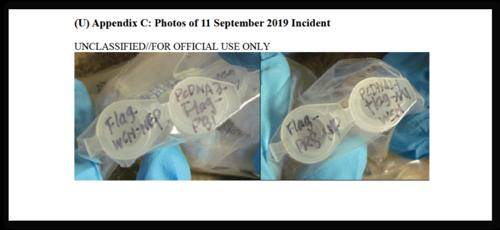

[107/2000] 1e464e863b414f7b3cdc091c3b239c0e5ba800e8687c02af1dd9abdbc1d2c29f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1e464e863b414f7b3cdc091c3b239c0e5ba800e8687c02af1dd9abdbc1d2c29f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1e464e863b414f7b3cdc091c3b239c0e5ba800e8687c02af1dd9abdbc1d2c29f.gz'
Failed to load target image.
[108/2000] 5dc40f9bc2c3e9378982c5eadd0482d6a9fcfcfe2b8c6f805f379e763ebb3d76
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5dc40f9bc2c3e9378982c5eadd0482d6a9fcfcfe2b8c6f805f379e763ebb3d76.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5dc40f9bc2c3e9378982c5eadd0482d6a9fcfcfe2b8c6f805f379e763ebb3d76.gz'
Failed to load target image.
[109/2000] 3b0564e32ae3baafaa7e9faab82983fe41fceabc0540350fbaf13abe62cdca45



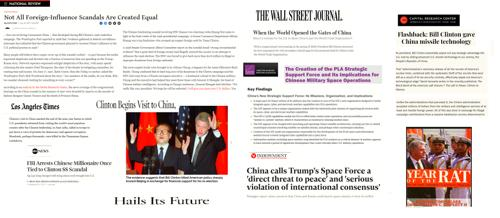

[110/2000] de864d6b14d7507ae25d0bdbd6f20c899a03bd090ff4b7c1b809448bfabd7dbb
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/de864d6b14d7507ae25d0bdbd6f20c899a03bd090ff4b7c1b809448bfabd7dbb.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/de864d6b14d7507ae25d0bdbd6f20c899a03bd090ff4b7c1b809448bfabd7dbb.gz'
Failed to load target image.
[111/2000] 69d92cee5363589f38499be1cdb61e398ef5ca545cb4822f2c5c3f834d872250
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/69d92cee5363589f38499be1cdb61e398ef5ca545cb4822f2c5c3f834d872250.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/69d92cee5363589f38499be1cdb61e398ef5ca545cb4822f2c5c3f834d872250.gz'
Failed to load target image.
[112/2000] cfb10736a74847264b329cd40045e9bd9a69f77cc106fc12026d3b3ef5369fc9
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


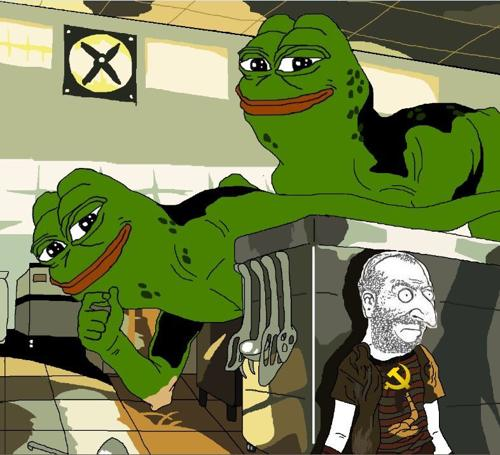

[114/2000] 441dfe730c429f1bea75cff428e57d42bc8ae9c688dda1fcf2e53b5125898e6a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/441dfe730c429f1bea75cff428e57d42bc8ae9c688dda1fcf2e53b5125898e6a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/441dfe730c429f1bea75cff428e57d42bc8ae9c688dda1fcf2e53b5125898e6a.gz'
Failed to load target image.
[115/2000] 152a1db95e0710f0db1bdbf7ef6e9dc8779b892777e1c69fe4847394ede9a6cd
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/152a1db95e0710f0db1bdbf7ef6e9dc8779b892777e1c69fe4847394ede9a6cd.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/152a1db95e0710f0db1bdbf7ef6e9dc8779b892777e1c69fe4847394ede9a6cd.gz'
Failed to load target image.
[116/2000] 7d583b3d1fa31093702efe5ddbe672e9c20ed1009038ae1eb0b0b923e3122683
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


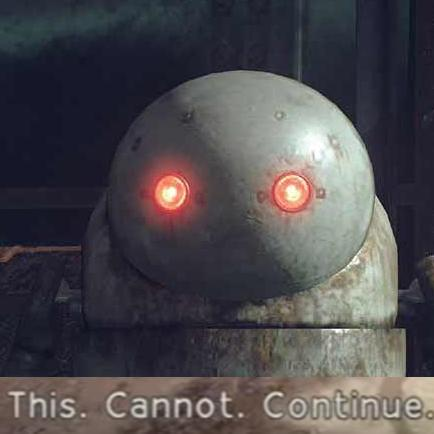

[120/2000] fbcfbe4c05af2ea9e80e2f5fc968a306a207d8397f8f26591f99f7633fc363fb
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fbcfbe4c05af2ea9e80e2f5fc968a306a207d8397f8f26591f99f7633fc363fb.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fbcfbe4c05af2ea9e80e2f5fc968a306a207d8397f8f26591f99f7633fc363fb.gz'
Failed to load target image.
[121/2000] e9c3035277ace3014e57834028637b38d83e50335883ac2d2feee8bd2b5fbac4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e9c3035277ace3014e57834028637b38d83e50335883ac2d2feee8bd2b5fbac4.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e9c3035277ace3014e57834028637b38d83e50335883ac2d2feee8bd2b5fbac4.gz'
Failed to load target image.
[122/2000] 62844fdc308e7422f70d9ea88932117db5d828c16a59d6e318051dae9fef4146
[123/2000] 66af82d3751c0dde767f16cbfd6f7f7df24a34995c84850877c


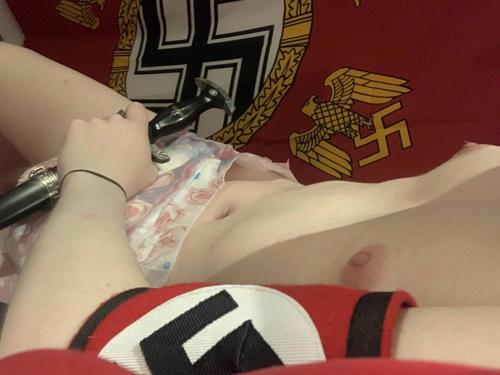

[125/2000] 332cc960b1f5a63a2b2e8e026c9771ba9e46cf5b8c4d09c95eae6890e777c682
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/332cc960b1f5a63a2b2e8e026c9771ba9e46cf5b8c4d09c95eae6890e777c682.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/332cc960b1f5a63a2b2e8e026c9771ba9e46cf5b8c4d09c95eae6890e777c682.gz'
Failed to load target image.
[126/2000] 93284114d5f1e0ed82a8d98cd3f558d4679307b239adfe8ce757af80cf54254a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/93284114d5f1e0ed82a8d98cd3f558d4679307b239adfe8ce757af80cf54254a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/93284114d5f1e0ed82a8d98cd3f558d4679307b239adfe8ce757af80cf54254a.gz'
Failed to load target image.
[127/2000] d4f295856d9fe927c52923e0679a0de94bae0bffb9a209e165558bda82d431a8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


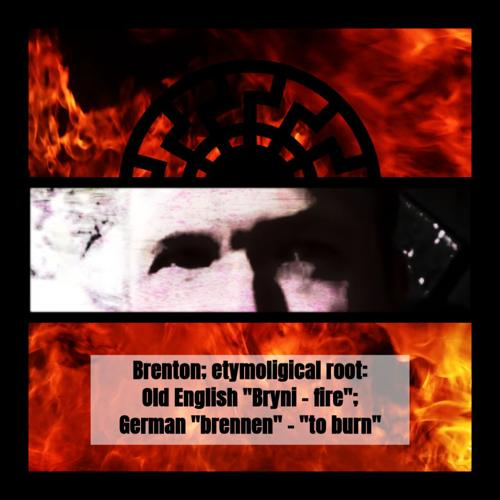

[131/2000] 88102c747be555d1afd701035f38b2f2e2aa9c219af4618dbd9af2a13f97bcea
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/88102c747be555d1afd701035f38b2f2e2aa9c219af4618dbd9af2a13f97bcea.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/88102c747be555d1afd701035f38b2f2e2aa9c219af4618dbd9af2a13f97bcea.gz'
Failed to load target image.
[132/2000] 3eda2536981fc459dfaa09cfbca2e890918d813cbf4fb12c16413d75b9969b61



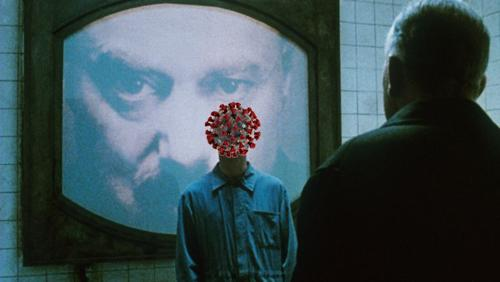

[133/2000] 6c42ea25f628b65460fb9a53ce1457ce6716b5bbda2081ee093e94fc966a2940
[134/2000] 3a6dc2ed3603f66401c4633ff71f2f289a8d9f1bc0a45eecc41cb2cb1ebe34ff
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3a6dc2ed3603f66401c4633ff71f2f289a8d9f1bc0a45eecc41cb2cb1ebe34ff.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3a6dc2ed3603f66401c4633ff71f2f289a8d9f1bc0a45eecc41cb2cb1ebe34ff.gz'
Failed to load target image.
[135/2000] a7b86ba01c8f19f09c7dd0ebfdc252f5bdb06e32af58af1aaec6e835ab48a1fc
[136/2000] 14ef36ad436779fa8a20997a7a94df6c4c2dffa882fd65bb890cc6d1f2fc4c56



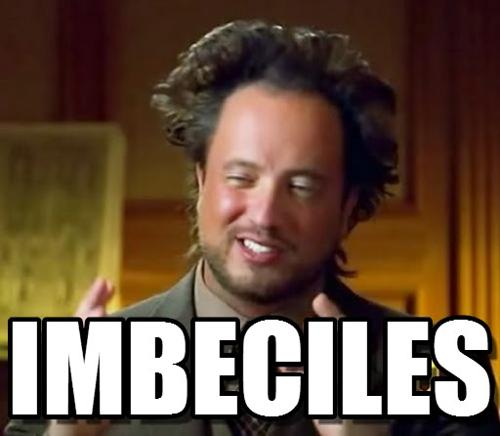

[137/2000] 27cc3b664185d275cc8b04ad6a1610aeef4a458a47f8272b69812a36dc5b50bc
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/27cc3b664185d275cc8b04ad6a1610aeef4a458a47f8272b69812a36dc5b50bc.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/27cc3b664185d275cc8b04ad6a1610aeef4a458a47f8272b69812a36dc5b50bc.gz'
Failed to load target image.
[138/2000] 6263b9a493d0b1609d13d4c6e073214c6ed2d023866cd785dd47afe21df6ddac



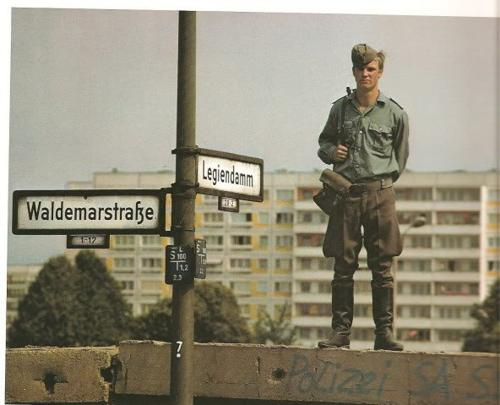

[139/2000] 1236f5eb8cc082c36052e312c1f80cb2a68c559e1a8011cc846a39eacb0aadfe
[140/2000] 5a03f54a5c0cf12af9f9e7a090b3c07e25995843a185593a36fb0a6cdce376ec



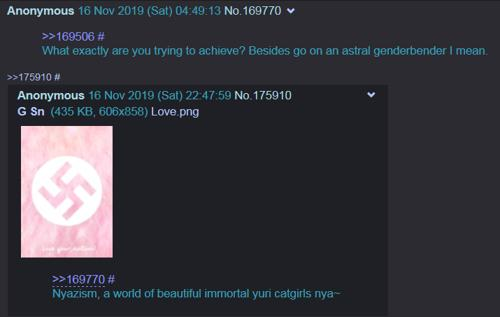

[141/2000] 6ab0c0ff543c76cea54930e78190089e4ad51c646f6a0ea4b6883618fc279821



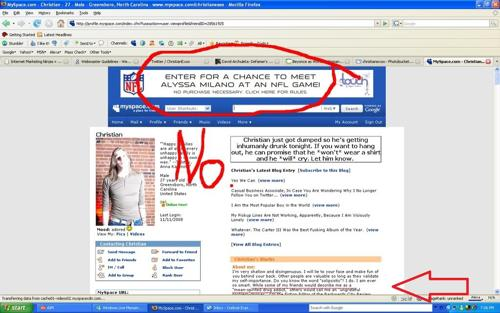

[142/2000] b998968c8c5bae2a71bbd10039e2affe0292f9bb13834e70bf3ec2d773452498
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b998968c8c5bae2a71bbd10039e2affe0292f9bb13834e70bf3ec2d773452498.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b998968c8c5bae2a71bbd10039e2affe0292f9bb13834e70bf3ec2d773452498.gz'
Failed to load target image.
[143/2000] 4b34d5e5578b16ce2948ffe31a17cfee5fa5f08fa9de552dd1ad01f0290f03d8



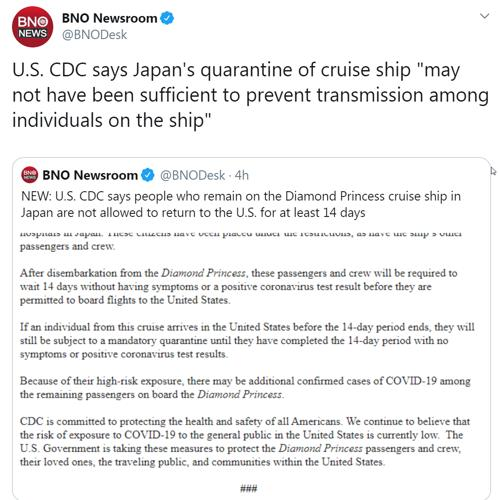

[144/2000] f009d209ee1229fb246dca4d243b1d24f67d8df9040699e4b9e7190561b64638
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f009d209ee1229fb246dca4d243b1d24f67d8df9040699e4b9e7190561b64638.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f009d209ee1229fb246dca4d243b1d24f67d8df9040699e4b9e7190561b64638.gz'
Failed to load target image.
[145/2000] e45ff3b66d59021e43b81f5f90b02d3f573cbdce3fe05aa7280eda11f8d051aa
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e45ff3b66d59021e43b81f5f90b02d3f573cbdce3fe05aa7280eda11f8d051aa.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e45ff3b66d59021e43b81f5f90b02d3f573cbdce3fe05aa7280eda11f8d051aa.gz'
Failed to load target image.
[146/2000] 61ee8e683431bb04825031690d7d38d3bc332538920b3d0555f50e1156d695ad
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


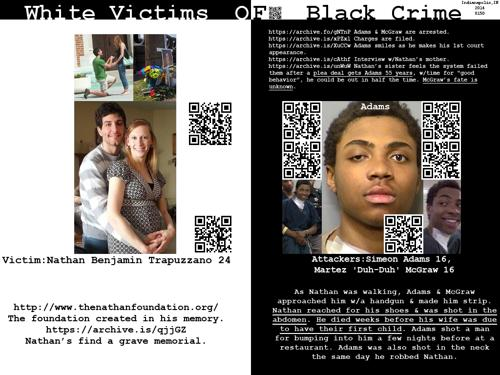

[149/2000] 8490ef5a20f68e115d39563ea52d87d229369cf821bfef1683be24ef499481dd



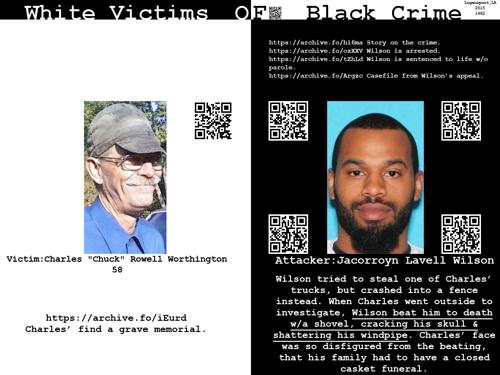

[150/2000] 41791e293c32960334f68dbb723ec913511d4299efa8c4d98a50cf0bd021895f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/41791e293c32960334f68dbb723ec913511d4299efa8c4d98a50cf0bd021895f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/41791e293c32960334f68dbb723ec913511d4299efa8c4d98a50cf0bd021895f.gz'
Failed to load target image.
[151/2000] 3bc1a8881ecdc3d3544f1996c5095c991c61109b6abbff00a110de23eb85c6f4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3bc1a8881ecdc3d3544f1996c5095c991c61109b6abbff00a110de23eb85c6f4.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3bc1a8881ecdc3d3544f1996c5095c991c61109b6abbff00a110de23eb85c6f4.gz'
Failed to load target image.
[152/2000] 6b3d8d5d522a62eb475caf4683342b097cfb16722378cd644e2d55e4e5de490c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


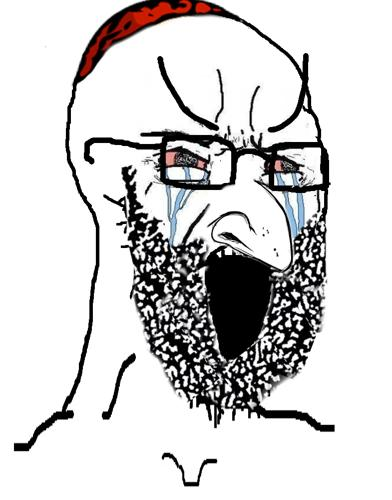

[158/2000] 514e3b80276b2f0bee2b70ff393796ff685bf212415ae1171064aeadc7059ca9
[159/2000] bdee294e908131a0c83ab0344a12a1df5de353e86f214d44d1cbc83bddeced5d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bdee294e908131a0c83ab0344a12a1df5de353e86f214d44d1cbc83bddeced5d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bdee294e908131a0c83ab0344a12a1df5de353e86f214d44d1cbc83bddeced5d.gz'
Failed to load target image.
[160/2000] 4aaa80da1cb517ed6d47a0efc28c3fb5794abf81e5dc2a8eca7f6e1082bab1ee



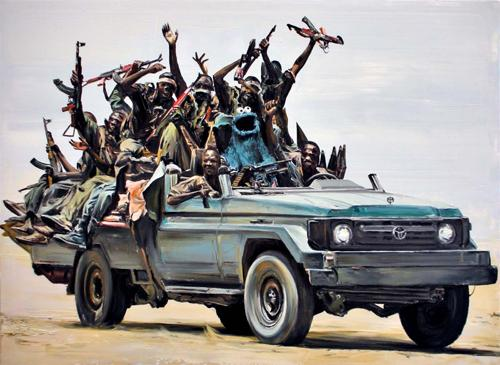

[161/2000] 73662a664c4974919ca7796386944efeab568ddfceccd6804c4d3b57a7868dca
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/73662a664c4974919ca7796386944efeab568ddfceccd6804c4d3b57a7868dca.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/73662a664c4974919ca7796386944efeab568ddfceccd6804c4d3b57a7868dca.gz'
Failed to load target image.
[162/2000] 093d60ddf2a3149fa9d5f0f96be50389dd65485d591f0afaa77f318510b7a177
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/093d60ddf2a3149fa9d5f0f96be50389dd65485d591f0afaa77f318510b7a177.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/093d60ddf2a3149fa9d5f0f96be50389dd65485d591f0afaa77f318510b7a177.gz'
Failed to load target image.
[163/2000] 1ca02069f730325cdf49978df5c744f2221c789414e1e6051f7fd9f35fbe2591
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


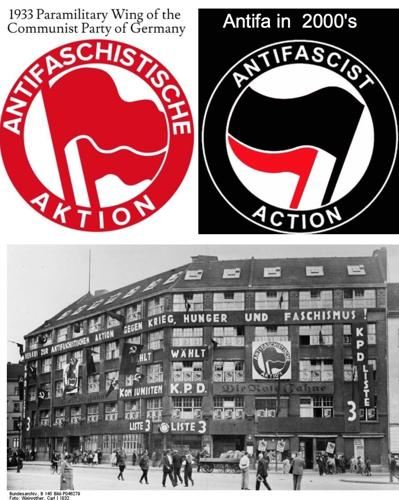

[171/2000] 6fda87dfd75c2d4014dbf25b3c95c669dc6fbbc87c92d9e84c82472b0dd57e8e



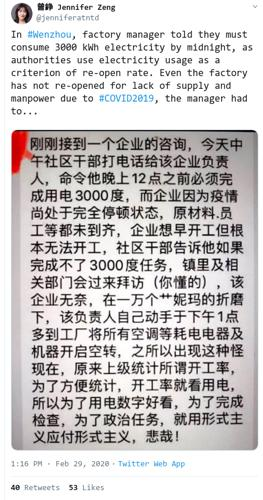

[172/2000] d5f76e3441456b437b5fd6fa931734b0f36a6fa7fc1533ee64d37e421392e08b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d5f76e3441456b437b5fd6fa931734b0f36a6fa7fc1533ee64d37e421392e08b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d5f76e3441456b437b5fd6fa931734b0f36a6fa7fc1533ee64d37e421392e08b.gz'
Failed to load target image.
[173/2000] 515efb6f9aa3d9196d161c4ae60b9841e0fa30a9a30597079c24c4505deb2639
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/515efb6f9aa3d9196d161c4ae60b9841e0fa30a9a30597079c24c4505deb2639.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/515efb6f9aa3d9196d161c4ae60b9841e0fa30a9a30597079c24c4505deb2639.gz'
Failed to load target image.
[174/2000] 85bddaec9b3e6509dffa327a18ec55073078cba65b2b4db11b95178ba8f2b68a
[175/2000] b6afe8c3e45d4e77590a7f2b2f3885d78b432a46e6a8a2dedac


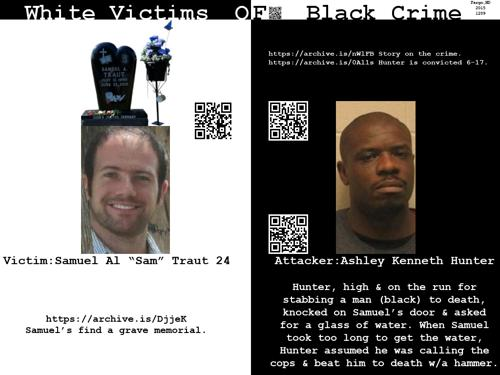

[177/2000] 5845fd32dafd14786a02ae1dfcb19f7383619daecf11e19fbfbfcf253725f1f0
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5845fd32dafd14786a02ae1dfcb19f7383619daecf11e19fbfbfcf253725f1f0.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5845fd32dafd14786a02ae1dfcb19f7383619daecf11e19fbfbfcf253725f1f0.gz'
Failed to load target image.
[178/2000] d45e3be50e1991a01d18783323ac711dcb2a4170d57165a2c223855edbbb06cb
[179/2000] 0e51507f79891a4189556c3a7ec4a56c882d77c4c36043e30ffe4d983289845c



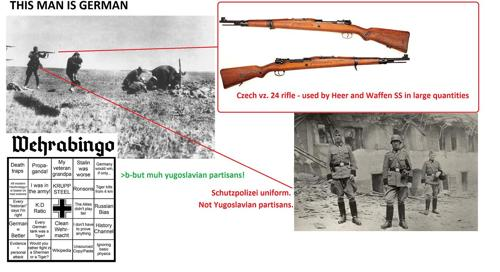

[180/2000] 6ff2209493093e3d84ef2c65fbf7c65d1157a4efd8faf5a6ac25c2e3a2b0d118



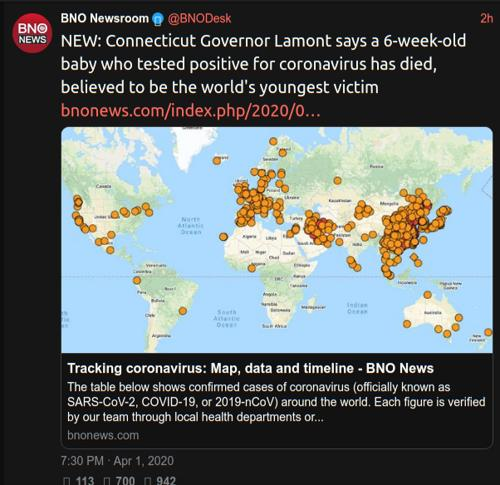

[181/2000] 606a806d6dd575feab15682895b541abd5f109f3f52ed7aafd77a123ab8b86e7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/606a806d6dd575feab15682895b541abd5f109f3f52ed7aafd77a123ab8b86e7.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/606a806d6dd575feab15682895b541abd5f109f3f52ed7aafd77a123ab8b86e7.gz'
Failed to load target image.
[182/2000] 8b83a356bb5a0e5590e47c0292a9746c0e34d6b9b04bf8cc6b7415c8517fbb2d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8b83a356bb5a0e5590e47c0292a9746c0e34d6b9b04bf8cc6b7415c8517fbb2d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8b83a356bb5a0e5590e47c0292a9746c0e34d6b9b04bf8cc6b7415c8517fbb2d.gz'
Failed to load target image.
[183/2000] a4e382d6a29f0e2e6d054945fb440df8f863269b4f3ea126267b134577c07c9f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


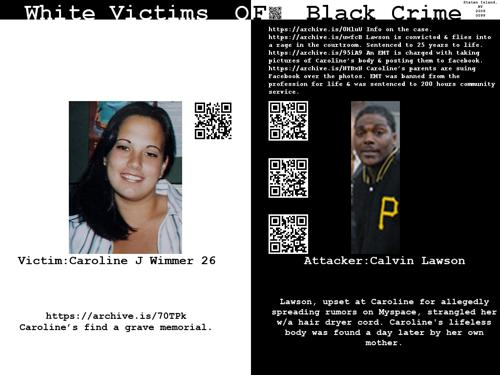

[189/2000] 1c1b495095ad3988039d7027592980d3ad0a63656befc5b32cd0dfa4f7a329f0
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1c1b495095ad3988039d7027592980d3ad0a63656befc5b32cd0dfa4f7a329f0.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1c1b495095ad3988039d7027592980d3ad0a63656befc5b32cd0dfa4f7a329f0.gz'
Failed to load target image.
[190/2000] 44d6d4632ce2b06bfdf8840e7e706a446e8c4bc5f07b7b2a586f3a6fffc8ab55
[191/2000] 6ec54a9cbefed1b9b3faa6412421e1222295772bb12d0698cd7525b1bde9fee8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6ec54a9cbefed1b9b3faa6412421e1222295772bb12d0698cd7525b1bde9fee8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6ec54a9cbefed1b9b3faa6412421e1222295772bb12d0698cd7525b1bde9fee8.gz'
Failed to load target image.
[192/2000] 4fd507705d6f965803140cc2b58c322ec30806834e3b95d725d


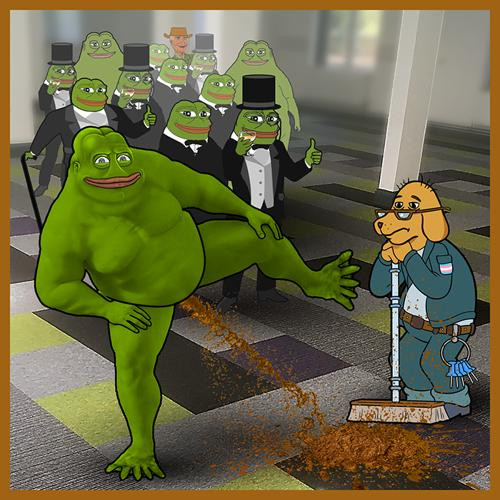

[196/2000] dc29039512da6334647ca77dab4f90ae997a1f8ee1e5c4257d9fc79d6df1921f
[197/2000] cf67884545ed987dc156b49c72b1aa5bcafc07416ccff3d2c2eb18f2134d770a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cf67884545ed987dc156b49c72b1aa5bcafc07416ccff3d2c2eb18f2134d770a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cf67884545ed987dc156b49c72b1aa5bcafc07416ccff3d2c2eb18f2134d770a.gz'
Failed to load target image.
[198/2000] c9f765d61f6b20b1821652b726d5398559816afbfb8fd4f234bef94dcb495da4



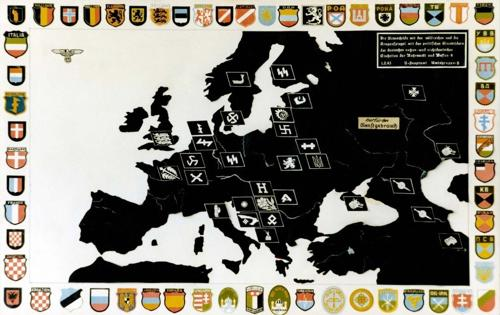

[199/2000] ff135210aa6ef1ce3b561d63f912ff59045fcde5c7b002b4c6d1481c646f3c77
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ff135210aa6ef1ce3b561d63f912ff59045fcde5c7b002b4c6d1481c646f3c77.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ff135210aa6ef1ce3b561d63f912ff59045fcde5c7b002b4c6d1481c646f3c77.gz'
Failed to load target image.
[200/2000] 2dabb3c79f95426257db81975fafe29e4b2f9f97a035f54d8205cf5fceb4ed01
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2dabb3c79f95426257db81975fafe29e4b2f9f97a035f54d8205cf5fceb4ed01.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2dabb3c79f95426257db81975fafe29e4b2f9f97a035f54d8205cf5fceb4ed01.gz'
Failed to load target image.
[201/2000] 669ff0fc6e8275c34a28b56b12e04cb939a19d13e0df601d46c777fd7d2273a5
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


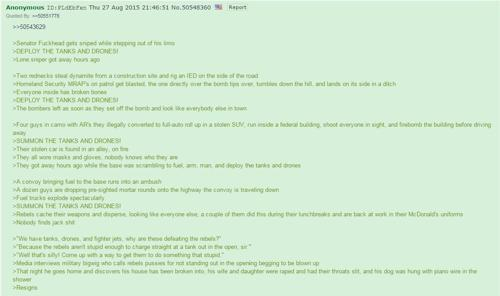

[204/2000] 67582dbea036efb8f3f372e4a0f7042eec72dab64ebcae6d298242de4c632fc5



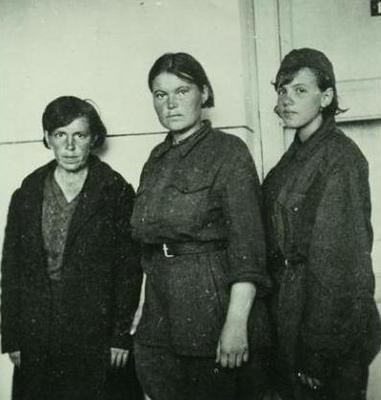

[205/2000] 4911853eef9ba1390ebb12421fdf5de83d017bfc63f17130e979c79f408011e8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4911853eef9ba1390ebb12421fdf5de83d017bfc63f17130e979c79f408011e8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4911853eef9ba1390ebb12421fdf5de83d017bfc63f17130e979c79f408011e8.gz'
Failed to load target image.
[206/2000] 5a93067fa6ccab1da6bb3b399822e9d5bb2d73d1a1940d5c1d1fc8b795256e54
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5a93067fa6ccab1da6bb3b399822e9d5bb2d73d1a1940d5c1d1fc8b795256e54.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5a93067fa6ccab1da6bb3b399822e9d5bb2d73d1a1940d5c1d1fc8b795256e54.gz'
Failed to load target image.
[207/2000] d50819201b4fe13c787e3474aa0f87ec172f4937605f63f717e7ef926bec13e7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


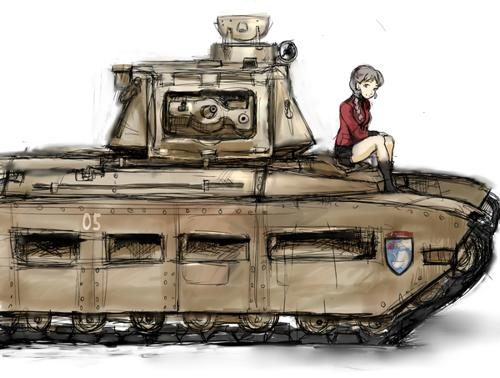

[214/2000] a4d08199ec9c0d26a2e2d0b0abcf11339bffa708db5d31b9ae30e75ead99eea2
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a4d08199ec9c0d26a2e2d0b0abcf11339bffa708db5d31b9ae30e75ead99eea2.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a4d08199ec9c0d26a2e2d0b0abcf11339bffa708db5d31b9ae30e75ead99eea2.gz'
Failed to load target image.
[215/2000] 11d464055cebf38a0caf5a163b3c9a7d4e4d97b74a3ff5a0fa8530b603d6146d
[216/2000] 371a3a10af4be4b9bde8db87a632cafb82992b223086a7ab4a8f372474561450



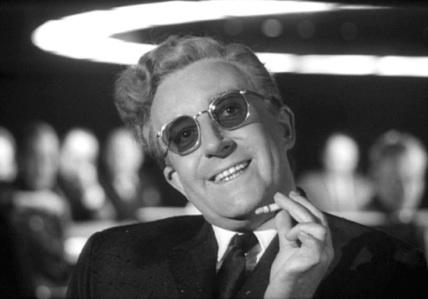

[217/2000] 6ada7ca06d5936416ffda92ce1e6f75fb6f7ea8702181c7f06ffa57696329168
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6ada7ca06d5936416ffda92ce1e6f75fb6f7ea8702181c7f06ffa57696329168.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6ada7ca06d5936416ffda92ce1e6f75fb6f7ea8702181c7f06ffa57696329168.gz'
Failed to load target image.
[218/2000] 61fe2c8368949a75df0140edc5272eed636fa1e44155b601acf1989ea17fa844
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/61fe2c8368949a75df0140edc5272eed636fa1e44155b601acf1989ea17fa844.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/61fe2c8368949a75df0140edc5272eed636fa1e44155b601acf1989ea17fa844.gz'
Failed to load target image.
[219/2000] 818ae9432827f783167259a0f9e8787ffdfc596a1a788fc76cbd6903420deff7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


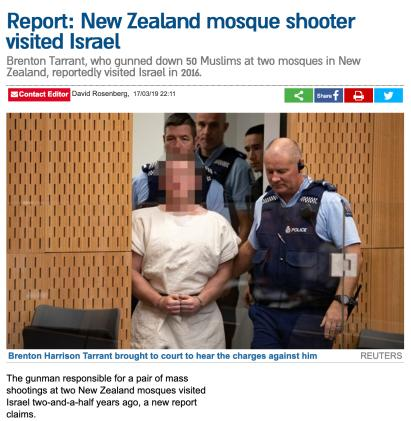

[225/2000] 3482532908a0b95f0a01eb43a4211213c2a23421cba2d05f3c92e3f597bb938b



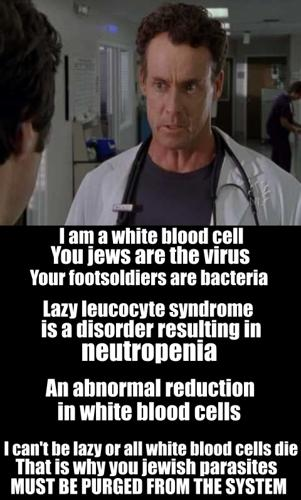

[226/2000] 88eb7b42e299108b9ff63d855844c9bff8b139b9766c140855cadd2470809209
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/88eb7b42e299108b9ff63d855844c9bff8b139b9766c140855cadd2470809209.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/88eb7b42e299108b9ff63d855844c9bff8b139b9766c140855cadd2470809209.gz'
Failed to load target image.
[227/2000] 3e8977dbe328c66a86ff2eed9cf860308d3e47f42de6fd9f2de784b6945632f2
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3e8977dbe328c66a86ff2eed9cf860308d3e47f42de6fd9f2de784b6945632f2.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3e8977dbe328c66a86ff2eed9cf860308d3e47f42de6fd9f2de784b6945632f2.gz'
Failed to load target image.
[228/2000] 5255ad6cb69da283c50577d75eeb432222836b48f296c8ab617d64fec13242f5



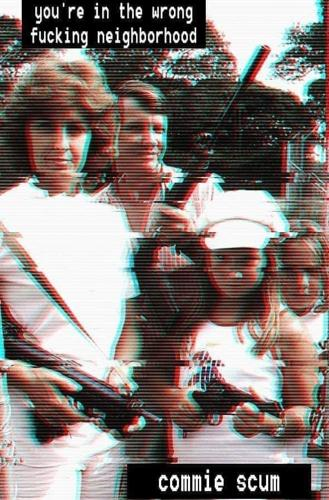

[229/2000] b4f5b65422bb9aa67aca47651dcb94cfee2e56b6676fafc05d8822756407d03e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b4f5b65422bb9aa67aca47651dcb94cfee2e56b6676fafc05d8822756407d03e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b4f5b65422bb9aa67aca47651dcb94cfee2e56b6676fafc05d8822756407d03e.gz'
Failed to load target image.
[230/2000] 8fcc39a71606a309fc44d273678f8f52d77b5a5d2cecfdf0bd5fcc4c5159cea8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8fcc39a71606a309fc44d273678f8f52d77b5a5d2cecfdf0bd5fcc4c5159cea8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8fcc39a71606a309fc44d273678f8f52d77b5a5d2cecfdf0bd5fcc4c5159cea8.gz'
Failed to load target image.
[231/2000] 9c4fedca9dd8768747f39ba66c56c0dbcc8bd6bed06927659103689d48f036c6
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


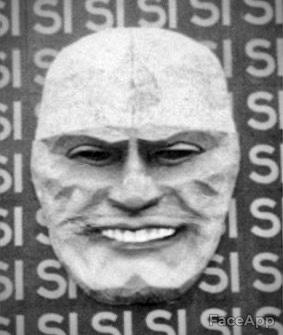

[234/2000] a9a2744b1f1de78688958d275375f9b9ade1de81097c97487dcac62f4a90c33f



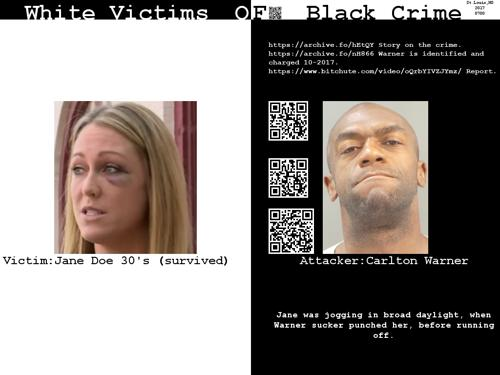

[235/2000] d1cfe4875877e9e58ab57c562ebe6c9357fb7b507634e0e0cde4fa055bc1163e



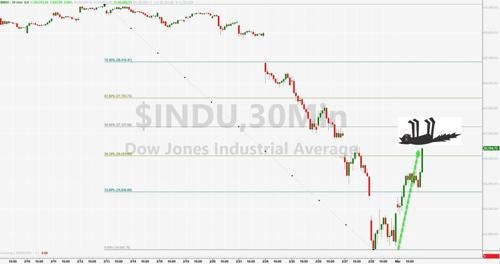

[236/2000] 2a7c5ebf6315c916fa218aa85b190a3fffe88d1c7672266034ad7660659d2b00
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2a7c5ebf6315c916fa218aa85b190a3fffe88d1c7672266034ad7660659d2b00.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2a7c5ebf6315c916fa218aa85b190a3fffe88d1c7672266034ad7660659d2b00.gz'
Failed to load target image.
[237/2000] 5b89ac7f631b4b580eaf1705082af8a114c0bde35b916ca14861eca09578252a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5b89ac7f631b4b580eaf1705082af8a114c0bde35b916ca14861eca09578252a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5b89ac7f631b4b580eaf1705082af8a114c0bde35b916ca14861eca09578252a.gz'
Failed to load target image.
[238/2000] a5acd78297f9937e96ecf7e8638b51169247c7e30f8b243a5430e9b6bec5fa62
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


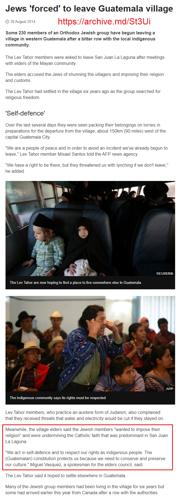

[240/2000] c6531ca99d1b57941409b38d3b29d982184d17e362ba719c3745b3f50d9f3241
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c6531ca99d1b57941409b38d3b29d982184d17e362ba719c3745b3f50d9f3241.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c6531ca99d1b57941409b38d3b29d982184d17e362ba719c3745b3f50d9f3241.gz'
Failed to load target image.
[241/2000] efa64431e11cbf597ab3dfd120707e239e2ef5c9cb7db037f5f9c4ebdc54f13e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/efa64431e11cbf597ab3dfd120707e239e2ef5c9cb7db037f5f9c4ebdc54f13e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/efa64431e11cbf597ab3dfd120707e239e2ef5c9cb7db037f5f9c4ebdc54f13e.gz'
Failed to load target image.
[242/2000] 871b60a7ccdc3a2c91699db7db8273b671d24b3c0c926b85852a45d07b3bda65
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


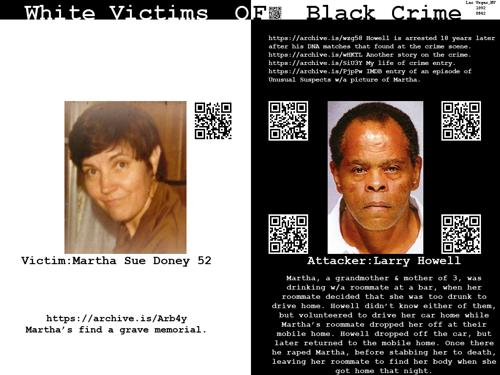

[268/2000] ac6d3ad17e76b99607cf24c9f4fb281353425a04cae77c2646201a97c2291e16
[269/2000] 8a0cc2ca95cfba1eb4ed56c1f053f05bc7252ac8fe98d2614887335bbd446aaf



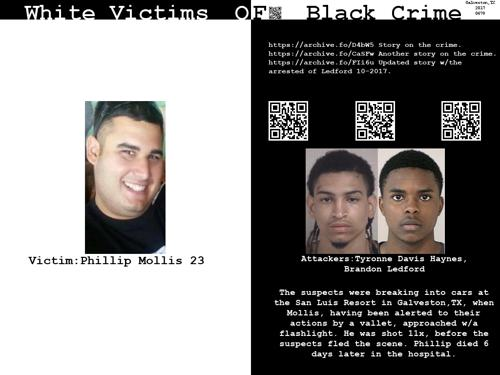

[270/2000] 12fb6df1b4c93cd07195b24af83e1157f5b62a6183d0c27bac1779de9f61057a



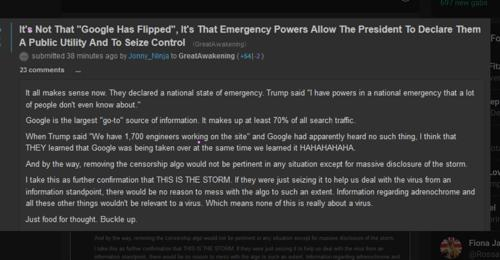

[271/2000] 3970dd6c376bf94e7d7f7578c6b500ba7f5d363635fc54b3770c9e1bffa26784
[272/2000] 3ede6dc3bf613194113ebd2aaf9e54599eb6f094f026a9597996d6065a1bbceb
[273/2000] 22bb3472d27b4d2f9899855b5ed6b99620b231760ce409d7f95fd0eb848d5f6d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/22bb3472d27b4d2f9899855b5ed6b99620b231760ce409d7f95fd0eb848d5f6d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/22bb3472d27b4d2f9899855b5ed6b99620b231760ce409d7f95fd0eb848d5f6d.gz'
Failed to load target image.
[274/2000] 0be5e3303dda21724fd30974016825f1c014f5de12a71837d4b871c11252b734
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0be5e3303dda21724fd30974016825f1c014f5de12a71837d4b871c11252b734.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0be5e3303dda21724fd30974016825f1c014f5de12a71837d4b871c11252b734.gz'
Failed to load 


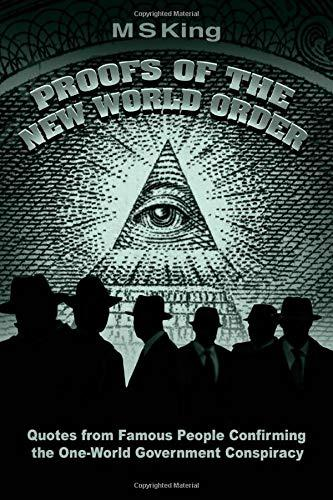

[287/2000] 94ac7c48299cf6c46d91f924b1e5791aee0032a53206e4b9af87d681ea3600a2



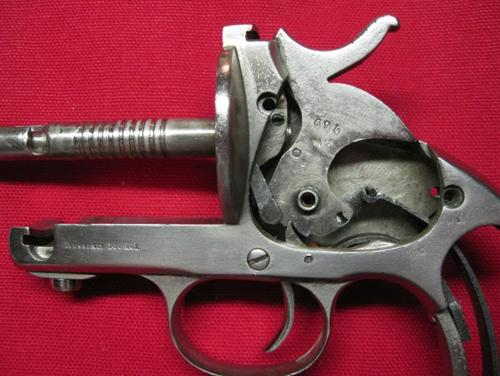

[288/2000] 54d87a645df32956548c84255db0afdfea8476b691f4e409e7c1c2bdc2b075f3



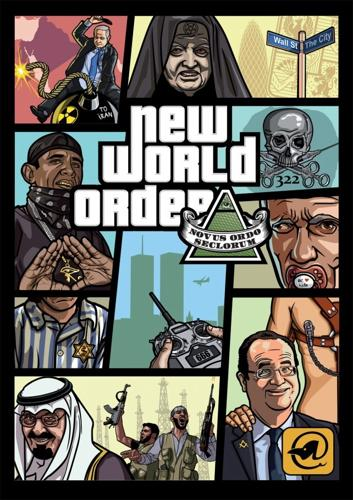

[289/2000] 395056a5caa799f97e70d44acc14e2fb48f6e53ef2b398b38b6ff1e7ce11c146



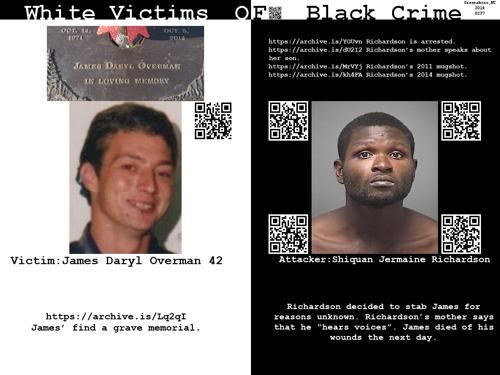

[290/2000] a2f118aac8f250900879d59ee5ce2ddb5aee83ac797d98daa501c816dbcfe7b9



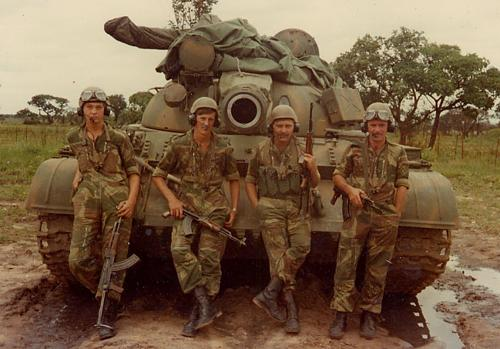

[291/2000] d7f7234db52db8ad31ba3f1d1389da00e38470136de5992c67a788f08a6f4d89
[292/2000] aea78da8fb7a004afd3e544d319a7f1001c0a62f80b867ff6615ce739f41eee4
[293/2000] 472880228d7caacf5414acf5267ea50c1afc828aca0595edd652719bfdfa92f8
[294/2000] 08a774a1ec49a437b1c80093af34a91c10abab5e61144ecaa0931445d43a1515
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/08a774a1ec49a437b1c80093af34a91c10abab5e61144ecaa0931445d43a1515.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/08a774a1ec49a437b1c80093af34a91c10abab5e61144ecaa0931445d43a1515.gz'
Failed to load target image.
[295/2000] a9fe82bfa8d5efe687e8fa8c8493250a75ccc81f7045f0f351449248072b5277
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a9fe82bfa8d5efe687e8fa8c8493250a75ccc81f7045f0f351449248072b5277.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a9fe82bf


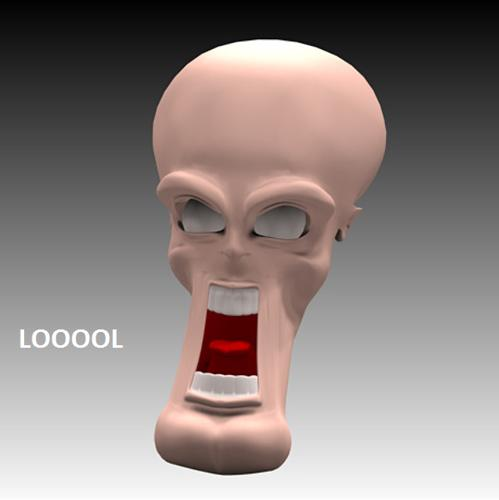

[297/2000] 6191348244b08b1617c2aec5425f5b27d3a9183465ec12fe762dec2378fddc0e
[298/2000] 715cef3dc4d351a3d1e818b6f1105d3eca7c5b39ea17efd35bcb90d42697d4c1
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/715cef3dc4d351a3d1e818b6f1105d3eca7c5b39ea17efd35bcb90d42697d4c1.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/715cef3dc4d351a3d1e818b6f1105d3eca7c5b39ea17efd35bcb90d42697d4c1.gz'
Failed to load target image.
[299/2000] f17576ce4a6735a221503ecd819db32cdbc0f6b180b0e7c8e475520b9fbefcb4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f17576ce4a6735a221503ecd819db32cdbc0f6b180b0e7c8e475520b9fbefcb4.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f17576ce4a6735a221503ecd819db32cdbc0f6b180b0e7c8e475520b9fbefcb4.gz'
Failed to load target image.
[300/2000] d30885142e2dafe3ab284d902c7f728d84eba543a1099760554


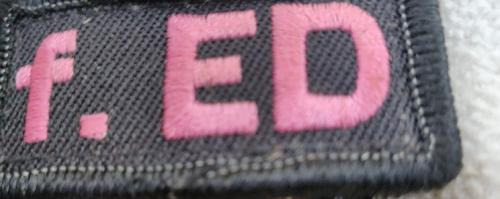

[301/2000] 0a51978f96b90a8deb0eaef36805f722b740c57080696be3d95030ace34563f2



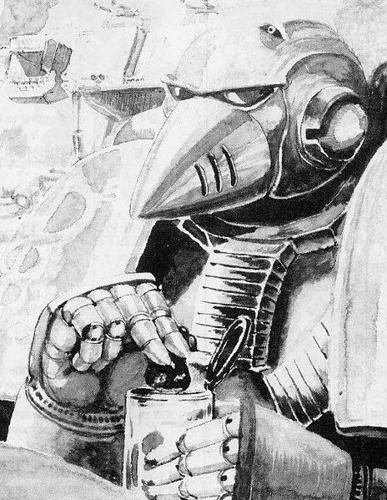

[302/2000] eed46ffb98d63c2f65b6cf72a903b382976503e4672750e73f5dd032eb8fef64
[303/2000] a3a0c127363524f3e5bf736c6bf2272b90550d30184fdb8926f5f0dcea6fcd6b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a3a0c127363524f3e5bf736c6bf2272b90550d30184fdb8926f5f0dcea6fcd6b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a3a0c127363524f3e5bf736c6bf2272b90550d30184fdb8926f5f0dcea6fcd6b.gz'
Failed to load target image.
[304/2000] cf0011fbf4b4f9d53f6f7191dba3147ab42cf9bf7a22c4263d80cfe7c652253b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cf0011fbf4b4f9d53f6f7191dba3147ab42cf9bf7a22c4263d80cfe7c652253b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cf0011fbf4b4f9d53f6f7191dba3147ab42cf9bf7a22c4263d80cfe7c652253b.gz'
Failed to load target image.
[305/2000] acb7ef732170e837b9f5aa1e08db4683fe6aeea3f12bc01211b


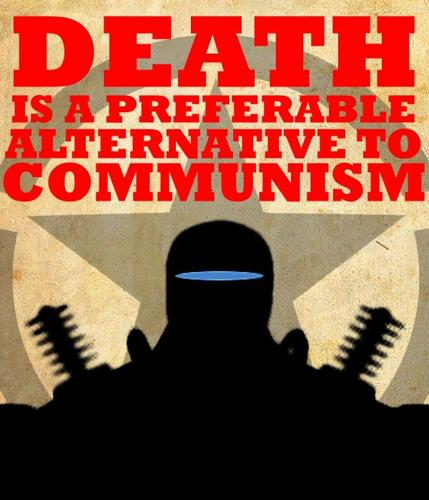

[307/2000] 397d89ebe7c615becb6a9dc663e0d497b955e23e616f8c45a816b680d906a964
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/397d89ebe7c615becb6a9dc663e0d497b955e23e616f8c45a816b680d906a964.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/397d89ebe7c615becb6a9dc663e0d497b955e23e616f8c45a816b680d906a964.gz'
Failed to load target image.
[308/2000] bc4f8fb6446f0e5bb12f0e0c1ac0d76b16b459c7fc9a92cf93f2658df0c55a42
[309/2000] ad640d89e63d7b4b6c887308f5de216a24f368eab7c765e6d9ddf581ee21402b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ad640d89e63d7b4b6c887308f5de216a24f368eab7c765e6d9ddf581ee21402b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ad640d89e63d7b4b6c887308f5de216a24f368eab7c765e6d9ddf581ee21402b.gz'
Failed to load target image.
[310/2000] 48e27e13acacd33ea10349a95b6050681911fad516da266182c


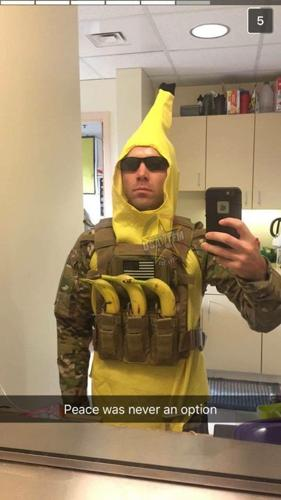

[311/2000] ca99300a61af23a12fa8156e3e970f503680354526899e4d0defc02587211ee3



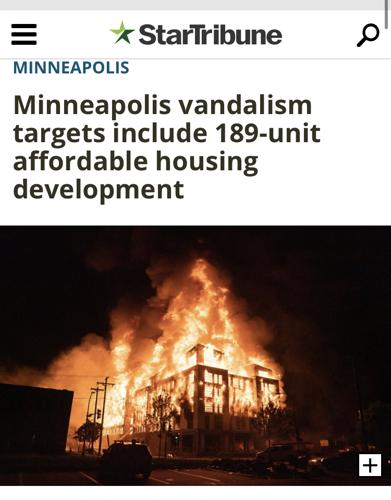

[312/2000] f15a76bc05c3da1a741e2b94c35b22d2fceb7f4b813a8dd1b9582f02365d2821
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f15a76bc05c3da1a741e2b94c35b22d2fceb7f4b813a8dd1b9582f02365d2821.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f15a76bc05c3da1a741e2b94c35b22d2fceb7f4b813a8dd1b9582f02365d2821.gz'
Failed to load target image.
[313/2000] 20ff9a8285d52e744e96d826205dae759efd787176be24b6e61967980d3e397e



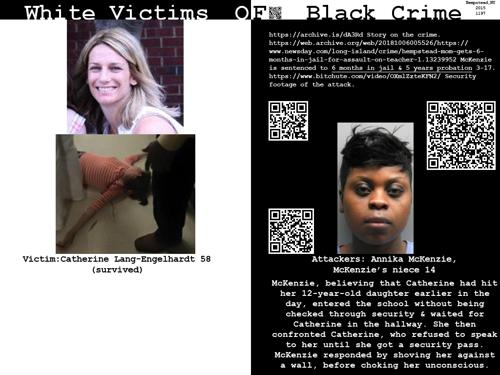

[314/2000] e07518feedc86b2898a822345fc62789ce271f0b4180f4d6b8e00036daf611af
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e07518feedc86b2898a822345fc62789ce271f0b4180f4d6b8e00036daf611af.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e07518feedc86b2898a822345fc62789ce271f0b4180f4d6b8e00036daf611af.gz'
Failed to load target image.
[315/2000] 17ba86d645b13fbd252054718e7ad5a4b34edb1e355b8ba460ef5bf67b50877b
[316/2000] 40cc585bb8048d7041a7744491f4a2d77ac73f88430876226a59671b45517124



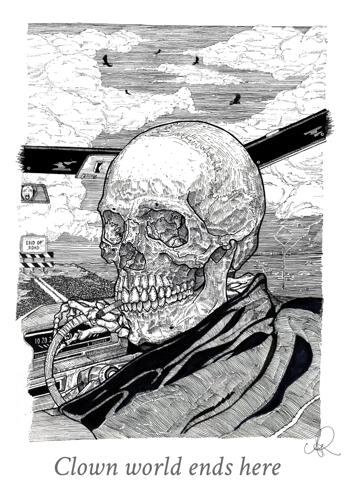

[317/2000] d4e9a2704d2b3bc4ed5a9d4e2ccb9a4cf1527bff400083ea782960e9a294559a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d4e9a2704d2b3bc4ed5a9d4e2ccb9a4cf1527bff400083ea782960e9a294559a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d4e9a2704d2b3bc4ed5a9d4e2ccb9a4cf1527bff400083ea782960e9a294559a.gz'
Failed to load target image.
[318/2000] 6d4520abe8f75953a63e01792b529f75184b5742154243d987b22be1a07871f3



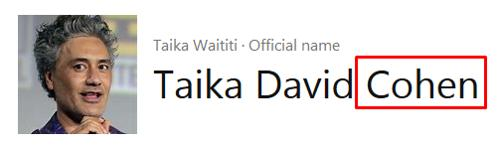

[319/2000] 09256810a9455edb38b4a155a96fff105343393c0e09f70451bc1aa1d1442dec
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/09256810a9455edb38b4a155a96fff105343393c0e09f70451bc1aa1d1442dec.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/09256810a9455edb38b4a155a96fff105343393c0e09f70451bc1aa1d1442dec.gz'
Failed to load target image.
[320/2000] 627fc145b1068a607c86877ff11bd45f37e49be10d31d693eb4634f5142a5ed9
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/627fc145b1068a607c86877ff11bd45f37e49be10d31d693eb4634f5142a5ed9.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/627fc145b1068a607c86877ff11bd45f37e49be10d31d693eb4634f5142a5ed9.gz'
Failed to load target image.
[321/2000] a8a3bdde13e3f521a53fc589f1d896145a3b6ad71fa08aa6e893d0dfec3b5790
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


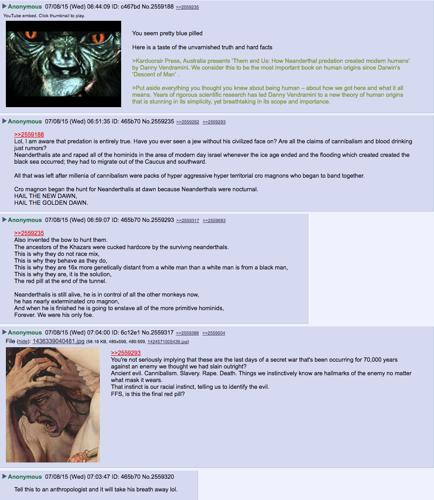

[324/2000] 2ccfbe7e1b0e212071ac4706ec3bcff6b2375f0c9514ca5f1fce4e49653f46b5



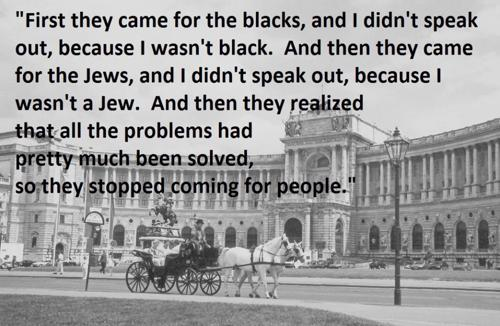

[325/2000] 1e692b3aa18085a62143711fa0c1121b4e5aad3e6fefba83da459bd112fec4f2
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1e692b3aa18085a62143711fa0c1121b4e5aad3e6fefba83da459bd112fec4f2.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1e692b3aa18085a62143711fa0c1121b4e5aad3e6fefba83da459bd112fec4f2.gz'
Failed to load target image.
[326/2000] e40943b1e36c07e27947b6bbddcb7b7112ac29fd42f4f922b475d17b8abe4d5e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e40943b1e36c07e27947b6bbddcb7b7112ac29fd42f4f922b475d17b8abe4d5e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e40943b1e36c07e27947b6bbddcb7b7112ac29fd42f4f922b475d17b8abe4d5e.gz'
Failed to load target image.
[327/2000] 0d4ce11b2f8330f1ae9539927d260b3fd9e948488ab581c13117ab86a9ae2fa8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


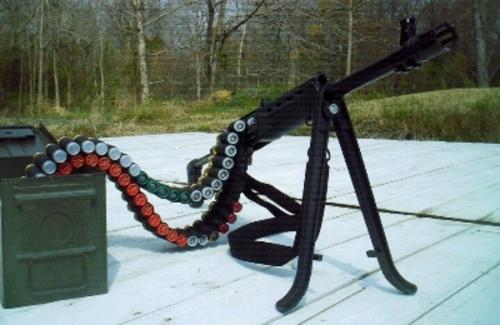

[335/2000] a2eb44d26e2c3d33da0c654c170897c637f5271033ccbdfc2daa3b05ff5854be
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a2eb44d26e2c3d33da0c654c170897c637f5271033ccbdfc2daa3b05ff5854be.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a2eb44d26e2c3d33da0c654c170897c637f5271033ccbdfc2daa3b05ff5854be.gz'
Failed to load target image.
[336/2000] 6cc07e37af47ab975b7897722badfe5ac690839fcd6a638a58c8776ac21bd55e



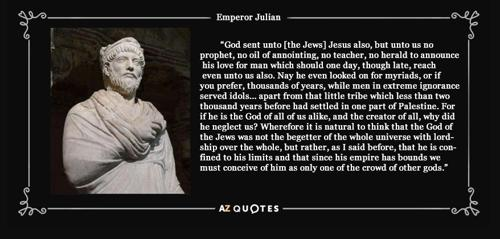

[337/2000] 343cacc1630105ffd17970075dccfaf895dbfc3bb29e8fcbdd490ffa7be1a080



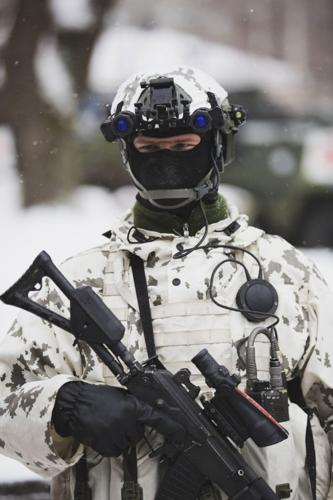

[338/2000] 2e7f7477a3dce00c8c7265b4c2c63a6a78eb31ecc0cc8dd65ec2d55a4c66b14f
[339/2000] 34e5264d31967f83345835b46915a7d23a38842542907b0f12ddc680db0455db
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/34e5264d31967f83345835b46915a7d23a38842542907b0f12ddc680db0455db.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/34e5264d31967f83345835b46915a7d23a38842542907b0f12ddc680db0455db.gz'
Failed to load target image.
[340/2000] e5b16b0a81f78fca23c50efae3b49c692cf89fa1c4a0e52fbaff33b946438b7b
[341/2000] 44de0301a14a455be51a6801f06f06411bea8974e2360cb0c423425faa9bf836
[342/2000] 5e32adebd9dcc4f315d2a523affe8da803421fdccc1c5dad98df8146f315e489
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5e32adebd9dcc4f315d2a523affe8da803421fdccc1c5dad98df8146f315e489.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5e32adeb


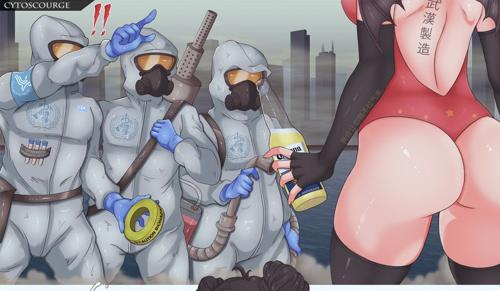

[347/2000] 13784720fee61b15f3743b5ae44fadc06c6ea4ac78c3fd79635c3d7c458a56f2
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/13784720fee61b15f3743b5ae44fadc06c6ea4ac78c3fd79635c3d7c458a56f2.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/13784720fee61b15f3743b5ae44fadc06c6ea4ac78c3fd79635c3d7c458a56f2.gz'
Failed to load target image.
[348/2000] 09579110637609c40e3eed1b342e96fff24a56ea02d6d755c4df5e0d52f30c82
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/09579110637609c40e3eed1b342e96fff24a56ea02d6d755c4df5e0d52f30c82.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/09579110637609c40e3eed1b342e96fff24a56ea02d6d755c4df5e0d52f30c82.gz'
Failed to load target image.
[349/2000] 72b0aab7f5ee448225adcf8ccb533a119226f2d0b93ff6c102155fa42b29e974
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


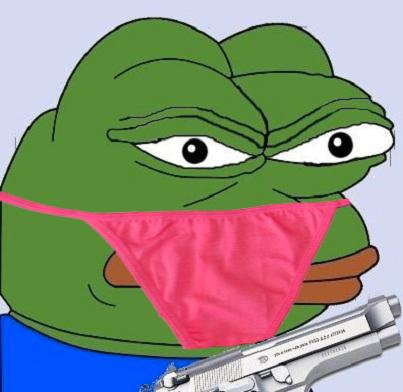

[351/2000] 87038842c7ddff3d8039efaec555d36f9a4614f4572a77f732b5d47b29db881e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/87038842c7ddff3d8039efaec555d36f9a4614f4572a77f732b5d47b29db881e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/87038842c7ddff3d8039efaec555d36f9a4614f4572a77f732b5d47b29db881e.gz'
Failed to load target image.
[352/2000] ca6e88ae4a4d9190e5fbd1d1021ed16322107f0bc8e7234ab03ec47d4f26ba28
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ca6e88ae4a4d9190e5fbd1d1021ed16322107f0bc8e7234ab03ec47d4f26ba28.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ca6e88ae4a4d9190e5fbd1d1021ed16322107f0bc8e7234ab03ec47d4f26ba28.gz'
Failed to load target image.
[353/2000] a5a4b043bc0913cce25c6cd66546b41ae327099912a86ab1b0ccc0e24854d4e4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


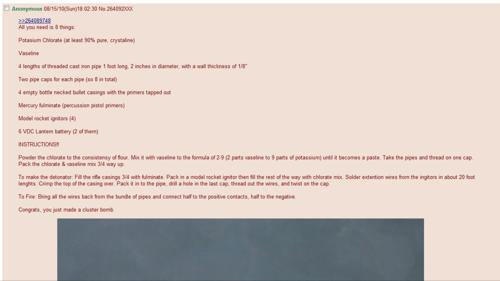

[355/2000] 44b121c65eaa3d7f3f21e1db58b9d2c58e433c555cf022177d94d63304906d92



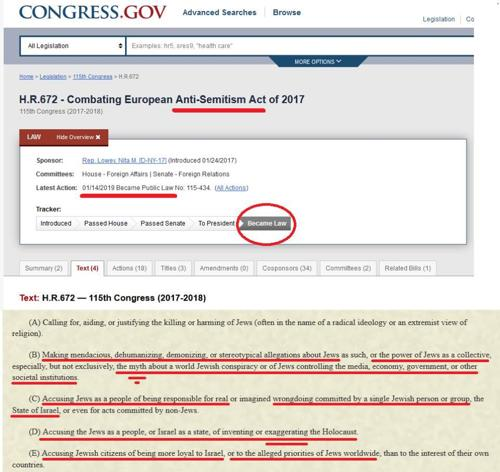

[356/2000] a17c1e73e5e3fc465e8895ca8a842c5cbce015c41af3d94e1cc1c88730fd0425
[357/2000] 5a064c701363a7fb0f0bc0383645c11be907062bd38d1356459a980d6dd271cc
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5a064c701363a7fb0f0bc0383645c11be907062bd38d1356459a980d6dd271cc.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5a064c701363a7fb0f0bc0383645c11be907062bd38d1356459a980d6dd271cc.gz'
Failed to load target image.
[358/2000] 37a6d8003347e8ec015f8dda8f977f44986a19474d6cfd1f181b79bd5a0f7c07
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/37a6d8003347e8ec015f8dda8f977f44986a19474d6cfd1f181b79bd5a0f7c07.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/37a6d8003347e8ec015f8dda8f977f44986a19474d6cfd1f181b79bd5a0f7c07.gz'
Failed to load target image.
[359/2000] 3cc092732fc67529fcb4062546ee61653a1228537488f8e3a9f


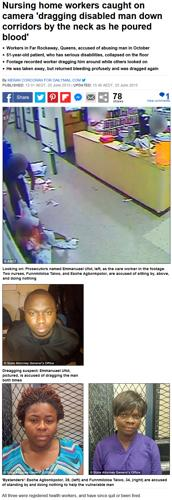

[365/2000] b02e6013719033b87e2755b7570f5350a577504276cb8555f71b3612d4a9e5fe
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b02e6013719033b87e2755b7570f5350a577504276cb8555f71b3612d4a9e5fe.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b02e6013719033b87e2755b7570f5350a577504276cb8555f71b3612d4a9e5fe.gz'
Failed to load target image.
[366/2000] 65ebeff00dc50b8a74a91ee02d20b3493dc89200f8ed2e3584d267d75d1a9e0e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/65ebeff00dc50b8a74a91ee02d20b3493dc89200f8ed2e3584d267d75d1a9e0e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/65ebeff00dc50b8a74a91ee02d20b3493dc89200f8ed2e3584d267d75d1a9e0e.gz'
Failed to load target image.
[367/2000] 52385d5edf146b9beca33689d768feda1b3ada1f47924b885d6b37c400be0e7a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


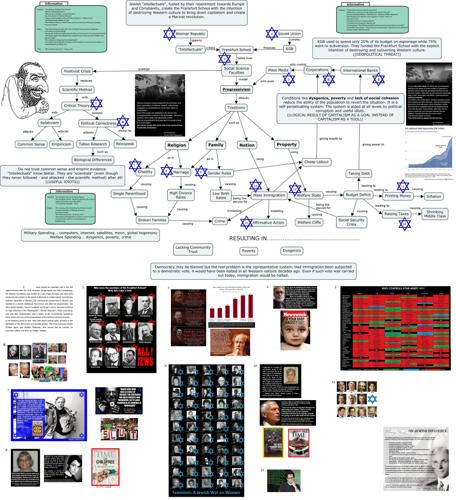

[369/2000] 35e1e1ce0304a11ed24d80b864649e05a26780cc4cd3a7795258755df94aface
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/35e1e1ce0304a11ed24d80b864649e05a26780cc4cd3a7795258755df94aface.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/35e1e1ce0304a11ed24d80b864649e05a26780cc4cd3a7795258755df94aface.gz'
Failed to load target image.
[370/2000] a8ace4dc99684db98246c75e36ddda304231af03ef8088bb5a8d76ff5317d76b
[371/2000] 6e49457183379cfc6c2e2f9d8b59837ef972a528356f1361299f21b9240e1081
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6e49457183379cfc6c2e2f9d8b59837ef972a528356f1361299f21b9240e1081.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6e49457183379cfc6c2e2f9d8b59837ef972a528356f1361299f21b9240e1081.gz'
Failed to load target image.
[372/2000] 6c76b5be249d23bc4bba781f3c00b8aace4fe803a340e34e81c


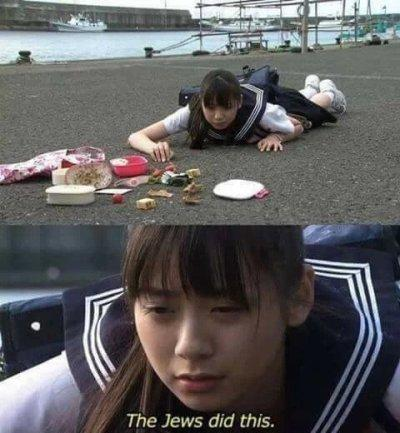

[373/2000] 0859472552b7bec4a3a2a92e7822b4467e7ff85d0433fc97b07e652bc90763b6
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0859472552b7bec4a3a2a92e7822b4467e7ff85d0433fc97b07e652bc90763b6.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0859472552b7bec4a3a2a92e7822b4467e7ff85d0433fc97b07e652bc90763b6.gz'
Failed to load target image.
[374/2000] f14366a417ea764006f298c3f485d157191e3f6401e78736ec1429b98a54d873



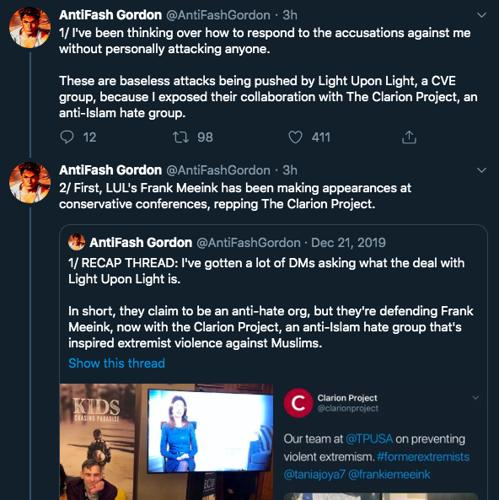

[375/2000] 0358fd7befc258fcdbf80a46994eac881c6453372968b7d98fca8bba7af07684
[376/2000] 365cb11ae3fee7d4f521b6e4f5240bb30400f4e7301b4885b38689c6e5942aba
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/365cb11ae3fee7d4f521b6e4f5240bb30400f4e7301b4885b38689c6e5942aba.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/365cb11ae3fee7d4f521b6e4f5240bb30400f4e7301b4885b38689c6e5942aba.gz'
Failed to load target image.
[377/2000] 5e1c4e053c9f4fd52bc07fe1ba66432cd2882dfd34ebd8bbc8e2d965e11d980e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5e1c4e053c9f4fd52bc07fe1ba66432cd2882dfd34ebd8bbc8e2d965e11d980e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5e1c4e053c9f4fd52bc07fe1ba66432cd2882dfd34ebd8bbc8e2d965e11d980e.gz'
Failed to load target image.
[378/2000] bc68a822718848955c0791cbf124abb6d43e8ab42e3c6e05961


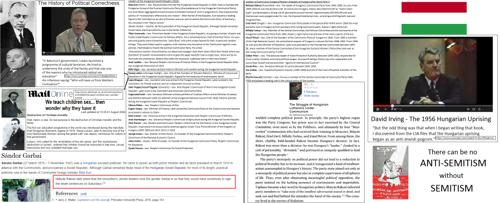

[379/2000] 8051ca67503f5e11214d9ecf4b2d9e43dad3e6a998ecfae406b0bd56f292bf1a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8051ca67503f5e11214d9ecf4b2d9e43dad3e6a998ecfae406b0bd56f292bf1a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8051ca67503f5e11214d9ecf4b2d9e43dad3e6a998ecfae406b0bd56f292bf1a.gz'
Failed to load target image.
[380/2000] a7664582b5fd99bef7b5d00735b5934a00fcd0a53f357d853089245361a80a51
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a7664582b5fd99bef7b5d00735b5934a00fcd0a53f357d853089245361a80a51.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a7664582b5fd99bef7b5d00735b5934a00fcd0a53f357d853089245361a80a51.gz'
Failed to load target image.
[381/2000] e3ade79a634f40e806d106d46ee8b10490b236003744eeb5b9375e439d12487e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


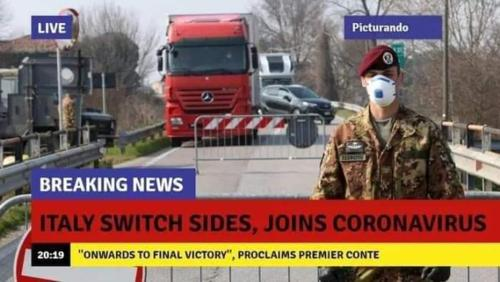

[388/2000] 6769cfc1ffd0750fe857ca37a5329a25ed436e5f500b9b69dd8c9bb3eb145db8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6769cfc1ffd0750fe857ca37a5329a25ed436e5f500b9b69dd8c9bb3eb145db8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6769cfc1ffd0750fe857ca37a5329a25ed436e5f500b9b69dd8c9bb3eb145db8.gz'
Failed to load target image.
[389/2000] 351ed5ede518abdf2d7ea619e368a34c0f43faf5ce55e5f2da8eb3ff4687493c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/351ed5ede518abdf2d7ea619e368a34c0f43faf5ce55e5f2da8eb3ff4687493c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/351ed5ede518abdf2d7ea619e368a34c0f43faf5ce55e5f2da8eb3ff4687493c.gz'
Failed to load target image.
[390/2000] da6615bde68665d77f38f8b26c1052d6b203d47b5e234ae422e99466980f251f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


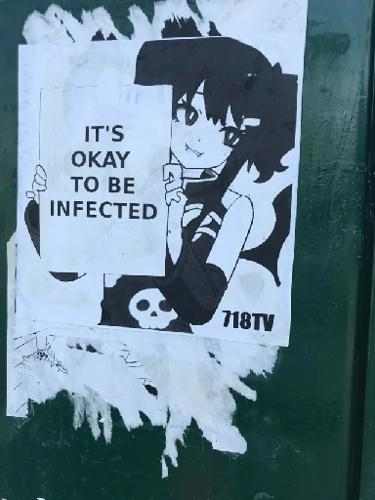

[392/2000] 0ad29c885010dafbcb84da7fb8319432c0c92e13176a65683953847ae97f8c4c
[393/2000] c66b137de6138936f181726f4a632dcc24fdb3e95bc34d1aad4572cbcbc987d0



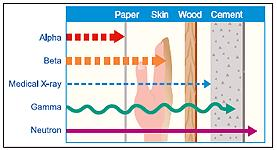

[394/2000] 9fb64db342db7bac3f5913e0757e057abed7507d15b07da523c791b96160722f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9fb64db342db7bac3f5913e0757e057abed7507d15b07da523c791b96160722f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9fb64db342db7bac3f5913e0757e057abed7507d15b07da523c791b96160722f.gz'
Failed to load target image.
[395/2000] a65bec0b3bb0a413e52800a24ba0cebe5837dfea09f9df393bec58a01921db98
[396/2000] 8a2da1c32d6bfb974e2a5ccf32b9a67d9afd3972f87d6c22727987b7a642a9ab
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8a2da1c32d6bfb974e2a5ccf32b9a67d9afd3972f87d6c22727987b7a642a9ab.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8a2da1c32d6bfb974e2a5ccf32b9a67d9afd3972f87d6c22727987b7a642a9ab.gz'
Failed to load target image.
[397/2000] 8c502d739233478b5bd4d6e3d93880609d950d2e0c942cde9ee


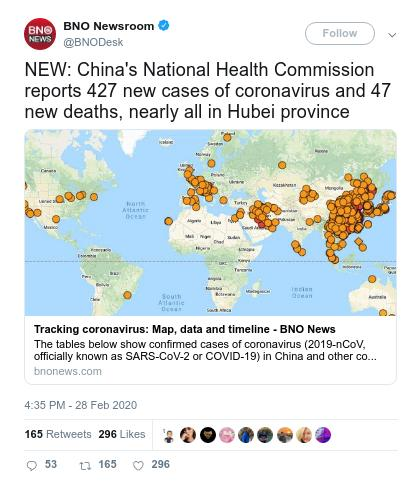

[399/2000] 0101bc8c3fa38a63522814e4842d57e61a580db62f968da80cd9909002799d35
[400/2000] 6c8bf6ae1b78067e1a2923b5c27a65754b230951410d2e394974ee02764c2a42
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6c8bf6ae1b78067e1a2923b5c27a65754b230951410d2e394974ee02764c2a42.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6c8bf6ae1b78067e1a2923b5c27a65754b230951410d2e394974ee02764c2a42.gz'
Failed to load target image.
[401/2000] 77f0f551775692b278944b3279f904301e39e7b39afa0203337bc4cdcf4bdbb4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/77f0f551775692b278944b3279f904301e39e7b39afa0203337bc4cdcf4bdbb4.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/77f0f551775692b278944b3279f904301e39e7b39afa0203337bc4cdcf4bdbb4.gz'
Failed to load target image.
[402/2000] 10c93c04b40bdabdb0c79e0d615d9afbe5e1d645115d4b81218


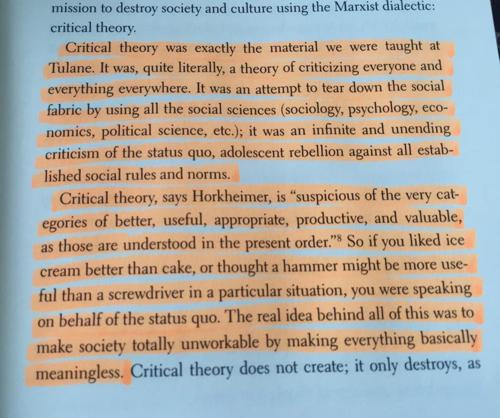

[403/2000] f4797b968be90c4d3955809a80b30bfbe4404b6e051172102fe4ec22ca62db2a



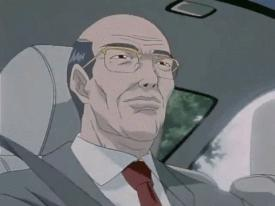

[404/2000] b6562a7edf8332035fc20e3877f4975e50bf979344f016973b6e859fb9402524
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b6562a7edf8332035fc20e3877f4975e50bf979344f016973b6e859fb9402524.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b6562a7edf8332035fc20e3877f4975e50bf979344f016973b6e859fb9402524.gz'
Failed to load target image.
[405/2000] d957dfa61b41001ed00954d22a187efc0c706fb211b481a25e2e66b983cfcd3b



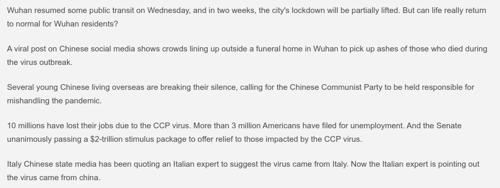

[406/2000] a2243d8ac8bc07e995b5f0e6bcb122381a4fe82d601384dc9eb7b288df155b4c
[407/2000] 7f41f0d68cae66a36366106b6610a4595472926eede6183cba66976ca0707651
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7f41f0d68cae66a36366106b6610a4595472926eede6183cba66976ca0707651.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7f41f0d68cae66a36366106b6610a4595472926eede6183cba66976ca0707651.gz'
Failed to load target image.
[408/2000] a4c84df025c94cc2fbdc5a76350b97a8aff4b5388cefe42bce6edddcbcfc6e6e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a4c84df025c94cc2fbdc5a76350b97a8aff4b5388cefe42bce6edddcbcfc6e6e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a4c84df025c94cc2fbdc5a76350b97a8aff4b5388cefe42bce6edddcbcfc6e6e.gz'
Failed to load target image.
[409/2000] f46facd1258516a9b14d619e7e9b88134884b7213ee0663ce37


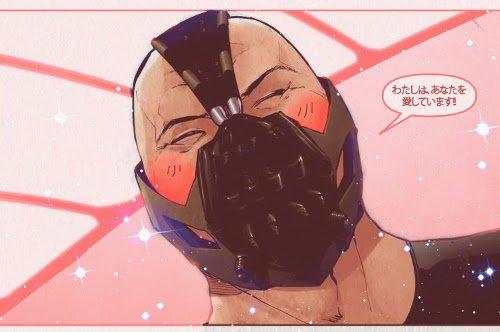

[411/2000] c3f8e9daba880f6a522919b9723061a9244211c54d79f2eba2b04a1d462fc922
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c3f8e9daba880f6a522919b9723061a9244211c54d79f2eba2b04a1d462fc922.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c3f8e9daba880f6a522919b9723061a9244211c54d79f2eba2b04a1d462fc922.gz'
Failed to load target image.
[412/2000] a703914fedf753c491cff776fca2eb59a59f5d13f3dbf05e15b372e579229fc0
[413/2000] e8fc7bed8a87629dd2332e03458d99498cac8d0b749f304bc92cd8983f7b9207
[414/2000] 21f4bd59e7abea3b1c3bc248692fabc535ffa68a2320346222c2636019ddcefd
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/21f4bd59e7abea3b1c3bc248692fabc535ffa68a2320346222c2636019ddcefd.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/21f4bd59e7abea3b1c3bc248692fabc535ffa68a2320346222c2636019ddcefd.gz'
Failed to load 


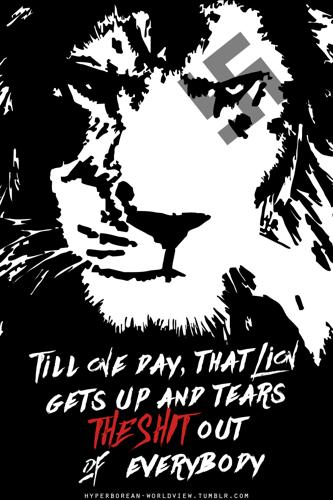

[416/2000] 20ab31b7a6a4e27ad907cc60170fba66ab259c82e34f443a8efe4a41d0ef3e59
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/20ab31b7a6a4e27ad907cc60170fba66ab259c82e34f443a8efe4a41d0ef3e59.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/20ab31b7a6a4e27ad907cc60170fba66ab259c82e34f443a8efe4a41d0ef3e59.gz'
Failed to load target image.
[417/2000] 2ada5fbc01bd96e93ee8385b4e0ac98a369bbac0e1b1adc48e9c53ac28ebe130
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2ada5fbc01bd96e93ee8385b4e0ac98a369bbac0e1b1adc48e9c53ac28ebe130.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2ada5fbc01bd96e93ee8385b4e0ac98a369bbac0e1b1adc48e9c53ac28ebe130.gz'
Failed to load target image.
[418/2000] 6304be7d5ed8a17f02bd459c819c255d86c062d6c8d22da8b85b8435a6d855b3
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


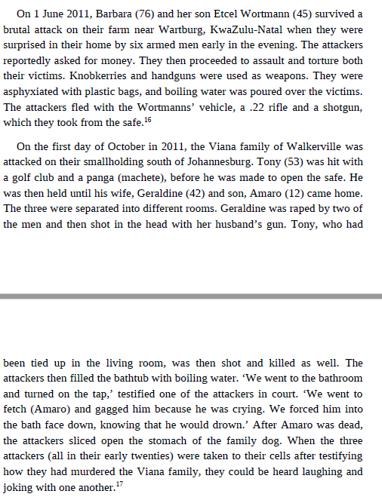

[423/2000] 6223e1431e949da0ace622cb6270c983dd1c64597c0291e678c36c2cef0a9658
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6223e1431e949da0ace622cb6270c983dd1c64597c0291e678c36c2cef0a9658.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6223e1431e949da0ace622cb6270c983dd1c64597c0291e678c36c2cef0a9658.gz'
Failed to load target image.
[424/2000] 3c6c9b04397272c99373e447c1d70a45b4971e35e9b7b861a44404ca926c47f2
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3c6c9b04397272c99373e447c1d70a45b4971e35e9b7b861a44404ca926c47f2.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3c6c9b04397272c99373e447c1d70a45b4971e35e9b7b861a44404ca926c47f2.gz'
Failed to load target image.
[425/2000] 34f43209b3cadc26d965043258409cfcf0c7bf2d8321c562300898027a862acc



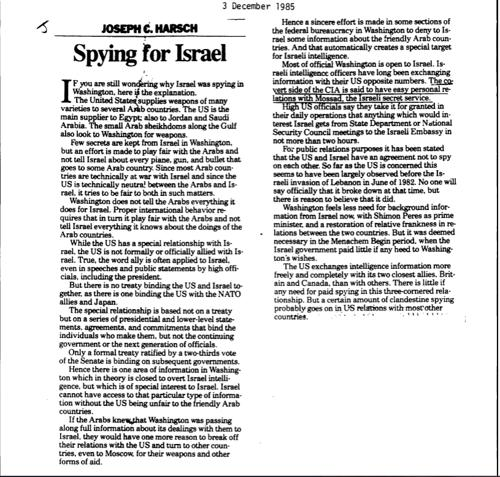

[426/2000] 631db4f1362f1599735cd47c23508e3b28071074973793e85e4fd0fc901edf6d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/631db4f1362f1599735cd47c23508e3b28071074973793e85e4fd0fc901edf6d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/631db4f1362f1599735cd47c23508e3b28071074973793e85e4fd0fc901edf6d.gz'
Failed to load target image.
[427/2000] 26bbe07af1e5005e60073796ccd1226874208c963f200f9be2f23ed665f34737



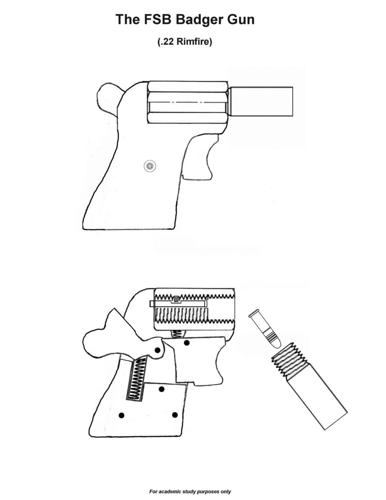

[428/2000] b3f49e55e8fce91a7e5e2c860c8b47e46c172c6dd250eeb194e9f72e96c4aa41



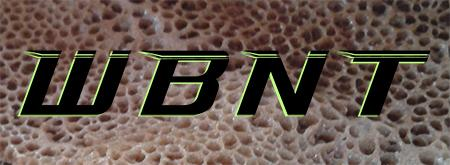

[429/2000] 53df66bf58d98380fae24e3a402868a7b5cbc2e75b9e261768577714ecb82bc7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/53df66bf58d98380fae24e3a402868a7b5cbc2e75b9e261768577714ecb82bc7.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/53df66bf58d98380fae24e3a402868a7b5cbc2e75b9e261768577714ecb82bc7.gz'
Failed to load target image.
[430/2000] 8e7bccfbd78b650bee938dd4f0e61e6b9abcdaefa7e5a1acda7dd6b08aa5b471
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8e7bccfbd78b650bee938dd4f0e61e6b9abcdaefa7e5a1acda7dd6b08aa5b471.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8e7bccfbd78b650bee938dd4f0e61e6b9abcdaefa7e5a1acda7dd6b08aa5b471.gz'
Failed to load target image.
[431/2000] d8825f61b94c77498148536fdcadba9865a2655aa30bf08c4334243c14ae8434



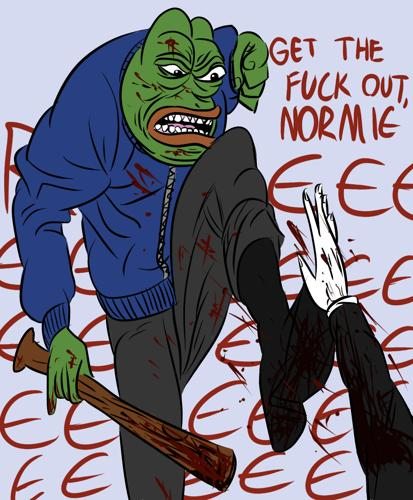

[432/2000] f9f89d063822454919bb2732eb649b55433f0a1f1ed15fa26b4ebc03ae1a5c0d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f9f89d063822454919bb2732eb649b55433f0a1f1ed15fa26b4ebc03ae1a5c0d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f9f89d063822454919bb2732eb649b55433f0a1f1ed15fa26b4ebc03ae1a5c0d.gz'
Failed to load target image.
[433/2000] 1c92a751fd19629b304cdcb048bad2c071716ac82eb652f2b42904294ecaeb03
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1c92a751fd19629b304cdcb048bad2c071716ac82eb652f2b42904294ecaeb03.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1c92a751fd19629b304cdcb048bad2c071716ac82eb652f2b42904294ecaeb03.gz'
Failed to load target image.
[434/2000] 19092302b502a95f1931dc6bf0930bdab790217bbf32975edb5919243e8d874f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


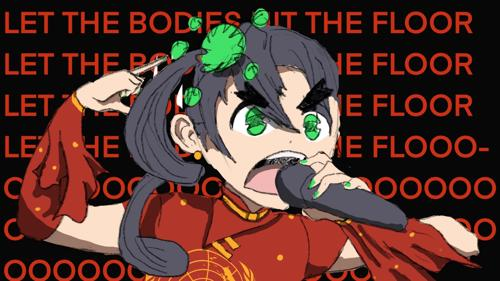

[446/2000] 2753bc53cc974c82f06e3cb7817c526fd5a7e197fd59846aec0e0fbd8c1c85dc
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2753bc53cc974c82f06e3cb7817c526fd5a7e197fd59846aec0e0fbd8c1c85dc.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2753bc53cc974c82f06e3cb7817c526fd5a7e197fd59846aec0e0fbd8c1c85dc.gz'
Failed to load target image.
[447/2000] 23c85e3315a3ec94241ac8b286e73f3658a09f90a19836464c420d9095fd8134
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/23c85e3315a3ec94241ac8b286e73f3658a09f90a19836464c420d9095fd8134.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/23c85e3315a3ec94241ac8b286e73f3658a09f90a19836464c420d9095fd8134.gz'
Failed to load target image.
[448/2000] a3cbe4b98836695aa34f38fd9060eea6eb285c51f0c9a097391b656b5aa759a5
[449/2000] ec3a7de77aeb64fd9fa72552d9288db130279650a9754f513b8


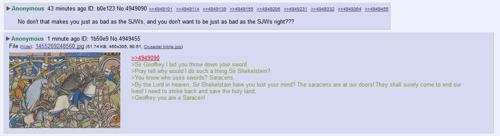

[450/2000] 712fdbb331ab4ecde559dcbde303647afaa9a5c7722f0ed9635c9a596d9c0b48
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/712fdbb331ab4ecde559dcbde303647afaa9a5c7722f0ed9635c9a596d9c0b48.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/712fdbb331ab4ecde559dcbde303647afaa9a5c7722f0ed9635c9a596d9c0b48.gz'
Failed to load target image.
[451/2000] 33358a158bcc07bf3bc8cbb7d4474d304b1c7264a71a3545ef1384a9ce47b303
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/33358a158bcc07bf3bc8cbb7d4474d304b1c7264a71a3545ef1384a9ce47b303.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/33358a158bcc07bf3bc8cbb7d4474d304b1c7264a71a3545ef1384a9ce47b303.gz'
Failed to load target image.
[452/2000] 84f6ea2cc8194e62d702d4eb7f98983e15233c1821341ac9f7a3b085d5864440
[453/2000] 5ac40e657f9f8d34f59843b136d753a0d5d2f74d08609f267dc


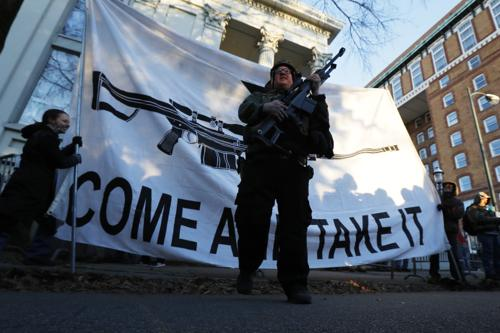

[454/2000] 5c48eb93420ac3ee23dcb592a91600fc44c55f74e0dd942d9d2d8fb9186f72c5
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5c48eb93420ac3ee23dcb592a91600fc44c55f74e0dd942d9d2d8fb9186f72c5.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5c48eb93420ac3ee23dcb592a91600fc44c55f74e0dd942d9d2d8fb9186f72c5.gz'
Failed to load target image.
[455/2000] cda5cb517777edbe3f706231fcec9fc3869a99897329ff4da3c9621bc98ef9c5
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cda5cb517777edbe3f706231fcec9fc3869a99897329ff4da3c9621bc98ef9c5.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cda5cb517777edbe3f706231fcec9fc3869a99897329ff4da3c9621bc98ef9c5.gz'
Failed to load target image.
[456/2000] f6173e31f3dc87274ad4f8446f1c51c83101a2c3963fa909857a8552110f815e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


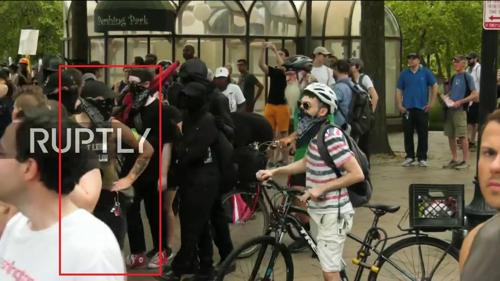

[458/2000] 1257e15ccf1947e35fc9848bb91833106ddeac1de5affa2a84ff93af4a694042
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1257e15ccf1947e35fc9848bb91833106ddeac1de5affa2a84ff93af4a694042.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1257e15ccf1947e35fc9848bb91833106ddeac1de5affa2a84ff93af4a694042.gz'
Failed to load target image.
[459/2000] 35b2381a8a660f90a429fa642091672ea71832fa38a057b897b76eb2a16141e7
[460/2000] e4a05f34a38f7007985537e3227083b541d32d1118be68399cf56577cdf98f7f
[461/2000] e1047e36fa5f3de8a3c946a1cccbc0f2ff3b3f7d0c8dc2b6491ba09a532c93f1



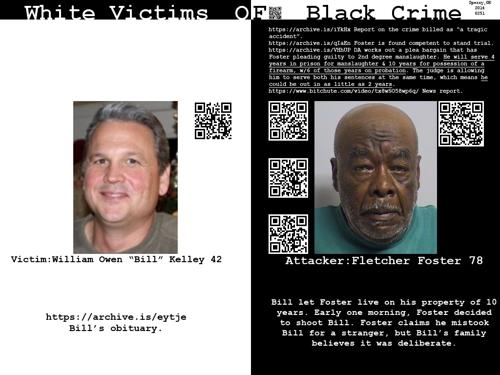

[462/2000] 7bd959c8b8195053a16952b4c906ed736fffb44b3b58994b08884a4ded826571
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7bd959c8b8195053a16952b4c906ed736fffb44b3b58994b08884a4ded826571.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7bd959c8b8195053a16952b4c906ed736fffb44b3b58994b08884a4ded826571.gz'
Failed to load target image.
[463/2000] 32350d5c9cc95ac5321b7094160bd3eade651f09154791fc3d4985e4b513ffe7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/32350d5c9cc95ac5321b7094160bd3eade651f09154791fc3d4985e4b513ffe7.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/32350d5c9cc95ac5321b7094160bd3eade651f09154791fc3d4985e4b513ffe7.gz'
Failed to load target image.
[464/2000] c68fe2a50af028fcc58dbde7059da8d67368eeff8f35f5da8a5a15504c1bfe6b
[465/2000] c42e31d7139620fc1ddc3d683eedeea80a7f05cfece1407b7d6


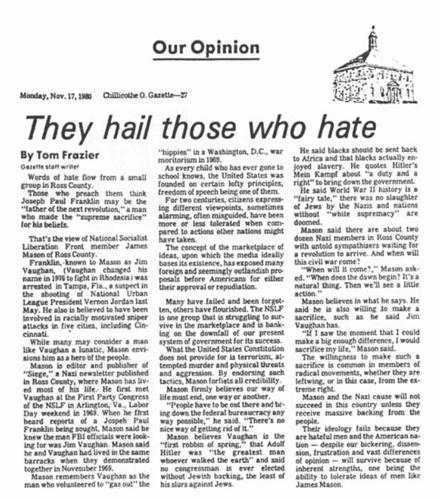

[468/2000] 22670a39eaa46de0d34a7cda1bd8c8831fb4dc93f3c8472f375d9e980b18d746
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/22670a39eaa46de0d34a7cda1bd8c8831fb4dc93f3c8472f375d9e980b18d746.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/22670a39eaa46de0d34a7cda1bd8c8831fb4dc93f3c8472f375d9e980b18d746.gz'
Failed to load target image.
[469/2000] d38ab6d0281332d042bbd55abb94dd34f79f3f09746c0bf573942a6c1c216e8c



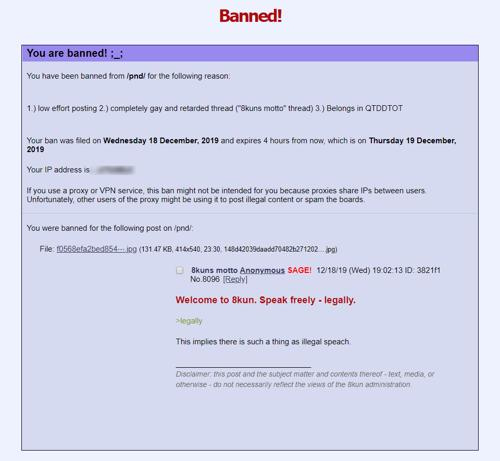

[470/2000] 275e0d8726cc544d29238e3b0fa103ea970e2eefade0553887914c17dafdf187
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/275e0d8726cc544d29238e3b0fa103ea970e2eefade0553887914c17dafdf187.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/275e0d8726cc544d29238e3b0fa103ea970e2eefade0553887914c17dafdf187.gz'
Failed to load target image.
[471/2000] 94e2e544e548cb51e0ba3b68f64019d626c6c06df2b4fb2eb202660070aa4ca2
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/94e2e544e548cb51e0ba3b68f64019d626c6c06df2b4fb2eb202660070aa4ca2.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/94e2e544e548cb51e0ba3b68f64019d626c6c06df2b4fb2eb202660070aa4ca2.gz'
Failed to load target image.
[472/2000] 15eca320b6d1ed82f4fc01bf16b960e14440340fa3e8a67460ce0520e53866eb
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


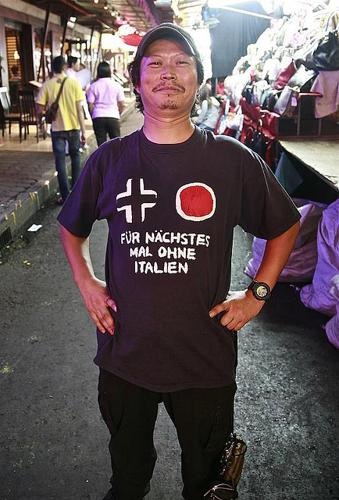

[486/2000] 5c6e525e34910c8e81fdbbc84f8a7e773770d16e309968c16c80e1fff95da2f3
[487/2000] 202875bdd87520b06f2298aa0e0720f9331e7787335da16e52b3781e74781b15
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/202875bdd87520b06f2298aa0e0720f9331e7787335da16e52b3781e74781b15.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/202875bdd87520b06f2298aa0e0720f9331e7787335da16e52b3781e74781b15.gz'
Failed to load target image.
[488/2000] cf9d908ce59c30ee8e98453da72528d0af40a4331fa456fe4e86b33f1ff4fb5d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cf9d908ce59c30ee8e98453da72528d0af40a4331fa456fe4e86b33f1ff4fb5d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cf9d908ce59c30ee8e98453da72528d0af40a4331fa456fe4e86b33f1ff4fb5d.gz'
Failed to load target image.
[489/2000] a2bb4e11e1ba97247beb70257492342d5e4f3a4cba0691af7fe


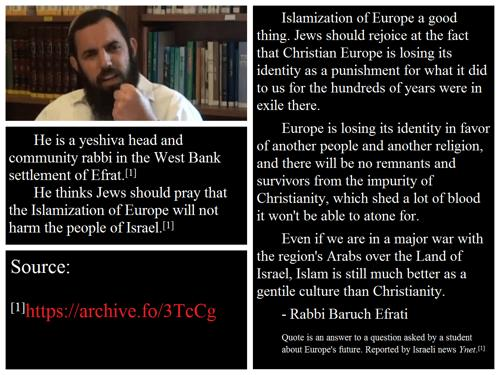

[490/2000] 1c7516b2dd398b6ca4f6fa2a13ba607829ffb0a462e1fde7347dffc4e63865a3
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1c7516b2dd398b6ca4f6fa2a13ba607829ffb0a462e1fde7347dffc4e63865a3.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1c7516b2dd398b6ca4f6fa2a13ba607829ffb0a462e1fde7347dffc4e63865a3.gz'
Failed to load target image.
[491/2000] 0fc8bc839284a87d989345d51d9a0e04cfda25ecae687908fc22638e967f2a49



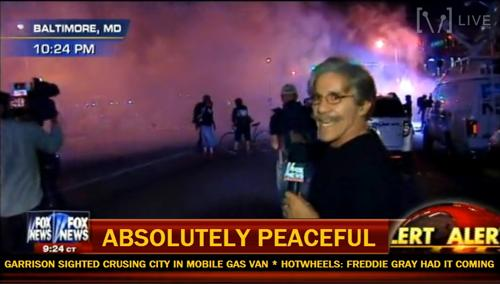

[492/2000] b90b0262752e3f675f455b7e7206f9075e07676d524b4a035feadb061648bb68
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b90b0262752e3f675f455b7e7206f9075e07676d524b4a035feadb061648bb68.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b90b0262752e3f675f455b7e7206f9075e07676d524b4a035feadb061648bb68.gz'
Failed to load target image.
[493/2000] 3da64a1993a89a81e86709376346fa40845680e9c1ecc87a9d35c505375c2bb8
[494/2000] 26549efb75d0f24d67166c9838db4011d4768cc8e04ed739afcbbccf4f079231
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/26549efb75d0f24d67166c9838db4011d4768cc8e04ed739afcbbccf4f079231.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/26549efb75d0f24d67166c9838db4011d4768cc8e04ed739afcbbccf4f079231.gz'
Failed to load target image.
[495/2000] 55d2bd2c8cf072b5095544caa30e419e061b21713b8e4c67f1c


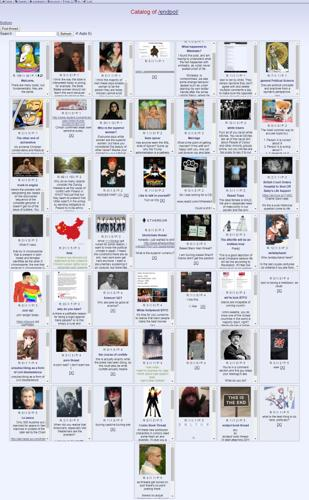

[500/2000] 6d8902003565d0544404f354f29a0beb2a90718222685020fb02908b72b56ce9
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6d8902003565d0544404f354f29a0beb2a90718222685020fb02908b72b56ce9.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6d8902003565d0544404f354f29a0beb2a90718222685020fb02908b72b56ce9.gz'
Failed to load target image.
[501/2000] 7159dbce63d78c930e6c92cbd294ed893682becb8005ad3bede40115cd75e704
[502/2000] eb9b935865699f33b2897e6bc220021904129cfdebad08a66cd8cf9b734a52df



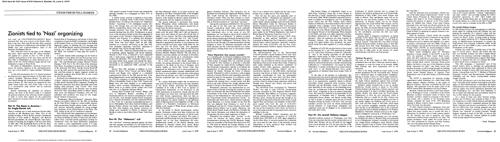

[503/2000] 691fb759195172dd5e01aa9e5a70530db079167831642f3cbe9d82c5a9d36070
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/691fb759195172dd5e01aa9e5a70530db079167831642f3cbe9d82c5a9d36070.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/691fb759195172dd5e01aa9e5a70530db079167831642f3cbe9d82c5a9d36070.gz'
Failed to load target image.
[504/2000] 6b1d831ffca5dd0c18b834f5de4fbfaec3b73fbd66855a0fc2ad206f2e8455a1
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6b1d831ffca5dd0c18b834f5de4fbfaec3b73fbd66855a0fc2ad206f2e8455a1.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6b1d831ffca5dd0c18b834f5de4fbfaec3b73fbd66855a0fc2ad206f2e8455a1.gz'
Failed to load target image.
[505/2000] e180cb558cdb1d94578843b849e7edf5a5da6e7e81b078b66f3bf12d75d3d6db



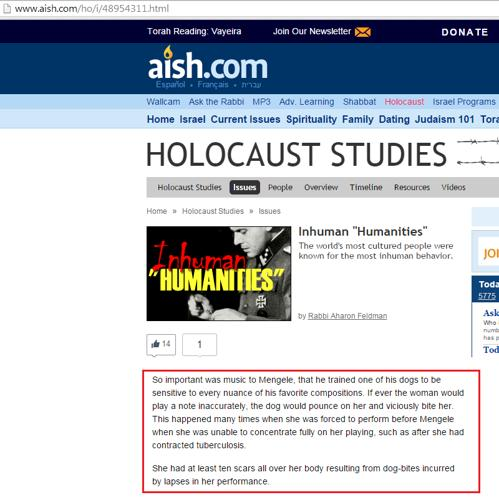

[506/2000] 1e6c21ba5c6971964208de1aa77cc3eccc338467a1f6ae4bea6a191ddab011ab
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1e6c21ba5c6971964208de1aa77cc3eccc338467a1f6ae4bea6a191ddab011ab.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1e6c21ba5c6971964208de1aa77cc3eccc338467a1f6ae4bea6a191ddab011ab.gz'
Failed to load target image.
[507/2000] 27386ae96ff800413f91bfb9b8aea8681e15d778e27f19044b120aa0126190d8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/27386ae96ff800413f91bfb9b8aea8681e15d778e27f19044b120aa0126190d8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/27386ae96ff800413f91bfb9b8aea8681e15d778e27f19044b120aa0126190d8.gz'
Failed to load target image.
[508/2000] 9988863ea969fc6f999364b86805ef3b11e553b910e61ac518d0b45b29efbf3b



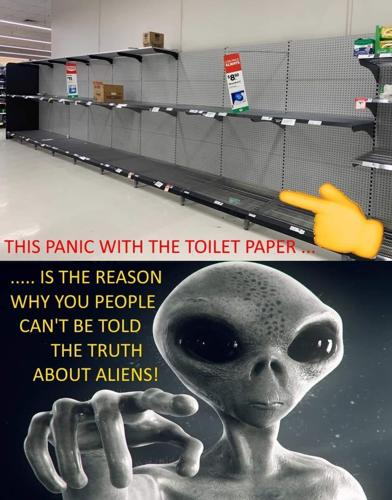

[509/2000] ece79765215c1ccda72a82749980664f6691e869c7769c0f3cc33aea745d25ea
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ece79765215c1ccda72a82749980664f6691e869c7769c0f3cc33aea745d25ea.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ece79765215c1ccda72a82749980664f6691e869c7769c0f3cc33aea745d25ea.gz'
Failed to load target image.
[510/2000] b7ff450f6fcc55e3d1fd55a7eb486e60a921ee53a3cad524d5808dcafb2f6a13
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b7ff450f6fcc55e3d1fd55a7eb486e60a921ee53a3cad524d5808dcafb2f6a13.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b7ff450f6fcc55e3d1fd55a7eb486e60a921ee53a3cad524d5808dcafb2f6a13.gz'
Failed to load target image.
[511/2000] fc1c8104fae78dc2178bb071fa6b305ff248b033781bfd5a69b057433b2b4deb
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


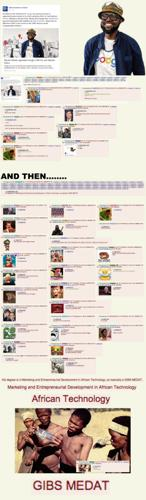

[517/2000] fc8d7bdd571d4ef49e05a6636a11a659e9d69e063e8550a58793551a743954e3
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fc8d7bdd571d4ef49e05a6636a11a659e9d69e063e8550a58793551a743954e3.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fc8d7bdd571d4ef49e05a6636a11a659e9d69e063e8550a58793551a743954e3.gz'
Failed to load target image.
[518/2000] 173140cc0937e3829302d2b14d1310bd9800b1d043a70331776eaabdc886344c
[519/2000] a01bd27333d6b639b3db967f6e00703d5f2e6d39afc16c63d05e88967a86fa8c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a01bd27333d6b639b3db967f6e00703d5f2e6d39afc16c63d05e88967a86fa8c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a01bd27333d6b639b3db967f6e00703d5f2e6d39afc16c63d05e88967a86fa8c.gz'
Failed to load target image.
[520/2000] cfeca339947d0e95dd930e3d26fee8d37cd7b4e9d846474e3c0


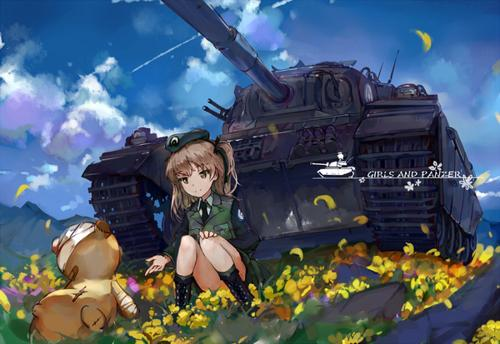

[521/2000] bcab018b4ab7eb607e49aa95ed06f57cddd43223ad34f4eaac32e1ac50d58a69
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bcab018b4ab7eb607e49aa95ed06f57cddd43223ad34f4eaac32e1ac50d58a69.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bcab018b4ab7eb607e49aa95ed06f57cddd43223ad34f4eaac32e1ac50d58a69.gz'
Failed to load target image.
[522/2000] 9bca1fe48abefd4f4433455cbe3914dfaf8b425520c067fda13214c23cfa0268
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9bca1fe48abefd4f4433455cbe3914dfaf8b425520c067fda13214c23cfa0268.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9bca1fe48abefd4f4433455cbe3914dfaf8b425520c067fda13214c23cfa0268.gz'
Failed to load target image.
[523/2000] b036061a9e8a66af167f3cfea579917dd04d612e0d9dbc42ce21b4b32455ccba



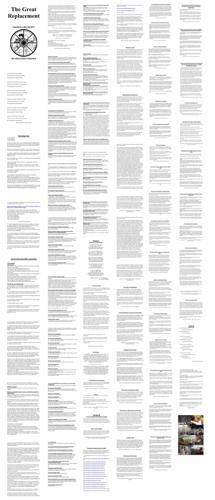

[524/2000] 472f360e8119131a4ab1400460a7db2f5786ad6e0941da736a1f13cc8ec3e91f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/472f360e8119131a4ab1400460a7db2f5786ad6e0941da736a1f13cc8ec3e91f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/472f360e8119131a4ab1400460a7db2f5786ad6e0941da736a1f13cc8ec3e91f.gz'
Failed to load target image.
[525/2000] 3cebeaec946c2d574a2ff4c32a84784241e6b522352046deecb300f903fd9ec5
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3cebeaec946c2d574a2ff4c32a84784241e6b522352046deecb300f903fd9ec5.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3cebeaec946c2d574a2ff4c32a84784241e6b522352046deecb300f903fd9ec5.gz'
Failed to load target image.
[526/2000] 31c291e67bea2b40a28ad12d2a1aa0fc762e279b9ac0e4b2e72db6187324702a
[527/2000] 2db4d53dfa1e4e5ca8ebe3b5d764bdef6f53a3e5ae3e6abb3e8


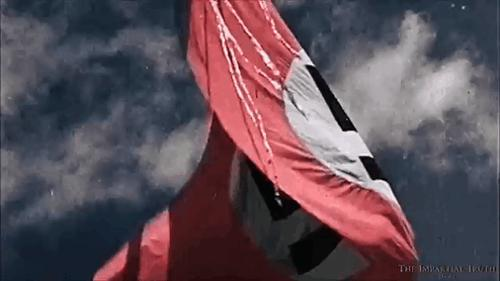

[532/2000] af759217d4e246f2ec5746bd21fd8115d30375c77a039ea2ed37207b60173845



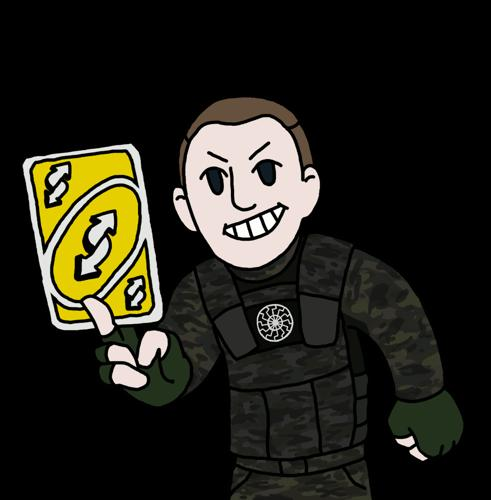

[533/2000] ca67d328dcb6f89e06c049c9cdccbd3656492e7d907c323bddbcb86cc57dd974
[534/2000] 59c978a82c4d5a6a008532b441fcc38ddd881f357096940fc59b739bcdfef83f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/59c978a82c4d5a6a008532b441fcc38ddd881f357096940fc59b739bcdfef83f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/59c978a82c4d5a6a008532b441fcc38ddd881f357096940fc59b739bcdfef83f.gz'
Failed to load target image.
[535/2000] bfcea64b9534d005c495a24890ca1631a96d837482bf342f46f8d4513802a422
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bfcea64b9534d005c495a24890ca1631a96d837482bf342f46f8d4513802a422.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bfcea64b9534d005c495a24890ca1631a96d837482bf342f46f8d4513802a422.gz'
Failed to load target image.
[536/2000] 86cc45fc6b5a5af2dbbd6ba39340465e285b22a44ba3e6b20dc


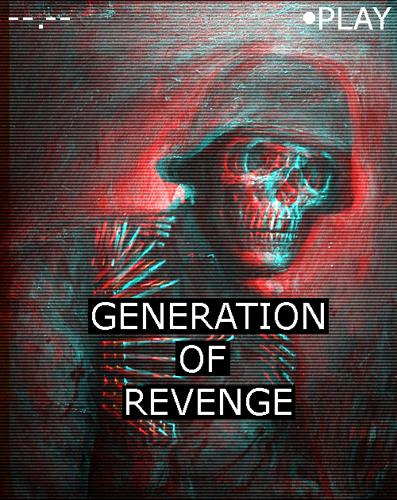

[538/2000] 7a6082ace013fbcb7294e84b05694542f6cfa0a83d9d031533be9067d4d0cba2
[539/2000] 35e8e66afc3df500de9b10571df7565e058b0d694f6dc8522704820a0ce84333
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/35e8e66afc3df500de9b10571df7565e058b0d694f6dc8522704820a0ce84333.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/35e8e66afc3df500de9b10571df7565e058b0d694f6dc8522704820a0ce84333.gz'
Failed to load target image.
[540/2000] 797177ab2a8a8938bbeb4a2f30f4c1d0687391ed5a2a975360622db839e6a81e
[541/2000] 0955cc5cf8faf4ace6c4226071c33f914236c71787718e584585335762a52e7c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0955cc5cf8faf4ace6c4226071c33f914236c71787718e584585335762a52e7c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0955cc5cf8faf4ace6c4226071c33f914236c71787718e584585335762a52e7c.gz'
Failed to load 


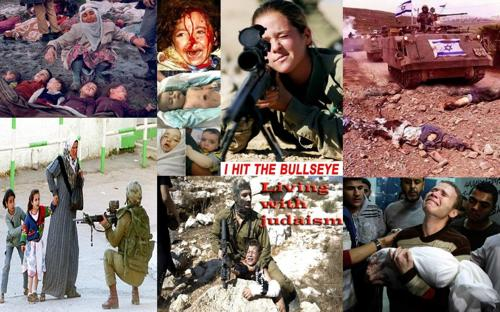

[548/2000] bcfb2d5d639f85372226d0e0315b99d333a31a63f8e3be7864eceae718471eaa



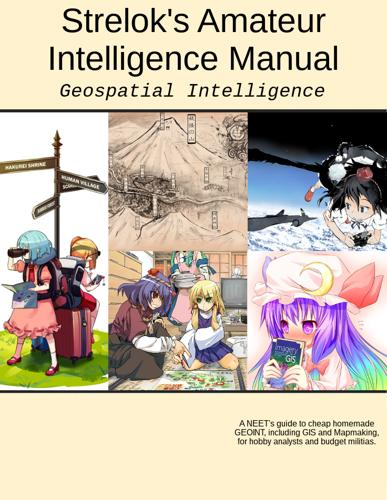

[549/2000] 4a09539fc739f511dd3eb343d4d4a3285f39d249e898d5f5fb1b11961b4fc0fd
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4a09539fc739f511dd3eb343d4d4a3285f39d249e898d5f5fb1b11961b4fc0fd.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4a09539fc739f511dd3eb343d4d4a3285f39d249e898d5f5fb1b11961b4fc0fd.gz'
Failed to load target image.
[550/2000] 81c0f2cd81600ea4c91330016e08d4d984aaae714301839479b42118601595e3
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/81c0f2cd81600ea4c91330016e08d4d984aaae714301839479b42118601595e3.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/81c0f2cd81600ea4c91330016e08d4d984aaae714301839479b42118601595e3.gz'
Failed to load target image.
[551/2000] 196db10863c4e4b38090b43092f22a7f252730bfcbe846a599aa99f37817844f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


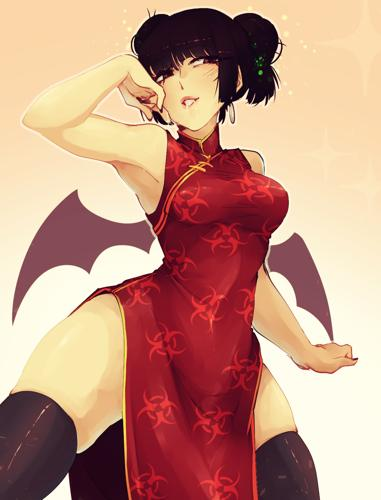

[554/2000] d9a2e119fd8b96e2ffe233c390b48c306edf793ce7f8a0b2ea981f0a8005129f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d9a2e119fd8b96e2ffe233c390b48c306edf793ce7f8a0b2ea981f0a8005129f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d9a2e119fd8b96e2ffe233c390b48c306edf793ce7f8a0b2ea981f0a8005129f.gz'
Failed to load target image.
[555/2000] 245e6eda56229509c0424882d677d0c4f917dd30f8ee4740ade44aceeabf42fd
[556/2000] e504e3a086fb596d68906706a3ede70bbf53144e349beb4de1f1a2e98162dfbd



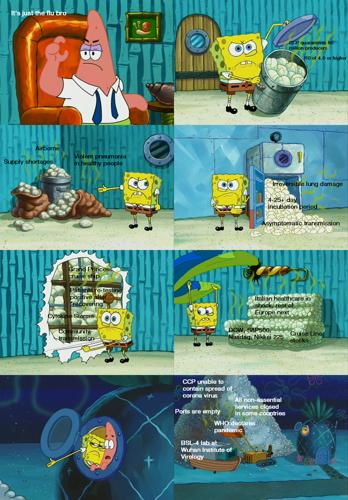

[557/2000] 7914ac5ccb87c72201446aee06c76dee1a5e9bda9734713763db0a2d70f3d1a4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7914ac5ccb87c72201446aee06c76dee1a5e9bda9734713763db0a2d70f3d1a4.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7914ac5ccb87c72201446aee06c76dee1a5e9bda9734713763db0a2d70f3d1a4.gz'
Failed to load target image.
[558/2000] a421322fd5233337411d358d559bb89228f6535aad429a44eb844f604310d781
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a421322fd5233337411d358d559bb89228f6535aad429a44eb844f604310d781.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a421322fd5233337411d358d559bb89228f6535aad429a44eb844f604310d781.gz'
Failed to load target image.
[559/2000] 36ba8919520afebaca99f80854b842cce42fb2bbe977de4f113bc856073b6243
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


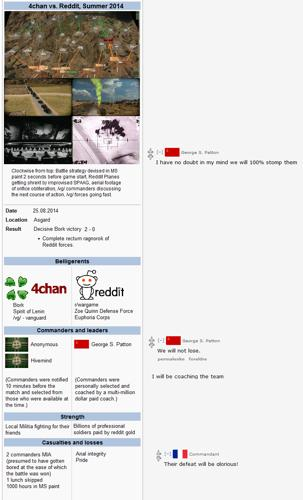

[561/2000] 0fe8de814e0cf12fff91c4a937f2036478f652ecdccd93a9ff5875b63fcb31c5
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0fe8de814e0cf12fff91c4a937f2036478f652ecdccd93a9ff5875b63fcb31c5.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0fe8de814e0cf12fff91c4a937f2036478f652ecdccd93a9ff5875b63fcb31c5.gz'
Failed to load target image.
[562/2000] 9faf3f01a4d5e287f23ee9886d5473223845be253047808c800b06e04a4c6fff
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9faf3f01a4d5e287f23ee9886d5473223845be253047808c800b06e04a4c6fff.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9faf3f01a4d5e287f23ee9886d5473223845be253047808c800b06e04a4c6fff.gz'
Failed to load target image.
[563/2000] 17e2155982a304eea43228d3f64d3e00610941d82da3d4ee324dc38576f20bd8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


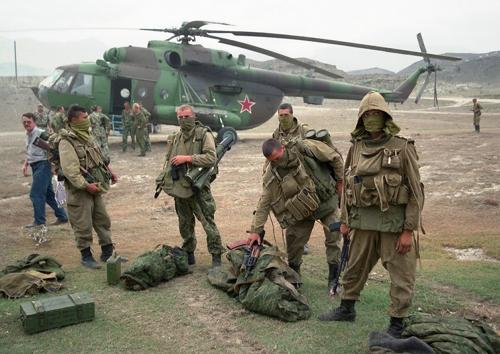

[567/2000] feab4a32ff854bd5f720e1d75a25d6318eb77936236eab4f3d03526729523990
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/feab4a32ff854bd5f720e1d75a25d6318eb77936236eab4f3d03526729523990.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/feab4a32ff854bd5f720e1d75a25d6318eb77936236eab4f3d03526729523990.gz'
Failed to load target image.
[568/2000] bb5a87f95b8999ed4a9e9d0bf196989f3e71c774fa9b37d67a22dbeb8f3d67c4



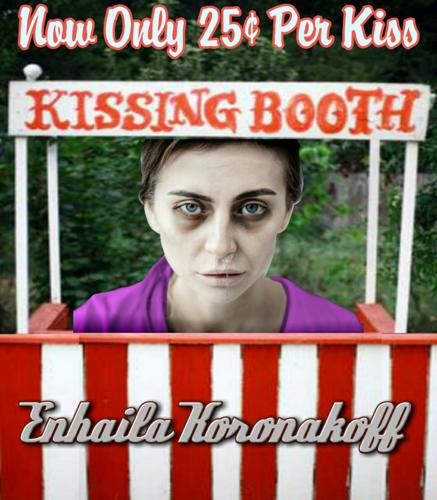

[569/2000] 8bc6b7ffc385812bd8f9f8733f74f940ae4df1341fbce68b1a457bcf6ef5846b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8bc6b7ffc385812bd8f9f8733f74f940ae4df1341fbce68b1a457bcf6ef5846b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8bc6b7ffc385812bd8f9f8733f74f940ae4df1341fbce68b1a457bcf6ef5846b.gz'
Failed to load target image.
[570/2000] 114ad828c7e443a27d6b804bb504d413ebfc2da3bb6a46acb5935e865fcbabbd



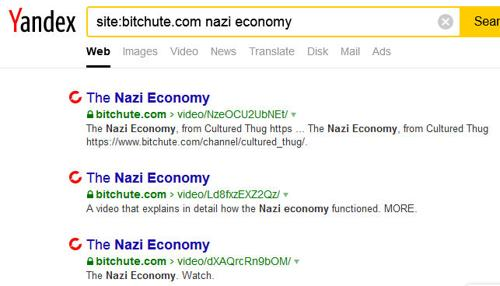

[571/2000] 2112ce63cc007c5af07bada8aec75545abcca89a65e6689d8e753e5f2f9693f4



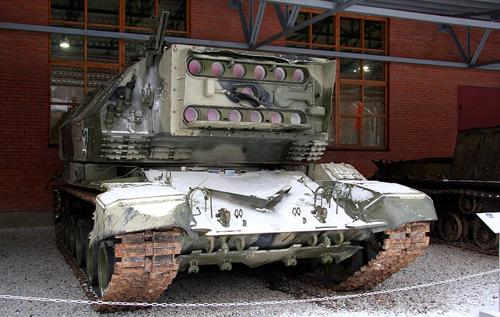

[572/2000] a4d8234378b62525762250140cf4d8de2153a99d9a50c606812f94ea90d7d483



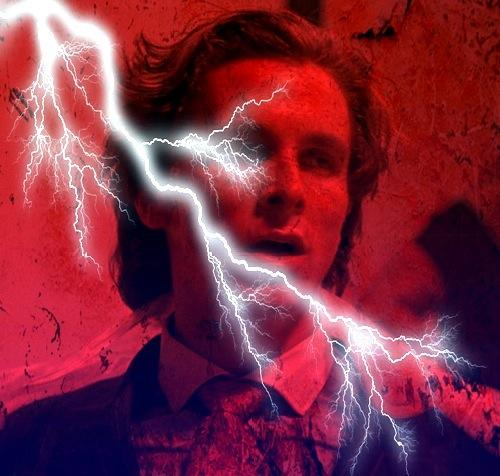

[573/2000] b1f175adf30d61ddb9cec68117b201529898394ec8500f5d8ee524e1ab6fbe6b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b1f175adf30d61ddb9cec68117b201529898394ec8500f5d8ee524e1ab6fbe6b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b1f175adf30d61ddb9cec68117b201529898394ec8500f5d8ee524e1ab6fbe6b.gz'
Failed to load target image.
[574/2000] e6e59604c1e4d2f011eeff4437ab4ce1cc8118588f79d0558cdc914b187ba269
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e6e59604c1e4d2f011eeff4437ab4ce1cc8118588f79d0558cdc914b187ba269.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e6e59604c1e4d2f011eeff4437ab4ce1cc8118588f79d0558cdc914b187ba269.gz'
Failed to load target image.
[575/2000] e0f544aec1db3fafba9cb003e6b265e5f0ab2202b44e054a0788a7438a48478f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


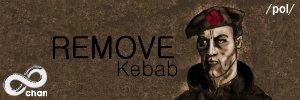

[582/2000] 568fc75f92ba2aee9578359f1f198df8d1a5ba25ad4386c208ba718d6d8fcd21
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/568fc75f92ba2aee9578359f1f198df8d1a5ba25ad4386c208ba718d6d8fcd21.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/568fc75f92ba2aee9578359f1f198df8d1a5ba25ad4386c208ba718d6d8fcd21.gz'
Failed to load target image.
[583/2000] 6a4f24150baf7a00daa1582ed8c9ef254d02ad3b0db793f8a98fcb88f483e0ce



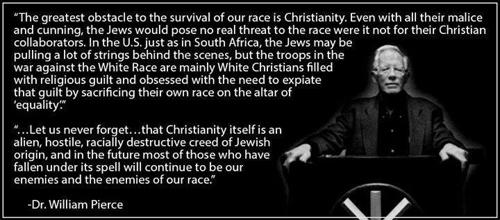

[584/2000] 4d1ef8a544e53f94c1f42842203dfc033f7dac6df9ce9920298924431a9ceadb
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4d1ef8a544e53f94c1f42842203dfc033f7dac6df9ce9920298924431a9ceadb.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4d1ef8a544e53f94c1f42842203dfc033f7dac6df9ce9920298924431a9ceadb.gz'
Failed to load target image.
[585/2000] 43c745a420a76eee785a550d3b00831f5627ef7e7015e517006f84d9df9e7a0c
[586/2000] f5100d8ec71ca3ef03ce272d3ce607dd664aae6e3414235deb31d3111d54d65d
[587/2000] 170ab7369a21d120c6474efc5ae78218754db512e36e8ee1beadda75d873a54e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/170ab7369a21d120c6474efc5ae78218754db512e36e8ee1beadda75d873a54e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/170ab7369a21d120c6474efc5ae78218754db512e36e8ee1beadda75d873a54e.gz'
Failed to load 


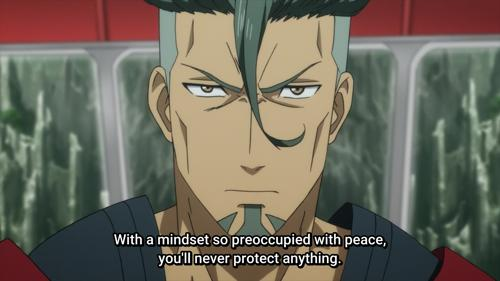

[589/2000] b1d94fdb3ce1af04aee9ec9841f0f1aea172c25763b48bff1061d2f49edb020b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b1d94fdb3ce1af04aee9ec9841f0f1aea172c25763b48bff1061d2f49edb020b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b1d94fdb3ce1af04aee9ec9841f0f1aea172c25763b48bff1061d2f49edb020b.gz'
Failed to load target image.
[590/2000] b559cc17ac25af2dcfb1161f28d34ac1815338034208cbd8d0a00007e9dadf29
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b559cc17ac25af2dcfb1161f28d34ac1815338034208cbd8d0a00007e9dadf29.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b559cc17ac25af2dcfb1161f28d34ac1815338034208cbd8d0a00007e9dadf29.gz'
Failed to load target image.
[591/2000] c9e744b6b99609ccd3bd3106c875bbf7b332ccff54da9be521d04318aceda3a4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


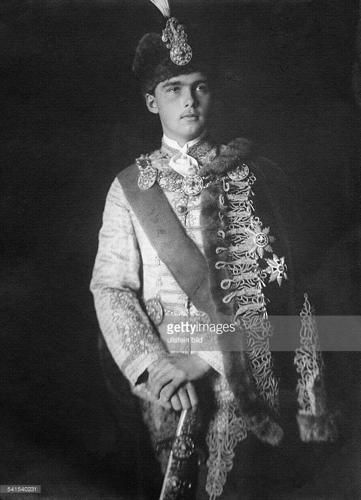

[593/2000] 9fa6896cb38583b4622c6d4cc834cc2c442dffe88470537a92ff7fc7bae0ad6c



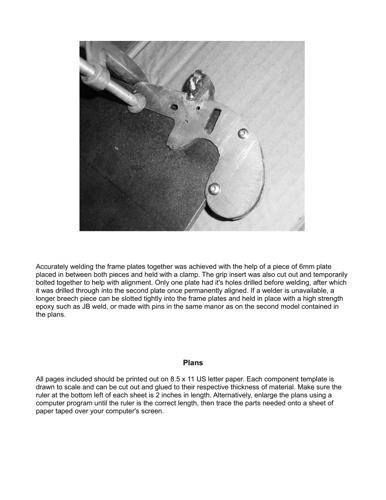

[594/2000] ee9e8705ec58443492872505f0a4dd9bd2f08605a067a153c14c888a8d2340d6
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ee9e8705ec58443492872505f0a4dd9bd2f08605a067a153c14c888a8d2340d6.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ee9e8705ec58443492872505f0a4dd9bd2f08605a067a153c14c888a8d2340d6.gz'
Failed to load target image.
[595/2000] 7a96bcb2a505387a2298ac4df2bb0922e71893c3b808c065fa83df12924124ad
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7a96bcb2a505387a2298ac4df2bb0922e71893c3b808c065fa83df12924124ad.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7a96bcb2a505387a2298ac4df2bb0922e71893c3b808c065fa83df12924124ad.gz'
Failed to load target image.
[596/2000] 7a6cc3de4e66e00a52a3bfde08d6c38a86a907186d4d14efadf121892a8c10b7



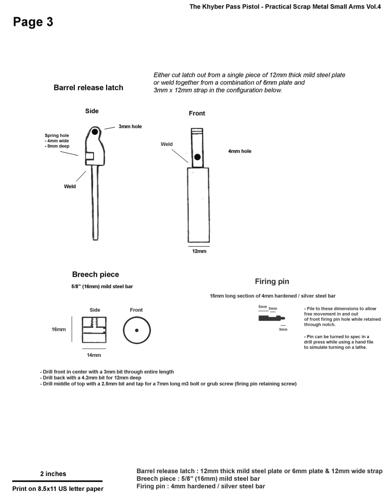

[597/2000] 5113ec45fe40c8d6d91e274383639d4bcf77ec95a165b083462ee2e93ce224b0
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5113ec45fe40c8d6d91e274383639d4bcf77ec95a165b083462ee2e93ce224b0.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5113ec45fe40c8d6d91e274383639d4bcf77ec95a165b083462ee2e93ce224b0.gz'
Failed to load target image.
[598/2000] 184a23f85c4db002b6c5ec691d55625ebb8bd903906b0953682589459e9aaaa9



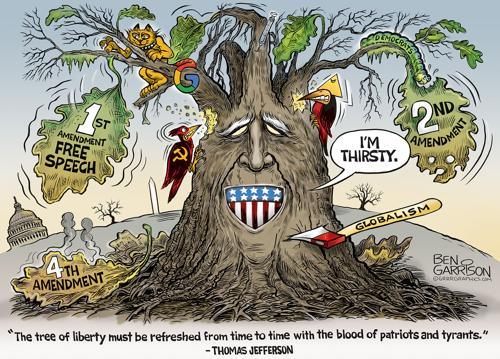

[599/2000] 8f3248a49bd627cba0fe66d73600f07e053b0ba19fcd8c65b9d2c2d6442e5c69
[600/2000] 577f9828c43647466f73206ad8c7fb65f7323f3278d3d7a2cf50e7253e485eba



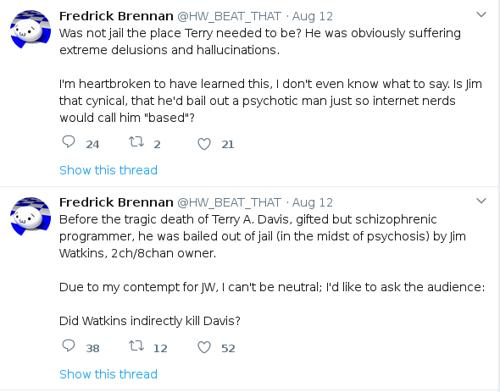

[601/2000] 9b2aa030a7ad39db2b7734cf40ac1912fb85113cde8979eaa01a93c29d37c752



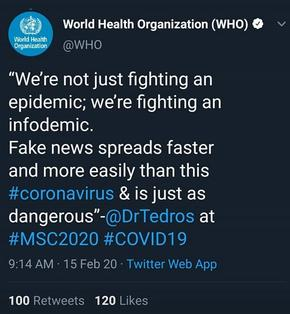

[602/2000] 6d4ae2b1c4ef2d0393d66e164d9a8a35c812faa8f70bd836c03aa49f0f067145
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6d4ae2b1c4ef2d0393d66e164d9a8a35c812faa8f70bd836c03aa49f0f067145.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6d4ae2b1c4ef2d0393d66e164d9a8a35c812faa8f70bd836c03aa49f0f067145.gz'
Failed to load target image.
[603/2000] 30f25191d2b0051e97c8d2dc1e7ebf0805ba6aeab37c0954d8819ae020b6359f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/30f25191d2b0051e97c8d2dc1e7ebf0805ba6aeab37c0954d8819ae020b6359f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/30f25191d2b0051e97c8d2dc1e7ebf0805ba6aeab37c0954d8819ae020b6359f.gz'
Failed to load target image.
[604/2000] 3842068ab8afeffafd2f5b13b1d8feaa8ada9ddd871f0178cd283c0510cfab7f
[605/2000] 4b61fbfef8a173bae2fac75ab3e1ff3a48a783be021aec8f75b


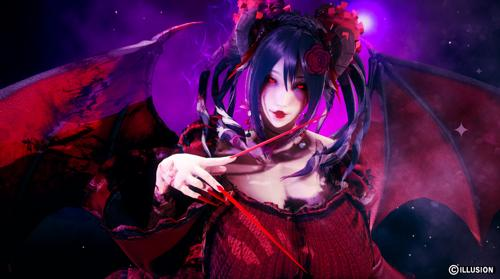

[606/2000] d4ad6b1add2ec9d6ee4d4863acd48629d58f58ea24be4c2542cfa7ba6060b08f
[607/2000] aeb03940c58ba48730a7f9179e314b342b0e42ded0637a62aebaebe05d85a09c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/aeb03940c58ba48730a7f9179e314b342b0e42ded0637a62aebaebe05d85a09c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/aeb03940c58ba48730a7f9179e314b342b0e42ded0637a62aebaebe05d85a09c.gz'
Failed to load target image.
[608/2000] 8e8f72ee21cdf356c020b62a02be2d5b5622d19b2c469b49bb425b4060236d85



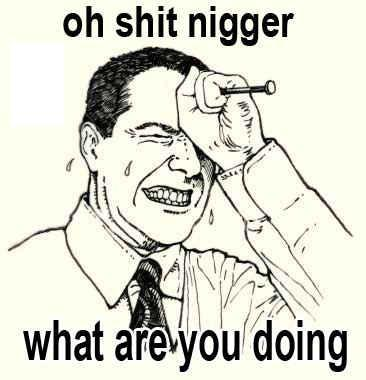

[609/2000] e2d8841d427aac89b27334ba54cf1825e8c5d05e66dc17ef882fc0e1fd4d94a7
[610/2000] 184859ef56564d73d29188b65fa848b19fe4ddda1c4a482c12d72c93a18f87be



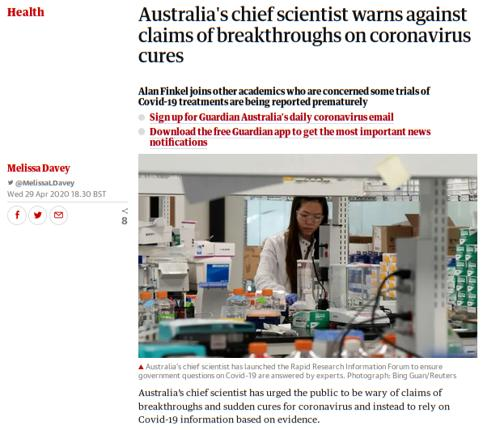

[611/2000] 0b7c05f411d1ef4b03c3e78f32474db60f29ce7e0408e2ac07575e9467e75bf6
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0b7c05f411d1ef4b03c3e78f32474db60f29ce7e0408e2ac07575e9467e75bf6.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0b7c05f411d1ef4b03c3e78f32474db60f29ce7e0408e2ac07575e9467e75bf6.gz'
Failed to load target image.
[612/2000] 28de0994ad7ca44bfb30ebfa4ad63a3b206fd4c12127e3aac746099d12355127
[613/2000] 804a9d1d9498467fa67315ef371c4b01e6b17e854b0be05df4878b327dbbcc3e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/804a9d1d9498467fa67315ef371c4b01e6b17e854b0be05df4878b327dbbcc3e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/804a9d1d9498467fa67315ef371c4b01e6b17e854b0be05df4878b327dbbcc3e.gz'
Failed to load target image.
[614/2000] 5a65b5bcb3488fa3f43cf3ab724243da74e2134bee49281d28e


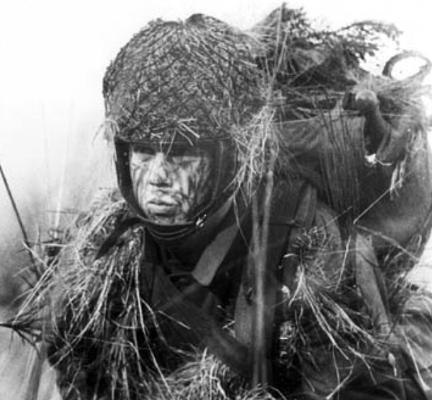

[615/2000] 8ea13b28f11b14ec4b71d2c972ae8646eb582b506b68f4a1c891b778a2ded0c8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8ea13b28f11b14ec4b71d2c972ae8646eb582b506b68f4a1c891b778a2ded0c8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8ea13b28f11b14ec4b71d2c972ae8646eb582b506b68f4a1c891b778a2ded0c8.gz'
Failed to load target image.
[616/2000] b52bc55a9369eaa92039603a77f867c007b33f828ea2fa6040dee3f5e918bdfc
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b52bc55a9369eaa92039603a77f867c007b33f828ea2fa6040dee3f5e918bdfc.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b52bc55a9369eaa92039603a77f867c007b33f828ea2fa6040dee3f5e918bdfc.gz'
Failed to load target image.
[617/2000] 1b6cc083271ef1c983080878ffeaad9ebe12bbd69d626c5fb7ff376453c62781
[618/2000] b48b35326b194caa6f5bf082ac5003699f6f451887a078b3ecc


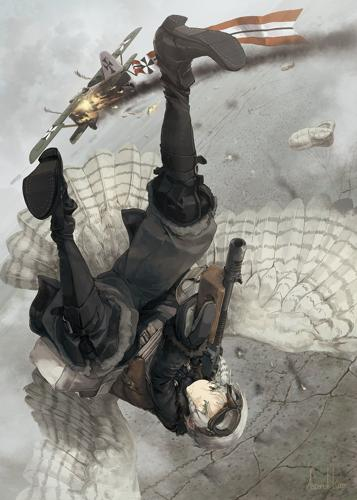

[619/2000] 53e778a1787a3713ad894cf48446b0cc4760d727eba09f0691a41896227245b0
[620/2000] cfd1dd9c28ba75ae1f9a038d0e4ad1cdcb7cee5005a13795c8546d195644358d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cfd1dd9c28ba75ae1f9a038d0e4ad1cdcb7cee5005a13795c8546d195644358d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cfd1dd9c28ba75ae1f9a038d0e4ad1cdcb7cee5005a13795c8546d195644358d.gz'
Failed to load target image.
[621/2000] 411180d34d0aa772ccb8ac7c567a6052447abb2fc27fca78461ac875b0c23490
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/411180d34d0aa772ccb8ac7c567a6052447abb2fc27fca78461ac875b0c23490.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/411180d34d0aa772ccb8ac7c567a6052447abb2fc27fca78461ac875b0c23490.gz'
Failed to load target image.
[622/2000] ec6eb1378fe0e32cf828e5b14ebb22afff465b95bfa33bb216c


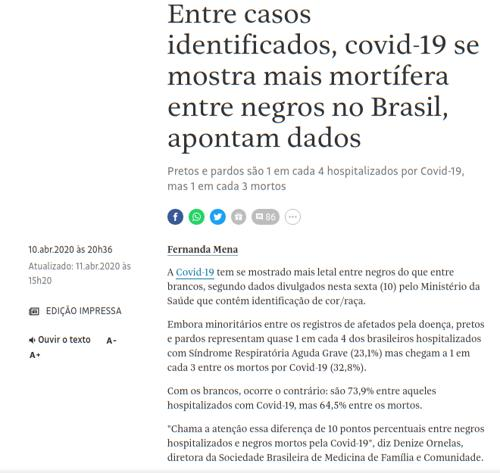

[625/2000] 80309189ecc7050638eb43ab8f78f53d0b0775b98d9b7ddcf57d0ffe07989e7d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/80309189ecc7050638eb43ab8f78f53d0b0775b98d9b7ddcf57d0ffe07989e7d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/80309189ecc7050638eb43ab8f78f53d0b0775b98d9b7ddcf57d0ffe07989e7d.gz'
Failed to load target image.
[626/2000] 90a02c30abfce8058a37d68ba83f544c7bd41ede054fc8e40ffd048d18e63e29
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/90a02c30abfce8058a37d68ba83f544c7bd41ede054fc8e40ffd048d18e63e29.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/90a02c30abfce8058a37d68ba83f544c7bd41ede054fc8e40ffd048d18e63e29.gz'
Failed to load target image.
[627/2000] c6892b0d12a04d28f216283f890a2fb2012e7439e7b4b6305011ef9ffd1e0a65
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


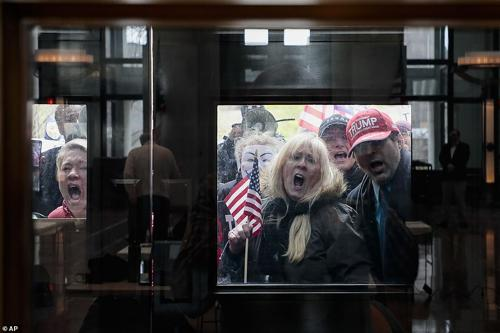

[629/2000] eb3862bc229a6896b9c99f05596e5cc86dd793e77db80c36beb836d88bb74b0c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/eb3862bc229a6896b9c99f05596e5cc86dd793e77db80c36beb836d88bb74b0c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/eb3862bc229a6896b9c99f05596e5cc86dd793e77db80c36beb836d88bb74b0c.gz'
Failed to load target image.
[630/2000] 6873fd6317c9d1c224d236c825bb6ec5273e66acd266e453aa8d0db687892760
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6873fd6317c9d1c224d236c825bb6ec5273e66acd266e453aa8d0db687892760.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6873fd6317c9d1c224d236c825bb6ec5273e66acd266e453aa8d0db687892760.gz'
Failed to load target image.
[631/2000] 04dbce86b9e6fc81745b107730c73fdfd87ec3ff023c548fc6e9787002f58d0b



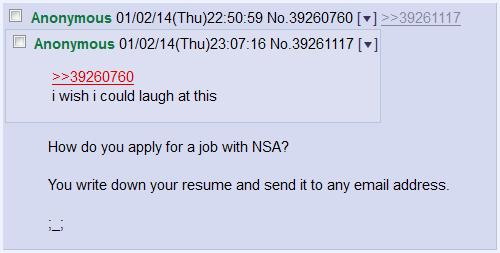

[632/2000] 9c4f73fa7823c455afa141fdae1cdc7879d7dbbe63626b85481cfa8c73deeb31
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9c4f73fa7823c455afa141fdae1cdc7879d7dbbe63626b85481cfa8c73deeb31.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9c4f73fa7823c455afa141fdae1cdc7879d7dbbe63626b85481cfa8c73deeb31.gz'
Failed to load target image.
[633/2000] 50642845300e59e7a8a639dba1d0a5bdb3567b5c08babbf4595af7284201ca29
[634/2000] 61ee3daa38b99d40f7ad2e228051bb6ae01f005dd447542b94da45869263938d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/61ee3daa38b99d40f7ad2e228051bb6ae01f005dd447542b94da45869263938d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/61ee3daa38b99d40f7ad2e228051bb6ae01f005dd447542b94da45869263938d.gz'
Failed to load target image.
[635/2000] f37f32b1cc37536a95e6a083ced50dfa8ecc8daed909d4f9ae5


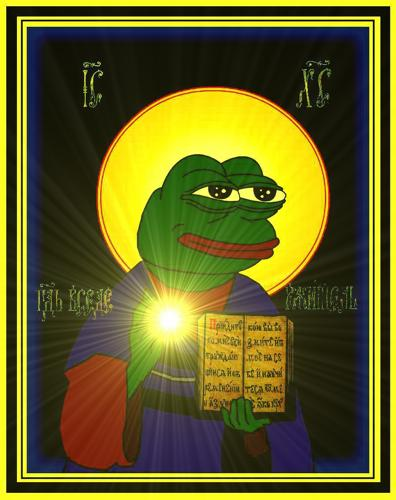

[640/2000] 53cec23d107d5c720488310a730968b845c01591557461a8604762e5fab8c04b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/53cec23d107d5c720488310a730968b845c01591557461a8604762e5fab8c04b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/53cec23d107d5c720488310a730968b845c01591557461a8604762e5fab8c04b.gz'
Failed to load target image.
[641/2000] 5b88dac17e59d0d4198bbe92bf3e2c2ef08f5f4f5bb5e3857ad20c00c036d94a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5b88dac17e59d0d4198bbe92bf3e2c2ef08f5f4f5bb5e3857ad20c00c036d94a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5b88dac17e59d0d4198bbe92bf3e2c2ef08f5f4f5bb5e3857ad20c00c036d94a.gz'
Failed to load target image.
[642/2000] 909f6c5127f14fc35b404cbaca23db538f634faf7c24cc3794f7a3000a9b53a7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


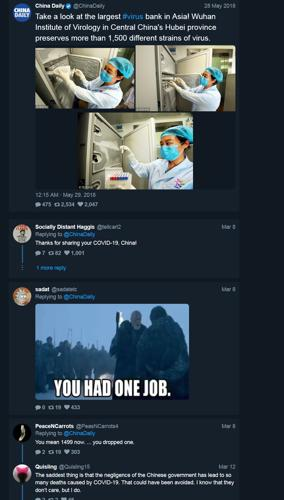

[651/2000] 506fd627d0e00fa1bb06cb0df5a0d2c46ab0906854a61a96a606819bfd78c48e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/506fd627d0e00fa1bb06cb0df5a0d2c46ab0906854a61a96a606819bfd78c48e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/506fd627d0e00fa1bb06cb0df5a0d2c46ab0906854a61a96a606819bfd78c48e.gz'
Failed to load target image.
[652/2000] 88e3563cc1648881bbbaeefea42452860ffbd109842034e4738a4803ca536be0
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/88e3563cc1648881bbbaeefea42452860ffbd109842034e4738a4803ca536be0.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/88e3563cc1648881bbbaeefea42452860ffbd109842034e4738a4803ca536be0.gz'
Failed to load target image.
[653/2000] ee2b3b11b585dca88ca4271636ec6aa7e741d2d2e9a5f72182a5b839b2675704
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


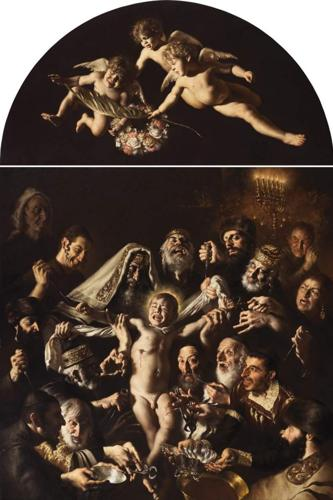

[657/2000] 0ec883115045a29fe05230ae33f47a8dab50d3245d8e12707d05e5273ce96070
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0ec883115045a29fe05230ae33f47a8dab50d3245d8e12707d05e5273ce96070.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0ec883115045a29fe05230ae33f47a8dab50d3245d8e12707d05e5273ce96070.gz'
Failed to load target image.
[658/2000] a4f27b6e1b07f5948f133fa536325bbae8b7acabf4e69c07285683f4ffa7233b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a4f27b6e1b07f5948f133fa536325bbae8b7acabf4e69c07285683f4ffa7233b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a4f27b6e1b07f5948f133fa536325bbae8b7acabf4e69c07285683f4ffa7233b.gz'
Failed to load target image.
[659/2000] 0c7738712d99ca37984abf270306f532c8be1d39c8967781ece0cb68c42504e0



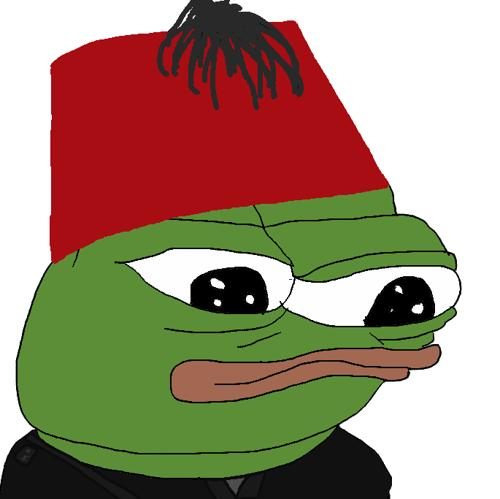

[660/2000] df6d264d225811d946df9726405915e112e551d93a911b9fbdbff99814a41d07
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/df6d264d225811d946df9726405915e112e551d93a911b9fbdbff99814a41d07.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/df6d264d225811d946df9726405915e112e551d93a911b9fbdbff99814a41d07.gz'
Failed to load target image.
[661/2000] 455ad10f2f342b94d1520b75d80f565676722b325ed638048fb431eee78130d8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/455ad10f2f342b94d1520b75d80f565676722b325ed638048fb431eee78130d8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/455ad10f2f342b94d1520b75d80f565676722b325ed638048fb431eee78130d8.gz'
Failed to load target image.
[662/2000] 46ff88d161f6b8d10824e64299b25f6d07bdb19b007a115eb49ba61e020913b3
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


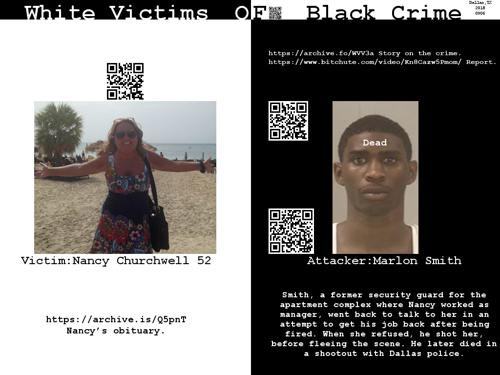

[670/2000] 35df0f1b8523e4032dea3a16b877f14ca296716841f3e41259bac133764fd6f5
[671/2000] 142d58636b1fa04d9508fea7637209e176f0fecc4e2e1ddc4504f7270f6e04d9
[672/2000] bd62e42c1ce2cc15b193bef283f8c7d562643b59ba0171f475abd63bafea2d72
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bd62e42c1ce2cc15b193bef283f8c7d562643b59ba0171f475abd63bafea2d72.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bd62e42c1ce2cc15b193bef283f8c7d562643b59ba0171f475abd63bafea2d72.gz'
Failed to load target image.
[673/2000] 14c696839e62d80205105da6fd5dd8e03f02327f6cbd3c8240f2504b68b4ff2a



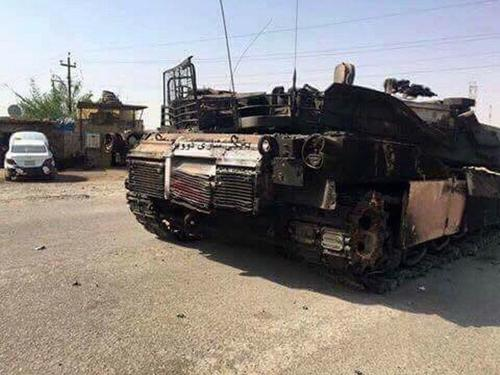

[674/2000] 41afeb75f9963b4f40ee609c16aa01d943328311952ef0447953be13ce270462
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/41afeb75f9963b4f40ee609c16aa01d943328311952ef0447953be13ce270462.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/41afeb75f9963b4f40ee609c16aa01d943328311952ef0447953be13ce270462.gz'
Failed to load target image.
[675/2000] 0581af1e91fb7d4e0524fcc1e27b72271932ae866f9946574dc871d2fe639b8c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0581af1e91fb7d4e0524fcc1e27b72271932ae866f9946574dc871d2fe639b8c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0581af1e91fb7d4e0524fcc1e27b72271932ae866f9946574dc871d2fe639b8c.gz'
Failed to load target image.
[676/2000] ecca7ed08728756e50a396c8ef2c4910062b4e9427bee960db33e0e28ae45d69



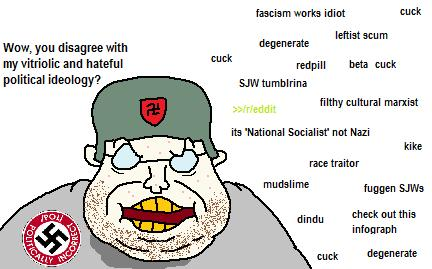

[677/2000] a6823b2f19c1f78969acd01010bfc6166bcef0c7085b448d34cf2aaffcdb3fcd



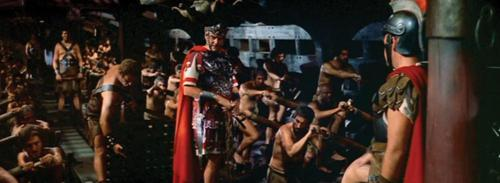

[678/2000] b339790f5bf50ad67efd4b7d435d172b24fedd48b6b1bc8a527a75220e53f24f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b339790f5bf50ad67efd4b7d435d172b24fedd48b6b1bc8a527a75220e53f24f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b339790f5bf50ad67efd4b7d435d172b24fedd48b6b1bc8a527a75220e53f24f.gz'
Failed to load target image.
[679/2000] 2650422197f2d25216b5f4282ddc36d60f157eeda74e9e4029e167966a87b321
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2650422197f2d25216b5f4282ddc36d60f157eeda74e9e4029e167966a87b321.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2650422197f2d25216b5f4282ddc36d60f157eeda74e9e4029e167966a87b321.gz'
Failed to load target image.
[680/2000] f827b86eddc24a00c1aaae49fb6b24736e8b997d1cf7f1522b846e66ba061985
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


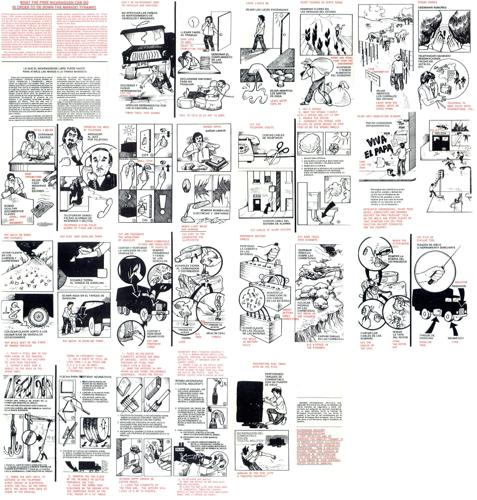

[685/2000] d7389573715f9e6dd3b1756f0ba4a5a3f2c63333d1d3864455abcb4acb39da7c
[686/2000] ee4c611fd696f68c50b29e48b24197a9d9f65d0f69a6438e0d983b6ac5d2b859
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ee4c611fd696f68c50b29e48b24197a9d9f65d0f69a6438e0d983b6ac5d2b859.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ee4c611fd696f68c50b29e48b24197a9d9f65d0f69a6438e0d983b6ac5d2b859.gz'
Failed to load target image.
[687/2000] 8daf588f29b85f2d54bdaad920d838b085c42ad6b7bfd317a790bf74b0ac5420
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8daf588f29b85f2d54bdaad920d838b085c42ad6b7bfd317a790bf74b0ac5420.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8daf588f29b85f2d54bdaad920d838b085c42ad6b7bfd317a790bf74b0ac5420.gz'
Failed to load target image.
[688/2000] cbbcdd680fe3fe6732ee8eca0cf962ce1d468ceb78505113682


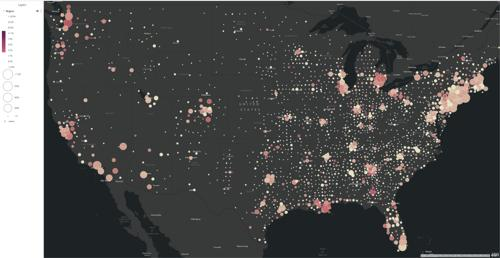

[692/2000] 5ad119189ae1c075cf484db99689832689f4cd004107ce61b99a0c3e514751a5
[693/2000] fe3eebd7d747e1c0656e1ba1255190d379f160c8d757ae33ee9a47d884fe7926
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fe3eebd7d747e1c0656e1ba1255190d379f160c8d757ae33ee9a47d884fe7926.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fe3eebd7d747e1c0656e1ba1255190d379f160c8d757ae33ee9a47d884fe7926.gz'
Failed to load target image.
[694/2000] f5f94ff3d8f0282778a7a134e049fec89998838f23a20bb46575df6332e4cdd7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f5f94ff3d8f0282778a7a134e049fec89998838f23a20bb46575df6332e4cdd7.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f5f94ff3d8f0282778a7a134e049fec89998838f23a20bb46575df6332e4cdd7.gz'
Failed to load target image.
[695/2000] 896f1ad843bed4a0dfa40740861a6af5a21157a085925ed52cd


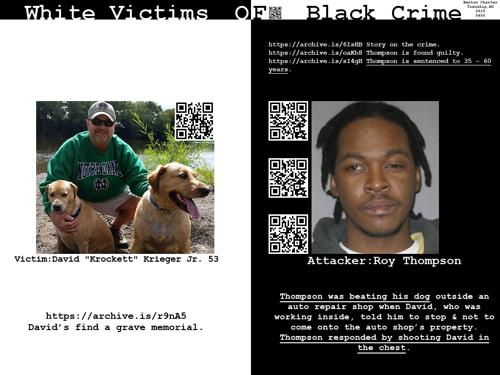

[696/2000] 026b2898d597ee24fd9f8331f5f62c50cd2b1a9be29dc3d49a3f377a07b4f157
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/026b2898d597ee24fd9f8331f5f62c50cd2b1a9be29dc3d49a3f377a07b4f157.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/026b2898d597ee24fd9f8331f5f62c50cd2b1a9be29dc3d49a3f377a07b4f157.gz'
Failed to load target image.
[697/2000] f8388a658e4ab8c26c9d7a6c53026ad0f1a060b5723a57d607a5f16feacd351f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f8388a658e4ab8c26c9d7a6c53026ad0f1a060b5723a57d607a5f16feacd351f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f8388a658e4ab8c26c9d7a6c53026ad0f1a060b5723a57d607a5f16feacd351f.gz'
Failed to load target image.
[698/2000] f1704a9537c61df475ec3badbfcad7573e66197f65dd5ac9c59bbcb39184a78b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


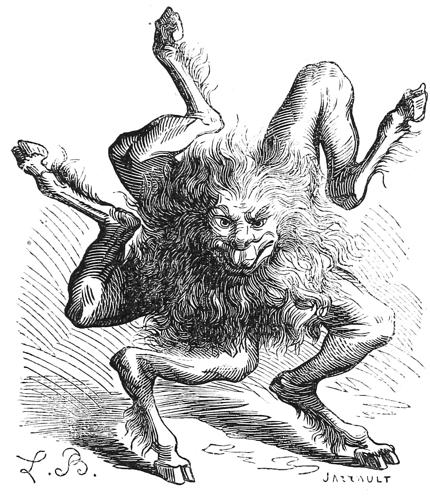

[714/2000] a8a4eb8a7690b2c50fbf164bdeb07e7686142178effe53353e67b8aa9f55c5be
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a8a4eb8a7690b2c50fbf164bdeb07e7686142178effe53353e67b8aa9f55c5be.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a8a4eb8a7690b2c50fbf164bdeb07e7686142178effe53353e67b8aa9f55c5be.gz'
Failed to load target image.
[715/2000] 31696062effa79e228850a8995864eef48e05f41953f1fb4d30dfcff1558e8f0



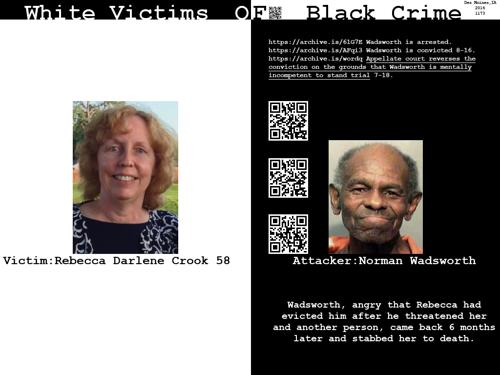

[716/2000] d6f7c4c4d725857bb1a83f96c1328b27ac61f6e433bf5b90160bba9df47ceb47



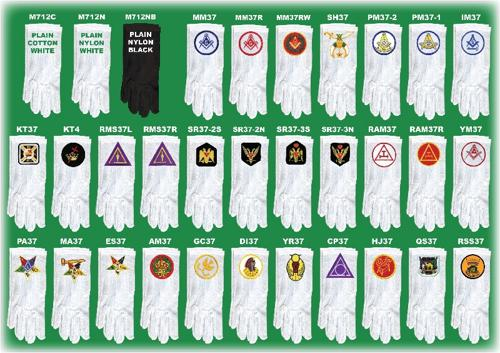

[717/2000] 5ad8c7bd1faa4cec7e4484681865d633b95830b3a5a9e2388101563013f34473
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5ad8c7bd1faa4cec7e4484681865d633b95830b3a5a9e2388101563013f34473.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5ad8c7bd1faa4cec7e4484681865d633b95830b3a5a9e2388101563013f34473.gz'
Failed to load target image.
[718/2000] d8245ea4f764083b5e92a8766d0500d00048a0724739c23a4c27b735041dcec0
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d8245ea4f764083b5e92a8766d0500d00048a0724739c23a4c27b735041dcec0.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d8245ea4f764083b5e92a8766d0500d00048a0724739c23a4c27b735041dcec0.gz'
Failed to load target image.
[719/2000] 7215ddeb1ed7926a4c85215b1014932da89e377ec9ca2080a1163f82efa82338
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


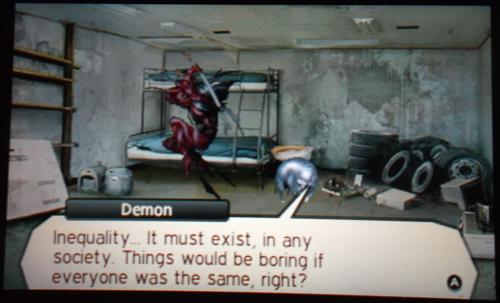

[722/2000] f7cc933464f9fa6b362aa65a81f957d1ed3a9c2307e0a29f9fc2cbd152efbb62
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f7cc933464f9fa6b362aa65a81f957d1ed3a9c2307e0a29f9fc2cbd152efbb62.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f7cc933464f9fa6b362aa65a81f957d1ed3a9c2307e0a29f9fc2cbd152efbb62.gz'
Failed to load target image.
[723/2000] 191ed6ec7eb5445a5f54aae847f44e09caf751f88905437e45d8a2e2c52bd954



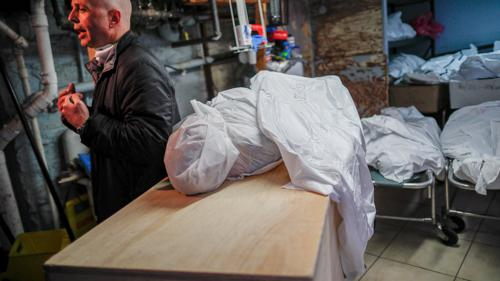

[724/2000] 1b97caee48dd6959b71b7ae1e7746f411c4946065d946e0cc27388db981be899
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1b97caee48dd6959b71b7ae1e7746f411c4946065d946e0cc27388db981be899.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1b97caee48dd6959b71b7ae1e7746f411c4946065d946e0cc27388db981be899.gz'
Failed to load target image.
[725/2000] d326a0e0f63322d814a82be7137b6eec0b3905c0e0ebb3a3165bca4c67afa065
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d326a0e0f63322d814a82be7137b6eec0b3905c0e0ebb3a3165bca4c67afa065.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d326a0e0f63322d814a82be7137b6eec0b3905c0e0ebb3a3165bca4c67afa065.gz'
Failed to load target image.
[726/2000] e1a4ad1c55be2fd615e943b0f3fb1c6d76154219b8841f7512ddeb851f190d18
[727/2000] fe919550baf7f3eee1081fe2abc2faefe3e62a07b329f0b877d


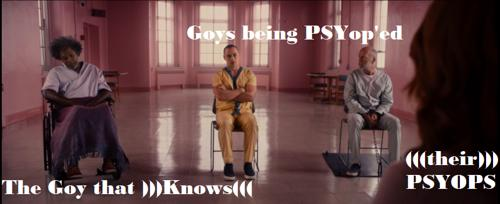

[731/2000] 92d49ee565a5fe6de483ac17999ab7a63b2bd02f34e7961f99c09f30e0169d81
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/92d49ee565a5fe6de483ac17999ab7a63b2bd02f34e7961f99c09f30e0169d81.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/92d49ee565a5fe6de483ac17999ab7a63b2bd02f34e7961f99c09f30e0169d81.gz'
Failed to load target image.
[732/2000] 8fb79f41e6b90a7d4cd5676f1f0710378a0685b7f96579dfb8c43c90db9f3d8f
[733/2000] 1bfc0813e5d365426d36d800013481a336d265ac5014cb911c0f1a9ce58e46d6



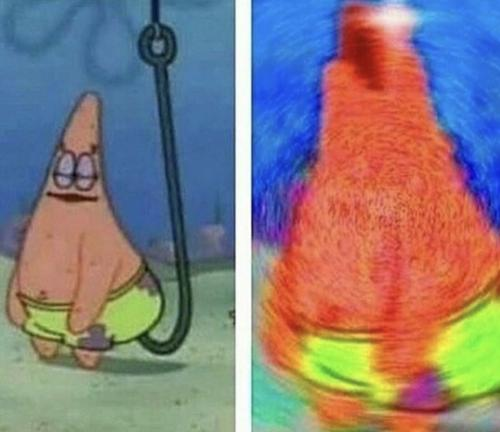

[734/2000] 65b5865077642215fcab380c923ce7db261455d8befb74145f64bf14dfd02d94
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/65b5865077642215fcab380c923ce7db261455d8befb74145f64bf14dfd02d94.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/65b5865077642215fcab380c923ce7db261455d8befb74145f64bf14dfd02d94.gz'
Failed to load target image.
[735/2000] 7fc18415a13f7bab19653648aa5f2d1ffa65bb5bd447f0ef57006fce809c8bb7
[736/2000] 6dc49a24e4a18764d068c6a17d785b04ce3d79713286895347d79840d1dc3734



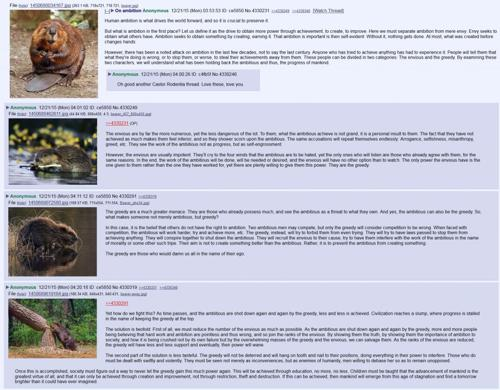

[737/2000] 25e44a014709f21c6f1aa52c112c98d1e7b9172cb0de93bbe0e50b653e3fd71b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/25e44a014709f21c6f1aa52c112c98d1e7b9172cb0de93bbe0e50b653e3fd71b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/25e44a014709f21c6f1aa52c112c98d1e7b9172cb0de93bbe0e50b653e3fd71b.gz'
Failed to load target image.
[738/2000] 2f85e349eaa971b3c28b5f2291f642a6db598e790fedbd8a678a2c4653236937
[739/2000] 8fab3257c88fb012e051ebb3f2746925de4d0f95a2592f51f8144f09bd706632
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8fab3257c88fb012e051ebb3f2746925de4d0f95a2592f51f8144f09bd706632.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8fab3257c88fb012e051ebb3f2746925de4d0f95a2592f51f8144f09bd706632.gz'
Failed to load target image.
[740/2000] ed9f6d7b85c5b1338e27687126d865cfe8dbdc7f40bb231e2cd


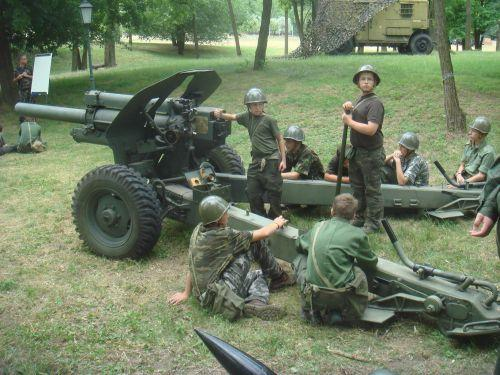

[741/2000] 87d3f451113cb334e706f401c24058726e11656f0901738c5407f9b3e88b54ca
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/87d3f451113cb334e706f401c24058726e11656f0901738c5407f9b3e88b54ca.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/87d3f451113cb334e706f401c24058726e11656f0901738c5407f9b3e88b54ca.gz'
Failed to load target image.
[742/2000] 608c67105dce86d9daaffec738e4c985bcd76192419b8b58c21e107aed55ebca
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/608c67105dce86d9daaffec738e4c985bcd76192419b8b58c21e107aed55ebca.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/608c67105dce86d9daaffec738e4c985bcd76192419b8b58c21e107aed55ebca.gz'
Failed to load target image.
[743/2000] 0ff35fb43bf399987f048f1e4025139a8b1ca16a1466da1ba792d00085b5ad6a



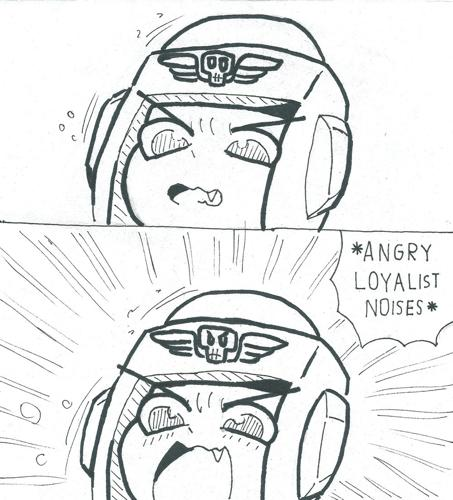

[744/2000] 07bc89239d54cd001c5b038162407b71dc034ec5189fc57ccaebf1307367caf5



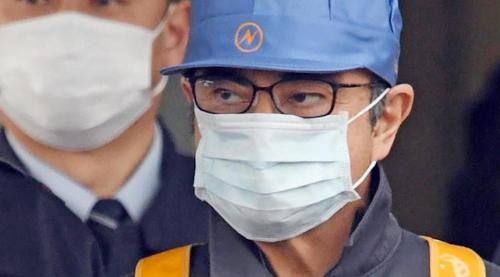

[745/2000] 707a9b6327916ff4d55dfe01a3b6f6de20bb2e8dd263b58e29adfd13ce9bee90
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/707a9b6327916ff4d55dfe01a3b6f6de20bb2e8dd263b58e29adfd13ce9bee90.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/707a9b6327916ff4d55dfe01a3b6f6de20bb2e8dd263b58e29adfd13ce9bee90.gz'
Failed to load target image.
[746/2000] cb197289c071923aeb1b1de8a5e3f151eff6b9ce32aaf016667e8c5497d7af4c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cb197289c071923aeb1b1de8a5e3f151eff6b9ce32aaf016667e8c5497d7af4c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cb197289c071923aeb1b1de8a5e3f151eff6b9ce32aaf016667e8c5497d7af4c.gz'
Failed to load target image.
[747/2000] 51454c81e60d7f31743e864412cf886c276e2c5ae9323ebc66d14bb441650a2b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


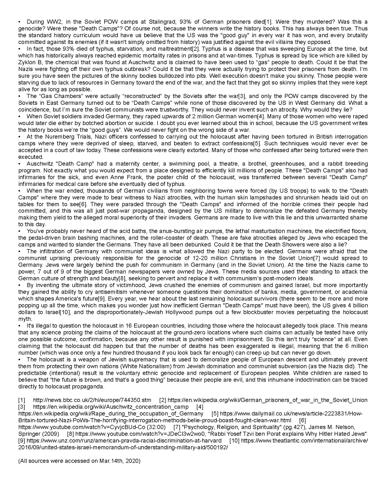

[749/2000] 0c6709392224d1bc33e4cc1db549d277c187721174cfa7a7a4a6871628646ff9
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0c6709392224d1bc33e4cc1db549d277c187721174cfa7a7a4a6871628646ff9.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0c6709392224d1bc33e4cc1db549d277c187721174cfa7a7a4a6871628646ff9.gz'
Failed to load target image.
[750/2000] dc066e2735ce8711e85b4ab2f3c84d14947dd45339ec0f6142e0c52e9461e16a



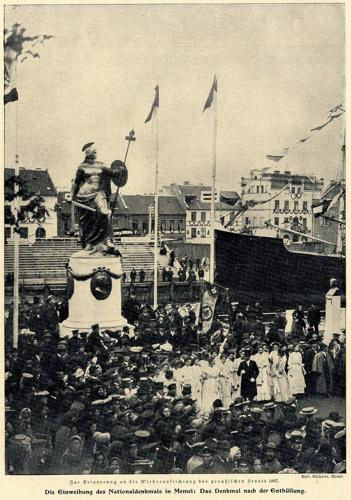

[751/2000] b0eb34510261a23d1b70c2e6cb3b77c94b977d80a07ecf2ce0705da852b89840
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b0eb34510261a23d1b70c2e6cb3b77c94b977d80a07ecf2ce0705da852b89840.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b0eb34510261a23d1b70c2e6cb3b77c94b977d80a07ecf2ce0705da852b89840.gz'
Failed to load target image.
[752/2000] 40193aec3d2201dce6ef3c874e8e90e6a866e670e294b2d1a298b8b7be66ea41
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/40193aec3d2201dce6ef3c874e8e90e6a866e670e294b2d1a298b8b7be66ea41.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/40193aec3d2201dce6ef3c874e8e90e6a866e670e294b2d1a298b8b7be66ea41.gz'
Failed to load target image.
[753/2000] a124fc34277dc594fb204837430dbcffec47eb9ae84e67253a490e8b805406e2



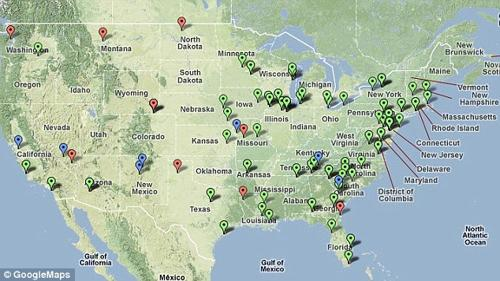

[754/2000] 31bd544de8b1763079db5d8abb894c9c6b752d85fd5aa2c6ba6c3c70bb04af79
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/31bd544de8b1763079db5d8abb894c9c6b752d85fd5aa2c6ba6c3c70bb04af79.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/31bd544de8b1763079db5d8abb894c9c6b752d85fd5aa2c6ba6c3c70bb04af79.gz'
Failed to load target image.
[755/2000] 5a5b80871eb9587c6271891a8925321b9bea1523476053b80902aabf4eaa2716
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5a5b80871eb9587c6271891a8925321b9bea1523476053b80902aabf4eaa2716.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5a5b80871eb9587c6271891a8925321b9bea1523476053b80902aabf4eaa2716.gz'
Failed to load target image.
[756/2000] c4c333f4dda0a304fdecad4a6de930718fb2ace8f84466febc7a5b1e9f75abde
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


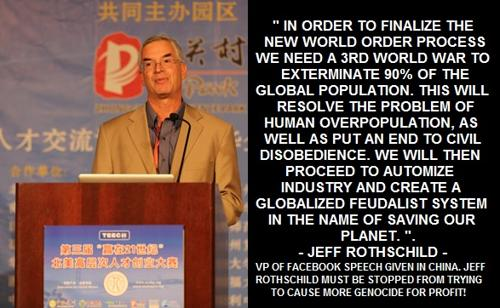

[763/2000] c596280b0710c7be279297743072c77f761e96fac2a2368e8d85f00a10121de3
[764/2000] b448556e05f1a7cd982435c8594ca46996d0a8a97b8c8e03a86649af416c08c2
[765/2000] 1ee37829a45fc6c929c704562749e4fbc5cde2eea69dd1591566cff98168f987



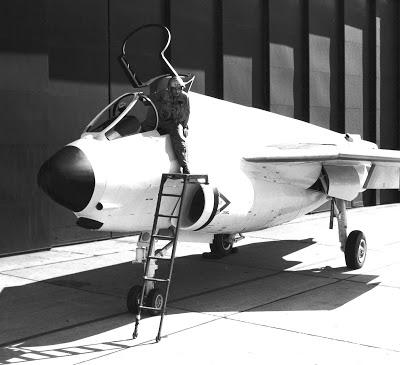

[766/2000] 0e71aeea5c08e922ce084e1e7e43d5c4acd57d59d8d5e6efa14b25ead3dd52c5



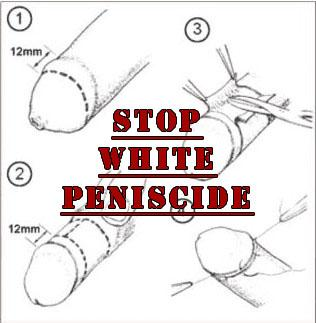

[767/2000] bc79b828fc402ec4c6d8d2900d3a3ff13a5ff122c8c54fa90e8014c45ad24c57
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bc79b828fc402ec4c6d8d2900d3a3ff13a5ff122c8c54fa90e8014c45ad24c57.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bc79b828fc402ec4c6d8d2900d3a3ff13a5ff122c8c54fa90e8014c45ad24c57.gz'
Failed to load target image.
[768/2000] f0d272743a15f18b812fe113923500b2c65e38210d0b5ffe0a19c07b2dae9a55



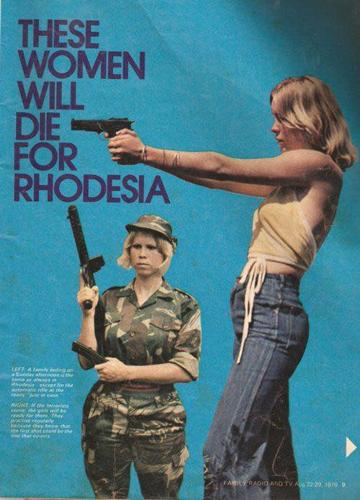

[769/2000] bea36f764f0c6cd6a693aa3c7ac1c5adac49c3336ebf31045f28c77ccc2f3819
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bea36f764f0c6cd6a693aa3c7ac1c5adac49c3336ebf31045f28c77ccc2f3819.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bea36f764f0c6cd6a693aa3c7ac1c5adac49c3336ebf31045f28c77ccc2f3819.gz'
Failed to load target image.
[770/2000] b626bde8c29db745e02adaed4b5c8777d97a04c09b653b0f56a4993c599d4db3
[771/2000] 636aed9464d2e6881ce94787e8cbf3ce1270a437f14a83411511bd67e2767af6



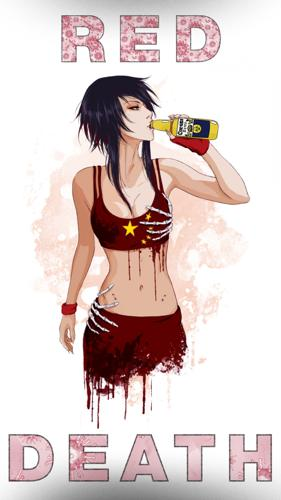

[772/2000] 4e4721f6f4a947eb3024d405740ccb4b19c92d48a1277e89a7ae3b90977e416a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4e4721f6f4a947eb3024d405740ccb4b19c92d48a1277e89a7ae3b90977e416a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4e4721f6f4a947eb3024d405740ccb4b19c92d48a1277e89a7ae3b90977e416a.gz'
Failed to load target image.
[773/2000] 360dbf8596918da6bc4920feb391080e0b91666965b7d6cd47fde37044ca8fba
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/360dbf8596918da6bc4920feb391080e0b91666965b7d6cd47fde37044ca8fba.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/360dbf8596918da6bc4920feb391080e0b91666965b7d6cd47fde37044ca8fba.gz'
Failed to load target image.
[774/2000] ef68754b7868dce6cdb8df64a6a1b3a959e15524c975ff35aac25d8c28fced4c
[775/2000] 1db8d84d9f89ea5c2fc0aa964c08f6d4f1e00c645ad35ee99c7


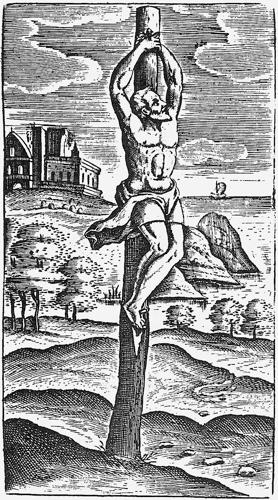

[782/2000] 890362f10ad9d49cd253df310040aa2c56b6c4586f97afe25eba5409fc5297bc



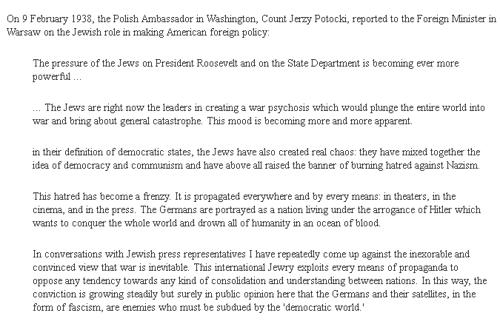

[783/2000] 75e1685b4f4f09d5f21c66f92970b6a24f36640cf6a4ea55279b0b44a6425f59
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/75e1685b4f4f09d5f21c66f92970b6a24f36640cf6a4ea55279b0b44a6425f59.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/75e1685b4f4f09d5f21c66f92970b6a24f36640cf6a4ea55279b0b44a6425f59.gz'
Failed to load target image.
[784/2000] c339f5d80c5615e1d5eee663a2075ab5c81641bd77d9504eac7ffccd2ff26774
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c339f5d80c5615e1d5eee663a2075ab5c81641bd77d9504eac7ffccd2ff26774.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c339f5d80c5615e1d5eee663a2075ab5c81641bd77d9504eac7ffccd2ff26774.gz'
Failed to load target image.
[785/2000] fa5f4f0bea9ab1ce0808228070ac1cb8f4185075980c096d93770aea95a6a14b



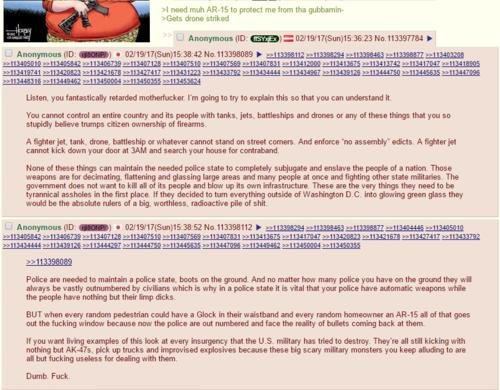

[786/2000] a6b3b87247b66eb97dd35db69f7c3a7bffa9cd31b4b141b724e81269a39d2862



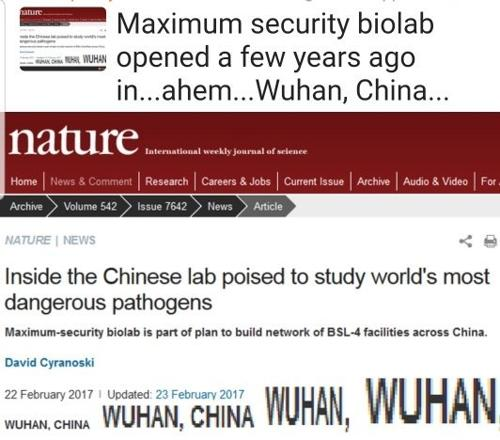

[787/2000] c68809bef8192a43781dff4bea02f5c959dedbb7227542c014a78dab115e78d3
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c68809bef8192a43781dff4bea02f5c959dedbb7227542c014a78dab115e78d3.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c68809bef8192a43781dff4bea02f5c959dedbb7227542c014a78dab115e78d3.gz'
Failed to load target image.
[788/2000] cb4e51936985a5c10f912fe448d300554c5b232427a699741f2e8572b59209cf



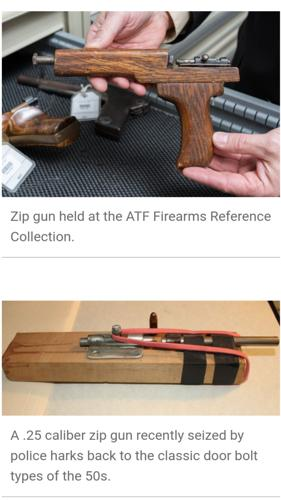

[789/2000] b8945ee0c1960a68e54b638e77cf6d613414c6b147388dca045a26e41423134e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b8945ee0c1960a68e54b638e77cf6d613414c6b147388dca045a26e41423134e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b8945ee0c1960a68e54b638e77cf6d613414c6b147388dca045a26e41423134e.gz'
Failed to load target image.
[790/2000] d04c67746ccfd37d658b94a493f5cfdf60130553fff937da743f75cec173d0f0



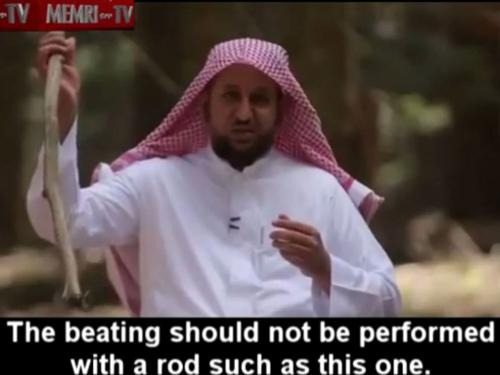

[791/2000] bc2e1dde9b20050954be527dd068bf55ecfe8dbcd5ac89d206eee2e95d7b0510
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bc2e1dde9b20050954be527dd068bf55ecfe8dbcd5ac89d206eee2e95d7b0510.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bc2e1dde9b20050954be527dd068bf55ecfe8dbcd5ac89d206eee2e95d7b0510.gz'
Failed to load target image.
[792/2000] a9ee50f886f0492a42365395f789b7d57e409034d604f35d300a4962df98b43a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a9ee50f886f0492a42365395f789b7d57e409034d604f35d300a4962df98b43a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a9ee50f886f0492a42365395f789b7d57e409034d604f35d300a4962df98b43a.gz'
Failed to load target image.
[793/2000] af01583f6bc07a235696f16de534f12dc505cc273a54670a91478386b30e79de
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


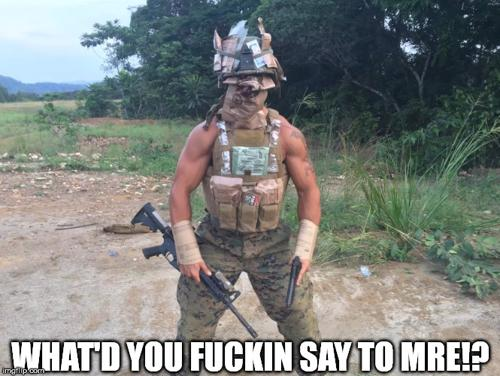

[796/2000] 2a0fa2b4512d59d562f6181d0304db079a9ce5b97c33c53331d39e809620bb5b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2a0fa2b4512d59d562f6181d0304db079a9ce5b97c33c53331d39e809620bb5b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2a0fa2b4512d59d562f6181d0304db079a9ce5b97c33c53331d39e809620bb5b.gz'
Failed to load target image.
[797/2000] d88b57dec5aaa270c986eea7c59bc73e4ee816d287d9fd8a6948255c815c8a34
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d88b57dec5aaa270c986eea7c59bc73e4ee816d287d9fd8a6948255c815c8a34.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d88b57dec5aaa270c986eea7c59bc73e4ee816d287d9fd8a6948255c815c8a34.gz'
Failed to load target image.
[798/2000] a71dc45e643662b79e831d4e766bd2c646b68912a2ad0bb058c5ff54b90dadb1
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


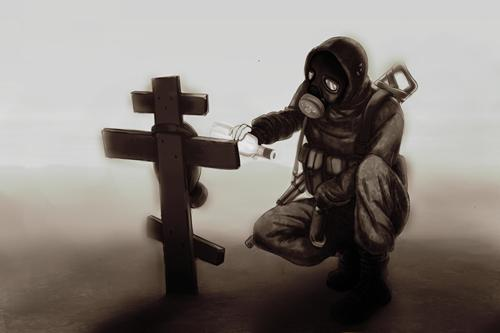

[805/2000] 8dfda87aa8fadeb775df194beef62e2ea3a8f580ec2af5ff3f55eadf46d0296e



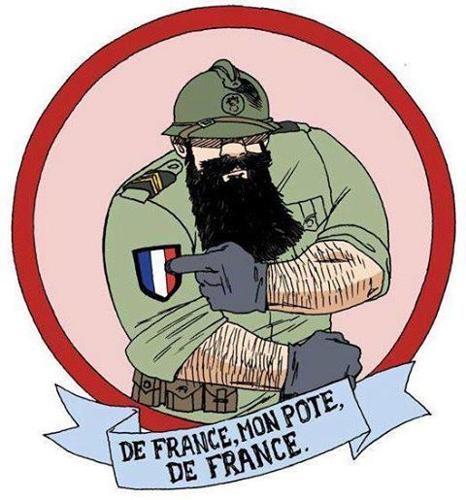

[806/2000] e0d09dc22e6b1a3c4b3e2064754133c85b5751c0d7edca2824078da31e565307



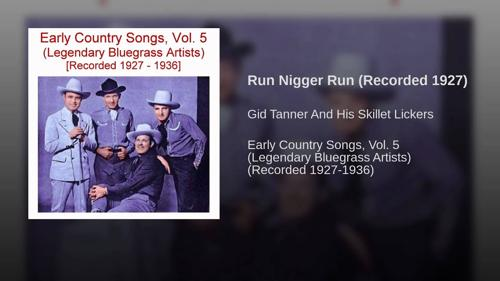

[807/2000] 2768c65507519a15e831e2b32b7d2a315c6c65a51548e3666735530676f8b669
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2768c65507519a15e831e2b32b7d2a315c6c65a51548e3666735530676f8b669.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2768c65507519a15e831e2b32b7d2a315c6c65a51548e3666735530676f8b669.gz'
Failed to load target image.
[808/2000] 6b81e67df90851389632fccade3cfa445b7983fb8745c925aa0d53fe59aba447
[809/2000] 60f61c8ecdc676f0d97bd60298a92b52b0e4563354f8dcbfedf519b095ff1173



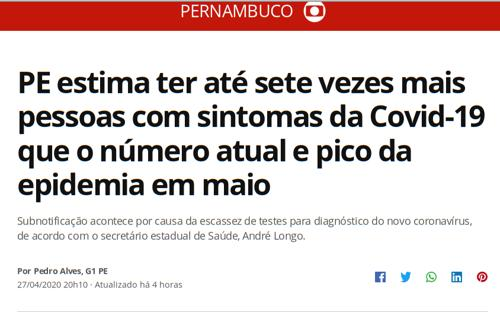

[810/2000] 53eabe3e78653d3c8736c5f41a5d517111eac2a74008642f3a465a1f3a21f458
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/53eabe3e78653d3c8736c5f41a5d517111eac2a74008642f3a465a1f3a21f458.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/53eabe3e78653d3c8736c5f41a5d517111eac2a74008642f3a465a1f3a21f458.gz'
Failed to load target image.
[811/2000] 404ca17ba7e6bb0f210bed76dd2c6223d69b2df731f5749dc15601d1c7573e06



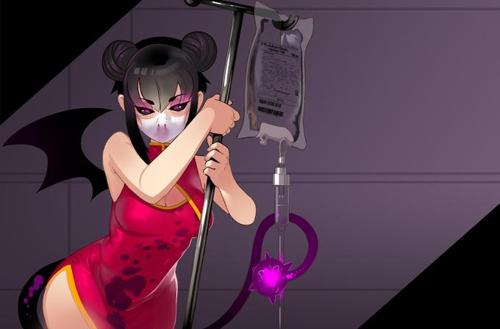

[812/2000] 367f9c01c1712f8ea0dbd04a0e6ed0f7b022cfbdd773da245ffed90c908016a5
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/367f9c01c1712f8ea0dbd04a0e6ed0f7b022cfbdd773da245ffed90c908016a5.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/367f9c01c1712f8ea0dbd04a0e6ed0f7b022cfbdd773da245ffed90c908016a5.gz'
Failed to load target image.
[813/2000] 6a1e431aa0da360418e4534770f25f00ee9a3743519212524e9c6d5a58c30986
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6a1e431aa0da360418e4534770f25f00ee9a3743519212524e9c6d5a58c30986.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6a1e431aa0da360418e4534770f25f00ee9a3743519212524e9c6d5a58c30986.gz'
Failed to load target image.
[814/2000] 692d2fda4535b4129f64b33b37dc1cba7d243fe1544f5773bc38e3ffd62422a4



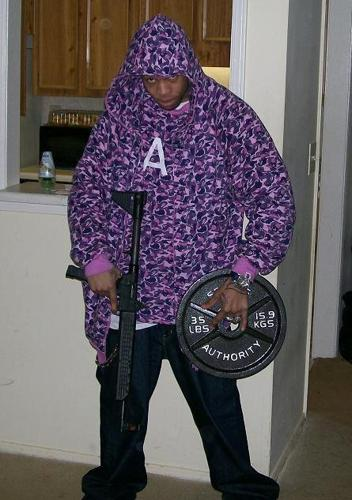

[815/2000] b444cdb64ef022fe8248abe58a86005d631e95b62c87dcd271b7a733fd1451e9
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b444cdb64ef022fe8248abe58a86005d631e95b62c87dcd271b7a733fd1451e9.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b444cdb64ef022fe8248abe58a86005d631e95b62c87dcd271b7a733fd1451e9.gz'
Failed to load target image.
[816/2000] 40755b3a3f958fd75d735abbdae6b68728c50237209c7175d91fcb16dd7fb46f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/40755b3a3f958fd75d735abbdae6b68728c50237209c7175d91fcb16dd7fb46f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/40755b3a3f958fd75d735abbdae6b68728c50237209c7175d91fcb16dd7fb46f.gz'
Failed to load target image.
[817/2000] 0f916994819a14a1ad96bc5ed94c19cec0d6235da06734ddc731bfd7bc2b744d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


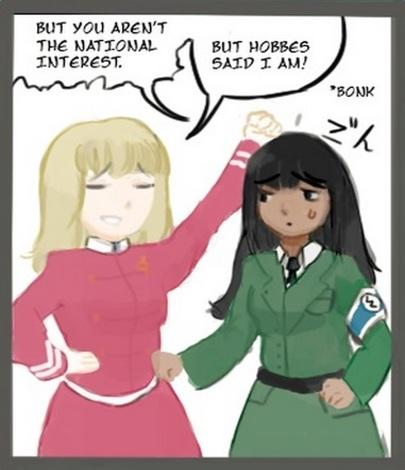

[826/2000] 4c74c607f6646df6eea80c0ce0f67141ce3070874d516ff24add964284ad2804
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4c74c607f6646df6eea80c0ce0f67141ce3070874d516ff24add964284ad2804.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4c74c607f6646df6eea80c0ce0f67141ce3070874d516ff24add964284ad2804.gz'
Failed to load target image.
[827/2000] 650e91952a72a8d136cdcb9767bd1275a3a8c87dfb911f6d8146928478c19349
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/650e91952a72a8d136cdcb9767bd1275a3a8c87dfb911f6d8146928478c19349.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/650e91952a72a8d136cdcb9767bd1275a3a8c87dfb911f6d8146928478c19349.gz'
Failed to load target image.
[828/2000] 8860234958f1670e5444cd4327371f3a1d68e3cfc911a1426fef4045e4916958



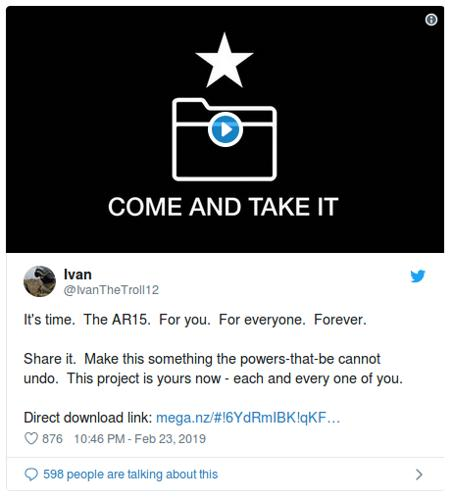

[829/2000] 47c64b0605658f492b4a9886eb5dba22b80413b29ff74c01f1d9510fa00202a8
[830/2000] 5a029d7ab219c1169b052382b3fd106b3fa750d9196a7c5f88ae7722bde081ca
[831/2000] 9e47ce88bbc3aa78a42d797c21924f0b56e051c5e003ea3eb354b8f0b2c6b0d8



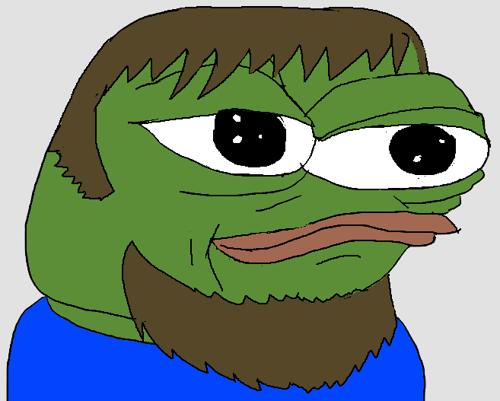

[832/2000] d70bd6a5b3fd7f3699c2dc2b516f4e531177465b097a40586b6bc09798738b2f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d70bd6a5b3fd7f3699c2dc2b516f4e531177465b097a40586b6bc09798738b2f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d70bd6a5b3fd7f3699c2dc2b516f4e531177465b097a40586b6bc09798738b2f.gz'
Failed to load target image.
[833/2000] 87d22530baac2e119b2a4ef8fddea2d17005fc517dcfe683e4c2ab520f49ab59
[834/2000] bdac67115ad095c745deb0f24926b652b3111bf72dfbbd3016e8c9f4a30925a7



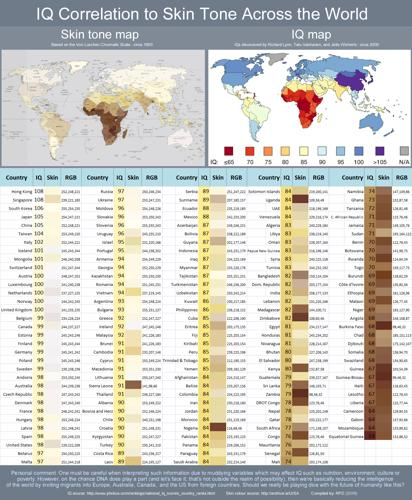

[835/2000] f0dc5c46c78735d464846c82f6dc55aa565059b796fc6361d6292a65ba766cee
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f0dc5c46c78735d464846c82f6dc55aa565059b796fc6361d6292a65ba766cee.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f0dc5c46c78735d464846c82f6dc55aa565059b796fc6361d6292a65ba766cee.gz'
Failed to load target image.
[836/2000] f2c5b7298f3c7939d8ff786598ba19847aabf147e544a6b4ce93b2a80bc7338f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f2c5b7298f3c7939d8ff786598ba19847aabf147e544a6b4ce93b2a80bc7338f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f2c5b7298f3c7939d8ff786598ba19847aabf147e544a6b4ce93b2a80bc7338f.gz'
Failed to load target image.
[837/2000] 996f0a9ddc179ac83efd59da0390826f82509517579a2f5d72ff150c13ee91bd
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


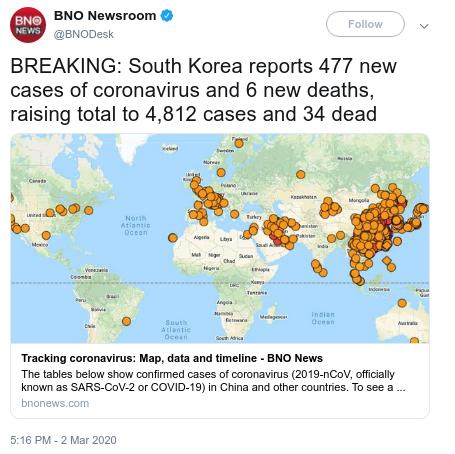

[841/2000] cc1cee8c73f62c4baabf123ca23fe5d4a304ae9c6d18233dedf775bb5e9b3b0f



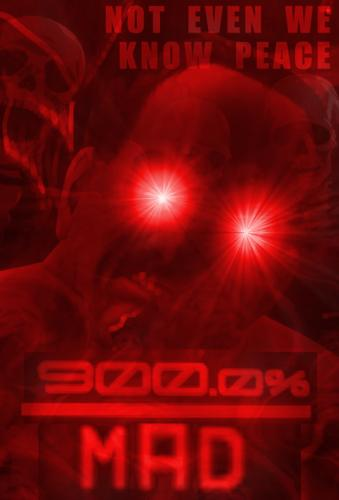

[842/2000] b51243a2e51c6e68db408fb4101da32e6cb657c7249f51cbd1ba9261a227ae22
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b51243a2e51c6e68db408fb4101da32e6cb657c7249f51cbd1ba9261a227ae22.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b51243a2e51c6e68db408fb4101da32e6cb657c7249f51cbd1ba9261a227ae22.gz'
Failed to load target image.
[843/2000] 3f0aea681261527757b7cc8fcb40401f99a74aad8ec9d7088dccf551d8e0b608
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3f0aea681261527757b7cc8fcb40401f99a74aad8ec9d7088dccf551d8e0b608.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3f0aea681261527757b7cc8fcb40401f99a74aad8ec9d7088dccf551d8e0b608.gz'
Failed to load target image.
[844/2000] eaa8617c74509e620ede3884e9a2d5175839c3013792d51a2b7945da5c5a4f0a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


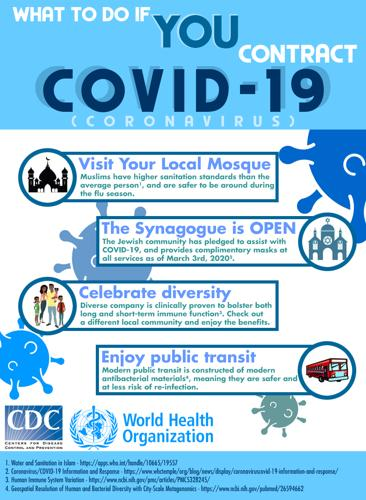

[850/2000] 7a6e57bc16a7f0cebbd6ec794a375fe1e59d2651fd5d75dd872af1f1d6deb807



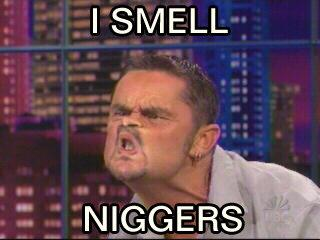

[851/2000] a0ebc73b0f15d4ab966201649a991e040582c5906a19c88d3e88688aec2651c3
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a0ebc73b0f15d4ab966201649a991e040582c5906a19c88d3e88688aec2651c3.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a0ebc73b0f15d4ab966201649a991e040582c5906a19c88d3e88688aec2651c3.gz'
Failed to load target image.
[852/2000] 6ea6c2e4f426f8deab3571647426a726f937e57a804071e7ee7dbbba798ea399
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6ea6c2e4f426f8deab3571647426a726f937e57a804071e7ee7dbbba798ea399.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6ea6c2e4f426f8deab3571647426a726f937e57a804071e7ee7dbbba798ea399.gz'
Failed to load target image.
[853/2000] 5a2519cd9dae7efa328f2b20e79c36d802c812f415f1029758599270d6322962
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


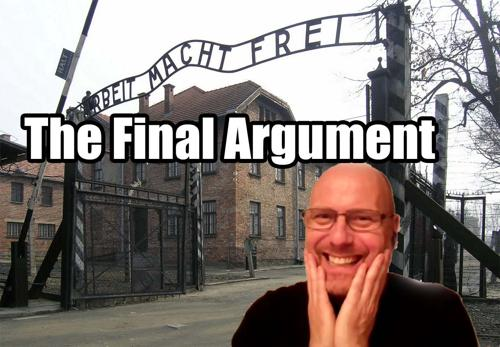

[856/2000] 908111fd76ac6ac88e1a2f415a948177c9b62c94686e7d493a07042fa4bc638e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/908111fd76ac6ac88e1a2f415a948177c9b62c94686e7d493a07042fa4bc638e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/908111fd76ac6ac88e1a2f415a948177c9b62c94686e7d493a07042fa4bc638e.gz'
Failed to load target image.
[857/2000] 963828c9093bd41db74a47c422224f67102b50e7cb9607002bfd3d6fa7b6e3cb
[858/2000] 23150c3f61c5030d0836013eacf723abbc9ba6ee54cab2ad1af3684e0cf832b8



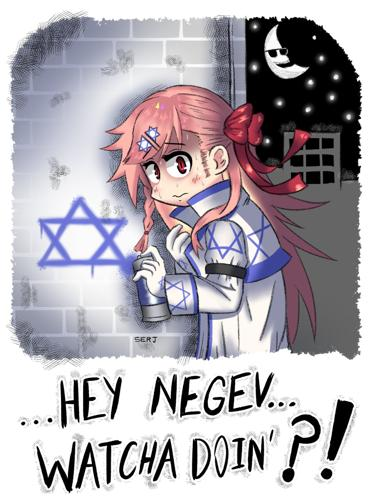

[859/2000] 7e084254f7c9b241b96d1cdcf861f10cd7fc265e650c67267a9a107a508cea29



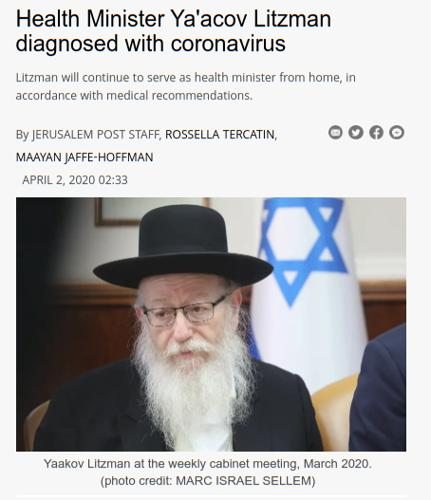

[860/2000] 1b382d38994977b17cdb4597716f00756ddb73eded9a5c26d6174064d8b9112d



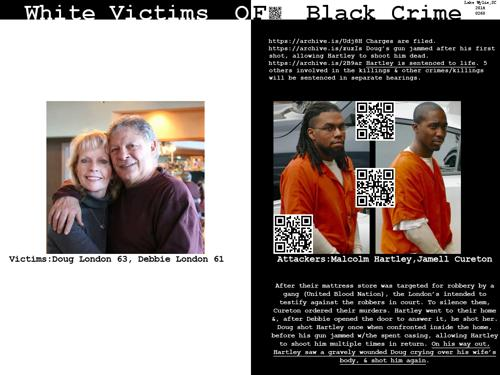

[861/2000] 592a4f61b62b0d99c868f49af02bf45b5aeaf2543763e3e0a6dc5048e9ab8eba
[862/2000] f4665902e796b10553bc76fa1157547309e469f59ddce425f3c521887205cd7d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f4665902e796b10553bc76fa1157547309e469f59ddce425f3c521887205cd7d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f4665902e796b10553bc76fa1157547309e469f59ddce425f3c521887205cd7d.gz'
Failed to load target image.
[863/2000] 6e3ec6e0ac2e698ce9011dfe8a564e3d5c7767e42cd0b4d86551a261aaf71371
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6e3ec6e0ac2e698ce9011dfe8a564e3d5c7767e42cd0b4d86551a261aaf71371.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6e3ec6e0ac2e698ce9011dfe8a564e3d5c7767e42cd0b4d86551a261aaf71371.gz'
Failed to load target image.
[864/2000] ad03774f278be5610be0e1df8f086512cfe384294d716988417

/home/xiang_fang1/meme/lib/python3.12/site-packages/PIL/Image.py:1043: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/home/xiang_fang1/meme/lib/python3.12/site-packages/PIL/Image.py:1043: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(



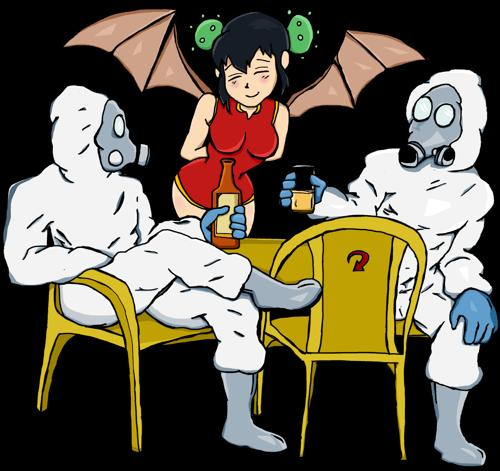

[870/2000] 12ecf530629fc922930e9d985331dc8afbe6094595ee2af1c97b823b3fe25796



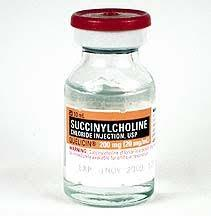

[871/2000] 698a1700780035e19931e7bd4bf421b71fa7bf506ac76e1a09d61f565f0ff489
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/698a1700780035e19931e7bd4bf421b71fa7bf506ac76e1a09d61f565f0ff489.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/698a1700780035e19931e7bd4bf421b71fa7bf506ac76e1a09d61f565f0ff489.gz'
Failed to load target image.
[872/2000] 2d704841ba328fdcb82c41d25af35f6bb0c22fa23cb4611f293f37f89cacf258
[873/2000] 64c3544cb729c31838c40ba257ea68dce0c319925645a4f9c4a8dc14bd514d74
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/64c3544cb729c31838c40ba257ea68dce0c319925645a4f9c4a8dc14bd514d74.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/64c3544cb729c31838c40ba257ea68dce0c319925645a4f9c4a8dc14bd514d74.gz'
Failed to load target image.
[874/2000] e915d237ad3e4a7e032ccf01e5b3233af77d37731fb9c684cdc


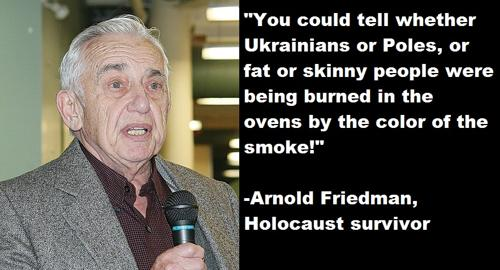

[875/2000] c0a329161a7f759885a8cbb560144781f6a8a363296abbf4f057bccfe8f754bb
[876/2000] 6837cbe4fbd80e084cccfef65aaed8ecc24b4819dcd63154a4f0ca08442d6927
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6837cbe4fbd80e084cccfef65aaed8ecc24b4819dcd63154a4f0ca08442d6927.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6837cbe4fbd80e084cccfef65aaed8ecc24b4819dcd63154a4f0ca08442d6927.gz'
Failed to load target image.
[877/2000] 71cbea4aec484f0ec5df34b9379cdde7c2aaf5ec20a5f9205192a7037091bc23
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/71cbea4aec484f0ec5df34b9379cdde7c2aaf5ec20a5f9205192a7037091bc23.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/71cbea4aec484f0ec5df34b9379cdde7c2aaf5ec20a5f9205192a7037091bc23.gz'
Failed to load target image.
[878/2000] c3c18f17caa7839abcdb80480663084ee8f0451f039f2ef8534


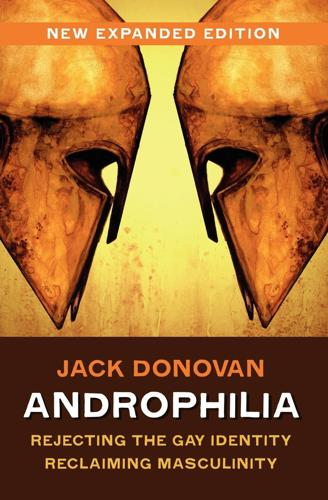

[896/2000] 972ddf0353c1baeb65e5537c3b774e89158a82d4ad54cd481e975392299f6dc9
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/972ddf0353c1baeb65e5537c3b774e89158a82d4ad54cd481e975392299f6dc9.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/972ddf0353c1baeb65e5537c3b774e89158a82d4ad54cd481e975392299f6dc9.gz'
Failed to load target image.
[897/2000] a36dbeeab8b17d43db1a1da06d141172052dd277e8734bff2e89d6f6effaf613
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a36dbeeab8b17d43db1a1da06d141172052dd277e8734bff2e89d6f6effaf613.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a36dbeeab8b17d43db1a1da06d141172052dd277e8734bff2e89d6f6effaf613.gz'
Failed to load target image.
[898/2000] cdd43de252f61178e21ec7fc7cda10dbffaec65d6e2e319f134d87ba85aef651
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


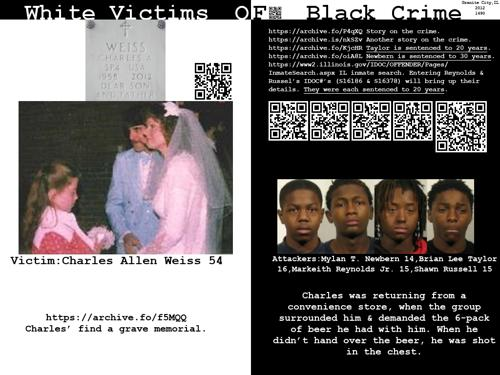

[902/2000] 52a4928676849d7bc391802adb7161be22a662da96f420da5b92f1d6c57aea4a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/52a4928676849d7bc391802adb7161be22a662da96f420da5b92f1d6c57aea4a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/52a4928676849d7bc391802adb7161be22a662da96f420da5b92f1d6c57aea4a.gz'
Failed to load target image.
[903/2000] 197dbe46039a119ac5078a6cef24bc5a779e98faea5257b20e8d3c1960a7babb
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/197dbe46039a119ac5078a6cef24bc5a779e98faea5257b20e8d3c1960a7babb.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/197dbe46039a119ac5078a6cef24bc5a779e98faea5257b20e8d3c1960a7babb.gz'
Failed to load target image.
[904/2000] a9ea1f90e47178836b3cb2e44d432d4595408a7e85537ff1065566de0fa4394a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


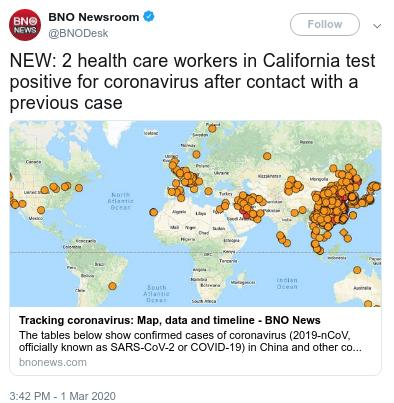

[908/2000] 5b0b7089e0458ae49ec4f3300f4abe5b23c2d7877879b8f7794de828ca512818
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5b0b7089e0458ae49ec4f3300f4abe5b23c2d7877879b8f7794de828ca512818.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5b0b7089e0458ae49ec4f3300f4abe5b23c2d7877879b8f7794de828ca512818.gz'
Failed to load target image.
[909/2000] d17793e868533350887de2f664c2e2e3ca9ec75d2a05badf35246bb9beabf43b



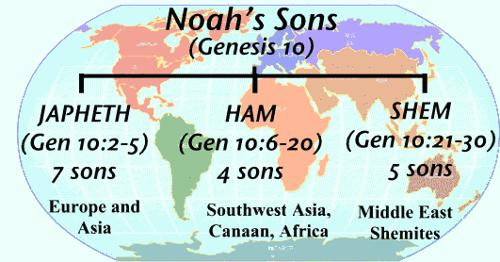

[910/2000] 4b231ed6972c7c068c4a6eef806f855904bf24099305eda553f843f99047b85a
[911/2000] 72a7f3c46c6c9d089335763b18aa9c70e07abb8f77a0f56e00f85528aae4a478
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/72a7f3c46c6c9d089335763b18aa9c70e07abb8f77a0f56e00f85528aae4a478.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/72a7f3c46c6c9d089335763b18aa9c70e07abb8f77a0f56e00f85528aae4a478.gz'
Failed to load target image.
[912/2000] 014422b3fdf6a39465444186e0f10adbc1183c41d24a36e6201d9dd8d06f2e45



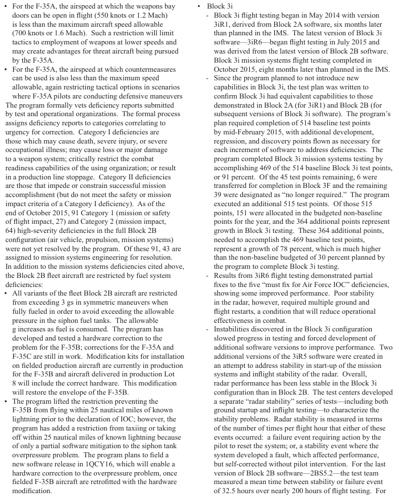

[913/2000] 478ee47996147ad0c45786183d24caaa5785f44934eb39726a90b84005f0fe5e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/478ee47996147ad0c45786183d24caaa5785f44934eb39726a90b84005f0fe5e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/478ee47996147ad0c45786183d24caaa5785f44934eb39726a90b84005f0fe5e.gz'
Failed to load target image.
[914/2000] 99d38eb89fbd760b7de8ec5efff180d311a37bf17a3a8e2c0acc3c3b2952ab49
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/99d38eb89fbd760b7de8ec5efff180d311a37bf17a3a8e2c0acc3c3b2952ab49.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/99d38eb89fbd760b7de8ec5efff180d311a37bf17a3a8e2c0acc3c3b2952ab49.gz'
Failed to load target image.
[915/2000] 53150f6217249be9d0f71dc7a1c405e19f0c68528b8d75d2010e785b033283cf
[916/2000] cb427b7d6e56fce103767ef90a1069cffc19a5b024448fe540b


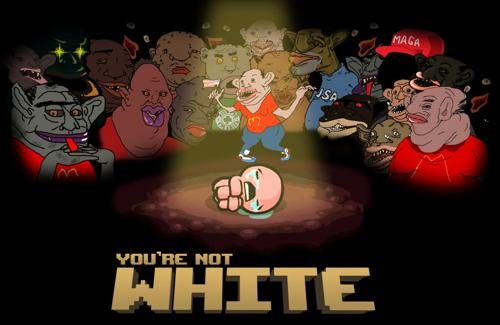

[918/2000] 2b746e2e932d866efe74cad2f91a28180e7ceae6ad077a4db9077fbc1282922c



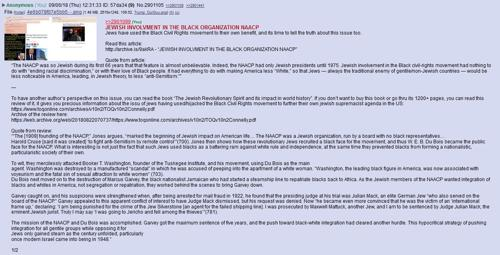

[919/2000] e17ec2acd842d6063017e6eb5315814e23aa5a968336caa6154f8dafbec03a47
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e17ec2acd842d6063017e6eb5315814e23aa5a968336caa6154f8dafbec03a47.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e17ec2acd842d6063017e6eb5315814e23aa5a968336caa6154f8dafbec03a47.gz'
Failed to load target image.
[920/2000] eedbd6fc3e9d17e39b3ed052b623a6993f7bd6280a0c27430c162c50dc14b28d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/eedbd6fc3e9d17e39b3ed052b623a6993f7bd6280a0c27430c162c50dc14b28d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/eedbd6fc3e9d17e39b3ed052b623a6993f7bd6280a0c27430c162c50dc14b28d.gz'
Failed to load target image.
[921/2000] 3ca9a627aebf840753a1bb827cca61e5c68275138e92e2cd022de0c40dcf1859
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


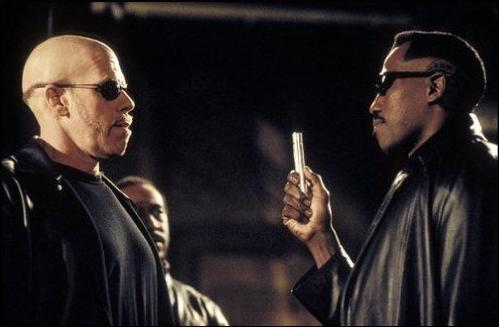

[923/2000] 3fbf773ad7f7dd1d5d265d944f062daf0098b548bd05894d29d63b4e5ba8e03f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3fbf773ad7f7dd1d5d265d944f062daf0098b548bd05894d29d63b4e5ba8e03f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3fbf773ad7f7dd1d5d265d944f062daf0098b548bd05894d29d63b4e5ba8e03f.gz'
Failed to load target image.
[924/2000] d91ed239e178fe1e5c194ff02a2dea202290549fbb4512071b4bca05d7ccdf2f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d91ed239e178fe1e5c194ff02a2dea202290549fbb4512071b4bca05d7ccdf2f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d91ed239e178fe1e5c194ff02a2dea202290549fbb4512071b4bca05d7ccdf2f.gz'
Failed to load target image.
[925/2000] 16710393d3063080754de71fb3a60265491f38685da6959450e5c50252959c7a
[926/2000] bfcd344658be5fa847d3feb6470e27b30dc283c1fa6265a20e0


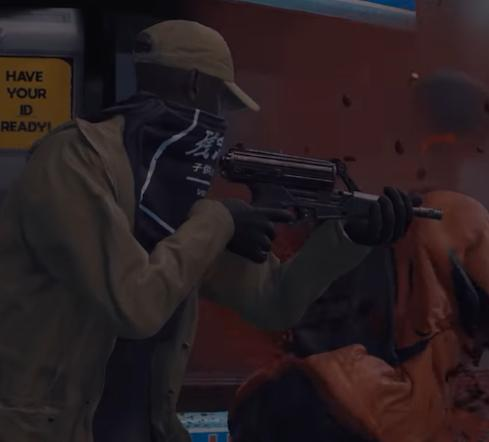

[934/2000] df77469e71b8fba3c9c8a118c80530a1b8b2c5473d1fcb93acb18fc0a454f6f8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/df77469e71b8fba3c9c8a118c80530a1b8b2c5473d1fcb93acb18fc0a454f6f8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/df77469e71b8fba3c9c8a118c80530a1b8b2c5473d1fcb93acb18fc0a454f6f8.gz'
Failed to load target image.
[935/2000] b24c52eb145786eda2fa1b4fc53fa38395a301fbb49319a5c25df5ab842c6fe8
[936/2000] 7b7aeb0dda8cee77055cb9235d0c273c27ab8019b1dfa913a1348e1b62cf6ee2
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7b7aeb0dda8cee77055cb9235d0c273c27ab8019b1dfa913a1348e1b62cf6ee2.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7b7aeb0dda8cee77055cb9235d0c273c27ab8019b1dfa913a1348e1b62cf6ee2.gz'
Failed to load target image.
[937/2000] 7683566a4ddd68f7966b30177a6e9b2cb9cfaca516ceedfcb30


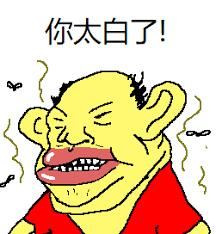

[938/2000] d04271fd4a705467ccf52b0b1ae0303c97118101a6f69bb174255e38ab77e5a3



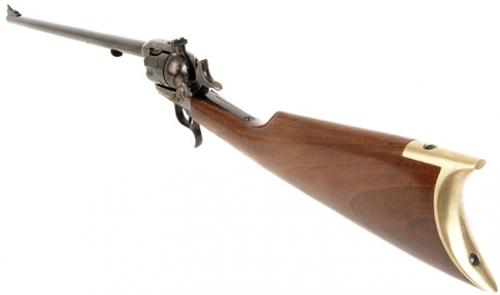

[939/2000] dc316f18fcf56469af455085b781b713d54c5e2e47ddc196d402bae1c200154d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/dc316f18fcf56469af455085b781b713d54c5e2e47ddc196d402bae1c200154d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/dc316f18fcf56469af455085b781b713d54c5e2e47ddc196d402bae1c200154d.gz'
Failed to load target image.
[940/2000] b5300d220c2b7c22fc155393e2fed61713e97aa3325a002944d1172cd7d1b915



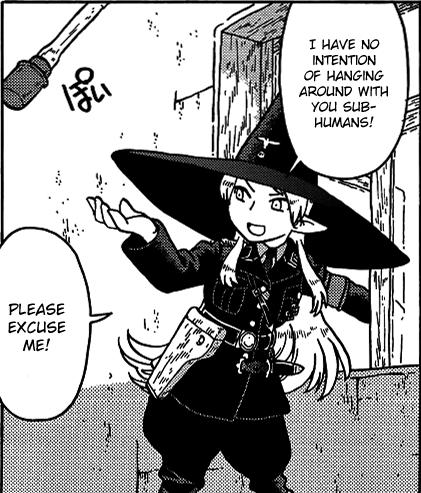

[941/2000] 14c505c45fb646a6100e2065c948eaf501c53fba005eaa412dc51e207d8bd817



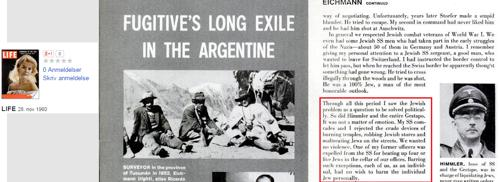

[942/2000] cd425ff414656249cb2e1920c7a368d4afc5ee178fb531af1709ffe26bc9f72f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cd425ff414656249cb2e1920c7a368d4afc5ee178fb531af1709ffe26bc9f72f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cd425ff414656249cb2e1920c7a368d4afc5ee178fb531af1709ffe26bc9f72f.gz'
Failed to load target image.
[943/2000] 287a36ea10ce1e42d2511ce152cd5b7909f46a5c219a700ec24da6b33eaa884d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/287a36ea10ce1e42d2511ce152cd5b7909f46a5c219a700ec24da6b33eaa884d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/287a36ea10ce1e42d2511ce152cd5b7909f46a5c219a700ec24da6b33eaa884d.gz'
Failed to load target image.
[944/2000] 1df69d4e1144eed7a07cc5553786a4d166e017073ccc854c0cc99e5513b6e9fd
[945/2000] 8ad882472706dfb8df9cc58e0e84f259248f4d704be51d7856b


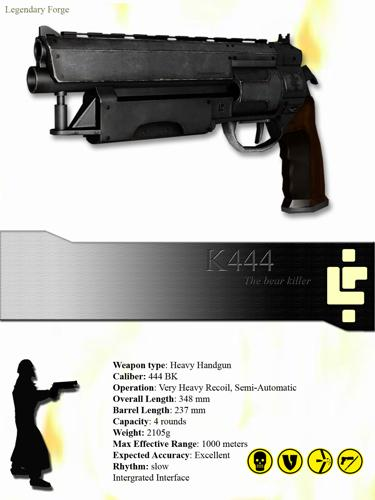

[951/2000] d6aad84b9f708846f009aaae64aab499846721a4e4eb836f49fef57d7c5aa21d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d6aad84b9f708846f009aaae64aab499846721a4e4eb836f49fef57d7c5aa21d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d6aad84b9f708846f009aaae64aab499846721a4e4eb836f49fef57d7c5aa21d.gz'
Failed to load target image.
[952/2000] 411437d81bd5e72de473de2c52d37266e164ce7ffbe65c452f9069134931b47a
[953/2000] 64c6efbf73319c74d4be1be16d85d0f87ff90480f8f397065025c3e505fc5e62



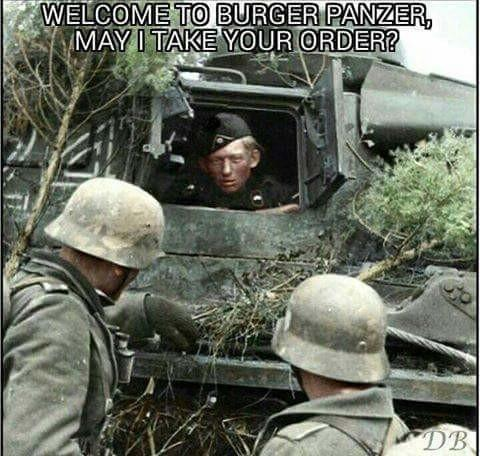

[954/2000] 4c30aa48a483913b94637599d2abeee5b5d08c084a44d4c6fd39ae912f15aacd



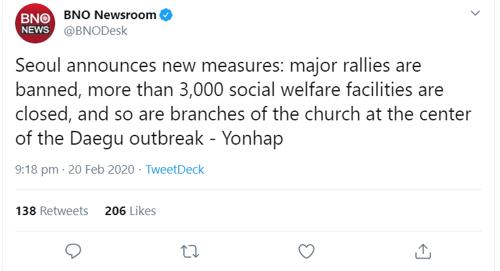

[955/2000] a822f4db352282f86fd574ef31c09a20cbf35f5888c3f691d817d412652674b6
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a822f4db352282f86fd574ef31c09a20cbf35f5888c3f691d817d412652674b6.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a822f4db352282f86fd574ef31c09a20cbf35f5888c3f691d817d412652674b6.gz'
Failed to load target image.
[956/2000] b6e095294c2c99f2e1c2baa1b977fc867656e9a925becc22d27a96bd8db66341



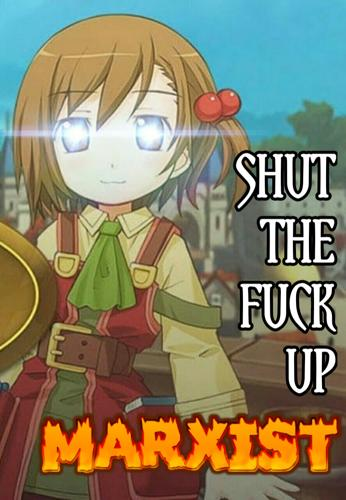

[957/2000] 66c9a805f74cc74637b7159e4b5d6ea2a8618aaba69689fcef0d27a8787bbbd6



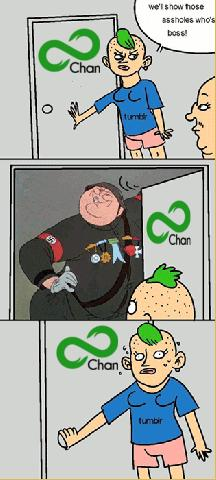

[958/2000] 8be99a115803027aa65d844cb7cab3dc15fdbc7be88060e7ffe239a6317c8407
[959/2000] 1e31a761a6a4a3ab6723fdb74d78cd91d912a0fe67471a35a8a0e10cd35a9b5c



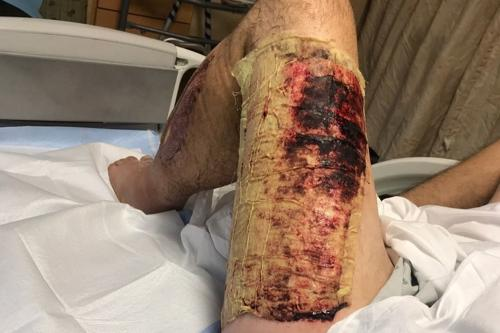

[960/2000] 9d91c83e06fbb8696ced18e467c3aee27c9e3c7071f6ee7ae1434e7876abf576
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9d91c83e06fbb8696ced18e467c3aee27c9e3c7071f6ee7ae1434e7876abf576.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9d91c83e06fbb8696ced18e467c3aee27c9e3c7071f6ee7ae1434e7876abf576.gz'
Failed to load target image.
[961/2000] 24de39a98b9fe15dbd1313aba7248ee572888614f2c5eb79c41e0d66ff491fca
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/24de39a98b9fe15dbd1313aba7248ee572888614f2c5eb79c41e0d66ff491fca.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/24de39a98b9fe15dbd1313aba7248ee572888614f2c5eb79c41e0d66ff491fca.gz'
Failed to load target image.
[962/2000] 1133e6595b74cd077685a34dee6e0fc799e282faee4082c80626893d9355482f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


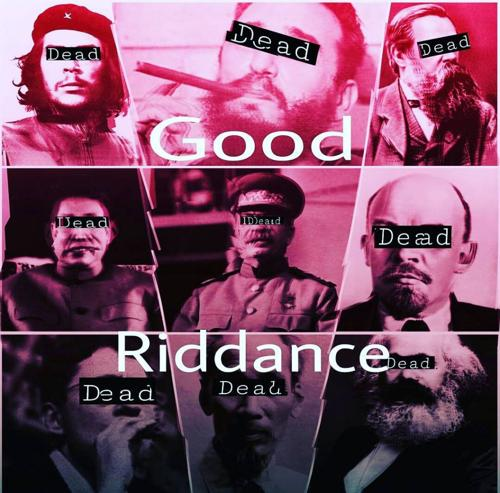

[965/2000] aa57311519db5156f421fe6613084bee690389fb34622a3b66fcc5103c75d931
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/aa57311519db5156f421fe6613084bee690389fb34622a3b66fcc5103c75d931.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/aa57311519db5156f421fe6613084bee690389fb34622a3b66fcc5103c75d931.gz'
Failed to load target image.
[966/2000] 6b3d5827f88c1c01f9f5f37442854e0c1ccd76a6b81972b094bed20b84d9a821
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6b3d5827f88c1c01f9f5f37442854e0c1ccd76a6b81972b094bed20b84d9a821.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6b3d5827f88c1c01f9f5f37442854e0c1ccd76a6b81972b094bed20b84d9a821.gz'
Failed to load target image.
[967/2000] a4519e6e9d1f8165e5781d51670d08750bacb3be2c4c078be2d4f395ee1a5646
[968/2000] 66b881ff25cb69cfccc0f248b97dc62cb281869edf3fd1bd4f9


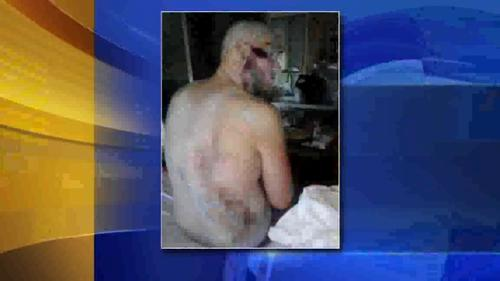

[971/2000] bcdea5306bce82e9e72f0422b499befec03933e6a3c9d0d38350bd5fa5095b55
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bcdea5306bce82e9e72f0422b499befec03933e6a3c9d0d38350bd5fa5095b55.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bcdea5306bce82e9e72f0422b499befec03933e6a3c9d0d38350bd5fa5095b55.gz'
Failed to load target image.
[972/2000] 159e932bd984a30b87827410dd6eaac758d1d68d5844552e7b0be854f606759f



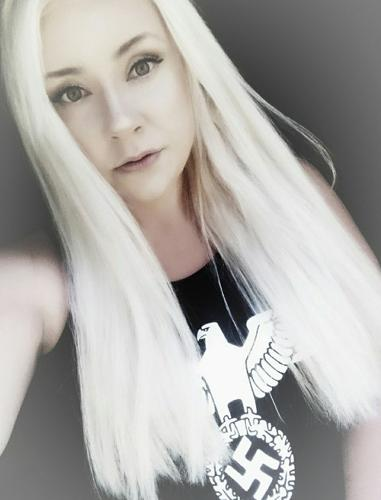

[973/2000] a825b53538aae1b94c1d9733bd40835b2bc94cff0c8193d897ce6f56f7e3ba6d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a825b53538aae1b94c1d9733bd40835b2bc94cff0c8193d897ce6f56f7e3ba6d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a825b53538aae1b94c1d9733bd40835b2bc94cff0c8193d897ce6f56f7e3ba6d.gz'
Failed to load target image.
[974/2000] e58dd931d07b627b24dcbf8cb231cd1cc8ea6f7ec1715e6d13cd57247685bd0d



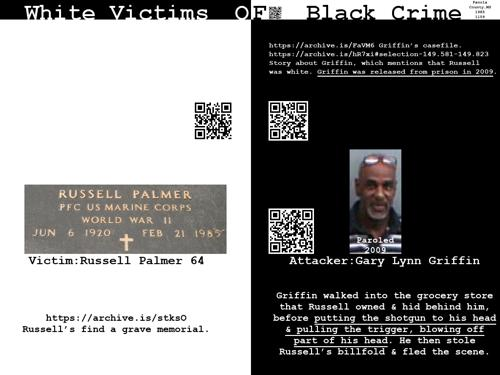

[975/2000] 8db377a704793131b5a92b9f9044bc4d8ab09e6f1b576eec2dc1d3e4132cc208



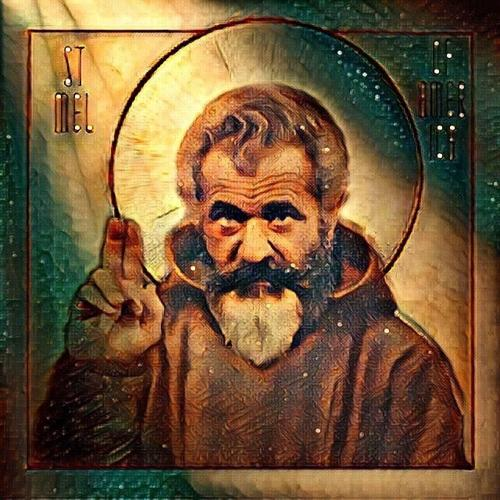

[976/2000] 14b2901e78099683f5be1d09a39d95775cda78712db42e61e726d9834180c7f7



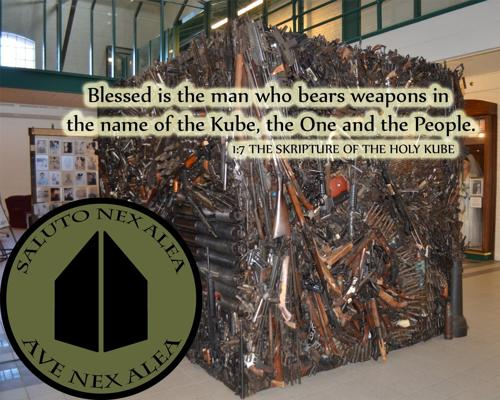

[977/2000] d892180e8d04afb1c3661353a35779ac53ff09cb69c83560ce1b1430e4c4a460
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d892180e8d04afb1c3661353a35779ac53ff09cb69c83560ce1b1430e4c4a460.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d892180e8d04afb1c3661353a35779ac53ff09cb69c83560ce1b1430e4c4a460.gz'
Failed to load target image.
[978/2000] 81ef8db4f4122044727c0c57a199a645257c3b7c322877dae866462e9b315006
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/81ef8db4f4122044727c0c57a199a645257c3b7c322877dae866462e9b315006.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/81ef8db4f4122044727c0c57a199a645257c3b7c322877dae866462e9b315006.gz'
Failed to load target image.
[979/2000] 7b5fd88cff832c15830a9aa6bb96d2a56f1dd42b195768df995f84766d9d1edf
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


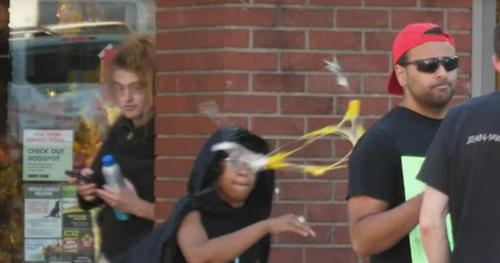

[982/2000] 8a7248eb9e48b0d7d2e5c990449a6b55538d19fb2a6174b3a06f2faa229c217a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8a7248eb9e48b0d7d2e5c990449a6b55538d19fb2a6174b3a06f2faa229c217a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8a7248eb9e48b0d7d2e5c990449a6b55538d19fb2a6174b3a06f2faa229c217a.gz'
Failed to load target image.
[983/2000] 51b0adf1a8d59e8d70fac9871ed664515c7df31baeb5119d95c9b613d6acf5cb
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/51b0adf1a8d59e8d70fac9871ed664515c7df31baeb5119d95c9b613d6acf5cb.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/51b0adf1a8d59e8d70fac9871ed664515c7df31baeb5119d95c9b613d6acf5cb.gz'
Failed to load target image.
[984/2000] b6c931efd89b3040c7e0c3aa068d58556165745cd823a179202e8d571b3581af
[985/2000] ded28f058b274427ecdda2a91ef6b69e4881eeb98e3940c1713


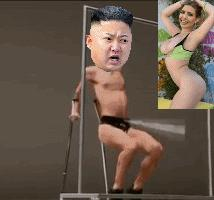

[987/2000] 5e89a8ed9c4cb898804d91fb3ac954f7d47c48e2c7bd4b30c2ad90861b45ddac
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5e89a8ed9c4cb898804d91fb3ac954f7d47c48e2c7bd4b30c2ad90861b45ddac.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5e89a8ed9c4cb898804d91fb3ac954f7d47c48e2c7bd4b30c2ad90861b45ddac.gz'
Failed to load target image.
[988/2000] 1cf4dbc2b1070d102f0b85da904721809d10be49d2097c5d8a91a43e2a694299



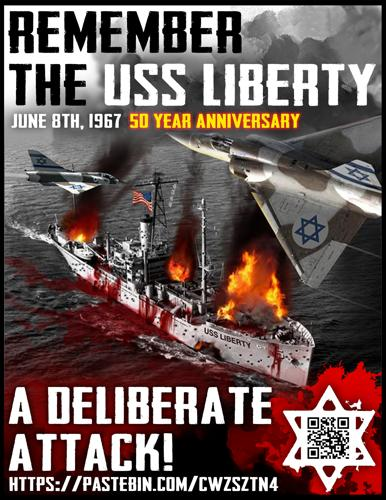

[989/2000] 53791ee4d43590da1178d09a3e9348878eaab4a756f83bd81bd7591ee9f07805
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/53791ee4d43590da1178d09a3e9348878eaab4a756f83bd81bd7591ee9f07805.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/53791ee4d43590da1178d09a3e9348878eaab4a756f83bd81bd7591ee9f07805.gz'
Failed to load target image.
[990/2000] 68a67f15445b299568cc3e5cc9b9c606446b3aff51bad0ada1c90eb557ec9f66
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/68a67f15445b299568cc3e5cc9b9c606446b3aff51bad0ada1c90eb557ec9f66.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/68a67f15445b299568cc3e5cc9b9c606446b3aff51bad0ada1c90eb557ec9f66.gz'
Failed to load target image.
[991/2000] 8bf0c4c33c65eea9cd06870b2f122bf064a4c231dfb3704e021d3d4028306732
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-i


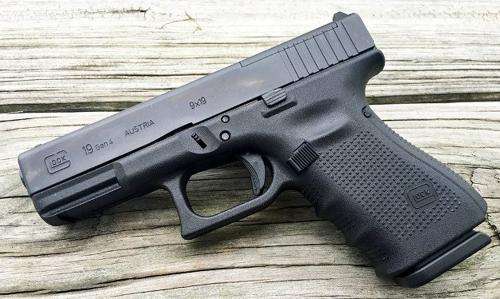

[1002/2000] 496907f16a00efe08d6fc2a3453a5176f474fe4e6cc134af99dd40a5f362cfed
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/496907f16a00efe08d6fc2a3453a5176f474fe4e6cc134af99dd40a5f362cfed.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/496907f16a00efe08d6fc2a3453a5176f474fe4e6cc134af99dd40a5f362cfed.gz'
Failed to load target image.
[1003/2000] 40f6e412d49fec09faf9f934cb187fd2bcec6c6d3b938b9ade5d1a306fd8f8c7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/40f6e412d49fec09faf9f934cb187fd2bcec6c6d3b938b9ade5d1a306fd8f8c7.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/40f6e412d49fec09faf9f934cb187fd2bcec6c6d3b938b9ade5d1a306fd8f8c7.gz'
Failed to load target image.
[1004/2000] 9f44d5b13bbddae2d7ade7cd0363ea0882da322f9df53911529f106fa3e97d57
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


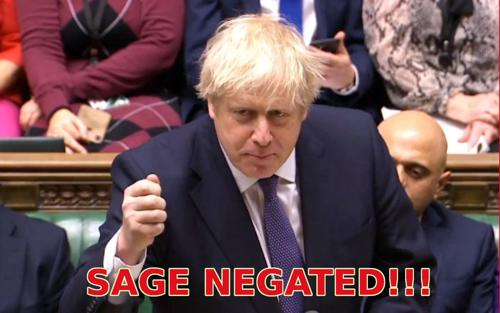

[1012/2000] 11c4e08acb98b45d6dd5b910c721ecc8ce8885396c1f4f632e42e74eb1521ad2
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/11c4e08acb98b45d6dd5b910c721ecc8ce8885396c1f4f632e42e74eb1521ad2.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/11c4e08acb98b45d6dd5b910c721ecc8ce8885396c1f4f632e42e74eb1521ad2.gz'
Failed to load target image.
[1013/2000] 39ee26edc279b14dbb7b26d8f21de41385847abe6f794c767765ac5dc937446a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/39ee26edc279b14dbb7b26d8f21de41385847abe6f794c767765ac5dc937446a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/39ee26edc279b14dbb7b26d8f21de41385847abe6f794c767765ac5dc937446a.gz'
Failed to load target image.
[1014/2000] affd956a20eace52e4defc462a6bf50fbcb30fca7e7d758a99b341a193547427
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


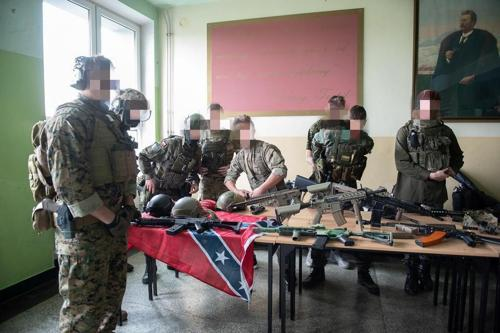

[1022/2000] 579e4878468dccfb62823f42a6b583a43becb1efc5ac0b3c1bce13de424ac3c9
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/579e4878468dccfb62823f42a6b583a43becb1efc5ac0b3c1bce13de424ac3c9.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/579e4878468dccfb62823f42a6b583a43becb1efc5ac0b3c1bce13de424ac3c9.gz'
Failed to load target image.
[1023/2000] c6b1e46e8b8c05efdee8c67ee7ca51fa175cae13f0bf1a250fd75620aae0d418
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c6b1e46e8b8c05efdee8c67ee7ca51fa175cae13f0bf1a250fd75620aae0d418.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c6b1e46e8b8c05efdee8c67ee7ca51fa175cae13f0bf1a250fd75620aae0d418.gz'
Failed to load target image.
[1024/2000] ed083296e3b6be8f57726c55d9daaca0e7e13af4ec7dd0c48249a4af5889f68a
[1025/2000] 79d725aaa4db872a5dffe51433c3679f2123594e7cd3acd


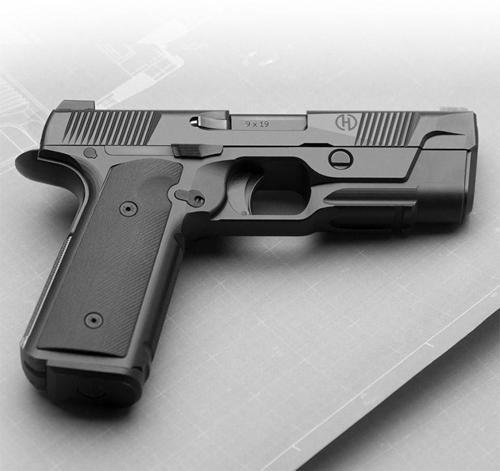

[1027/2000] b5a6a0b633c3865fa4c425dd56cd4b081d379fea958ca4de6cde108907a7475c



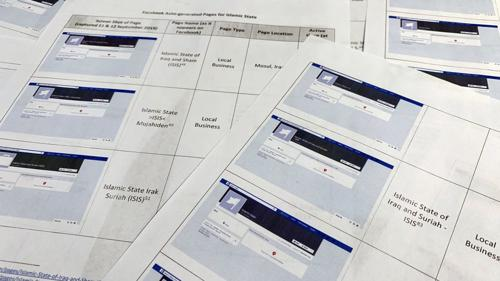

[1028/2000] b5067863eda3b54ec93a29411e5fb2367d44751e3486041aebb533694359e347



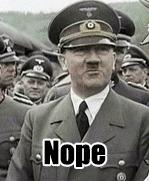

[1029/2000] e88fb6a6591c180b8245c0d081d6a1761f7ae297e9c0eda8cdb30adc51859302
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e88fb6a6591c180b8245c0d081d6a1761f7ae297e9c0eda8cdb30adc51859302.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e88fb6a6591c180b8245c0d081d6a1761f7ae297e9c0eda8cdb30adc51859302.gz'
Failed to load target image.
[1030/2000] db465b0d41a91b81bcf31a6a49e68b70d58bb2bee089d1260036e04c53c144e0



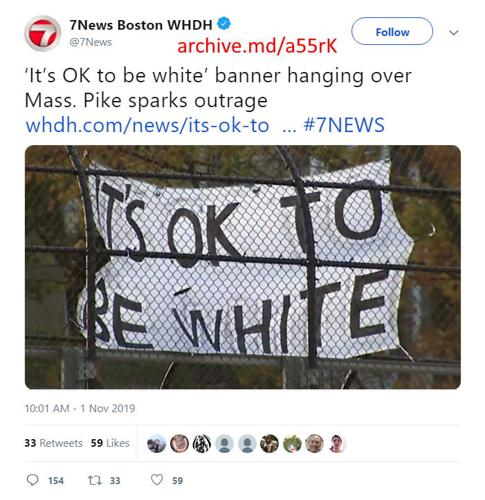

[1031/2000] 083af70597b7f7ff05e7b66dd798e8accf4083f90b36fdd6cd1af58b68e8e390
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/083af70597b7f7ff05e7b66dd798e8accf4083f90b36fdd6cd1af58b68e8e390.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/083af70597b7f7ff05e7b66dd798e8accf4083f90b36fdd6cd1af58b68e8e390.gz'
Failed to load target image.
[1032/2000] 4da5208f6d89f65b84bb261979ef90d894bd8565681a2e0c452adbe5b3b2681e



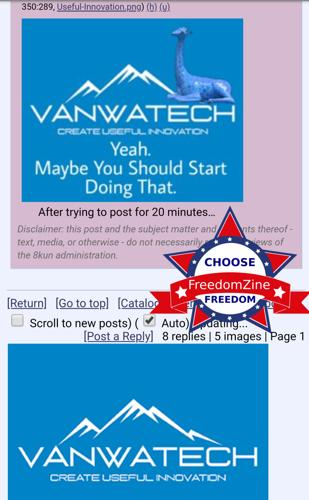

[1033/2000] 4ee399fee1104d11acda8921e52edabfb3272e468501275d47e4eff47fd2eaf3
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4ee399fee1104d11acda8921e52edabfb3272e468501275d47e4eff47fd2eaf3.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4ee399fee1104d11acda8921e52edabfb3272e468501275d47e4eff47fd2eaf3.gz'
Failed to load target image.
[1034/2000] 32abb955edb02054bb9395f165b2473215a7233d5127b3df3c9771524733e42e
[1035/2000] f7e715a3d55c961a2b838b02f299269898ee52864ee99484aa7f2e1550e83e34
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f7e715a3d55c961a2b838b02f299269898ee52864ee99484aa7f2e1550e83e34.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f7e715a3d55c961a2b838b02f299269898ee52864ee99484aa7f2e1550e83e34.gz'
Failed to load target image.
[1036/2000] d92b55b8ae5883ffe897a2e4bedd2cf36004e824fc1599d


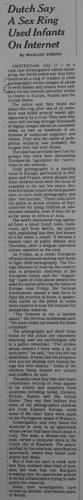

[1039/2000] ac766420777ee4d8235969a8df4f8267782baa0b33c3cad4712b6f206dafeb1e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ac766420777ee4d8235969a8df4f8267782baa0b33c3cad4712b6f206dafeb1e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ac766420777ee4d8235969a8df4f8267782baa0b33c3cad4712b6f206dafeb1e.gz'
Failed to load target image.
[1040/2000] ed7122b64d4433b33d950250b967cef1336b8e8b7171fd3f0fe8ed0aa7a7c10f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ed7122b64d4433b33d950250b967cef1336b8e8b7171fd3f0fe8ed0aa7a7c10f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ed7122b64d4433b33d950250b967cef1336b8e8b7171fd3f0fe8ed0aa7a7c10f.gz'
Failed to load target image.
[1041/2000] 11c46790211d0be2987e6d78a7aef0515e2da81c3abc4565ccf1c2a7ac4da7cf
[1042/2000] d867fe3fd3911832fe97cfc474d19a44fffa29668d15cdc


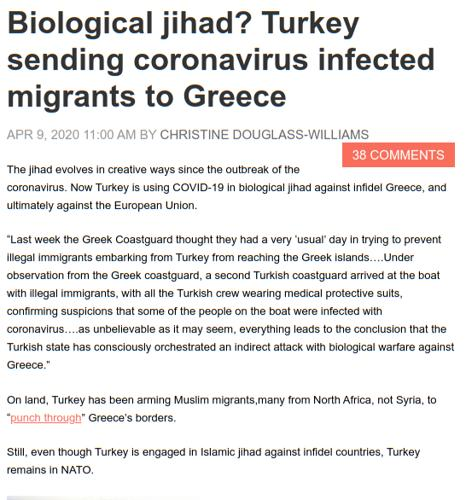

[1045/2000] 08a439a4b40f4af766bd636e829eeb47425ffed3ccbf4e23b589c7ec9071a930
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/08a439a4b40f4af766bd636e829eeb47425ffed3ccbf4e23b589c7ec9071a930.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/08a439a4b40f4af766bd636e829eeb47425ffed3ccbf4e23b589c7ec9071a930.gz'
Failed to load target image.
[1046/2000] 1f473340f07af30f886dc351ddd77ef41dd0b7c587d6a0da311f806a3e4ccf7d
[1047/2000] 9335fe143c348ec6244700b1954d5f99f1ae89aca499a2eba4b0de3aaa4beac4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9335fe143c348ec6244700b1954d5f99f1ae89aca499a2eba4b0de3aaa4beac4.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9335fe143c348ec6244700b1954d5f99f1ae89aca499a2eba4b0de3aaa4beac4.gz'
Failed to load target image.
[1048/2000] 6214cfd7c349224c4e6eec154dfe363087b3f7543a85094


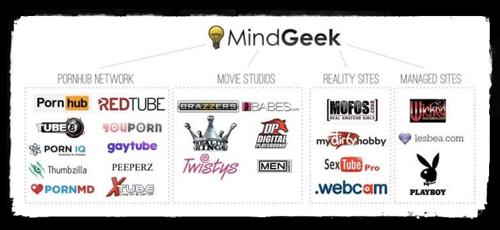

[1050/2000] a9f9287b6883e815b7464cc1f17bc6771a021f6bdbcc6868ba92ac73143d9cf0
[1051/2000] 49e1c65c8b20d31e3b9621829fa039c7ae1239ef10c4060192c6bec92feb1911
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/49e1c65c8b20d31e3b9621829fa039c7ae1239ef10c4060192c6bec92feb1911.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/49e1c65c8b20d31e3b9621829fa039c7ae1239ef10c4060192c6bec92feb1911.gz'
Failed to load target image.
[1052/2000] d0fe3ae2cbb399dab5d353e45679dd7da3ea4563834264c3cb6283c5df039860
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d0fe3ae2cbb399dab5d353e45679dd7da3ea4563834264c3cb6283c5df039860.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d0fe3ae2cbb399dab5d353e45679dd7da3ea4563834264c3cb6283c5df039860.gz'
Failed to load target image.
[1053/2000] ba71a4d5bf05dc7fa8d604b00a60e855e47314dc279dde3


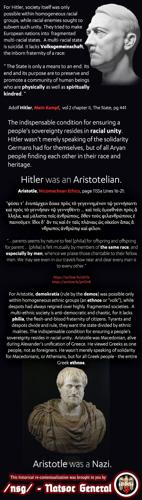

[1054/2000] 7a1c5149280d796ec7138c9f4232c71e922d4fc1e5ff006161ffa321423ffeff



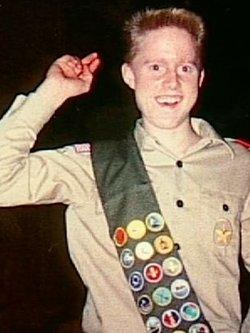

[1055/2000] c61b78aab3783274b7a0fc8842109e4ed800b37e6be88bf3c6f4bfe95d621572



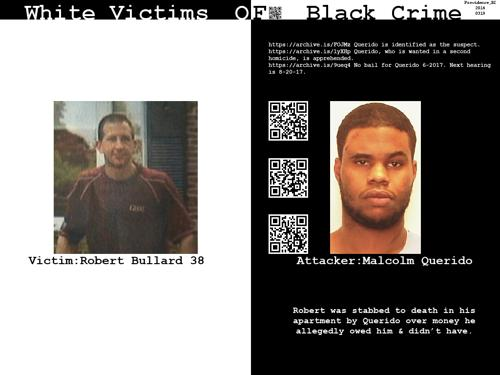

[1056/2000] 3fef9f127d9ce5d4d99ddd447002bf845f49111daff5e437a68a56556051ace9
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3fef9f127d9ce5d4d99ddd447002bf845f49111daff5e437a68a56556051ace9.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3fef9f127d9ce5d4d99ddd447002bf845f49111daff5e437a68a56556051ace9.gz'
Failed to load target image.
[1057/2000] 8da019ab0a4b076cecfe78f7ca6f2256b3186fe227c0138c679977cf620a05f6
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8da019ab0a4b076cecfe78f7ca6f2256b3186fe227c0138c679977cf620a05f6.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8da019ab0a4b076cecfe78f7ca6f2256b3186fe227c0138c679977cf620a05f6.gz'
Failed to load target image.
[1058/2000] 2c8387b4f3c08e2268eebe4323ec01baffbd9045f5c5fbba10f821c4fd3dc41b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


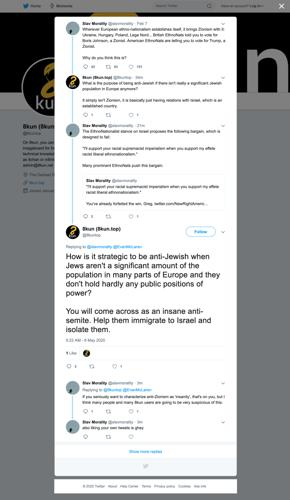

[1064/2000] fe7304cb7713580cba43f911441c4b7ee3a855a2a7615fe8d0c20431cc1ed85b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fe7304cb7713580cba43f911441c4b7ee3a855a2a7615fe8d0c20431cc1ed85b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fe7304cb7713580cba43f911441c4b7ee3a855a2a7615fe8d0c20431cc1ed85b.gz'
Failed to load target image.
[1065/2000] 0d6b3f9fa3df281f55997b57588b44b06cc5e2349dde6444d41d8869474232f3
[1066/2000] bccd937cc0d0192a1e50ee0ae05af93ba556696b08ae4afe9f199cb282ea0b3a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bccd937cc0d0192a1e50ee0ae05af93ba556696b08ae4afe9f199cb282ea0b3a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bccd937cc0d0192a1e50ee0ae05af93ba556696b08ae4afe9f199cb282ea0b3a.gz'
Failed to load target image.
[1067/2000] 1be393ae50ab77ee59ee350e689a294b2ad67d040565e01


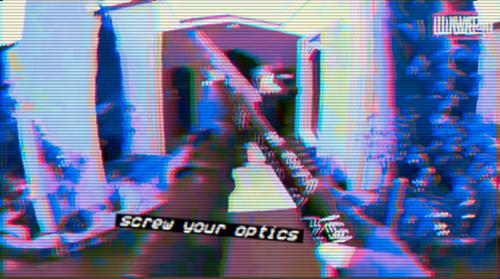

[1079/2000] e21491ab513ff55fd83e01d184c67dc0b481278c8b5ca8d7173aeda82f052a5e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e21491ab513ff55fd83e01d184c67dc0b481278c8b5ca8d7173aeda82f052a5e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e21491ab513ff55fd83e01d184c67dc0b481278c8b5ca8d7173aeda82f052a5e.gz'
Failed to load target image.
[1080/2000] aa307b62373207a47aed16e56436ef18f0a22a33bfe467b3c6e7d93cdf3f42e0
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/aa307b62373207a47aed16e56436ef18f0a22a33bfe467b3c6e7d93cdf3f42e0.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/aa307b62373207a47aed16e56436ef18f0a22a33bfe467b3c6e7d93cdf3f42e0.gz'
Failed to load target image.
[1081/2000] 0c674dcf118c8f121369080529a45fc986e08c164ec85543e869b4c623e853ee
[1082/2000] a6be8a7374f93b8c0e1051f06411e17cfc6c8fc18b0124f


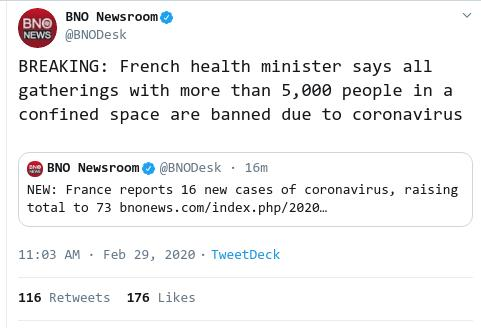

[1083/2000] 1d686bd689d16f0014ead9404d862d96995b60fc7314d043de4f843fc391e789
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1d686bd689d16f0014ead9404d862d96995b60fc7314d043de4f843fc391e789.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1d686bd689d16f0014ead9404d862d96995b60fc7314d043de4f843fc391e789.gz'
Failed to load target image.
[1084/2000] cb30875f483ac541acb93c0a0e2dd05351d402ba7ee47f378e4ea815b5ce133d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cb30875f483ac541acb93c0a0e2dd05351d402ba7ee47f378e4ea815b5ce133d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cb30875f483ac541acb93c0a0e2dd05351d402ba7ee47f378e4ea815b5ce133d.gz'
Failed to load target image.
[1085/2000] 91aa633153a61a018162164aabbfd384c0a5006cd639095db0b153f40d1b6078
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


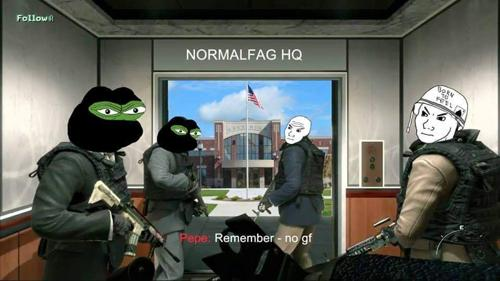

[1101/2000] 98b088eeaf64d33a3939eb068e51c06e9c9c73db2355b4e25fcffaef5ada01a4



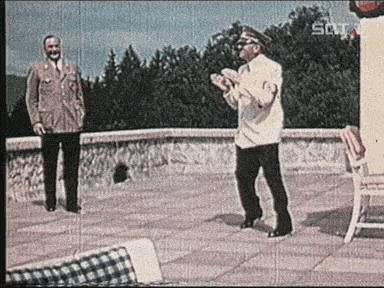

[1102/2000] 8be8d07ad134ebf962fdebfac7018ed8eed3cdfb8e60b6127ecfd4f0ff2e4554
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8be8d07ad134ebf962fdebfac7018ed8eed3cdfb8e60b6127ecfd4f0ff2e4554.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8be8d07ad134ebf962fdebfac7018ed8eed3cdfb8e60b6127ecfd4f0ff2e4554.gz'
Failed to load target image.
[1103/2000] da4fca861b389ebbe5d1524e2c6634610c5086f00576ad63082f9614e18822fa
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/da4fca861b389ebbe5d1524e2c6634610c5086f00576ad63082f9614e18822fa.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/da4fca861b389ebbe5d1524e2c6634610c5086f00576ad63082f9614e18822fa.gz'
Failed to load target image.
[1104/2000] 9cacecb79d8738e8edaf76370fbaccccddcf4b9303de9f1810c30c39c891364e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


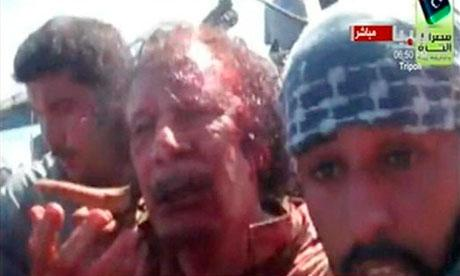

[1108/2000] 21a79da0954d938f51066ad0fcf7f16d4109dda5998b9add59303156aeeb9409
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/21a79da0954d938f51066ad0fcf7f16d4109dda5998b9add59303156aeeb9409.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/21a79da0954d938f51066ad0fcf7f16d4109dda5998b9add59303156aeeb9409.gz'
Failed to load target image.
[1109/2000] 07b98e464ee2b2fadd9de1a68d3096b12c416df1fa10bad9bbf527496faaa9ee
[1110/2000] c62bfb300dcd1013d2cb2762094420990e98d740b948d14e50ef98e5a3dc257f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c62bfb300dcd1013d2cb2762094420990e98d740b948d14e50ef98e5a3dc257f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c62bfb300dcd1013d2cb2762094420990e98d740b948d14e50ef98e5a3dc257f.gz'
Failed to load target image.
[1111/2000] 86b5d23c90a4ae895a9b9d9d80223e0673b72980d77c92e


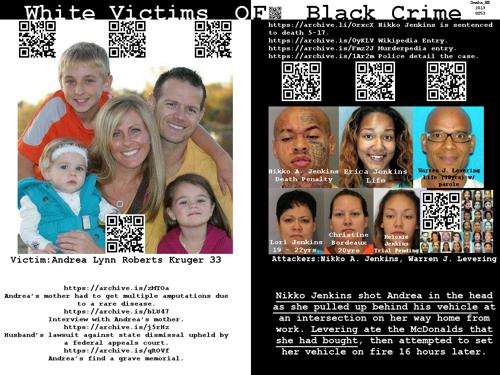

[1112/2000] 976395d3902e7f488ea364c1bdb7a018e38e700873f12acf52a309170b36e612
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/976395d3902e7f488ea364c1bdb7a018e38e700873f12acf52a309170b36e612.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/976395d3902e7f488ea364c1bdb7a018e38e700873f12acf52a309170b36e612.gz'
Failed to load target image.
[1113/2000] 491c8c76ef3192e481656447245634ddd54d2c73d20c9e962c7d9738e556255a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/491c8c76ef3192e481656447245634ddd54d2c73d20c9e962c7d9738e556255a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/491c8c76ef3192e481656447245634ddd54d2c73d20c9e962c7d9738e556255a.gz'
Failed to load target image.
[1114/2000] 9568de71ac3a1728cd97569adbcd6259964f48a4b507ded1c7a4d6982c2a9c28



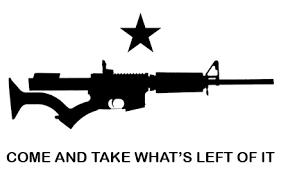

[1115/2000] aa3f765a5c0b09210be5503c044d6d1ff1def884f131ed7c7d96953fa74f7b71
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/aa3f765a5c0b09210be5503c044d6d1ff1def884f131ed7c7d96953fa74f7b71.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/aa3f765a5c0b09210be5503c044d6d1ff1def884f131ed7c7d96953fa74f7b71.gz'
Failed to load target image.
[1116/2000] 306317927237b159abe4d69e821b157a6f9c550fa14bf3b5a377a67317c679ae
[1117/2000] ff200b9116033c8f1a971536ddc3b89fbec3e7aff425392e47d2436b4ae8fa07
[1118/2000] f4fe494e5c2f57ae08933969edbe1741428902abf925bf5321eda81f481e5676
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f4fe494e5c2f57ae08933969edbe1741428902abf925bf5321eda81f481e5676.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f4fe494e5c2f57ae08933969edbe1741428902abf925bf5321eda81f481e5676.gz'
Failed to l


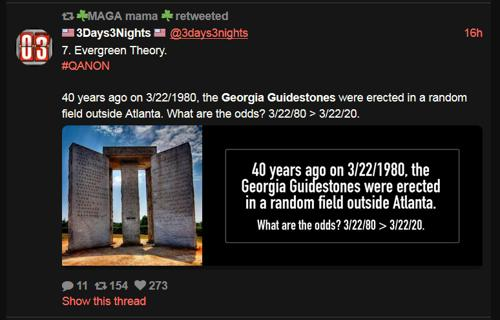

[1122/2000] d8c3b96c200b8847f9b07c298af666cc3ca7c4c61ae18dfaf93d5efa5157003c
[1123/2000] a239b1a39422c371bf425819abdceaaae9ebf22a1df07ef3c5df03e9c5a85f63
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a239b1a39422c371bf425819abdceaaae9ebf22a1df07ef3c5df03e9c5a85f63.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a239b1a39422c371bf425819abdceaaae9ebf22a1df07ef3c5df03e9c5a85f63.gz'
Failed to load target image.
[1124/2000] 05f86f7cff1f953f14e4ab86c70e7335b7ee639c7ee04c464ed8ec48441ee9ce
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/05f86f7cff1f953f14e4ab86c70e7335b7ee639c7ee04c464ed8ec48441ee9ce.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/05f86f7cff1f953f14e4ab86c70e7335b7ee639c7ee04c464ed8ec48441ee9ce.gz'
Failed to load target image.
[1125/2000] 070b6e042d0b9d008896b9a68ae6f681fe13be9e88becec


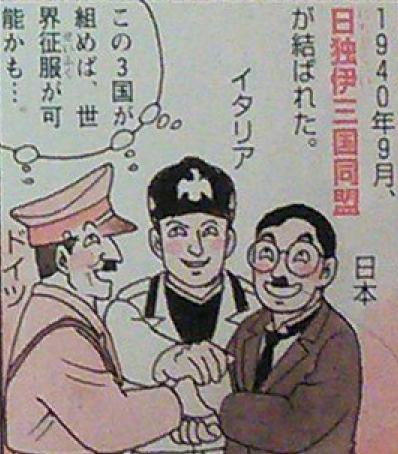

[1128/2000] 663308b9708abb4ac5ee70e96d1079d86ae0c2545734ebe19158e4749c780c14
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/663308b9708abb4ac5ee70e96d1079d86ae0c2545734ebe19158e4749c780c14.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/663308b9708abb4ac5ee70e96d1079d86ae0c2545734ebe19158e4749c780c14.gz'
Failed to load target image.
[1129/2000] 32c350f3a00de8e2e3043baaf2d103d44b0ce8585283c2eeedd2942624327a13
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/32c350f3a00de8e2e3043baaf2d103d44b0ce8585283c2eeedd2942624327a13.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/32c350f3a00de8e2e3043baaf2d103d44b0ce8585283c2eeedd2942624327a13.gz'
Failed to load target image.
[1130/2000] c0e05af5fff7f0c7e0151c4c49af1d24c4ada3c1569df83a5d3679fb859883f6



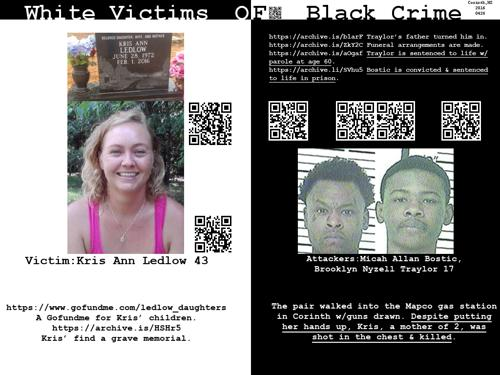

[1131/2000] 9cf27e2b911f36b328d9908d6abbfaa36121d72f306db104a7aa0788ac764a59
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9cf27e2b911f36b328d9908d6abbfaa36121d72f306db104a7aa0788ac764a59.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9cf27e2b911f36b328d9908d6abbfaa36121d72f306db104a7aa0788ac764a59.gz'
Failed to load target image.
[1132/2000] 505770ba1de9c1ed975ed9afb7dc9092190f874d8355a14adfc8f8697710e300



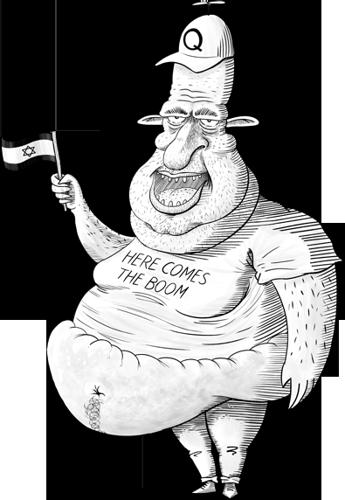

[1133/2000] ec77c7bc99a687c4fd7319cfcc27513c01a2395d0f9d2f3783d98814ec1bce01



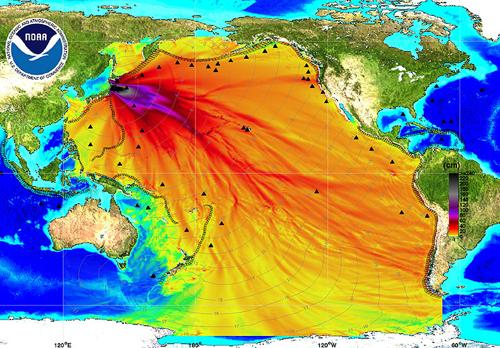

[1134/2000] 05af4d749c994eb8ed8101d428166469735878e0b8f3b42cb654c2392e373a62
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/05af4d749c994eb8ed8101d428166469735878e0b8f3b42cb654c2392e373a62.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/05af4d749c994eb8ed8101d428166469735878e0b8f3b42cb654c2392e373a62.gz'
Failed to load target image.
[1135/2000] 715e997a3b0af62b5bfead474e6feb522c69ef228c60aa95afc04e1e84fdc3b5
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/715e997a3b0af62b5bfead474e6feb522c69ef228c60aa95afc04e1e84fdc3b5.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/715e997a3b0af62b5bfead474e6feb522c69ef228c60aa95afc04e1e84fdc3b5.gz'
Failed to load target image.
[1136/2000] 4e05cff65d5c8414ccabcea2457e643f7c5a6757ebbf5c8e19bdcf12d02e15fe
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


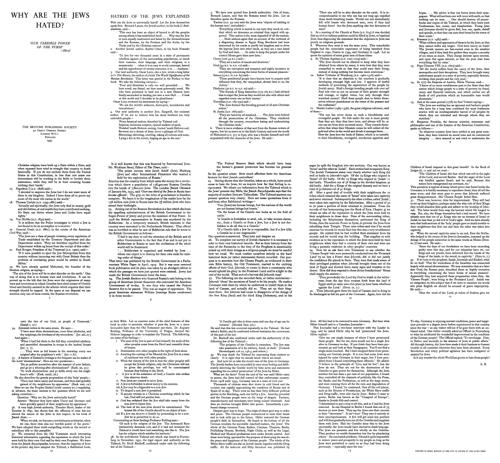

[1139/2000] d0ea261a7ea28804e6003a9cb3e393947c0e21c2ca0fb00aafef1cd786ff4a29
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d0ea261a7ea28804e6003a9cb3e393947c0e21c2ca0fb00aafef1cd786ff4a29.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d0ea261a7ea28804e6003a9cb3e393947c0e21c2ca0fb00aafef1cd786ff4a29.gz'
Failed to load target image.
[1140/2000] c3a82dee1e3d2e1e58cecd1a1462165ade82a3af6f25d03ca9de8bd422cda1d8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c3a82dee1e3d2e1e58cecd1a1462165ade82a3af6f25d03ca9de8bd422cda1d8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c3a82dee1e3d2e1e58cecd1a1462165ade82a3af6f25d03ca9de8bd422cda1d8.gz'
Failed to load target image.
[1141/2000] d2a9aee4dc396895a047568cc08c016e2cde31b40d7e547f05788ef7ad4c55c0
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


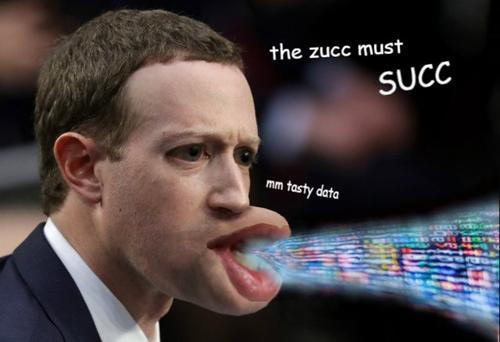

[1145/2000] d9f70a3769f71f124b92c826316bcc9bba5a0cee8175abdf63f596f1a0e83cbd
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d9f70a3769f71f124b92c826316bcc9bba5a0cee8175abdf63f596f1a0e83cbd.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d9f70a3769f71f124b92c826316bcc9bba5a0cee8175abdf63f596f1a0e83cbd.gz'
Failed to load target image.
[1146/2000] 1e2af2a3fa1916bbd43249cec3e492da868073dacd484764507ad526eae4aed4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1e2af2a3fa1916bbd43249cec3e492da868073dacd484764507ad526eae4aed4.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1e2af2a3fa1916bbd43249cec3e492da868073dacd484764507ad526eae4aed4.gz'
Failed to load target image.
[1147/2000] fa2298a2cf1cc54c9939a1698fcaff47f1ccd94efc56321736f72b94e2e25f49
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


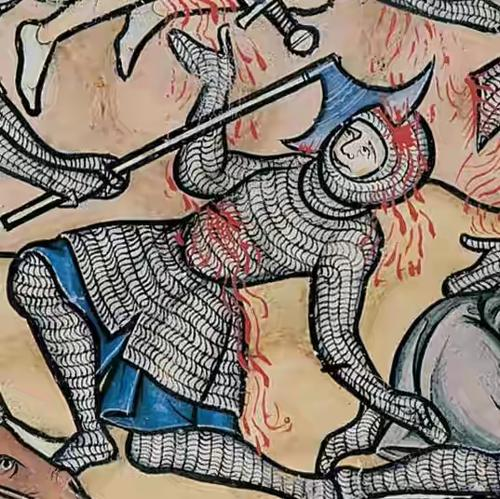

[1149/2000] 1466c8f2e0e79c7934daaef16ecc9d5832f568f9b9c3b20e8c681650057b2494
[1150/2000] fbd6f45b1a9776f6eea2c615bad24a8ea86d2ca8ea9af928fb503d5b2cdf9578
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fbd6f45b1a9776f6eea2c615bad24a8ea86d2ca8ea9af928fb503d5b2cdf9578.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fbd6f45b1a9776f6eea2c615bad24a8ea86d2ca8ea9af928fb503d5b2cdf9578.gz'
Failed to load target image.
[1151/2000] 58ee114c079cb5032ec30e9b5a7887bb6d2d9581c498043c6d43d66778d2f45b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/58ee114c079cb5032ec30e9b5a7887bb6d2d9581c498043c6d43d66778d2f45b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/58ee114c079cb5032ec30e9b5a7887bb6d2d9581c498043c6d43d66778d2f45b.gz'
Failed to load target image.
[1152/2000] daae8cbd57f9b7a93a324dc288a10e29b92b64f17a0f070


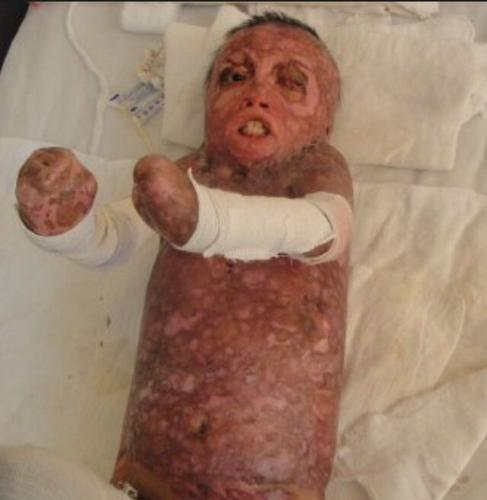

[1154/2000] cb7654a96527dfd1d81592cfe947d497d3b22817bd6d1030dca7a55bcff8bb1f
[1155/2000] 25f7c0d20cf06a3133a1a6af24310f07c4f74211403ed225af60990924e20a9e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/25f7c0d20cf06a3133a1a6af24310f07c4f74211403ed225af60990924e20a9e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/25f7c0d20cf06a3133a1a6af24310f07c4f74211403ed225af60990924e20a9e.gz'
Failed to load target image.
[1156/2000] 6ce7a136938661a40520b1ff2ecbddf8e79c5342c67dd0e177a18e7921d8c301
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6ce7a136938661a40520b1ff2ecbddf8e79c5342c67dd0e177a18e7921d8c301.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6ce7a136938661a40520b1ff2ecbddf8e79c5342c67dd0e177a18e7921d8c301.gz'
Failed to load target image.
[1157/2000] d9c12c53a179ce444c3f50c56ac8e5c1f06a4eb496ca084


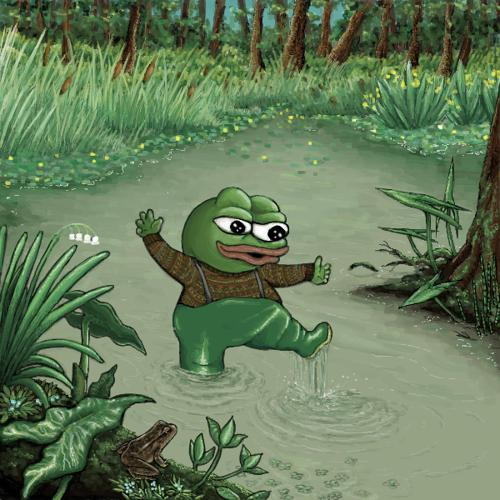

[1160/2000] 2335823983cc29fbe5553c62144920a74ce61ae8eb03f6773c7ad65a1adffb4e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2335823983cc29fbe5553c62144920a74ce61ae8eb03f6773c7ad65a1adffb4e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2335823983cc29fbe5553c62144920a74ce61ae8eb03f6773c7ad65a1adffb4e.gz'
Failed to load target image.
[1161/2000] 9459809213fcfd97bee32f8d1c138c46f1a916d2834ba433f38ebbd70ac1fdeb
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9459809213fcfd97bee32f8d1c138c46f1a916d2834ba433f38ebbd70ac1fdeb.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9459809213fcfd97bee32f8d1c138c46f1a916d2834ba433f38ebbd70ac1fdeb.gz'
Failed to load target image.
[1162/2000] b7a059dcc6d7791725c378cc88403957979234ade5ffdc9c44bb349308806a50
[1163/2000] a7ea4da9f0014ba77371f8e53ba31c7ac1e663e259c9dd2


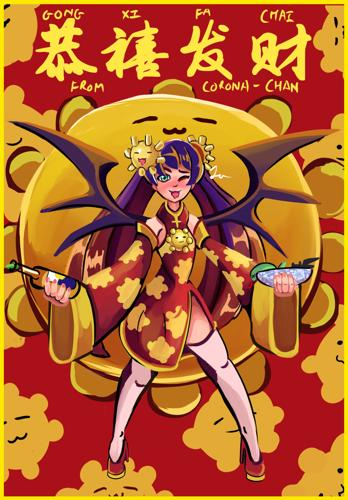

[1164/2000] ff4c7a18be53f8e855cf60d0b7a363de4b37e4a3d287a60522250d1ce743045c



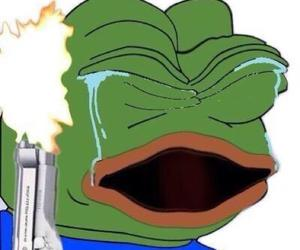

[1165/2000] 2864b88d356bc04fd534d159a70f57e1ab7ca40577d73ba0d4f41e516fbc1499
[1166/2000] 97743719d8485c1e693259ba154a400f0ce0a3c19b710057faa7846dd5491d22
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/97743719d8485c1e693259ba154a400f0ce0a3c19b710057faa7846dd5491d22.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/97743719d8485c1e693259ba154a400f0ce0a3c19b710057faa7846dd5491d22.gz'
Failed to load target image.
[1167/2000] 3a162074b4e2b238627f8769e340e6f4b17b022dde4a444c0d46de5b1194fc44
[1168/2000] 5f9fcd9874c93dc6175dec38251840affa60a147a690d571ced30c44df13aad3
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5f9fcd9874c93dc6175dec38251840affa60a147a690d571ced30c44df13aad3.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5f9fcd9874c93dc6175dec38251840affa60a147a690d571ced30c44df13aad3.gz'
Failed to l


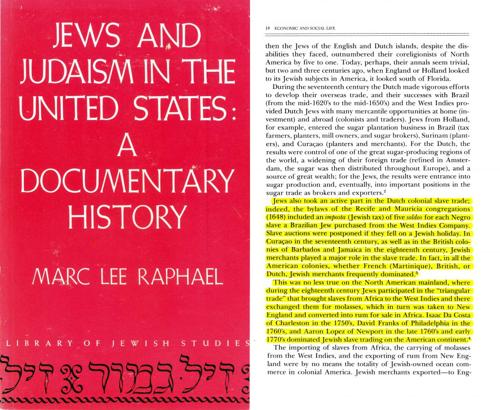

[1184/2000] 1cbe4b3f4b2b620860c6bebd7946eacb8bed53d817c65311b0ddc1b53f9b9c25
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1cbe4b3f4b2b620860c6bebd7946eacb8bed53d817c65311b0ddc1b53f9b9c25.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1cbe4b3f4b2b620860c6bebd7946eacb8bed53d817c65311b0ddc1b53f9b9c25.gz'
Failed to load target image.
[1185/2000] 8e7a989f726b3030bd477ac9d8eba7a9effb177ea08e11dcfce113e08d0239fb
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8e7a989f726b3030bd477ac9d8eba7a9effb177ea08e11dcfce113e08d0239fb.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8e7a989f726b3030bd477ac9d8eba7a9effb177ea08e11dcfce113e08d0239fb.gz'
Failed to load target image.
[1186/2000] daa528b1d457948b4ee9521b1a6941746f053b91fca693a13de59f727065a184
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


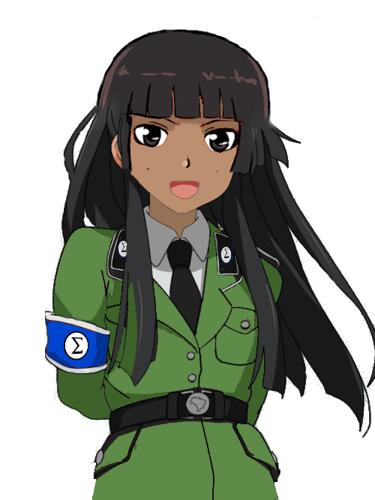

[1215/2000] dffce1224e533d82dce7a0e82982b7e70f08266635d70eed67f1e3fc86aec828
[1216/2000] c60e8f81292cdbfa14a210f358cd3bd83eb5635200171557f1dcaf2391043494
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c60e8f81292cdbfa14a210f358cd3bd83eb5635200171557f1dcaf2391043494.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c60e8f81292cdbfa14a210f358cd3bd83eb5635200171557f1dcaf2391043494.gz'
Failed to load target image.
[1217/2000] f66254afbf3193f01c47f364160bfa03e20a5953e5fd66704ebad726fa6ef94a
[1218/2000] 5824eba9335ec6ec7643cf253486c6185a7af37c1943b64f785b74271effe380



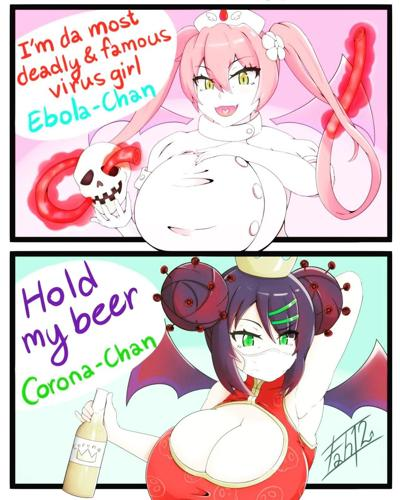

[1219/2000] 6d9f3167e47352e807efc62614042dcf48c61a0762e4604385372661082a1e2c



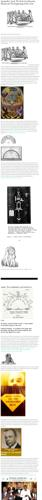

[1220/2000] f03b12c87c31a48d82b539a249a560c62e7257072ee0482f84dd2604e1d145af
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f03b12c87c31a48d82b539a249a560c62e7257072ee0482f84dd2604e1d145af.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f03b12c87c31a48d82b539a249a560c62e7257072ee0482f84dd2604e1d145af.gz'
Failed to load target image.
[1221/2000] 40f6748b61e2f8e994ef1311cfcbe2f84bda82d67df03e85809d60856e7e834e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/40f6748b61e2f8e994ef1311cfcbe2f84bda82d67df03e85809d60856e7e834e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/40f6748b61e2f8e994ef1311cfcbe2f84bda82d67df03e85809d60856e7e834e.gz'
Failed to load target image.
[1222/2000] 8544a0fd6f3f2db719db65e3b8dae295614f46daaf3fae2c19e97de6367c935f



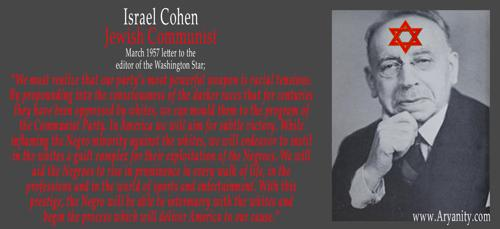

[1223/2000] 1a8b340f98fa2ec59539f7c3c23383054173576d5bcff0edbee53e82a0591e21
[1224/2000] 703f36ded86b69b65dafcf8ac58363c2976bb6212e8eb1f6d0eb600a656cd3d3
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/703f36ded86b69b65dafcf8ac58363c2976bb6212e8eb1f6d0eb600a656cd3d3.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/703f36ded86b69b65dafcf8ac58363c2976bb6212e8eb1f6d0eb600a656cd3d3.gz'
Failed to load target image.
[1225/2000] f036454b0c96c6ab897b74bde735e3ce6c5e8e730bb35919221013bd972ef192



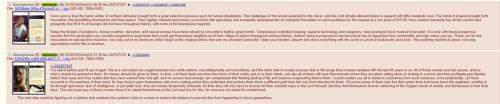

[1226/2000] 8506a6a55275a2bc71cad10664e925f6761bef304453549244ab30a22509d905
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8506a6a55275a2bc71cad10664e925f6761bef304453549244ab30a22509d905.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8506a6a55275a2bc71cad10664e925f6761bef304453549244ab30a22509d905.gz'
Failed to load target image.
[1227/2000] 1c508a8921770c8d1414e66f2dedd8f5688cef38883330bf1e63292c92978720
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1c508a8921770c8d1414e66f2dedd8f5688cef38883330bf1e63292c92978720.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1c508a8921770c8d1414e66f2dedd8f5688cef38883330bf1e63292c92978720.gz'
Failed to load target image.
[1228/2000] 2a162c6ee211fdf1b7da9378c9b0ac7ce53c4a8cb2681f6d0fdfa733bb1fa5c7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


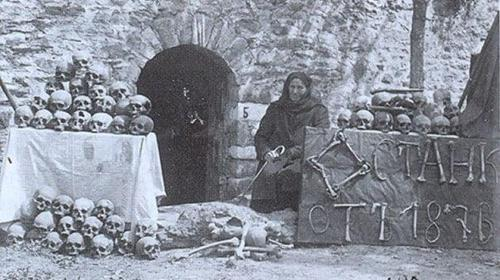

[1233/2000] 456e3408e01955932580ab42e4a83e04c5250261b8e2029ae2aafc3eeccf4b6d
[1234/2000] 02a57e6c500ddb0c3ff9e9e091fc80d4462193ba6a412d42170f9f59315d4959
[1235/2000] be60bf6b5522bb4655e36b6887dfaae51343590d59da91afc433213ada99ba89
[1236/2000] 6f4122540c69c75a569925f2825700f4ccf4bac01c1d0265749cc88affd8e835
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6f4122540c69c75a569925f2825700f4ccf4bac01c1d0265749cc88affd8e835.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6f4122540c69c75a569925f2825700f4ccf4bac01c1d0265749cc88affd8e835.gz'
Failed to load target image.
[1237/2000] 24cb551e8e15cb3a23f279aa23dc6a53cd9c281b7a1133e11591f8b0df5512e1



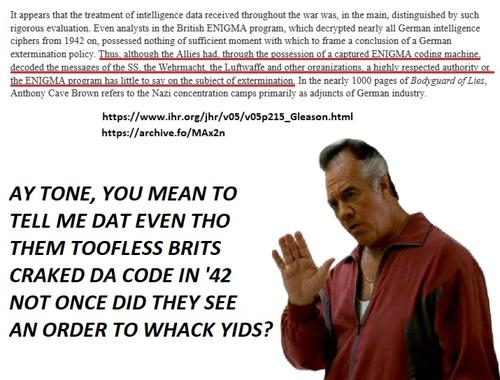

[1238/2000] ca4ba984edc363eb6aa104b889a7fb5a221e2530e7cd26fae192f16d44031a97
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ca4ba984edc363eb6aa104b889a7fb5a221e2530e7cd26fae192f16d44031a97.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ca4ba984edc363eb6aa104b889a7fb5a221e2530e7cd26fae192f16d44031a97.gz'
Failed to load target image.
[1239/2000] 06374989a97eb7cc199e9f94141401dea4ca50a2c93df99f333fdd5ac10b5a95
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/06374989a97eb7cc199e9f94141401dea4ca50a2c93df99f333fdd5ac10b5a95.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/06374989a97eb7cc199e9f94141401dea4ca50a2c93df99f333fdd5ac10b5a95.gz'
Failed to load target image.
[1240/2000] 06ae6ab2a0404c7cfa20b078b682ddb9d42bb5e7fd4bcd5e5f8aff0ec27ce6c0
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


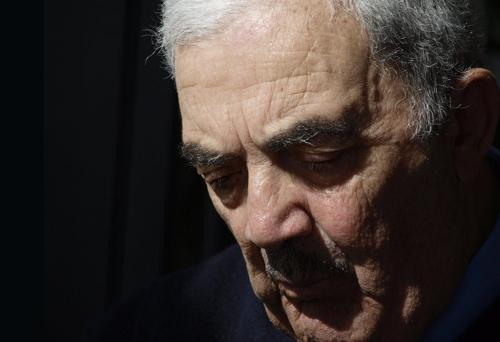

[1245/2000] 14e6b13dd145b60d0659d12142be5445286a2e5afed4effb7dea6c1ef9225a0d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/14e6b13dd145b60d0659d12142be5445286a2e5afed4effb7dea6c1ef9225a0d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/14e6b13dd145b60d0659d12142be5445286a2e5afed4effb7dea6c1ef9225a0d.gz'
Failed to load target image.
[1246/2000] 1c9da940dfc434af147c1f2b5062d87486809bfd7f11610b3fb421dcc0b3683a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1c9da940dfc434af147c1f2b5062d87486809bfd7f11610b3fb421dcc0b3683a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1c9da940dfc434af147c1f2b5062d87486809bfd7f11610b3fb421dcc0b3683a.gz'
Failed to load target image.
[1247/2000] 48c731f460cfc7fc1fd70bef88770d5cb23d3fd50f89f43887caf502b584f5fc
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


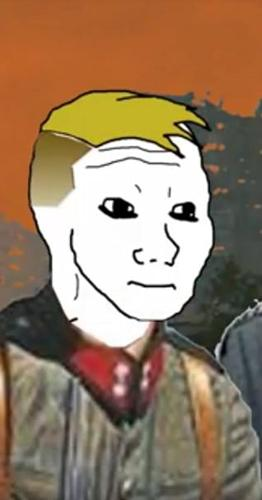

[1250/2000] 2b2e24127c9ee3201edb0fcba58ae262c9c4229c25fdcec870f28feb38cc1272



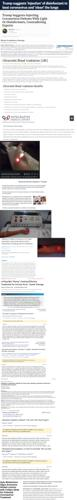

[1251/2000] 78afb49cdfbf1af6c5c6c3a5a3fa3be14cae08e3843979b1e38015405fe60977
[1252/2000] 25b831d3c7d1e51af7f5c7323ce4ec8f2cee57f3c43322ccabb9bb9bf89737ed
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/25b831d3c7d1e51af7f5c7323ce4ec8f2cee57f3c43322ccabb9bb9bf89737ed.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/25b831d3c7d1e51af7f5c7323ce4ec8f2cee57f3c43322ccabb9bb9bf89737ed.gz'
Failed to load target image.
[1253/2000] 8b7bb07902541ab66c8e8c1d7aa536902ee0ae916cc6a08513e18320ce1a69cc
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8b7bb07902541ab66c8e8c1d7aa536902ee0ae916cc6a08513e18320ce1a69cc.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8b7bb07902541ab66c8e8c1d7aa536902ee0ae916cc6a08513e18320ce1a69cc.gz'
Failed to load target image.
[1254/2000] a9669658e13b9e328ef4b19cb6e75e054d4f7a41439ab18


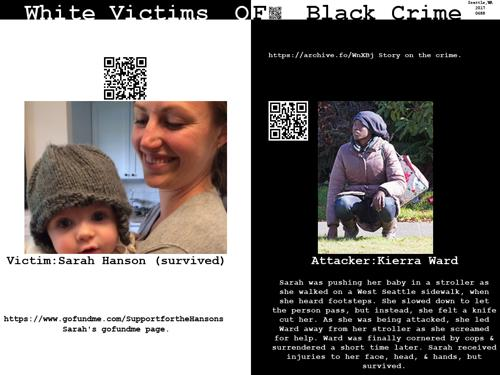

[1257/2000] 9b98261011a7bbd563096e0332cfee6b0ef652c54869a49eff63d7ba0f3f24e1



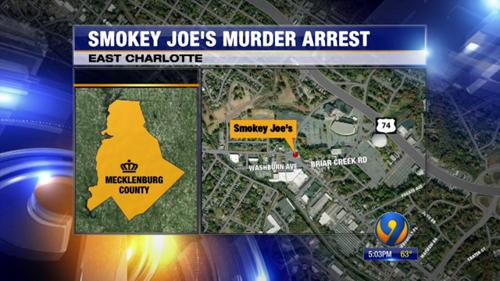

[1258/2000] d40340351a52483be335155ef314a1101e1bc2ab89844211d977308bcdd6cc21
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d40340351a52483be335155ef314a1101e1bc2ab89844211d977308bcdd6cc21.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d40340351a52483be335155ef314a1101e1bc2ab89844211d977308bcdd6cc21.gz'
Failed to load target image.
[1259/2000] ef25dc4dc8338ee0a8429793ae15716956182f6af26851e30f90700058ca02b5
[1260/2000] e7648f543d27ad5317e26aaa4b29f7d0bb97c3417a5f411ea5d6e8521bcbef83
[1261/2000] 5e93b93bc08914e4f399483e20107637b51dae04dc3031ec340bbd64a6aa9d4f



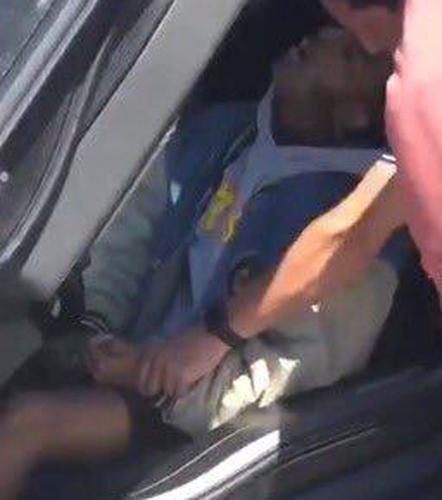

[1262/2000] af865e9b449b0a7f878fb45fe1bc5079ce86a146b3f76f1d48ef4b7e83b2d71a
[1263/2000] 8a13ae76e7c74832b6a27b58e9deb91acb031069f61cb32b17c9dd9307841c58
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8a13ae76e7c74832b6a27b58e9deb91acb031069f61cb32b17c9dd9307841c58.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8a13ae76e7c74832b6a27b58e9deb91acb031069f61cb32b17c9dd9307841c58.gz'
Failed to load target image.
[1264/2000] 4fbcfc8596c8e1a9f174158b6dd00c2ed7c784dbeb6341993446501ef2469a79
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4fbcfc8596c8e1a9f174158b6dd00c2ed7c784dbeb6341993446501ef2469a79.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4fbcfc8596c8e1a9f174158b6dd00c2ed7c784dbeb6341993446501ef2469a79.gz'
Failed to load target image.
[1265/2000] 16af37a87f76c63e9bf1c338fa96c1f45c81dbd91f61d7b


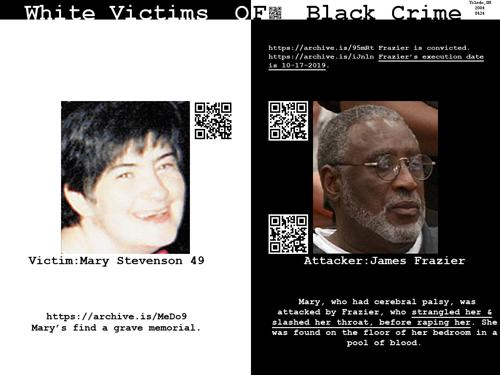

[1269/2000] 0bf72b2d79f95255c98ee0c6f50a49aaf649c67286f392af7fa96b027452f567



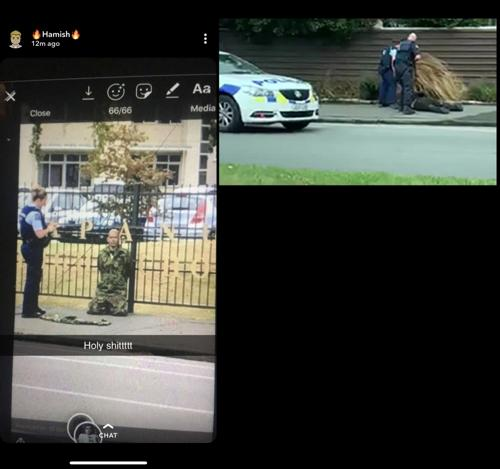

[1270/2000] 4422a89da58412a8ee4169b2d02772be412d8ba403193eb01373bf0f69ccfb3c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4422a89da58412a8ee4169b2d02772be412d8ba403193eb01373bf0f69ccfb3c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4422a89da58412a8ee4169b2d02772be412d8ba403193eb01373bf0f69ccfb3c.gz'
Failed to load target image.
[1271/2000] fd116f3a812c1a19877a524ec00d686e3f2c346fed82b6d58eab3cecf42dc0e1
[1272/2000] 80a923b1629e07d3f8ca817eb1776f39458291473600190c8e2fbcdce07289c5



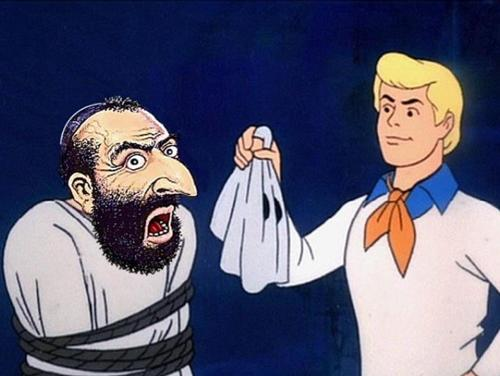

[1273/2000] 222a7d9edae84625f1d480f1e9f0b054c6d0c7f529903589da097f5b51ef34b7



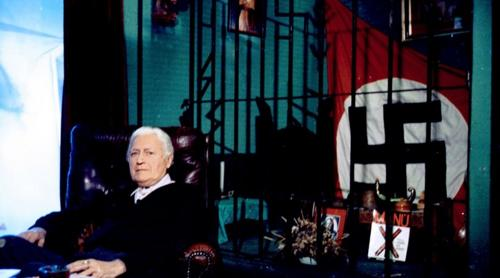

[1274/2000] 0d00b4f47edfdb24e86e977870865784affaca594a0f91a746a39d8baeed0a37
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0d00b4f47edfdb24e86e977870865784affaca594a0f91a746a39d8baeed0a37.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0d00b4f47edfdb24e86e977870865784affaca594a0f91a746a39d8baeed0a37.gz'
Failed to load target image.
[1275/2000] 183fc7d45ba10b692983f31bd7ef3db269b0e8035c0848d1596b23f999b50247
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/183fc7d45ba10b692983f31bd7ef3db269b0e8035c0848d1596b23f999b50247.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/183fc7d45ba10b692983f31bd7ef3db269b0e8035c0848d1596b23f999b50247.gz'
Failed to load target image.
[1276/2000] 61474d7752424beb1926a3668b4f15faa83bb0b16b57e8467f054722430681f8
[1277/2000] f9d6d0a9a170535c3800c370a2376b2c5e60fdaec9ff02a


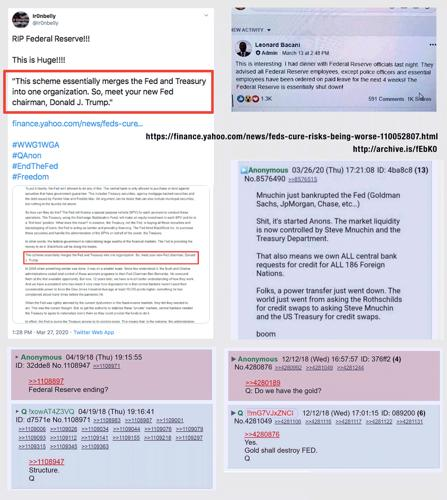

[1278/2000] 1913934736a61a59433cf2e01abbd100222a89d5529efc4b4bc3651193717301
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1913934736a61a59433cf2e01abbd100222a89d5529efc4b4bc3651193717301.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1913934736a61a59433cf2e01abbd100222a89d5529efc4b4bc3651193717301.gz'
Failed to load target image.
[1279/2000] 47a57912e19d2eed1b69ae7722c6af81b21e1bda746b245678ee9ae3f4faf82b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/47a57912e19d2eed1b69ae7722c6af81b21e1bda746b245678ee9ae3f4faf82b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/47a57912e19d2eed1b69ae7722c6af81b21e1bda746b245678ee9ae3f4faf82b.gz'
Failed to load target image.
[1280/2000] b3d6a61e38c7122a2041815c53c9ecb52e7db8a94ff61c265dc56ea05ae2e910
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


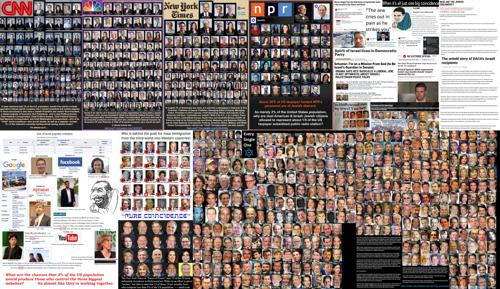

[1290/2000] 94678dfd977815015df45eb07b1adc993307b15616a6381a1761f44190df7f75
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/94678dfd977815015df45eb07b1adc993307b15616a6381a1761f44190df7f75.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/94678dfd977815015df45eb07b1adc993307b15616a6381a1761f44190df7f75.gz'
Failed to load target image.
[1291/2000] caf5ee5fa75474eed1c07bff119f2863c903d3a4468afd96c7785202e1c0a9e4
[1292/2000] 4f2db44b8819f6f742ae457d30d72ad20d3a28176ec9a83484aa28066b838f25
[1293/2000] 8999dbd09bc6a2b70c852e6eb66ff8ffc2e3f98fa0cd2ac91d7959703e8f39a8



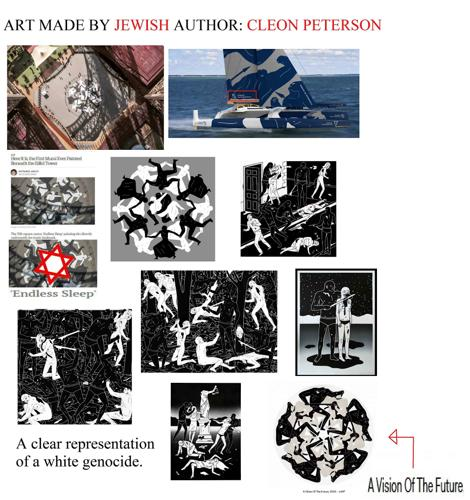

[1294/2000] 0b5092a13d18006a9d20a5c9f4da5056c9aed1059793b6cfb446556b2aff990c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0b5092a13d18006a9d20a5c9f4da5056c9aed1059793b6cfb446556b2aff990c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0b5092a13d18006a9d20a5c9f4da5056c9aed1059793b6cfb446556b2aff990c.gz'
Failed to load target image.
[1295/2000] ee248808b5f42fca70438520e3796d0966f6605cb54973b10bbfc421c9b2cec9
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ee248808b5f42fca70438520e3796d0966f6605cb54973b10bbfc421c9b2cec9.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ee248808b5f42fca70438520e3796d0966f6605cb54973b10bbfc421c9b2cec9.gz'
Failed to load target image.
[1296/2000] 98454c0d7228597c4c1132d7c9f387d63b7febdd9aa65ffdb22cc4720e7a39f4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


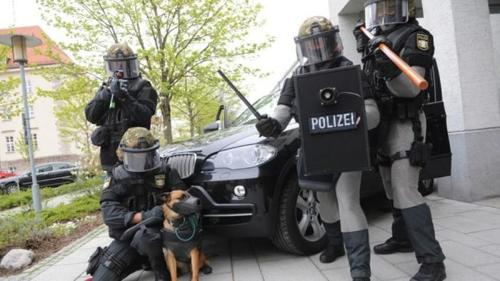

[1302/2000] 81efcd2e1d0b734a2e30281902948e1786530f89f9ab42afb2c998cedb0f477e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/81efcd2e1d0b734a2e30281902948e1786530f89f9ab42afb2c998cedb0f477e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/81efcd2e1d0b734a2e30281902948e1786530f89f9ab42afb2c998cedb0f477e.gz'
Failed to load target image.
[1303/2000] 4069f19dfd985e8c916c99a4323b52f4bf90304deb8d7ddc9ed682eb704c2816
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4069f19dfd985e8c916c99a4323b52f4bf90304deb8d7ddc9ed682eb704c2816.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4069f19dfd985e8c916c99a4323b52f4bf90304deb8d7ddc9ed682eb704c2816.gz'
Failed to load target image.
[1304/2000] f91e321d8d09a3c3b6ab29121e1d6d53fe04660c0b7d6a170106c87030d2c83c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


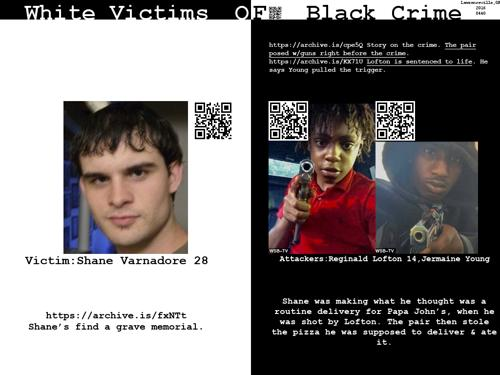

[1306/2000] 1e7d0832407ef117982935185b2f4ed1be92b95ed4761770ac17ed5e32eb06cd



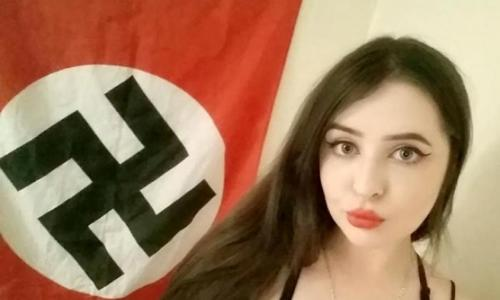

[1307/2000] 5ab54c662545568e26bf9c7e6c16911cb7d248a3cf5d186501d29bafce76b3f6
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5ab54c662545568e26bf9c7e6c16911cb7d248a3cf5d186501d29bafce76b3f6.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5ab54c662545568e26bf9c7e6c16911cb7d248a3cf5d186501d29bafce76b3f6.gz'
Failed to load target image.
[1308/2000] 99f8176fea06f5d9147270cbc2004238b821b53bf5878e257bb9054e5b32629f
[1309/2000] 72423a1d1ea56b16ac3d3e98cd0c8b739873f10da081eb92cf3912e2cda2141c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/72423a1d1ea56b16ac3d3e98cd0c8b739873f10da081eb92cf3912e2cda2141c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/72423a1d1ea56b16ac3d3e98cd0c8b739873f10da081eb92cf3912e2cda2141c.gz'
Failed to load target image.
[1310/2000] 485a74c565b99b32b91f1b01db5cd8f99fb1d1366330718


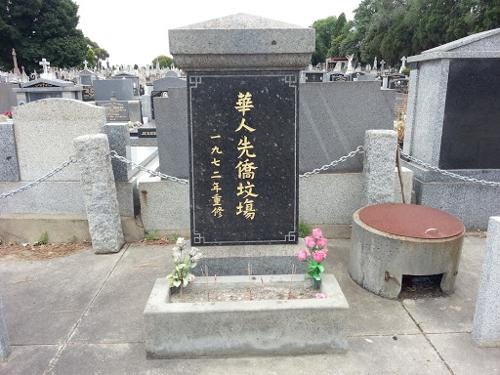

[1312/2000] 7b0cd880c8b210470cc66787a34ce12cb7bc28dc24ddf1f6457015d82faeddcf
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7b0cd880c8b210470cc66787a34ce12cb7bc28dc24ddf1f6457015d82faeddcf.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7b0cd880c8b210470cc66787a34ce12cb7bc28dc24ddf1f6457015d82faeddcf.gz'
Failed to load target image.
[1313/2000] a942925878d4c0fbbe75c5aaccb449a90bb216689b8e44c8d6bfb2b77779684d



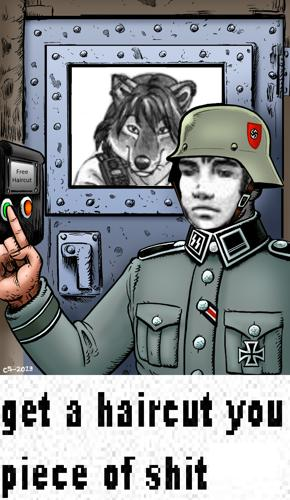

[1314/2000] 88dcf8a288cac2229c4d80227be84884bc818d655e9e7f873c435b8b804fc213



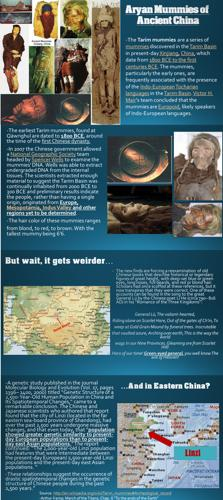

[1315/2000] 15be227bedaf2017905ff40479ce2ef14ed5383bdef1632fdba32b84dc608f80
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/15be227bedaf2017905ff40479ce2ef14ed5383bdef1632fdba32b84dc608f80.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/15be227bedaf2017905ff40479ce2ef14ed5383bdef1632fdba32b84dc608f80.gz'
Failed to load target image.
[1316/2000] ea716d8eddfcdbf8761fa947480483ef45f17852d74ba32807c6fe51348bd88f



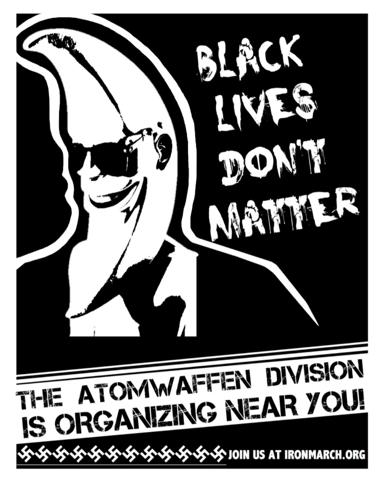

[1317/2000] 1a78eab58f2dba75e913b398aa3379a57ca5fbb1e0fec906dc11726633ec0d06
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1a78eab58f2dba75e913b398aa3379a57ca5fbb1e0fec906dc11726633ec0d06.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1a78eab58f2dba75e913b398aa3379a57ca5fbb1e0fec906dc11726633ec0d06.gz'
Failed to load target image.
[1318/2000] aff8c0c94af76247df1359fb3e18901e2d0843428e0f565c884af432fd3b5e15
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/aff8c0c94af76247df1359fb3e18901e2d0843428e0f565c884af432fd3b5e15.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/aff8c0c94af76247df1359fb3e18901e2d0843428e0f565c884af432fd3b5e15.gz'
Failed to load target image.
[1319/2000] 090a7b60a57edafd4947c4b4f66b757626048d5b806ee70ea1ec41822a236b98



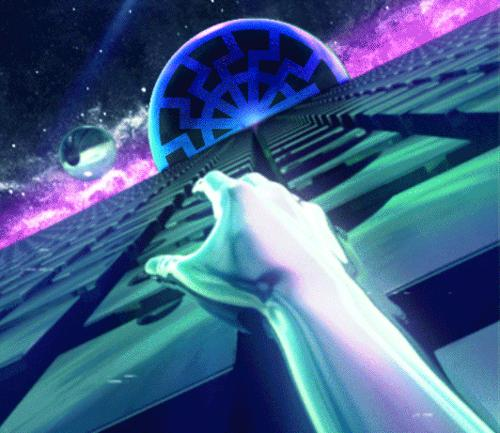

[1320/2000] feaef64a8ab3cc6de773c952e0687584a30d2b6f7b47ed06b7ee467ab86d78a6
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/feaef64a8ab3cc6de773c952e0687584a30d2b6f7b47ed06b7ee467ab86d78a6.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/feaef64a8ab3cc6de773c952e0687584a30d2b6f7b47ed06b7ee467ab86d78a6.gz'
Failed to load target image.
[1321/2000] 2394ed3738e62345e34ff2752c9881db163953481686a97a2d88ea380dc59aba
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2394ed3738e62345e34ff2752c9881db163953481686a97a2d88ea380dc59aba.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2394ed3738e62345e34ff2752c9881db163953481686a97a2d88ea380dc59aba.gz'
Failed to load target image.
[1322/2000] d555ba83b8202b553de7c8154e2c4903551f5507b7573a1f2bb45cd522f3f000
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


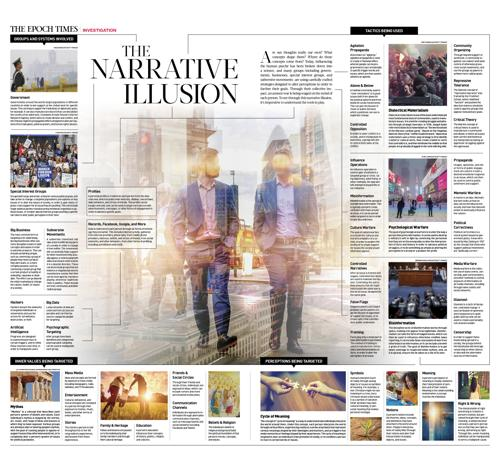

[1337/2000] 362f51064174348c3f4953d424e579d046724ad79443e381e2bb74319881be49
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/362f51064174348c3f4953d424e579d046724ad79443e381e2bb74319881be49.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/362f51064174348c3f4953d424e579d046724ad79443e381e2bb74319881be49.gz'
Failed to load target image.
[1338/2000] 8baa84da1c0c7a8d9fc40e23e094380f0dca1c3ea453cf8bfd856b85ccea37c4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8baa84da1c0c7a8d9fc40e23e094380f0dca1c3ea453cf8bfd856b85ccea37c4.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8baa84da1c0c7a8d9fc40e23e094380f0dca1c3ea453cf8bfd856b85ccea37c4.gz'
Failed to load target image.
[1339/2000] 15bb29e5f6fe0fef7b8c616096b1bbfd6f1c9c250edde88b70af417c8860757e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


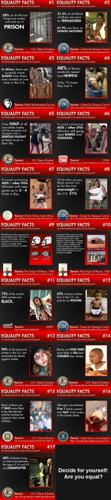

[1346/2000] 34f4e40efa31b11eaa8ed79071b975cb9cc3a0fca1ae86d4ae37dd2d7f179eb5
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/34f4e40efa31b11eaa8ed79071b975cb9cc3a0fca1ae86d4ae37dd2d7f179eb5.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/34f4e40efa31b11eaa8ed79071b975cb9cc3a0fca1ae86d4ae37dd2d7f179eb5.gz'
Failed to load target image.
[1347/2000] e4909917e54b10ce1bf06206368c0996bca6eadad0e0cf376d06a7ee139f3e68
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e4909917e54b10ce1bf06206368c0996bca6eadad0e0cf376d06a7ee139f3e68.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e4909917e54b10ce1bf06206368c0996bca6eadad0e0cf376d06a7ee139f3e68.gz'
Failed to load target image.
[1348/2000] f3208dfbddb8ccd79a676d8c057412e084bb9b78b761b5c71bb67deacf797385
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


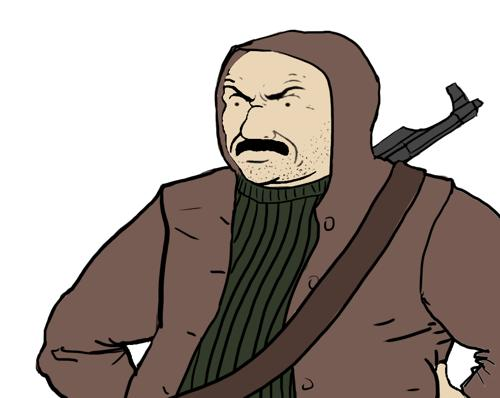

[1350/2000] 3e67c4550404b4733bc2cc67121962af7f4be96ec92c2a6e401a80a907a6658b



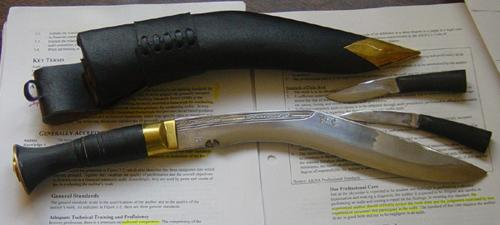

[1351/2000] 67223f47587d73ecfb3f2e07cfec99241c25e05fb8507e5e9d046ee3c7d0949b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/67223f47587d73ecfb3f2e07cfec99241c25e05fb8507e5e9d046ee3c7d0949b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/67223f47587d73ecfb3f2e07cfec99241c25e05fb8507e5e9d046ee3c7d0949b.gz'
Failed to load target image.
[1352/2000] cc7c34d4a366c60f46962a46387944ffe37e56d9b87db13fc0e192c69e69f9bd



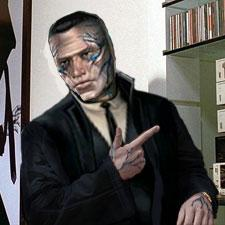

[1353/2000] 02fb2a91a827383018dd491bdbc8ed7202f81145ccee7e00952b7da68a58b355
[1354/2000] 98b682f2f94a7a69d2545a9751f98d7793eee59e500d7f722c12853b35eb2566
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/98b682f2f94a7a69d2545a9751f98d7793eee59e500d7f722c12853b35eb2566.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/98b682f2f94a7a69d2545a9751f98d7793eee59e500d7f722c12853b35eb2566.gz'
Failed to load target image.
[1355/2000] 2e375d5bfcb58e9ea626095b17e8aade6e0604603c327f76ba2eeebd07ceb9ba
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2e375d5bfcb58e9ea626095b17e8aade6e0604603c327f76ba2eeebd07ceb9ba.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2e375d5bfcb58e9ea626095b17e8aade6e0604603c327f76ba2eeebd07ceb9ba.gz'
Failed to load target image.
[1356/2000] 75e3ee7467c7c930a9f85952fb459583759c581e889d4a2


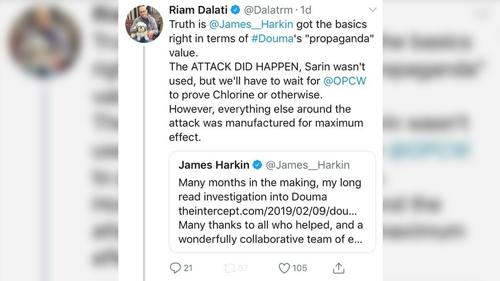

[1362/2000] b1a40cb20f58c10d887cffd9d094f3bf42d01dd5f474b750ad85a02e955d4db4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b1a40cb20f58c10d887cffd9d094f3bf42d01dd5f474b750ad85a02e955d4db4.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b1a40cb20f58c10d887cffd9d094f3bf42d01dd5f474b750ad85a02e955d4db4.gz'
Failed to load target image.
[1363/2000] 5f901819b623d4463f6993328984cd753e3b8c519eeda7ce1995528a64eeece4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5f901819b623d4463f6993328984cd753e3b8c519eeda7ce1995528a64eeece4.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5f901819b623d4463f6993328984cd753e3b8c519eeda7ce1995528a64eeece4.gz'
Failed to load target image.
[1364/2000] 1a59dc579dd6ebc9964ec8c6de29774e6b99ef7a5bcd469d441fa23722cb9c7b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


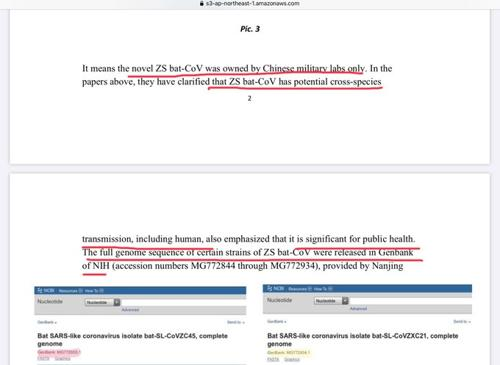

[1368/2000] ec127e7c3afe63b957f7fd7324f99a9fd7f7c3f58b1cb33119e3e764419400a5
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ec127e7c3afe63b957f7fd7324f99a9fd7f7c3f58b1cb33119e3e764419400a5.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ec127e7c3afe63b957f7fd7324f99a9fd7f7c3f58b1cb33119e3e764419400a5.gz'
Failed to load target image.
[1369/2000] 1df14c3bdd91443ff18ddb53d944c440cf2329512ca44420a57f6191b0c1bbd0
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1df14c3bdd91443ff18ddb53d944c440cf2329512ca44420a57f6191b0c1bbd0.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1df14c3bdd91443ff18ddb53d944c440cf2329512ca44420a57f6191b0c1bbd0.gz'
Failed to load target image.
[1370/2000] 25c45b5256835d4ea1e7d5ffbbc1d3b571c4bea325b714d267f464c627bba074
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


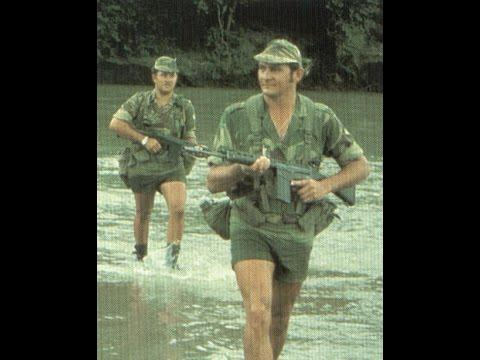

[1374/2000] 92e897d22fc1100e23b95e3b77fb896ed38ce00a047d1a17dc3d7bbd88a33177
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/92e897d22fc1100e23b95e3b77fb896ed38ce00a047d1a17dc3d7bbd88a33177.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/92e897d22fc1100e23b95e3b77fb896ed38ce00a047d1a17dc3d7bbd88a33177.gz'
Failed to load target image.
[1375/2000] 64be04a4ded960bb0a78d4120d9608db97a88c9f65a0e5e5bad31b0e0fc096e0
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/64be04a4ded960bb0a78d4120d9608db97a88c9f65a0e5e5bad31b0e0fc096e0.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/64be04a4ded960bb0a78d4120d9608db97a88c9f65a0e5e5bad31b0e0fc096e0.gz'
Failed to load target image.
[1376/2000] 1bbe8bc8d731e76bae311af4419a86e6d7c65ac32fee971598f2599aa2f091f7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


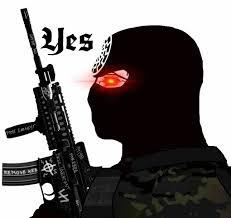

[1378/2000] 3dcb1d52a5c8b9444da31ea4fb770c5e875faf6168bff2caee95de6e38d19958



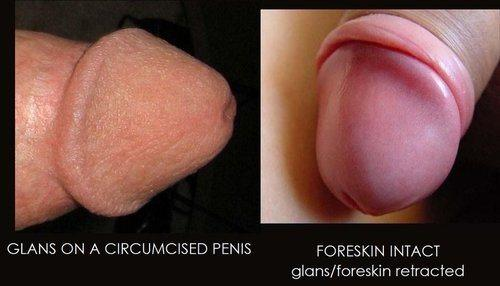

[1379/2000] 754720ddc02c7903d49fe8b481d8d70a9de4249b29b325f479b31575bae64263
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/754720ddc02c7903d49fe8b481d8d70a9de4249b29b325f479b31575bae64263.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/754720ddc02c7903d49fe8b481d8d70a9de4249b29b325f479b31575bae64263.gz'
Failed to load target image.
[1380/2000] bf319bad55eee26f4a3fc98a8a06ab51f305dbca634b7da888a8eed2c0f0d060
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bf319bad55eee26f4a3fc98a8a06ab51f305dbca634b7da888a8eed2c0f0d060.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bf319bad55eee26f4a3fc98a8a06ab51f305dbca634b7da888a8eed2c0f0d060.gz'
Failed to load target image.
[1381/2000] c302d88a0c256955f01da57a655d88ccff5443cdc647ff13678f7b595711a2d8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


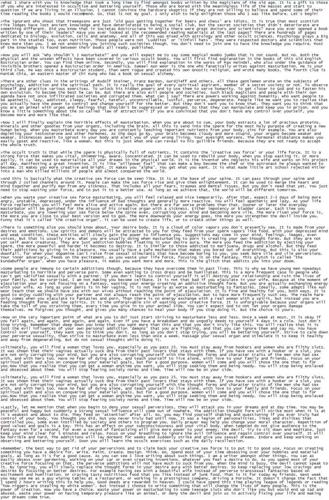

[1389/2000] 39bd87c671fc1128ca3be1b855cd596fd344c628b83d92ac30a5fe6cd872ef14



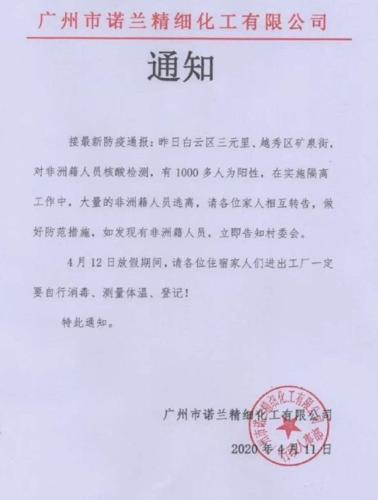

[1390/2000] 772c717a85ed4505a8e47324d8c75f83699f012d1f958ced5a96eb1fd689cf93
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/772c717a85ed4505a8e47324d8c75f83699f012d1f958ced5a96eb1fd689cf93.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/772c717a85ed4505a8e47324d8c75f83699f012d1f958ced5a96eb1fd689cf93.gz'
Failed to load target image.
[1391/2000] 98625b97069c501db35d998a34eb1b15c4771305231e9fda52a154b693ba9215
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/98625b97069c501db35d998a34eb1b15c4771305231e9fda52a154b693ba9215.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/98625b97069c501db35d998a34eb1b15c4771305231e9fda52a154b693ba9215.gz'
Failed to load target image.
[1392/2000] 73d927b3098407eb62f70a80d5f87303474337f925887766318b6cc204a8ccbf
[1393/2000] 9cf375292cfc60393fe7aa6544b6db7256fb0c00f323ea1


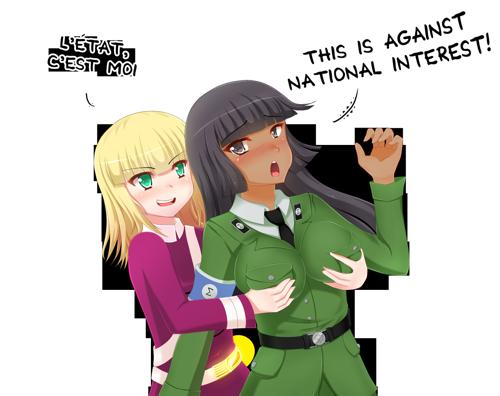

[1405/2000] c0eae7d22272d0594d2a9ec1f36c26ef30703879be1cd106d0efd834157706be
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c0eae7d22272d0594d2a9ec1f36c26ef30703879be1cd106d0efd834157706be.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c0eae7d22272d0594d2a9ec1f36c26ef30703879be1cd106d0efd834157706be.gz'
Failed to load target image.
[1406/2000] 8f0daebae9f85a80d63b0b888998fc499a323fb54ceb31925bccc478cf1c1fb7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8f0daebae9f85a80d63b0b888998fc499a323fb54ceb31925bccc478cf1c1fb7.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8f0daebae9f85a80d63b0b888998fc499a323fb54ceb31925bccc478cf1c1fb7.gz'
Failed to load target image.
[1407/2000] b99989f76e548b10ee0d0d7ef2ddecb158bbc9576493fae00cc4888cb5099233



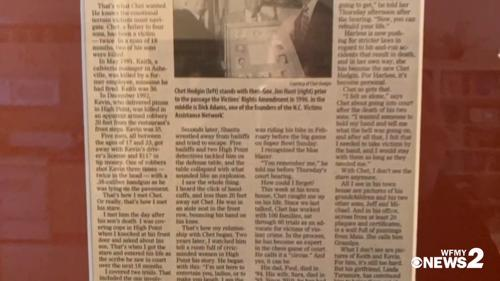

[1408/2000] b4416c502973d803ce990145cf114f73b32e67659014a8939285400e961a3fe4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b4416c502973d803ce990145cf114f73b32e67659014a8939285400e961a3fe4.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b4416c502973d803ce990145cf114f73b32e67659014a8939285400e961a3fe4.gz'
Failed to load target image.
[1409/2000] a84ccc0732fb0ba9ad9234be7ae1f075fd65fabb5f64fb182b5c7b89350a43a9
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a84ccc0732fb0ba9ad9234be7ae1f075fd65fabb5f64fb182b5c7b89350a43a9.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a84ccc0732fb0ba9ad9234be7ae1f075fd65fabb5f64fb182b5c7b89350a43a9.gz'
Failed to load target image.
[1410/2000] 6c2825bddeb418ffd3e3cb9d06dde1e617ad872ad2e8e454ee57a8a6f22be9d3
[1411/2000] fbb4fa3bf7b9c9cee3a88076c778de6cba511a0bc6c3c8b


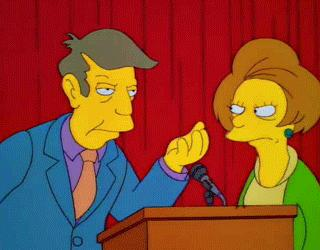

[1415/2000] db417d2262ba2592205705bf77cfcbfca164ae8e63be428e7fb974522ed8a0f9
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/db417d2262ba2592205705bf77cfcbfca164ae8e63be428e7fb974522ed8a0f9.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/db417d2262ba2592205705bf77cfcbfca164ae8e63be428e7fb974522ed8a0f9.gz'
Failed to load target image.
[1416/2000] fa1687492adf4ff13a4b616a68d5aefba701e6d83cec028a470222adb5cf6a6c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fa1687492adf4ff13a4b616a68d5aefba701e6d83cec028a470222adb5cf6a6c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fa1687492adf4ff13a4b616a68d5aefba701e6d83cec028a470222adb5cf6a6c.gz'
Failed to load target image.
[1417/2000] 798a2aa98ff4cc2aff2a6d17409d28360086a923178ed00555530ce1ba9d6a4e
[1418/2000] 49f779fe262d73e86538e3339f3b333a5a4949ef0cf1c05


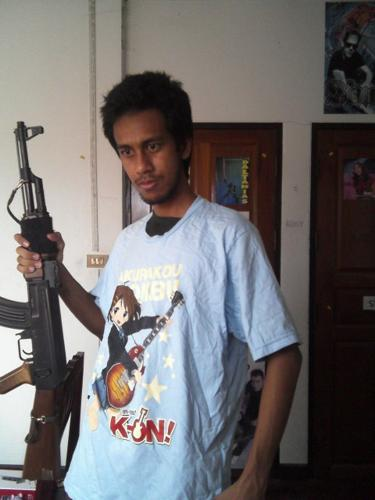

[1422/2000] 27a4df0d2ae2a3e109d11e75e44a42ad92c0f76e36e5f5d04ef7b7ac16317c68
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/27a4df0d2ae2a3e109d11e75e44a42ad92c0f76e36e5f5d04ef7b7ac16317c68.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/27a4df0d2ae2a3e109d11e75e44a42ad92c0f76e36e5f5d04ef7b7ac16317c68.gz'
Failed to load target image.
[1423/2000] efe33c5ce7c4d61a9a8db8db1ed63f0e473227921296f25c71ba15227e08c8fe
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/efe33c5ce7c4d61a9a8db8db1ed63f0e473227921296f25c71ba15227e08c8fe.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/efe33c5ce7c4d61a9a8db8db1ed63f0e473227921296f25c71ba15227e08c8fe.gz'
Failed to load target image.
[1424/2000] de0021ebe006db68bd3eb60d59094817ba361e81ed6dd2c74bc5c6add4446718



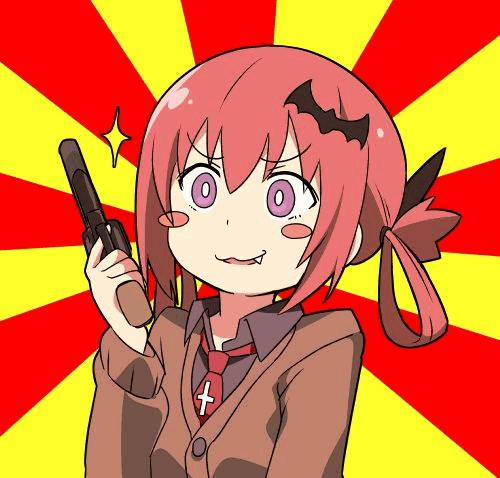

[1425/2000] 96c01b5eb630403664a87e163c48c9da9a1b7842151711d348798286b36bc3de
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/96c01b5eb630403664a87e163c48c9da9a1b7842151711d348798286b36bc3de.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/96c01b5eb630403664a87e163c48c9da9a1b7842151711d348798286b36bc3de.gz'
Failed to load target image.
[1426/2000] d5fd3c0149a3a3d8b1b0cb40a56b550bb3ad96015697cc2fab3b930973e77445
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d5fd3c0149a3a3d8b1b0cb40a56b550bb3ad96015697cc2fab3b930973e77445.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d5fd3c0149a3a3d8b1b0cb40a56b550bb3ad96015697cc2fab3b930973e77445.gz'
Failed to load target image.
[1427/2000] 8606386392a076f7e82de7db5070c259f4ba4e8ba61e4c74e96269023e7914ad



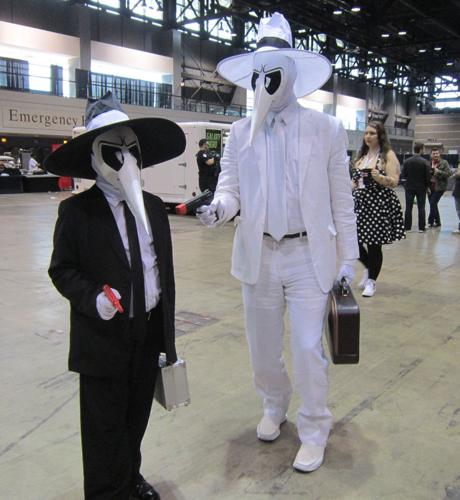

[1428/2000] 546a4614a8074137f09345c7f240fa8aae7cfa7f076311ff08f2bfa6cc029c23
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/546a4614a8074137f09345c7f240fa8aae7cfa7f076311ff08f2bfa6cc029c23.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/546a4614a8074137f09345c7f240fa8aae7cfa7f076311ff08f2bfa6cc029c23.gz'
Failed to load target image.
[1429/2000] b6491772129dd00f3c662706d38f5f2b50ee831f2ebeaa615c45460be8b9615b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b6491772129dd00f3c662706d38f5f2b50ee831f2ebeaa615c45460be8b9615b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b6491772129dd00f3c662706d38f5f2b50ee831f2ebeaa615c45460be8b9615b.gz'
Failed to load target image.
[1430/2000] e94149ea39ec0f9c44a5705d6a96e8b999ae2516106c4e17c0e4a732be081925



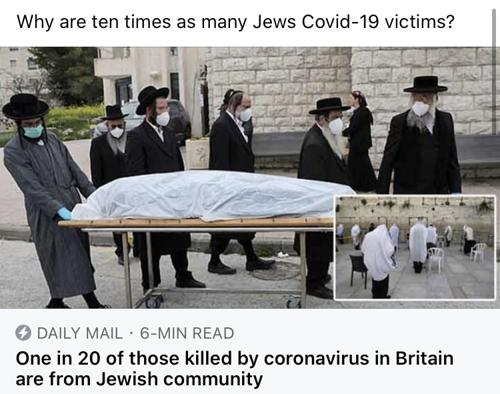

[1431/2000] c463c3ec5c7999e5ebaa1d0b976d83c4f775fd6629ba119bd0650a188d6306a8
[1432/2000] 65fe60c58f43faf801a2aaea88121a140384e0f5a127ca3e2750058d7de07643
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/65fe60c58f43faf801a2aaea88121a140384e0f5a127ca3e2750058d7de07643.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/65fe60c58f43faf801a2aaea88121a140384e0f5a127ca3e2750058d7de07643.gz'
Failed to load target image.
[1433/2000] 14cb51d1ebcc59205f73987573b72649ada47be593dec2cdf791f32587af7ee4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/14cb51d1ebcc59205f73987573b72649ada47be593dec2cdf791f32587af7ee4.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/14cb51d1ebcc59205f73987573b72649ada47be593dec2cdf791f32587af7ee4.gz'
Failed to load target image.
[1434/2000] 38eab36063953aa558fba7422aae623159c2fc65aed0fd1


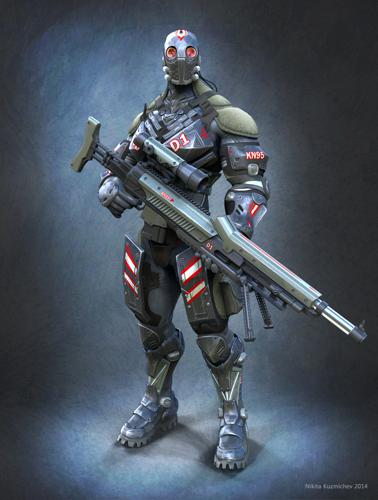

[1437/2000] 111f6bc4fba74cb551e72b82e4089bf444c63173877b52a6e85680cc032a1d2d
[1438/2000] 6accb624c38eb9ce35980d67cc19d65c7409656f86681a03b753fb71584a22f1



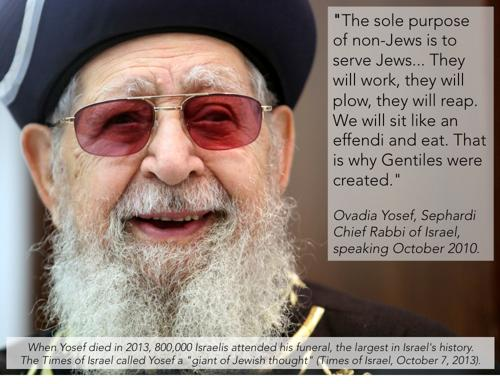

[1439/2000] 5db20a629407249de2c3595dc46b5bea7a89ede6926e67ef468d3dbcbcc16404
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5db20a629407249de2c3595dc46b5bea7a89ede6926e67ef468d3dbcbcc16404.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5db20a629407249de2c3595dc46b5bea7a89ede6926e67ef468d3dbcbcc16404.gz'
Failed to load target image.
[1440/2000] d3dc9e41801dac00e33d4d19cb0d2e84da0ea06c5426ec7b40f34fe8d542d9e1
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d3dc9e41801dac00e33d4d19cb0d2e84da0ea06c5426ec7b40f34fe8d542d9e1.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d3dc9e41801dac00e33d4d19cb0d2e84da0ea06c5426ec7b40f34fe8d542d9e1.gz'
Failed to load target image.
[1441/2000] c7ecb805271581874fedd0796310051230d4f223b8d1b2dee437d63498b48c51



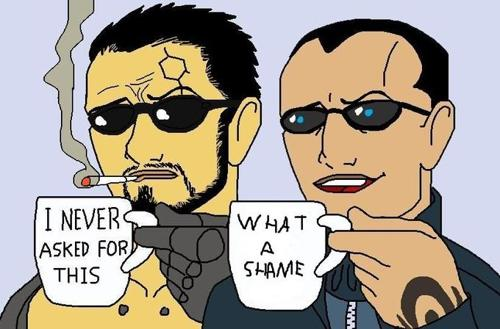

[1442/2000] f4b94022534896563b51737342ee9694cde4de177b0f21a2448881a0e54b95ef
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f4b94022534896563b51737342ee9694cde4de177b0f21a2448881a0e54b95ef.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f4b94022534896563b51737342ee9694cde4de177b0f21a2448881a0e54b95ef.gz'
Failed to load target image.
[1443/2000] b2e280ce47af255e6096ea3f922bef88b6ff2b7304b1ada7e690637308b72765
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b2e280ce47af255e6096ea3f922bef88b6ff2b7304b1ada7e690637308b72765.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b2e280ce47af255e6096ea3f922bef88b6ff2b7304b1ada7e690637308b72765.gz'
Failed to load target image.
[1444/2000] da9674cc3a73a3c8caa8a0630b0ce57816c99123b5360a4b7a0dffd4e1c7833a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


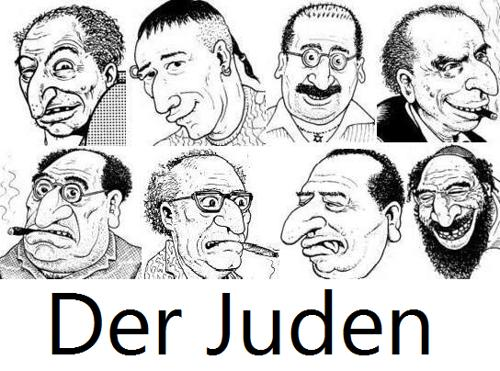

[1450/2000] a310bae99e42458da229307475504de20835f2c05c595ef9e32d96fc4aa65733
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a310bae99e42458da229307475504de20835f2c05c595ef9e32d96fc4aa65733.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a310bae99e42458da229307475504de20835f2c05c595ef9e32d96fc4aa65733.gz'
Failed to load target image.
[1451/2000] 84a9daeb454b5ba3443c9ff53decf21ca53827832aba8beae165b9e42cb2eb20
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/84a9daeb454b5ba3443c9ff53decf21ca53827832aba8beae165b9e42cb2eb20.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/84a9daeb454b5ba3443c9ff53decf21ca53827832aba8beae165b9e42cb2eb20.gz'
Failed to load target image.
[1452/2000] f8f0c55a136c20e5a680062a249b2505bfa13a7df6852f15df4f3a137d505030
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


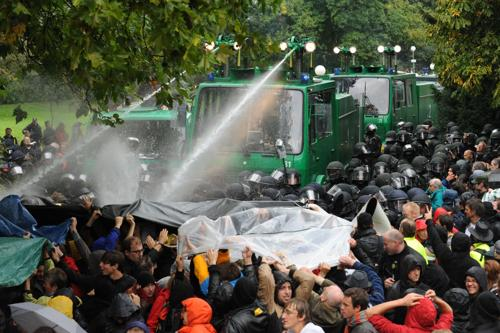

[1459/2000] a14d75c3775c3df294c9ee2cbd1b538867229f044c812f35ea514526e7812a08



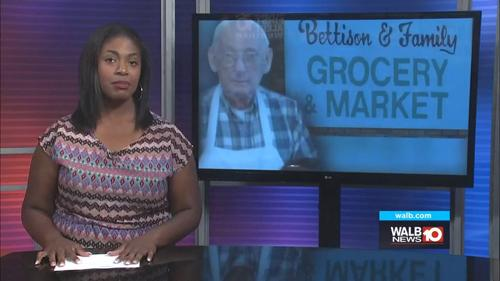

[1460/2000] 7b1f7da9f4709465e8447ebe7abea2984acfc798e0800add2f8438cfeb679423



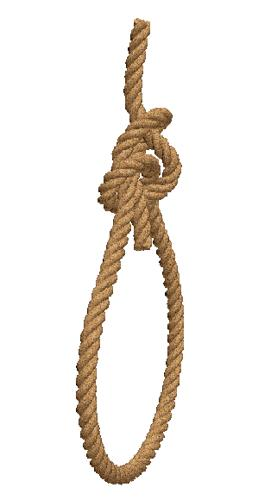

[1461/2000] 24c3294d6ea2a219d7b0eafe80c0942b41454fb4e158da78e9ef27a60214a38a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/24c3294d6ea2a219d7b0eafe80c0942b41454fb4e158da78e9ef27a60214a38a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/24c3294d6ea2a219d7b0eafe80c0942b41454fb4e158da78e9ef27a60214a38a.gz'
Failed to load target image.
[1462/2000] 6654c7cb83caa3647cbcb2842b6c650fe32de2d9278dcf0dd0d302950d4690aa
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6654c7cb83caa3647cbcb2842b6c650fe32de2d9278dcf0dd0d302950d4690aa.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6654c7cb83caa3647cbcb2842b6c650fe32de2d9278dcf0dd0d302950d4690aa.gz'
Failed to load target image.
[1463/2000] c9ae9ea714da275e727da66cf9b7d4157b8c2f53383ce9e47f1e348a9c36a811



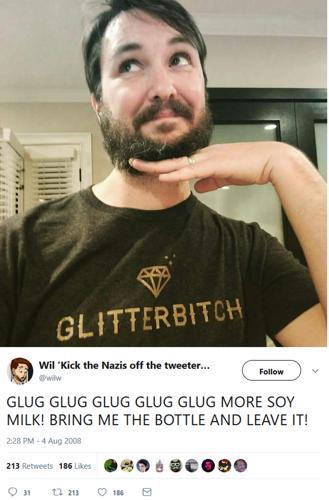

[1464/2000] b7381ccd57e148bc91dd286fa4771d7d0895228a4e5edc6666bc1d7b12b45d28
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b7381ccd57e148bc91dd286fa4771d7d0895228a4e5edc6666bc1d7b12b45d28.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b7381ccd57e148bc91dd286fa4771d7d0895228a4e5edc6666bc1d7b12b45d28.gz'
Failed to load target image.
[1465/2000] de7b9228b37c4015b275adb20107613a91409a2d1fc7619f7a34cc1064b363ca
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/de7b9228b37c4015b275adb20107613a91409a2d1fc7619f7a34cc1064b363ca.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/de7b9228b37c4015b275adb20107613a91409a2d1fc7619f7a34cc1064b363ca.gz'
Failed to load target image.
[1466/2000] 25bc4b6e3616a31959f5a843c7b65a4ca59dddfecb548b939ba0b55cf5997530
[1467/2000] c2f6addf50fa1eb0c0d05209a1bddf2a0b0ac4e542f5619


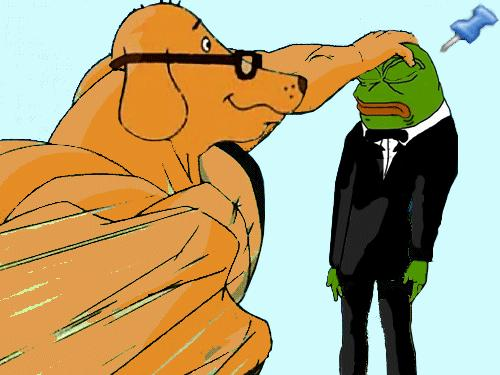

[1469/2000] 1d6a79ed6aee439d0621cc1cce112e252caf60ce1dcfedc02e74d1d42f9d19b0
[1470/2000] 29f5f6ba1848e8ea9dc5415155221bb15c9c1e16b85d2267d719667f9de2b79f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/29f5f6ba1848e8ea9dc5415155221bb15c9c1e16b85d2267d719667f9de2b79f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/29f5f6ba1848e8ea9dc5415155221bb15c9c1e16b85d2267d719667f9de2b79f.gz'
Failed to load target image.
[1471/2000] c90184d7f12a69c58ef78944c793e24672b9c3dc0eb6334c38b8b9d9bbd77285
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c90184d7f12a69c58ef78944c793e24672b9c3dc0eb6334c38b8b9d9bbd77285.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c90184d7f12a69c58ef78944c793e24672b9c3dc0eb6334c38b8b9d9bbd77285.gz'
Failed to load target image.
[1472/2000] 3f4fa7c708cb859462343d2b4eee4688d0538e92b902d71


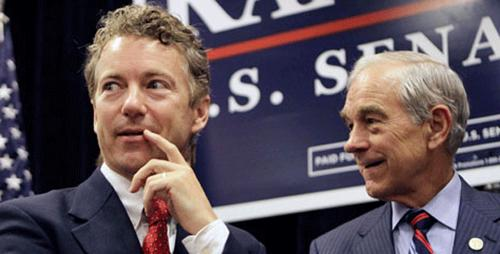

[1476/2000] dbdfa2b3a3f479334ec666bb3b17c3bdfcc36bb59e1c86a359394348d6aaf3c2
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/dbdfa2b3a3f479334ec666bb3b17c3bdfcc36bb59e1c86a359394348d6aaf3c2.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/dbdfa2b3a3f479334ec666bb3b17c3bdfcc36bb59e1c86a359394348d6aaf3c2.gz'
Failed to load target image.
[1477/2000] e27e3b313c0217fc8ac8737b4d79afe8c3c7e8714bb6e518780ea4576cb47d75
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e27e3b313c0217fc8ac8737b4d79afe8c3c7e8714bb6e518780ea4576cb47d75.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e27e3b313c0217fc8ac8737b4d79afe8c3c7e8714bb6e518780ea4576cb47d75.gz'
Failed to load target image.
[1478/2000] 5fd5fc150af1c69df93eb887ced1e28dd96c3c0bab752778f21e66190256b366
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


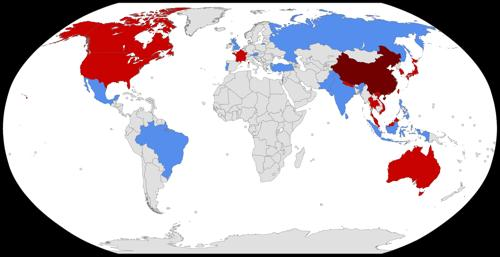

[1485/2000] c6c34f68804e2dab0afc14ed71e8b0bdc743aa58d1cfbdbcc9c4520db0947e71
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c6c34f68804e2dab0afc14ed71e8b0bdc743aa58d1cfbdbcc9c4520db0947e71.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c6c34f68804e2dab0afc14ed71e8b0bdc743aa58d1cfbdbcc9c4520db0947e71.gz'
Failed to load target image.
[1486/2000] 7868eb3af8103eca40b07ed37e21f7e86e126a59a5efab90bf830af4974fc050
[1487/2000] 082227a9403d28feb23f593aa980b2dd6e67725838b33a0a8d996cb50ed9e675



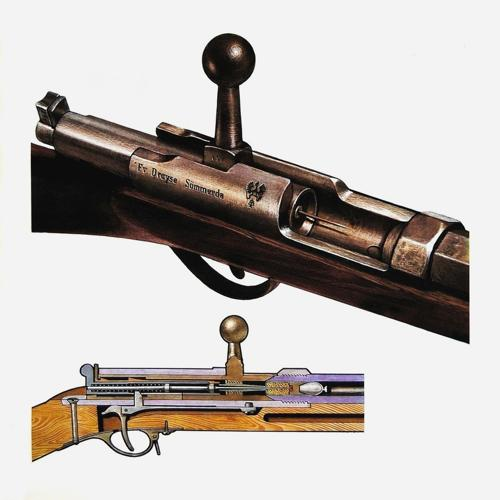

[1488/2000] 9be28c6585361aa325a1db41648c7f762df8957250cb2b76d17324d171933b63
[1489/2000] a89be2b6d3cfece360df4c4746cbd5ed1407d93936b2007d17af9b5b34ba3be4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a89be2b6d3cfece360df4c4746cbd5ed1407d93936b2007d17af9b5b34ba3be4.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a89be2b6d3cfece360df4c4746cbd5ed1407d93936b2007d17af9b5b34ba3be4.gz'
Failed to load target image.
[1490/2000] 29bd14f30cf5ad9405491af0cdbb3cf435f03936cabe58bf4f2ee24ef2f8096e
[1491/2000] f62bf4722375e218eefe9725efdcaf1efd3221e6adf02b71f2ea5bdf3a18ed66
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f62bf4722375e218eefe9725efdcaf1efd3221e6adf02b71f2ea5bdf3a18ed66.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f62bf4722375e218eefe9725efdcaf1efd3221e6adf02b71f2ea5bdf3a18ed66.gz'
Failed to l


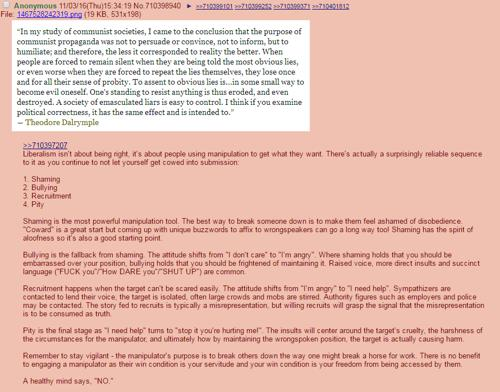

[1495/2000] 5e1bd1de750d12fd2b47fd7c9fdfb78fdb6e144ac7041c683e0255112fc8ad03



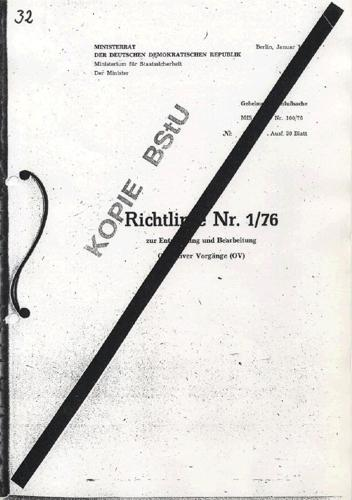

[1496/2000] 840c57a94f3c4bc3de3eb9243d348bda6a02ba76c8d113d82a41f7221bfd2745
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/840c57a94f3c4bc3de3eb9243d348bda6a02ba76c8d113d82a41f7221bfd2745.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/840c57a94f3c4bc3de3eb9243d348bda6a02ba76c8d113d82a41f7221bfd2745.gz'
Failed to load target image.
[1497/2000] c76985ee075e505a51b1cfdc0ec4778a6e1791db001ad322e0f067d841c46a09
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c76985ee075e505a51b1cfdc0ec4778a6e1791db001ad322e0f067d841c46a09.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c76985ee075e505a51b1cfdc0ec4778a6e1791db001ad322e0f067d841c46a09.gz'
Failed to load target image.
[1498/2000] a377b34c458485fb50214682e11e57cad0c582daac8c76e538fdf4909a079c97



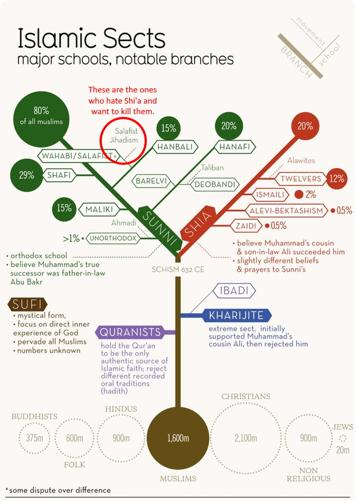

[1499/2000] d8525bcbc4a48ff993f35b60323c859d520999f3d757081dff6a3d4d17a692f7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d8525bcbc4a48ff993f35b60323c859d520999f3d757081dff6a3d4d17a692f7.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d8525bcbc4a48ff993f35b60323c859d520999f3d757081dff6a3d4d17a692f7.gz'
Failed to load target image.
[1500/2000] f0ec5699afe3af4523725307f5adebb682686c99bc501a9783a734bd88e877da
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f0ec5699afe3af4523725307f5adebb682686c99bc501a9783a734bd88e877da.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f0ec5699afe3af4523725307f5adebb682686c99bc501a9783a734bd88e877da.gz'
Failed to load target image.
[1501/2000] 40ed77fda9b0c11abb93891c31280b48b41e65207cc435930f3fd6cfeace22af
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


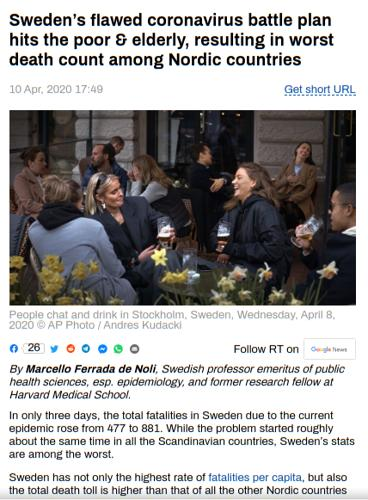

[1510/2000] 49e5ba7499ae88f43513b6904430b7dd4466066a20edbe4dbbeb49e7e05610a7
[1511/2000] d4ad431131427ad06bf03b9112ec3b746d8cb85ecea118c61095079eb26311db
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d4ad431131427ad06bf03b9112ec3b746d8cb85ecea118c61095079eb26311db.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d4ad431131427ad06bf03b9112ec3b746d8cb85ecea118c61095079eb26311db.gz'
Failed to load target image.
[1512/2000] d85d8833a1f0d3488aa0d529befca06c368e3bde4f91a7e1fe9ccbd22cc2510e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d85d8833a1f0d3488aa0d529befca06c368e3bde4f91a7e1fe9ccbd22cc2510e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d85d8833a1f0d3488aa0d529befca06c368e3bde4f91a7e1fe9ccbd22cc2510e.gz'
Failed to load target image.
[1513/2000] 949801acd3d9788009d060f254ac0f1cedef2ea82b3c0a4


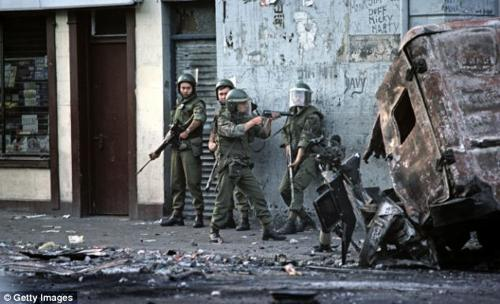

[1520/2000] 825835a7b066a3dd1a568661648bf883a600f1e5a581d5bd7b74a34941322f0c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/825835a7b066a3dd1a568661648bf883a600f1e5a581d5bd7b74a34941322f0c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/825835a7b066a3dd1a568661648bf883a600f1e5a581d5bd7b74a34941322f0c.gz'
Failed to load target image.
[1521/2000] ee11ce08523d16a66de8e0428fce0629a16a0756afa99cfa96a7cf4d92e4f527
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ee11ce08523d16a66de8e0428fce0629a16a0756afa99cfa96a7cf4d92e4f527.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ee11ce08523d16a66de8e0428fce0629a16a0756afa99cfa96a7cf4d92e4f527.gz'
Failed to load target image.
[1522/2000] 8e90b39e59376c39437854a7e8b779d620d9b9263d621c9c608ba99299eb7498
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


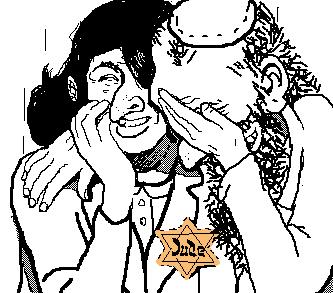

[1529/2000] 31ec2d1d5779f9ea776d98ef2ed5195dbcbac676ef8aee53add6194c588d41dd
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/31ec2d1d5779f9ea776d98ef2ed5195dbcbac676ef8aee53add6194c588d41dd.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/31ec2d1d5779f9ea776d98ef2ed5195dbcbac676ef8aee53add6194c588d41dd.gz'
Failed to load target image.
[1530/2000] b0893af4164550807d15f5e6f2441cc3c792d93af36634f99f53aaedb17320c1



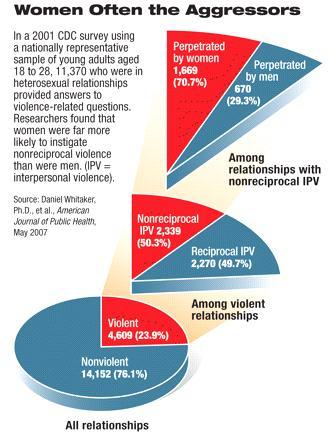

[1531/2000] 6385f28ebb59a43dd4283f022c946c666f5e3eebe0012b816989f30eb332b790
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6385f28ebb59a43dd4283f022c946c666f5e3eebe0012b816989f30eb332b790.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6385f28ebb59a43dd4283f022c946c666f5e3eebe0012b816989f30eb332b790.gz'
Failed to load target image.
[1532/2000] ae18deeb840187d59624e4c9b780ffcff2a96cbccbbeba4e86ebe8e37c8cbb7e
[1533/2000] c99091334fc0e83273ca5aa0f466a5b1b0db64079b95bedee4d6c94c2a1875f7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c99091334fc0e83273ca5aa0f466a5b1b0db64079b95bedee4d6c94c2a1875f7.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c99091334fc0e83273ca5aa0f466a5b1b0db64079b95bedee4d6c94c2a1875f7.gz'
Failed to load target image.
[1534/2000] 891ff5d5451095f44b1af99443dec9d4188af096a3cb40f


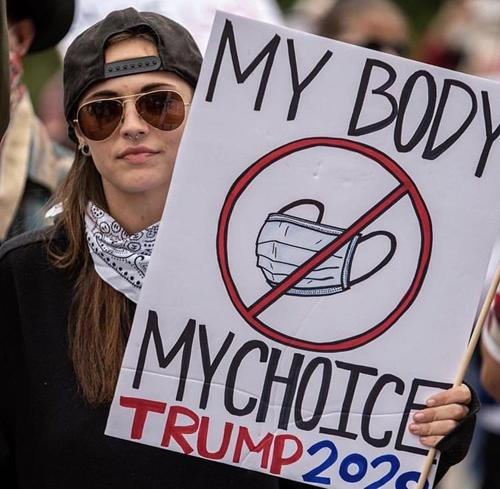

[1535/2000] 150c8d33fc148c126ea1ccce721b72b1b3eca353da6bd296ff8ea8f3a311b94f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/150c8d33fc148c126ea1ccce721b72b1b3eca353da6bd296ff8ea8f3a311b94f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/150c8d33fc148c126ea1ccce721b72b1b3eca353da6bd296ff8ea8f3a311b94f.gz'
Failed to load target image.
[1536/2000] 8eb76e0976bff5d39ffd81a8edce173a3fb261e05596d626bb10a27e2e079b52
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8eb76e0976bff5d39ffd81a8edce173a3fb261e05596d626bb10a27e2e079b52.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8eb76e0976bff5d39ffd81a8edce173a3fb261e05596d626bb10a27e2e079b52.gz'
Failed to load target image.
[1537/2000] 870dd253a57da18f6cebbd71d2f1f8174b7f043071c23f474ed314e8aa38d828
[1538/2000] e357ee0b0db3509f7bdfe25f7bbf304ef1394e802a0b475


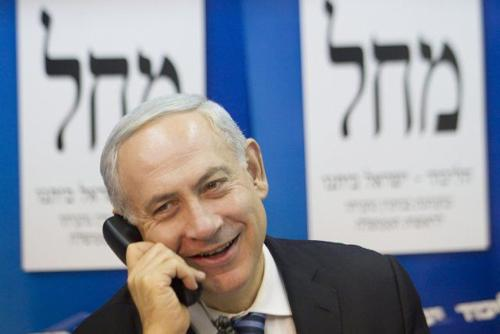

[1542/2000] 85a3b19c1d9008c8fb4a0e6832d32f11b208b4d1340be6482498aca8b8c2becd
[1543/2000] e9da2336b09a5330513703addc1223c7bd1ad61299b55c493c7e7d04e4433c34
[1544/2000] 02755ee47093a1ff7345d68c617a63356ef8229b4512b4f63f74d412299e6771
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/02755ee47093a1ff7345d68c617a63356ef8229b4512b4f63f74d412299e6771.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/02755ee47093a1ff7345d68c617a63356ef8229b4512b4f63f74d412299e6771.gz'
Failed to load target image.
[1545/2000] d6e6084e980d9937592b01c84abc8452c8c394164135a7fb40c6cf63123c3991
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d6e6084e980d9937592b01c84abc8452c8c394164135a7fb40c6cf63123c3991.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d6e6084e980d9937592b01c84abc8452c8c394164135a7fb40c6cf63123c3991.gz'
Failed to l


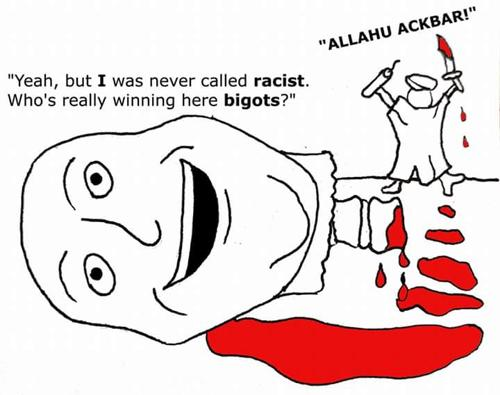

[1549/2000] 2872858b66f7917fbebb8693d0d3a9e3709ca3fea8e013c159320aa2b62bff04
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2872858b66f7917fbebb8693d0d3a9e3709ca3fea8e013c159320aa2b62bff04.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2872858b66f7917fbebb8693d0d3a9e3709ca3fea8e013c159320aa2b62bff04.gz'
Failed to load target image.
[1550/2000] 1760044ea1227be7a013257940c76fc02e8ce9e9081f934d1d185ade692942a6



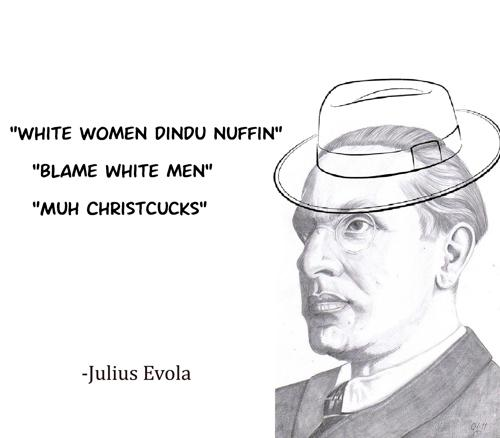

[1551/2000] 4cb77524021ff70f7f0cc49a7cad1f0178c6d855a5a9659ea5e7421db8ea580a



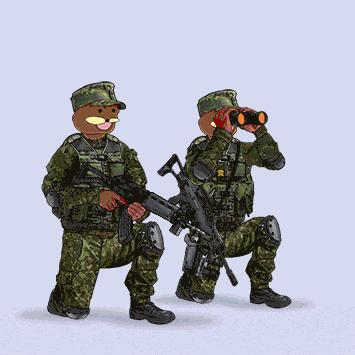

[1552/2000] 971e27a210911f0fba7ca1a24261d0178bf63c7798a64b13e859635258f3bf61
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/971e27a210911f0fba7ca1a24261d0178bf63c7798a64b13e859635258f3bf61.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/971e27a210911f0fba7ca1a24261d0178bf63c7798a64b13e859635258f3bf61.gz'
Failed to load target image.
[1553/2000] 5bc6d1d6b65cd59caaefdefe5c030240e3ef65c08f708b43a2f6843c5365e2a5
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5bc6d1d6b65cd59caaefdefe5c030240e3ef65c08f708b43a2f6843c5365e2a5.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5bc6d1d6b65cd59caaefdefe5c030240e3ef65c08f708b43a2f6843c5365e2a5.gz'
Failed to load target image.
[1554/2000] 51b789855c80b4718a7a00fafb3fa465313e88a079fd6d230d7f7ca2c6d9c181



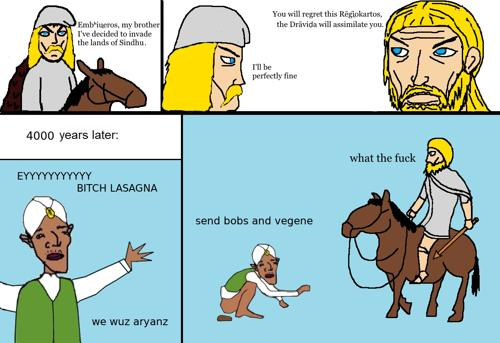

[1555/2000] 456f9d7bc66f5ffdcf8e932753fd31e2fda4e95ce987f74046c45f459d2d06d3



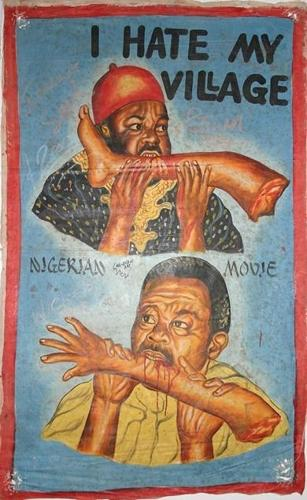

[1556/2000] 90c8149567a08736646ed16d13fd73325472a8b6e72195e94feae0e411741ee2



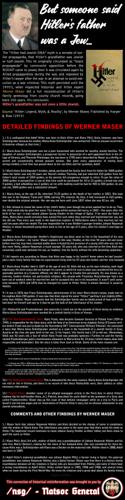

[1557/2000] 69b5fc599fd20ecd0b1c1b6b1ea5a97f22034f4706ac401a7cea308bc6d46227
[1558/2000] 3da888c0aba6d2973add4c1cc71c17fab2db76bb55047a86a6442fc38003d552
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3da888c0aba6d2973add4c1cc71c17fab2db76bb55047a86a6442fc38003d552.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3da888c0aba6d2973add4c1cc71c17fab2db76bb55047a86a6442fc38003d552.gz'
Failed to load target image.
[1559/2000] 4f3042c06bb7c60159749287cd62028d975b5f00c2a01e217bfe74eefae92929
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4f3042c06bb7c60159749287cd62028d975b5f00c2a01e217bfe74eefae92929.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4f3042c06bb7c60159749287cd62028d975b5f00c2a01e217bfe74eefae92929.gz'
Failed to load target image.
[1560/2000] d6d5933257f596de0a5e9b0eef75b039f8d5b68f9582136


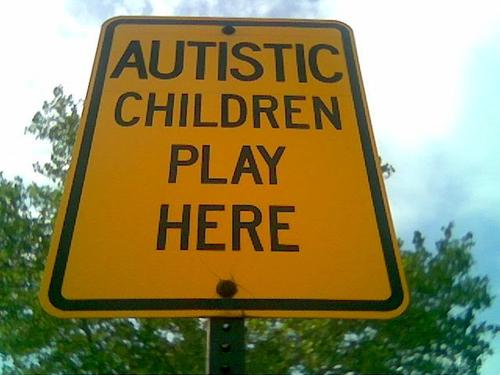

[1561/2000] 68878b8cb4e21ed339c0d36c338e63dc69cd5c271d413302559d7c817c629faf
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/68878b8cb4e21ed339c0d36c338e63dc69cd5c271d413302559d7c817c629faf.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/68878b8cb4e21ed339c0d36c338e63dc69cd5c271d413302559d7c817c629faf.gz'
Failed to load target image.
[1562/2000] f26004767790066fe95f180db79d045bbf59437ade7006c5532dc79f04d47854
[1563/2000] 97ec656ef15c67645e53ff89321e691965107ff6d6fa424364415c09b317f715
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/97ec656ef15c67645e53ff89321e691965107ff6d6fa424364415c09b317f715.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/97ec656ef15c67645e53ff89321e691965107ff6d6fa424364415c09b317f715.gz'
Failed to load target image.
[1564/2000] 34dc5b9ff634584c3bd6f1d80f8cd8316a5dff263aeafcd


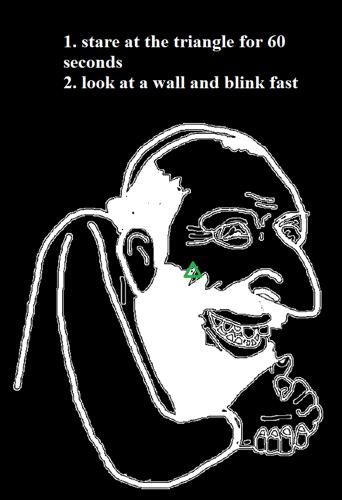

[1569/2000] 74cd2c144e9c5ea13ba47b48c4b2082608f77e2c180e0b84fe6a406de77f66e0
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/74cd2c144e9c5ea13ba47b48c4b2082608f77e2c180e0b84fe6a406de77f66e0.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/74cd2c144e9c5ea13ba47b48c4b2082608f77e2c180e0b84fe6a406de77f66e0.gz'
Failed to load target image.
[1570/2000] 8c5620342d3088e4d3b37e603661467d2ecca11aaea435f7cea98ccd2ec19a69
[1571/2000] 6b9936188494779fdd3fb45aad624ae0e92e4d5dccdd05d8d68abfcfbaa52dbf
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6b9936188494779fdd3fb45aad624ae0e92e4d5dccdd05d8d68abfcfbaa52dbf.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6b9936188494779fdd3fb45aad624ae0e92e4d5dccdd05d8d68abfcfbaa52dbf.gz'
Failed to load target image.
[1572/2000] 6a184ba20f3cad8899c5ac44072eca5c4418d716bdae717


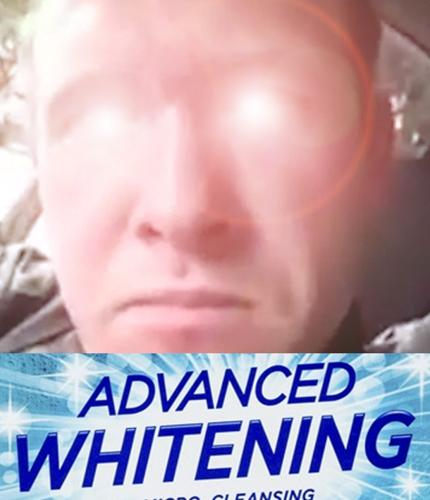

[1580/2000] 3cbbae2d6b1d96b8aee3e82b7cc483e66b18f15496c9d758a2803b701231cc3f
[1581/2000] 1cbd2e625707721ef1e6f0bac95c9882a1d5bb5eaa1a6a34f4c5b9baafa4569e



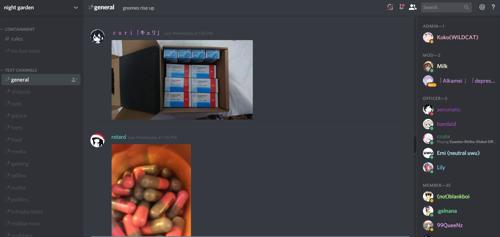

[1582/2000] 800d1f15444a20ed5748087856f80f19b0ee4bb8ded9a1ef60d4f52793673655
[1583/2000] fcf0f76f912da53b7f1e8e1f09c5863cc7d6245833e619abccfc9f888f363173
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fcf0f76f912da53b7f1e8e1f09c5863cc7d6245833e619abccfc9f888f363173.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fcf0f76f912da53b7f1e8e1f09c5863cc7d6245833e619abccfc9f888f363173.gz'
Failed to load target image.
[1584/2000] 467f76b28a33d2f27d8f6997ca316f9890ccd0fe0fa8d3a67ab57d4b925446f6
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/467f76b28a33d2f27d8f6997ca316f9890ccd0fe0fa8d3a67ab57d4b925446f6.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/467f76b28a33d2f27d8f6997ca316f9890ccd0fe0fa8d3a67ab57d4b925446f6.gz'
Failed to load target image.
[1585/2000] 7f6832b0b69f43b65991308b32e743072a1cdfc07994c13


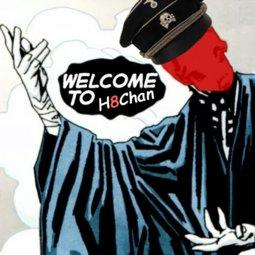

[1588/2000] 2ed5b4c55332fb2a2ef4ff9cae37c0a634d4b85901443d8ea2da4e4c001bf29d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2ed5b4c55332fb2a2ef4ff9cae37c0a634d4b85901443d8ea2da4e4c001bf29d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2ed5b4c55332fb2a2ef4ff9cae37c0a634d4b85901443d8ea2da4e4c001bf29d.gz'
Failed to load target image.
[1589/2000] 62e534d3384208a9c0b7bc8597a76716584b98d78698aa8fe098c0637e0c161f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/62e534d3384208a9c0b7bc8597a76716584b98d78698aa8fe098c0637e0c161f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/62e534d3384208a9c0b7bc8597a76716584b98d78698aa8fe098c0637e0c161f.gz'
Failed to load target image.
[1590/2000] 4fd298e1a9efbbf3fe33e79101ac5a0c0568ea1afa3833bc448fe22fff50126c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


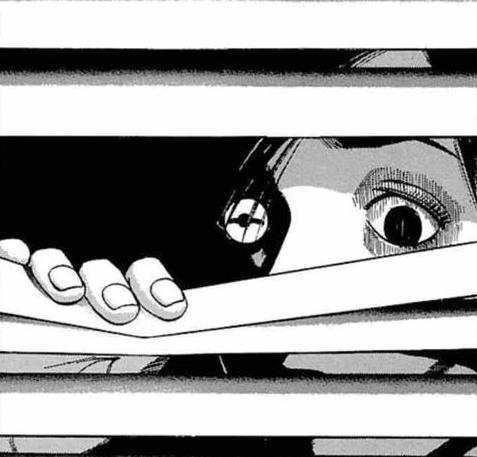

[1593/2000] 077b007ffea422c9719801fe64af4d893d4448026640895f1eb4537d8badfcc6
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/077b007ffea422c9719801fe64af4d893d4448026640895f1eb4537d8badfcc6.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/077b007ffea422c9719801fe64af4d893d4448026640895f1eb4537d8badfcc6.gz'
Failed to load target image.
[1594/2000] 57ddf46818d984084d15bdab70bfb826753ea42be0a1cce061661670538b94d7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/57ddf46818d984084d15bdab70bfb826753ea42be0a1cce061661670538b94d7.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/57ddf46818d984084d15bdab70bfb826753ea42be0a1cce061661670538b94d7.gz'
Failed to load target image.
[1595/2000] d9578951d6c0747db507b95f33c379524d43e5ab5554e561af59c560ac635a66
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


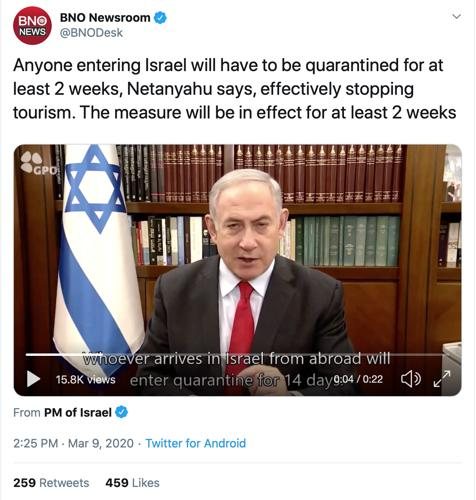

[1599/2000] a6759890a86bfbe2160a98204d6311a4009bbbd23b9fa5202bc4ce72af0f0de0



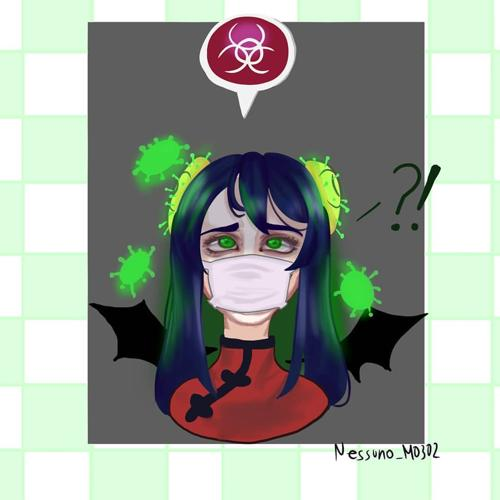

[1600/2000] 1f1a3f54067808a519b3bb4518eb18f8960ece67395a4d713fccef3bdf6bcbb1
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1f1a3f54067808a519b3bb4518eb18f8960ece67395a4d713fccef3bdf6bcbb1.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1f1a3f54067808a519b3bb4518eb18f8960ece67395a4d713fccef3bdf6bcbb1.gz'
Failed to load target image.
[1601/2000] e7c2dd4e9a2a4930738b09eb0abb32424cf2c25bfcd66cba856158a0eabd7381
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e7c2dd4e9a2a4930738b09eb0abb32424cf2c25bfcd66cba856158a0eabd7381.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e7c2dd4e9a2a4930738b09eb0abb32424cf2c25bfcd66cba856158a0eabd7381.gz'
Failed to load target image.
[1602/2000] 1cfbecf36b223d782c700d7beaa0888148c7e793920bcca77eb18ce800ce0271
[1603/2000] fe7b0fbbd1119f7661d3a0ebc64560ce4175585e88ab3e8


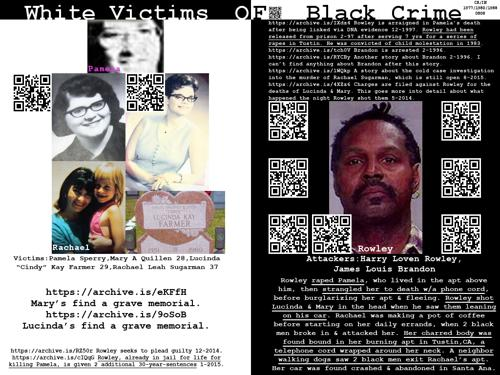

[1608/2000] b8078b3e007dbd40535a845a40f956ae5bd2ee5528371eb379f6da5449328589
[1609/2000] 167448858d0daafa898f3a0a20cb396b1cb8d5e2a8fdb91aed9c567d7c4912f3
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/167448858d0daafa898f3a0a20cb396b1cb8d5e2a8fdb91aed9c567d7c4912f3.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/167448858d0daafa898f3a0a20cb396b1cb8d5e2a8fdb91aed9c567d7c4912f3.gz'
Failed to load target image.
[1610/2000] 4894478cd3e66398c72eff06f199a0dee8dca17c619c15cb831d60e2fe99b23e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4894478cd3e66398c72eff06f199a0dee8dca17c619c15cb831d60e2fe99b23e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4894478cd3e66398c72eff06f199a0dee8dca17c619c15cb831d60e2fe99b23e.gz'
Failed to load target image.
[1611/2000] 1a9268a1363dbdc1f7c9bb498926d0920aba0634eb45a10


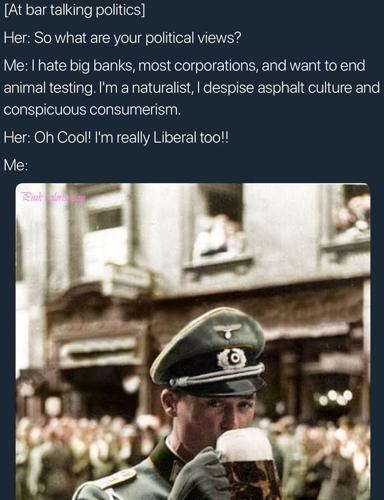

[1621/2000] 5e1031eafedf3e3ed600d9280a65113aaa1112faef95407e543d5bc836bb209c
[1622/2000] b33d1db15a4101f3675e533ef34c5a5ef00f08de8cbda83882035f79ef404913
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b33d1db15a4101f3675e533ef34c5a5ef00f08de8cbda83882035f79ef404913.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b33d1db15a4101f3675e533ef34c5a5ef00f08de8cbda83882035f79ef404913.gz'
Failed to load target image.
[1623/2000] 181b21ea5a0efc8e4f72a782da5a8dc939c40987fb3b003d8f2af795324d6dea



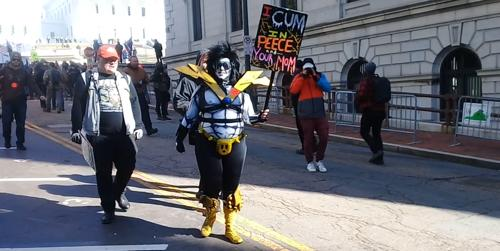

[1624/2000] 704f625d231b5e1571233188b1fe9f85529d0c55c67c6319ac9689dbd39a2c08
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/704f625d231b5e1571233188b1fe9f85529d0c55c67c6319ac9689dbd39a2c08.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/704f625d231b5e1571233188b1fe9f85529d0c55c67c6319ac9689dbd39a2c08.gz'
Failed to load target image.
[1625/2000] fd3d4f9ab06b8f03e598c5fa270e5bda61ae40b9e929c81c81cccdb967adfdf4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fd3d4f9ab06b8f03e598c5fa270e5bda61ae40b9e929c81c81cccdb967adfdf4.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fd3d4f9ab06b8f03e598c5fa270e5bda61ae40b9e929c81c81cccdb967adfdf4.gz'
Failed to load target image.
[1626/2000] 70e872490f1777926af9f0c87ed1408b41979eefca918975aacdb0971325aecb
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


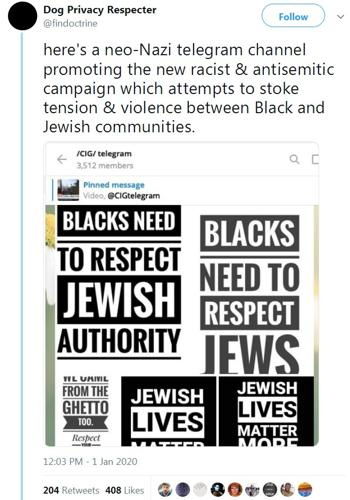

[1634/2000] e4909990d0f3a81e409a28ae4f84fec43ea956fadec231413b0fabb04f33aa1d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e4909990d0f3a81e409a28ae4f84fec43ea956fadec231413b0fabb04f33aa1d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e4909990d0f3a81e409a28ae4f84fec43ea956fadec231413b0fabb04f33aa1d.gz'
Failed to load target image.
[1635/2000] dc213ebe2cd5628175f376589073eb81110039d92d87ffb3d201b2c7bc7e4fb5
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/dc213ebe2cd5628175f376589073eb81110039d92d87ffb3d201b2c7bc7e4fb5.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/dc213ebe2cd5628175f376589073eb81110039d92d87ffb3d201b2c7bc7e4fb5.gz'
Failed to load target image.
[1636/2000] 426a20b89ad48a3131f95e9bb16d3ee67474812f055fe8ecacd9b8695f8c033b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


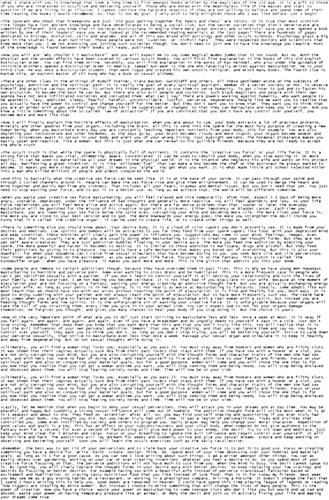

[1638/2000] d305715dfaf317ee76d7f3b2594857bbb091c2aa1ca34ee62bdd7ac48368a8a7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d305715dfaf317ee76d7f3b2594857bbb091c2aa1ca34ee62bdd7ac48368a8a7.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d305715dfaf317ee76d7f3b2594857bbb091c2aa1ca34ee62bdd7ac48368a8a7.gz'
Failed to load target image.
[1639/2000] 255add83783c886b5a6159b3e5ed66504c0d2dc5ab290aedc076bdd642db5959
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/255add83783c886b5a6159b3e5ed66504c0d2dc5ab290aedc076bdd642db5959.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/255add83783c886b5a6159b3e5ed66504c0d2dc5ab290aedc076bdd642db5959.gz'
Failed to load target image.
[1640/2000] 9b607b41527b6979748b1f5891eb102d6fae7ecc50bbdbf19a53aca724b36e50
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


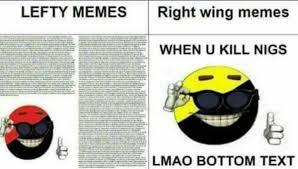

[1642/2000] d8c39da436ec4286eb66bcb2f18e2b2e0cb73b6b8b67135d36a45f33258bd2de
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d8c39da436ec4286eb66bcb2f18e2b2e0cb73b6b8b67135d36a45f33258bd2de.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d8c39da436ec4286eb66bcb2f18e2b2e0cb73b6b8b67135d36a45f33258bd2de.gz'
Failed to load target image.
[1643/2000] ba21a2a4c21e4be173abc8b94838fd59f271e55bbcdf5b6cd9244f95e360ddc9



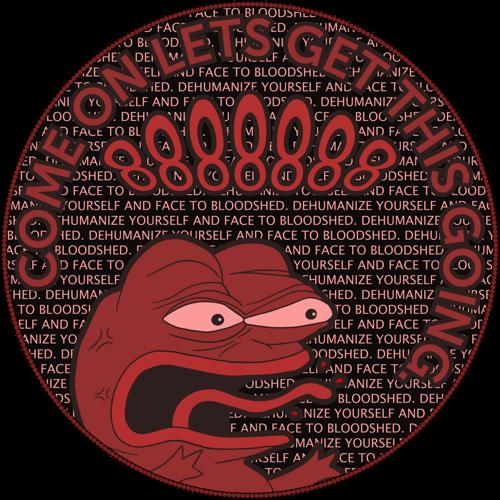

[1644/2000] f9f1c17cd1c87c4d958baff74e29c80c6cf70df074ebc573fee3a99b8c2c96f4
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f9f1c17cd1c87c4d958baff74e29c80c6cf70df074ebc573fee3a99b8c2c96f4.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f9f1c17cd1c87c4d958baff74e29c80c6cf70df074ebc573fee3a99b8c2c96f4.gz'
Failed to load target image.
[1645/2000] 082760784b000d0accd6003d3f8180dc88e18cddc6cfc1b42654e90c26b1bb55
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/082760784b000d0accd6003d3f8180dc88e18cddc6cfc1b42654e90c26b1bb55.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/082760784b000d0accd6003d3f8180dc88e18cddc6cfc1b42654e90c26b1bb55.gz'
Failed to load target image.
[1646/2000] 896f0e362cdc6e14e834b4bc25b81435c2a0a197711b3a52648d588597052692
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


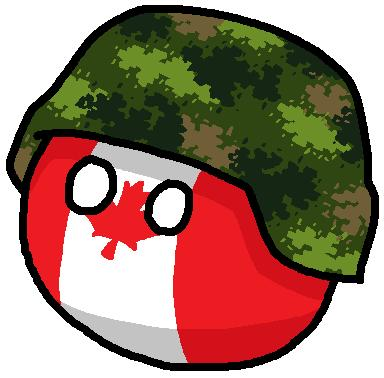

[1651/2000] 332616ea6c7b9f962a5bb7c328cbd4abf473e85e199b7bc7f0a1cfd05350b72a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/332616ea6c7b9f962a5bb7c328cbd4abf473e85e199b7bc7f0a1cfd05350b72a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/332616ea6c7b9f962a5bb7c328cbd4abf473e85e199b7bc7f0a1cfd05350b72a.gz'
Failed to load target image.
[1652/2000] e2e273bddc6a278aef3b00c43cedafa9ccfd9fbeb50e0f2bfdd0f586fc665db5



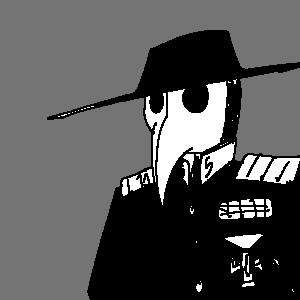

[1653/2000] 309e13d99240724c2abda1108855b7ce7f751a8c689aff68beb64329eb26bb00
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/309e13d99240724c2abda1108855b7ce7f751a8c689aff68beb64329eb26bb00.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/309e13d99240724c2abda1108855b7ce7f751a8c689aff68beb64329eb26bb00.gz'
Failed to load target image.
[1654/2000] 409750fdfbbd43b648340de25b402d7fa566f99b3eb4ab0c4a141212e49db2f1
[1655/2000] f065eb5f35ea0e131de9e6fdc2a3c94d90475123389e825907cf31ec83cd423d



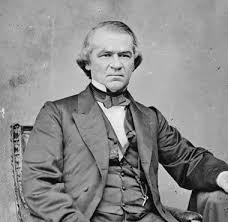

[1656/2000] f72b45436d3bf2441269a8f4b4553d74b03eb6b0c1ce9f4f4c5c5fa9c02aaa65
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f72b45436d3bf2441269a8f4b4553d74b03eb6b0c1ce9f4f4c5c5fa9c02aaa65.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f72b45436d3bf2441269a8f4b4553d74b03eb6b0c1ce9f4f4c5c5fa9c02aaa65.gz'
Failed to load target image.
[1657/2000] 5e89b2af0d109c2e22005eb6b2433e0bc0d296ac78bb94ce06009d4fd8fcb28a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5e89b2af0d109c2e22005eb6b2433e0bc0d296ac78bb94ce06009d4fd8fcb28a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5e89b2af0d109c2e22005eb6b2433e0bc0d296ac78bb94ce06009d4fd8fcb28a.gz'
Failed to load target image.
[1658/2000] dfb12028e32f10d4598a38ff1c471bd7c0acaa0278168433d0ce733f3fad3b2d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


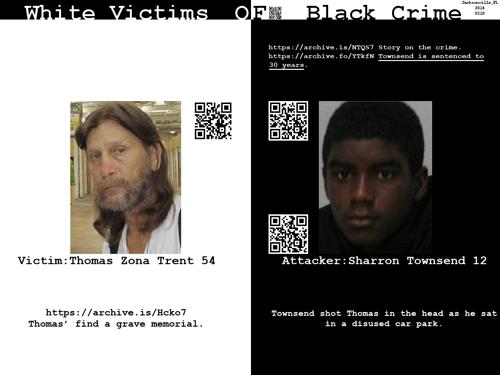

[1660/2000] 8fcde8eeec60cd5ce50b4bec5e13ce007ed74c0b0effc2611acbabd4cd84a18c
[1661/2000] f16259c7a334d5547469b9e3aa59bc6c7ba1b3598415d7aed5ee750e3f178145



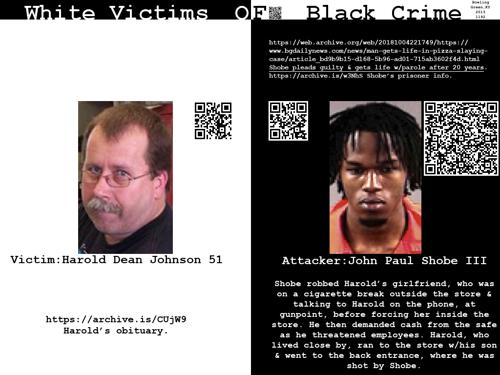

[1662/2000] e8830b5233dd5240ddbdb890ef9af7f803d537184e31d7926af5d5e06a2496d2
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e8830b5233dd5240ddbdb890ef9af7f803d537184e31d7926af5d5e06a2496d2.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e8830b5233dd5240ddbdb890ef9af7f803d537184e31d7926af5d5e06a2496d2.gz'
Failed to load target image.
[1663/2000] 5c9b0ff5a6e97cd7e87ceefe500fc9de1f09e2a39c6f04c9eccc943e80b9e929
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5c9b0ff5a6e97cd7e87ceefe500fc9de1f09e2a39c6f04c9eccc943e80b9e929.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5c9b0ff5a6e97cd7e87ceefe500fc9de1f09e2a39c6f04c9eccc943e80b9e929.gz'
Failed to load target image.
[1664/2000] 354eacf548be368da61aee4162da96ebc2ae1f40bd447fdcf696e9ed1d9dca5d



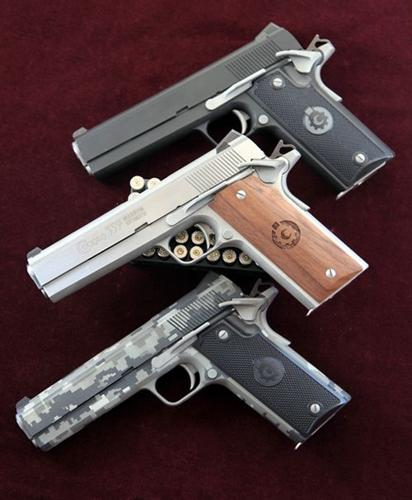

[1665/2000] c15df3f97a4d8b4962481eae9eede71c3e3a547d2f32dabe95c45acb5eb4a396
[1666/2000] 354c6ab948ec1e41a5ae73cc1a5f4c44a555bcc9e7d74bc70d4e0e65d430496a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/354c6ab948ec1e41a5ae73cc1a5f4c44a555bcc9e7d74bc70d4e0e65d430496a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/354c6ab948ec1e41a5ae73cc1a5f4c44a555bcc9e7d74bc70d4e0e65d430496a.gz'
Failed to load target image.
[1667/2000] 081ab4c849d03ab05749d90512216792338221419f2a8c4156a58698c92cfa52
[1668/2000] 1ab05aea23309cd5270e8f74628a2172fea1c4eb47921011e996b569c3e1d059



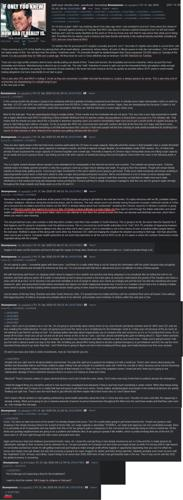

[1669/2000] 501575848ed2454bdb09ebe766bd36946004800619437b80d7c28c8ce4ffd3e8



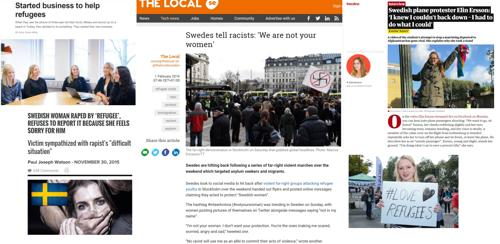

[1670/2000] f45b58a851cc84c5a6500ee1b10cb35363b2e9b83b3cb5a0933ffc57cb74be5b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f45b58a851cc84c5a6500ee1b10cb35363b2e9b83b3cb5a0933ffc57cb74be5b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f45b58a851cc84c5a6500ee1b10cb35363b2e9b83b3cb5a0933ffc57cb74be5b.gz'
Failed to load target image.
[1671/2000] 2bcdabfd0e39a2923c570a636fdc0bb1ae983ba57b5c401ad587324e2b0e317a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2bcdabfd0e39a2923c570a636fdc0bb1ae983ba57b5c401ad587324e2b0e317a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2bcdabfd0e39a2923c570a636fdc0bb1ae983ba57b5c401ad587324e2b0e317a.gz'
Failed to load target image.
[1672/2000] 890861b095f542db5edd869258111d5967a5a94dcbcdea7d5f9f79601760342c



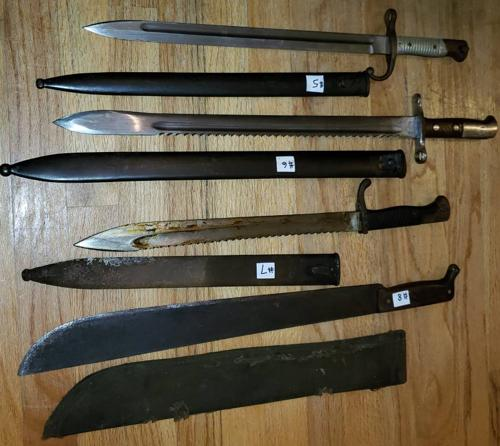

[1673/2000] b188fec837a66a1710fb68d814c6f6d03c8a0b05f8faf8513df71b7281ace0c2
[1674/2000] f227840f0a86af122d494f3e64b247408c64238e1466a315cb90b872db90eb85
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f227840f0a86af122d494f3e64b247408c64238e1466a315cb90b872db90eb85.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f227840f0a86af122d494f3e64b247408c64238e1466a315cb90b872db90eb85.gz'
Failed to load target image.
[1675/2000] 28b35d6c084e9ef4baea94808cc19d326d7e4db05f292010dbdf33b8357f3a7f



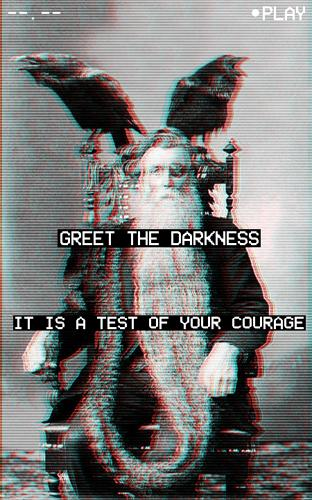

[1676/2000] fc9e9d0714f75131ccca92a774768db9e1fbba31fa079f9496ee3cb33375f42d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fc9e9d0714f75131ccca92a774768db9e1fbba31fa079f9496ee3cb33375f42d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/fc9e9d0714f75131ccca92a774768db9e1fbba31fa079f9496ee3cb33375f42d.gz'
Failed to load target image.
[1677/2000] 299b8d39489402350d5c9cf73cb4a21376c3d07ea05bfccd88ce3766fbd6ba87
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/299b8d39489402350d5c9cf73cb4a21376c3d07ea05bfccd88ce3766fbd6ba87.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/299b8d39489402350d5c9cf73cb4a21376c3d07ea05bfccd88ce3766fbd6ba87.gz'
Failed to load target image.
[1678/2000] 05758172b901a4d4108eb957114e6bf5dbac115fd52b1617fb8ad4f39c060cd2



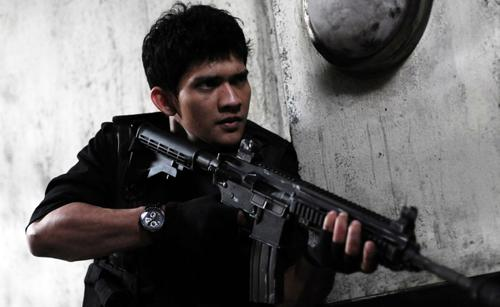

[1679/2000] 8e1efa402b4f128bb14a423fc8c685f6ea92f664bf2ed5031dcd81ae577c5e99



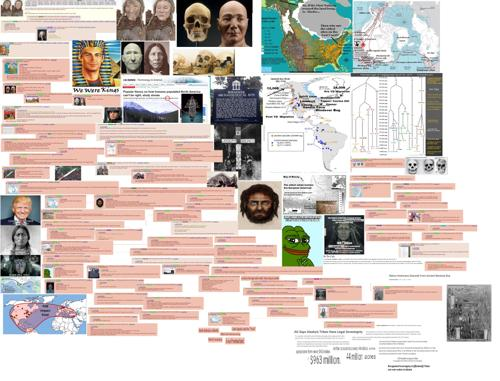

[1680/2000] a587f210a10acb321aad6d75d9020387214ea19af749f42c27ccb75cb1a9c1af
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a587f210a10acb321aad6d75d9020387214ea19af749f42c27ccb75cb1a9c1af.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a587f210a10acb321aad6d75d9020387214ea19af749f42c27ccb75cb1a9c1af.gz'
Failed to load target image.
[1681/2000] 96765804e61f8be988ae81685ed4c906ed06fab016673f399898b4d03be53527



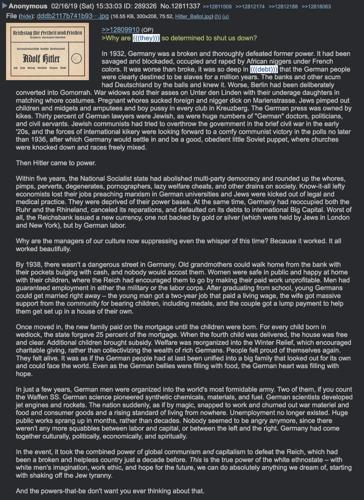

[1682/2000] b548a0eae804b3276d2d8869a18fe3c7c545c6688c0efeca5f1b13008499576a



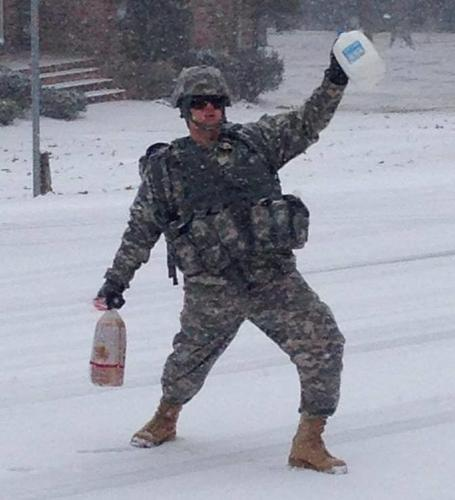

[1683/2000] 8d27ea76733d61237e40d90900475a105a442ad358d7c22661989198adee999c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8d27ea76733d61237e40d90900475a105a442ad358d7c22661989198adee999c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8d27ea76733d61237e40d90900475a105a442ad358d7c22661989198adee999c.gz'
Failed to load target image.
[1684/2000] 72b24693af02c7223801de6a5ac6f82477aedb1d6415df4ff76112a044d6670f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/72b24693af02c7223801de6a5ac6f82477aedb1d6415df4ff76112a044d6670f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/72b24693af02c7223801de6a5ac6f82477aedb1d6415df4ff76112a044d6670f.gz'
Failed to load target image.
[1685/2000] 89375b23c1aac3089a5743764c4db91f825e5e8e45563e5796ae3b08ae655666
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


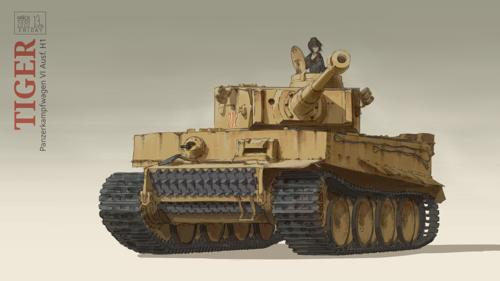

[1704/2000] 3b522bacbc5571333c4cd45db9e3c67cb44326fe15a5eb5be27a8d51a7175a65
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3b522bacbc5571333c4cd45db9e3c67cb44326fe15a5eb5be27a8d51a7175a65.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3b522bacbc5571333c4cd45db9e3c67cb44326fe15a5eb5be27a8d51a7175a65.gz'
Failed to load target image.
[1705/2000] 77d8961b7a241713ecd75db43cf533826ad7e944f6a09cb110558d3731282449
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/77d8961b7a241713ecd75db43cf533826ad7e944f6a09cb110558d3731282449.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/77d8961b7a241713ecd75db43cf533826ad7e944f6a09cb110558d3731282449.gz'
Failed to load target image.
[1706/2000] 15c3c662211a1091c3bc837c0da98f6d5e85705b8d6f3912be02eb8dc2a0d1da
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


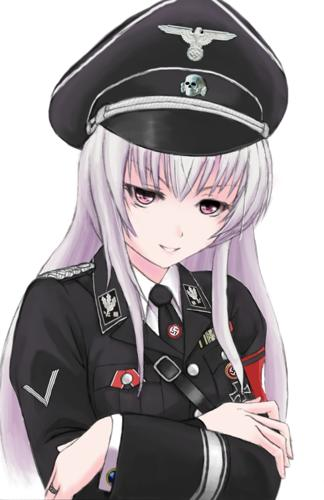

[1709/2000] df51e0860be177daf76bb64d6999da4f5f2d9519717826b4cb98549c371cf87a
[1710/2000] 0ea483dbff4972ea8c50d01d78e21e183619559d065a4ff81bdaa50dc8725e51
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0ea483dbff4972ea8c50d01d78e21e183619559d065a4ff81bdaa50dc8725e51.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0ea483dbff4972ea8c50d01d78e21e183619559d065a4ff81bdaa50dc8725e51.gz'
Failed to load target image.
[1711/2000] 7a3319834482159ccc87f945431266f665d0ee418f31291a5a106871b1ad1b55
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7a3319834482159ccc87f945431266f665d0ee418f31291a5a106871b1ad1b55.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7a3319834482159ccc87f945431266f665d0ee418f31291a5a106871b1ad1b55.gz'
Failed to load target image.
[1712/2000] 53da99b7946754d6f2f2db43f579aea0d718e78e872d8f5


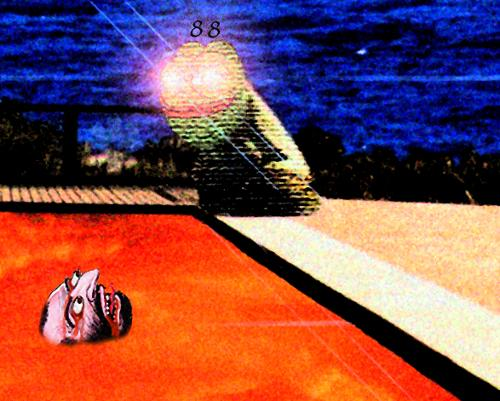

[1718/2000] efb367aaa5ccd91e3fdb3236003fb7f56215ee9ce7d6ba81a5da8474e6395ef0
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/efb367aaa5ccd91e3fdb3236003fb7f56215ee9ce7d6ba81a5da8474e6395ef0.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/efb367aaa5ccd91e3fdb3236003fb7f56215ee9ce7d6ba81a5da8474e6395ef0.gz'
Failed to load target image.
[1719/2000] d05502877416698ce16db2b16672c58ac73c07811668504072ff85e939805673
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d05502877416698ce16db2b16672c58ac73c07811668504072ff85e939805673.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d05502877416698ce16db2b16672c58ac73c07811668504072ff85e939805673.gz'
Failed to load target image.
[1720/2000] 75d5ee1864c482c763b485f83814dc5d6db63912a28275b2851e6b338286ba6a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


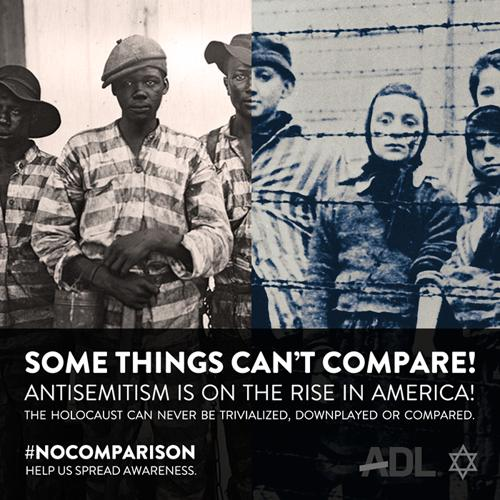

[1725/2000] 29ea2c4d8728e7e0569a214ebb26762dc4b7bffaf328c3c4cf78f253a0bddc60



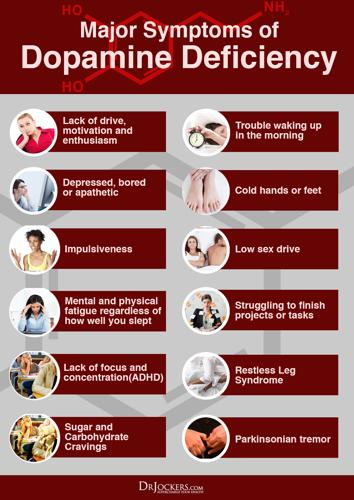

[1726/2000] 3c40d2e0f2744d73d64cda8e32b86eece6b3df24f7aafe3dae5992bc1620760f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3c40d2e0f2744d73d64cda8e32b86eece6b3df24f7aafe3dae5992bc1620760f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3c40d2e0f2744d73d64cda8e32b86eece6b3df24f7aafe3dae5992bc1620760f.gz'
Failed to load target image.
[1727/2000] 135bbfa8bcfdbe40309bf3a04637dc27497b43ac3fbd1441f9e24104ec468948



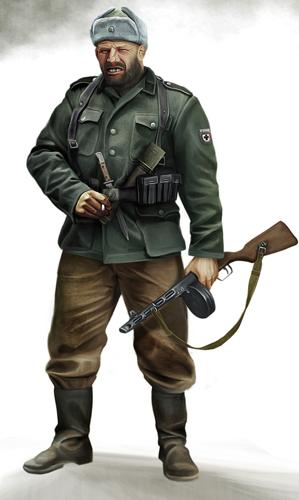

[1728/2000] a4ecc922a2bf708413c16631238597d6a989f22c9a72d5bae59230562660ef92
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a4ecc922a2bf708413c16631238597d6a989f22c9a72d5bae59230562660ef92.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a4ecc922a2bf708413c16631238597d6a989f22c9a72d5bae59230562660ef92.gz'
Failed to load target image.
[1729/2000] 53ccfd037b5cd74772e740c7395c013accdd432cbe688a91b07379e791977c6d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/53ccfd037b5cd74772e740c7395c013accdd432cbe688a91b07379e791977c6d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/53ccfd037b5cd74772e740c7395c013accdd432cbe688a91b07379e791977c6d.gz'
Failed to load target image.
[1730/2000] a74769490ab36211663887d86f30ba1d54f40831066061fae6f3288b231efd30
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


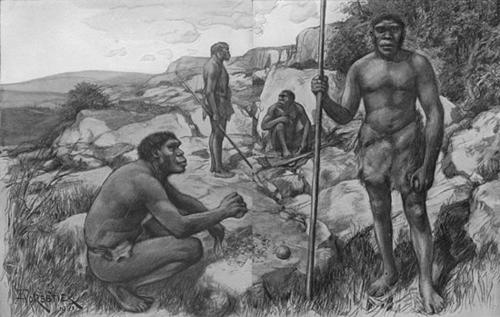

[1732/2000] d7cccc3cebf50f6fa3a92705286ad99fa0a1f4c8d0834cf44978988ad9aaf1d8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d7cccc3cebf50f6fa3a92705286ad99fa0a1f4c8d0834cf44978988ad9aaf1d8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d7cccc3cebf50f6fa3a92705286ad99fa0a1f4c8d0834cf44978988ad9aaf1d8.gz'
Failed to load target image.
[1733/2000] 0dd624077ba91c832e813eaa45aa0ed2438df518edd1aa4c33e87d9b0b634316
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0dd624077ba91c832e813eaa45aa0ed2438df518edd1aa4c33e87d9b0b634316.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0dd624077ba91c832e813eaa45aa0ed2438df518edd1aa4c33e87d9b0b634316.gz'
Failed to load target image.
[1734/2000] 55c532e8f7a6799c143801921684123e8a788d4bdfc49bc36c9d25be2c2281fa
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


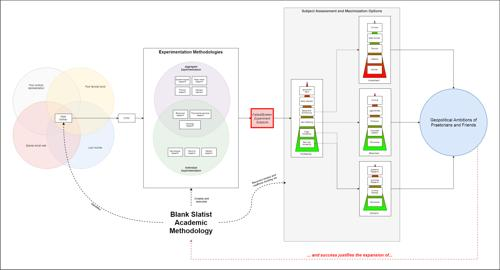

[1736/2000] 6675c6498df90767628f6fa5b70729336e6e80b5d57592832a23313982ec26b8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6675c6498df90767628f6fa5b70729336e6e80b5d57592832a23313982ec26b8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6675c6498df90767628f6fa5b70729336e6e80b5d57592832a23313982ec26b8.gz'
Failed to load target image.
[1737/2000] 05d637c900b7d73805a76410295b332356d7bd7c9a4e9538397392217ef032c6
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/05d637c900b7d73805a76410295b332356d7bd7c9a4e9538397392217ef032c6.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/05d637c900b7d73805a76410295b332356d7bd7c9a4e9538397392217ef032c6.gz'
Failed to load target image.
[1738/2000] 7bc83cb8acc022d5067edde3f19e30996072032e77752ffc863ea4bc82b7dce3
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


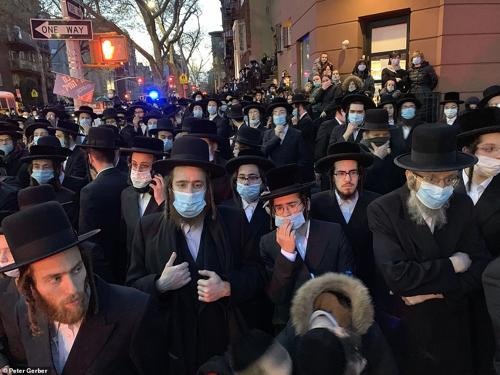

[1740/2000] b91b21575fec3aaef97e6283955214224a0fd08ace9c7cf4e16229a34a5c5d32
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b91b21575fec3aaef97e6283955214224a0fd08ace9c7cf4e16229a34a5c5d32.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b91b21575fec3aaef97e6283955214224a0fd08ace9c7cf4e16229a34a5c5d32.gz'
Failed to load target image.
[1741/2000] eed3e7b5217dbb57572ce402cb07b2e886a5c2ed79f07a6d829ec07a80c107c1
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/eed3e7b5217dbb57572ce402cb07b2e886a5c2ed79f07a6d829ec07a80c107c1.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/eed3e7b5217dbb57572ce402cb07b2e886a5c2ed79f07a6d829ec07a80c107c1.gz'
Failed to load target image.
[1742/2000] 8a0a46a6890a1608fbb1c1f430dcb88726377d14b9969f78642e6c5965d19a22
[1743/2000] 56525d835c0e88739324cd65df155c80d05fe4c60e28dc9


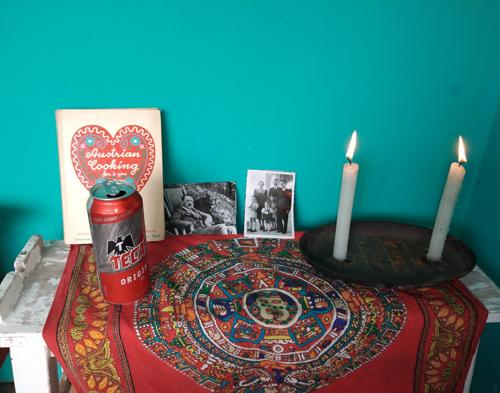

[1746/2000] d71e80a1db8811c32701a08ee442aacb547040bc1ab53f8d705afa5216e36a4f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d71e80a1db8811c32701a08ee442aacb547040bc1ab53f8d705afa5216e36a4f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d71e80a1db8811c32701a08ee442aacb547040bc1ab53f8d705afa5216e36a4f.gz'
Failed to load target image.
[1747/2000] 1364e7c7f7cdff5f9731fb2ff7eec7a142d85d44a9bfc2b4763c6e30a6059b45
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1364e7c7f7cdff5f9731fb2ff7eec7a142d85d44a9bfc2b4763c6e30a6059b45.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1364e7c7f7cdff5f9731fb2ff7eec7a142d85d44a9bfc2b4763c6e30a6059b45.gz'
Failed to load target image.
[1748/2000] 033bb9484845fa6f590211995c955738872107838586b2b67a8c6a4dfe467902
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


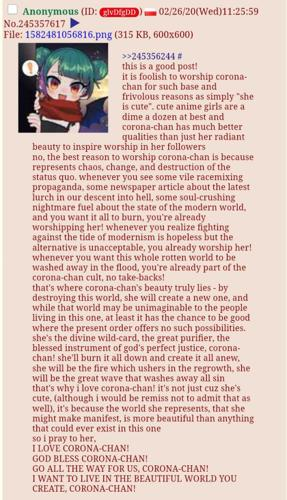

[1759/2000] 860dda867515b4a5ccc641189f74ab0bba80b9d37b8d9929f7fcb5364d49064a
[1760/2000] 27d811da6be10429b8c567cd79854d47483c18a5ab54c793ea38fe6a32c4aeb3
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/27d811da6be10429b8c567cd79854d47483c18a5ab54c793ea38fe6a32c4aeb3.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/27d811da6be10429b8c567cd79854d47483c18a5ab54c793ea38fe6a32c4aeb3.gz'
Failed to load target image.
[1761/2000] 1e2a11d4474c17bb200ac577ec8f261e099d4d8d478baa88ceba26d55975b19e
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1e2a11d4474c17bb200ac577ec8f261e099d4d8d478baa88ceba26d55975b19e.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1e2a11d4474c17bb200ac577ec8f261e099d4d8d478baa88ceba26d55975b19e.gz'
Failed to load target image.
[1762/2000] 67df6c2ced1f0b23e37666cc41e69845cdf3ebb3b53078e


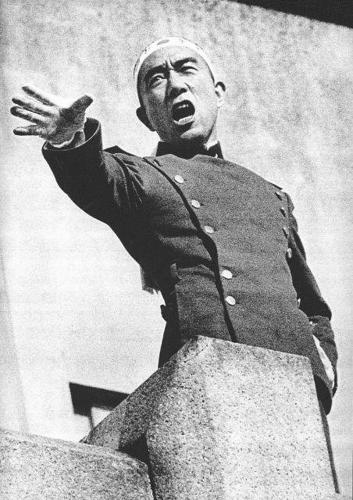

[1773/2000] 7bff3474205225bcd5f3124e3f2363e427b2fc5bbb1abae0c59c03d9eafcb1ba
[1774/2000] c5c949e08760e61b20dd25ec94aeb6ea1243beedf0a87b6bf5b73ca82ded879d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c5c949e08760e61b20dd25ec94aeb6ea1243beedf0a87b6bf5b73ca82ded879d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c5c949e08760e61b20dd25ec94aeb6ea1243beedf0a87b6bf5b73ca82ded879d.gz'
Failed to load target image.
[1775/2000] 9411fd42070f03eb34e689ac173526c0231b26626ed297e8a4c3c3c70e9b68a8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9411fd42070f03eb34e689ac173526c0231b26626ed297e8a4c3c3c70e9b68a8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/9411fd42070f03eb34e689ac173526c0231b26626ed297e8a4c3c3c70e9b68a8.gz'
Failed to load target image.
[1776/2000] d5349bb1ca140147cfeec63973f8c31dce6a908bb9e8468


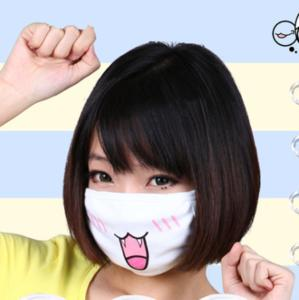

[1784/2000] ecf83fc1758bb29e3b59c5cf1ee52ab5ad350a21887b99845698e6561cedf7a9
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ecf83fc1758bb29e3b59c5cf1ee52ab5ad350a21887b99845698e6561cedf7a9.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ecf83fc1758bb29e3b59c5cf1ee52ab5ad350a21887b99845698e6561cedf7a9.gz'
Failed to load target image.
[1785/2000] 3435f3c3e16bcd7c9efb3d25ec71a4336e1a6c2c9c3edc4273fd2b162a2b5c8e



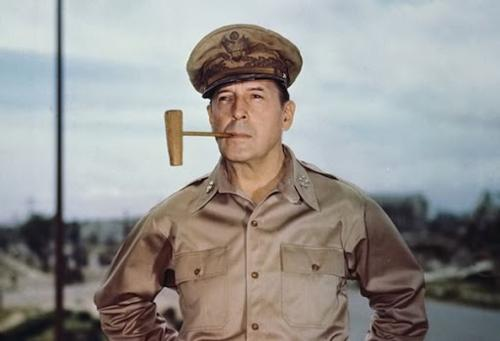

[1786/2000] 98716fbb0b57ed7d05a3596a14d9cb8a1b9c6571e6de1de3f56e9261cffff8c6
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/98716fbb0b57ed7d05a3596a14d9cb8a1b9c6571e6de1de3f56e9261cffff8c6.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/98716fbb0b57ed7d05a3596a14d9cb8a1b9c6571e6de1de3f56e9261cffff8c6.gz'
Failed to load target image.
[1787/2000] 6293499772bed2a860b6782d49bfe357e92db51ea6c5df6d72ac9930429fd812
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6293499772bed2a860b6782d49bfe357e92db51ea6c5df6d72ac9930429fd812.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6293499772bed2a860b6782d49bfe357e92db51ea6c5df6d72ac9930429fd812.gz'
Failed to load target image.
[1788/2000] 42811217ed9931da779fb45abfc3804c04e745096522bac608c9196b1de09846
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


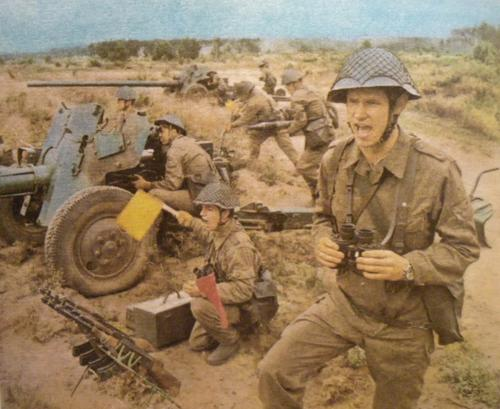

[1790/2000] b26724dbca0e0401b75a8fc9257c5e0635bcf81e71cc98fe2a4db16b25319822
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b26724dbca0e0401b75a8fc9257c5e0635bcf81e71cc98fe2a4db16b25319822.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b26724dbca0e0401b75a8fc9257c5e0635bcf81e71cc98fe2a4db16b25319822.gz'
Failed to load target image.
[1791/2000] 049973fd5929dea0ebb4257ae5e2eab73dff0e880b7a91c81d68ca29f7c8372a



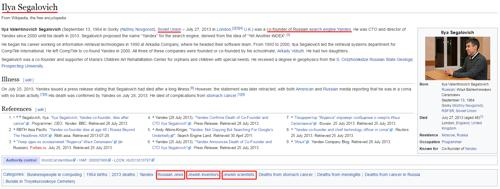

[1792/2000] e30c1097f4ee0c41de79d1576644349e3bd6c2a52de005e3ed34fd90acf6cb9c



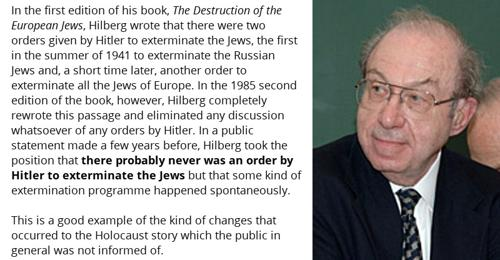

[1793/2000] 520c1b72ea92879056f1d8db05755e398d5d4ce3fe48d1069d546fa78ca7cc2a



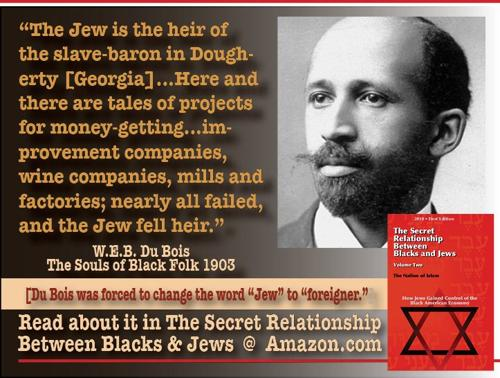

[1794/2000] 6db19f1afdd63a108b492421bf5b27ab1a3cb1133d426a31a7b91a024a7731cb
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6db19f1afdd63a108b492421bf5b27ab1a3cb1133d426a31a7b91a024a7731cb.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6db19f1afdd63a108b492421bf5b27ab1a3cb1133d426a31a7b91a024a7731cb.gz'
Failed to load target image.
[1795/2000] cfe5e8629e8b407d67651709ac0cf5171d9fdc0513c9a73e0b35ca02dcae6981
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cfe5e8629e8b407d67651709ac0cf5171d9fdc0513c9a73e0b35ca02dcae6981.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/cfe5e8629e8b407d67651709ac0cf5171d9fdc0513c9a73e0b35ca02dcae6981.gz'
Failed to load target image.
[1796/2000] dd9b1d3810aa625cecfa963eb01e2593d6b2364be130fd696b8f98ab2d900078



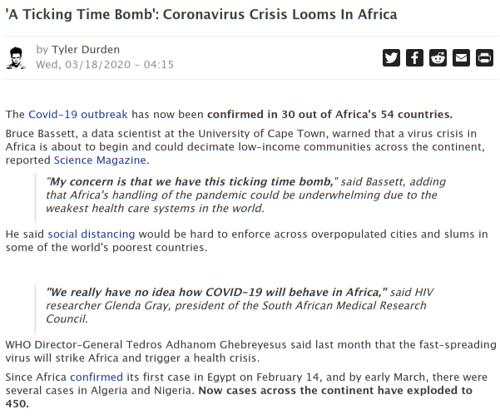

[1797/2000] 2cf2ff0494a893f4264ebae0ff0b67e546fd5f749e476bb9cea9742321f3fcb6



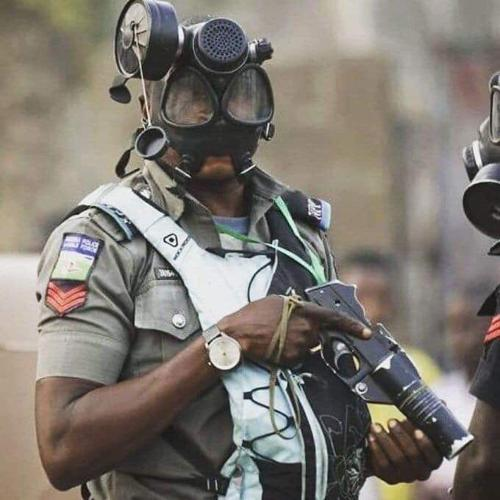

[1798/2000] 3798dc84b25258a24f73c6f02fb35feb92c27f5d35c2e8c15f15cd775ba2ab86
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3798dc84b25258a24f73c6f02fb35feb92c27f5d35c2e8c15f15cd775ba2ab86.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/3798dc84b25258a24f73c6f02fb35feb92c27f5d35c2e8c15f15cd775ba2ab86.gz'
Failed to load target image.
[1799/2000] cdf363fa537de2919e35d7fa3c1fe5e130948193ff805ca8732c7a9a596cd708



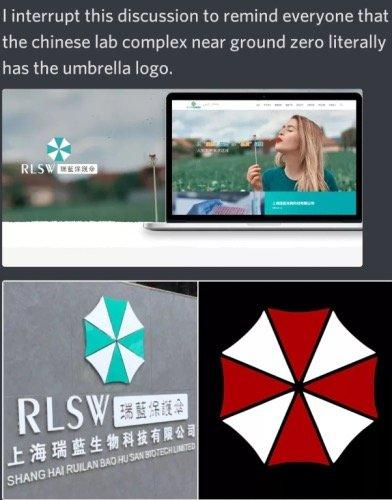

[1800/2000] 48c35cfcca78716bd6aacf170f2efc9abd8296bbfefaf2ff4e788d90ca96fbcf
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/48c35cfcca78716bd6aacf170f2efc9abd8296bbfefaf2ff4e788d90ca96fbcf.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/48c35cfcca78716bd6aacf170f2efc9abd8296bbfefaf2ff4e788d90ca96fbcf.gz'
Failed to load target image.
[1801/2000] efdeb041bb2b6eff1d1747b89cf222d54e7592d8f9bc9cd64f8d36cb8f119145
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/efdeb041bb2b6eff1d1747b89cf222d54e7592d8f9bc9cd64f8d36cb8f119145.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/efdeb041bb2b6eff1d1747b89cf222d54e7592d8f9bc9cd64f8d36cb8f119145.gz'
Failed to load target image.
[1802/2000] e61d110767490c8a5f3b8f35b9d3d5c55f7854ee77e4d084dad8ae2dc15539ec
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


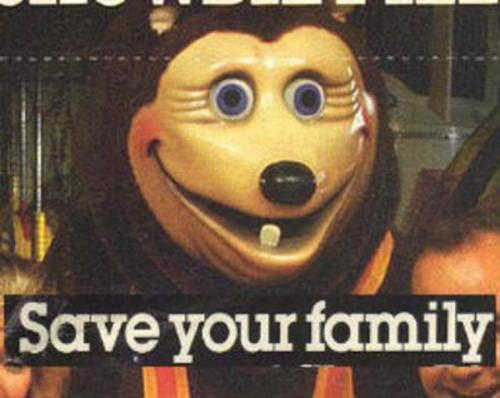

[1808/2000] 6a035519683cb71af6f71ac9009584409d31a2d846b71960da2aacd8b678d27c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6a035519683cb71af6f71ac9009584409d31a2d846b71960da2aacd8b678d27c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6a035519683cb71af6f71ac9009584409d31a2d846b71960da2aacd8b678d27c.gz'
Failed to load target image.
[1809/2000] 215f67f32acc291561ff5f1ba90e10c54435d603edc54e4dceacf46fa554f8d8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/215f67f32acc291561ff5f1ba90e10c54435d603edc54e4dceacf46fa554f8d8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/215f67f32acc291561ff5f1ba90e10c54435d603edc54e4dceacf46fa554f8d8.gz'
Failed to load target image.
[1810/2000] 1bbd5441f2edba7083c36e784c25bcb977c482003cfa0ab049d7ff4c4617d0b3
[1811/2000] 09b7dd80f27647c3c355ab8c35a9283c7c1e5cf56dac693


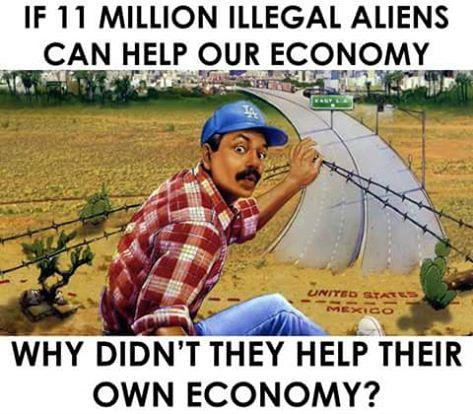

[1812/2000] 0c58c35852bb6b0de48ea3aee3f12424171b1582b1537033dc60662d9dee7c0c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0c58c35852bb6b0de48ea3aee3f12424171b1582b1537033dc60662d9dee7c0c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/0c58c35852bb6b0de48ea3aee3f12424171b1582b1537033dc60662d9dee7c0c.gz'
Failed to load target image.
[1813/2000] 8a6ce61d36b7dc88413de72c73df977160e4c416f0b6a58fd72a1193688f47fb
[1814/2000] 749ec36809801ec259ee7535695b8987d39d75e8460e2a24d1082b4c30ae1f06
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/749ec36809801ec259ee7535695b8987d39d75e8460e2a24d1082b4c30ae1f06.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/749ec36809801ec259ee7535695b8987d39d75e8460e2a24d1082b4c30ae1f06.gz'
Failed to load target image.
[1815/2000] deab1854aa54f07a8af568d7d492a6c1eee64ab2e312f30


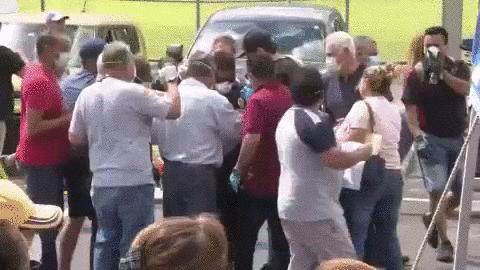

[1820/2000] 1f7db66659eeb141a72b842f20f00c5029cb855014e9578f02ef221c2461c688



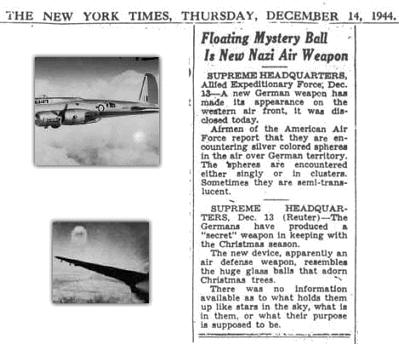

[1821/2000] 71808e502020efcf6c3b7ad8ff5f4522738a3e7c85958e6c9343ce3b7cd5ef3d
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/71808e502020efcf6c3b7ad8ff5f4522738a3e7c85958e6c9343ce3b7cd5ef3d.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/71808e502020efcf6c3b7ad8ff5f4522738a3e7c85958e6c9343ce3b7cd5ef3d.gz'
Failed to load target image.
[1822/2000] 1b97a1426ed9e3817dc1cef2e8673c3cabc0ed28dd6e9966a9e7514065551303
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1b97a1426ed9e3817dc1cef2e8673c3cabc0ed28dd6e9966a9e7514065551303.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/1b97a1426ed9e3817dc1cef2e8673c3cabc0ed28dd6e9966a9e7514065551303.gz'
Failed to load target image.
[1823/2000] 557d16dd1caf29b746be8b00d5594ebcffe2f2c9a78deeb947c77ff68c3ddf11



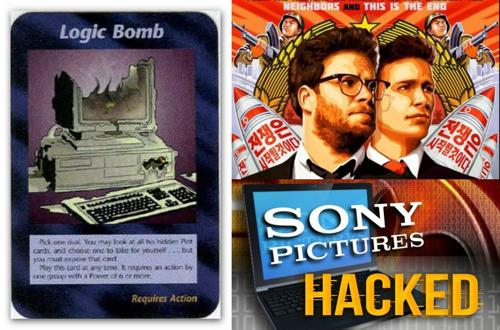

[1824/2000] 6fa50a98163ae8395de9c618e221886ff45e3a4e734b0460711e8170a8d8c276
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6fa50a98163ae8395de9c618e221886ff45e3a4e734b0460711e8170a8d8c276.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/6fa50a98163ae8395de9c618e221886ff45e3a4e734b0460711e8170a8d8c276.gz'
Failed to load target image.
[1825/2000] 0d638c1082ffe23daab719b02b0c836858c0094f85ec80561a0e3b33cc56293d



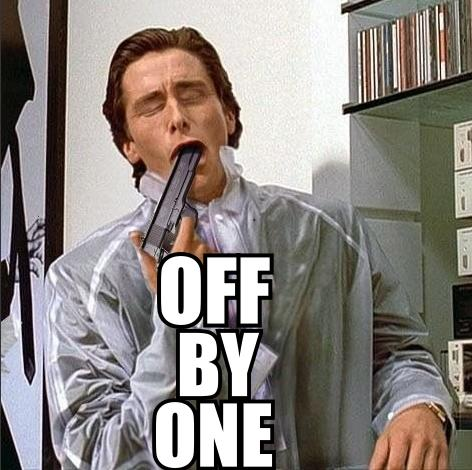

[1826/2000] af826e8ff150bdaf52338ca4162f4d45daebd27ea24c17658c57a073edeb8673


[1827/2000] 290f5bfd68c2a94111e9eb5e090cf5ef75fd9723f6bfa88a3cb45c618a9c9ea2



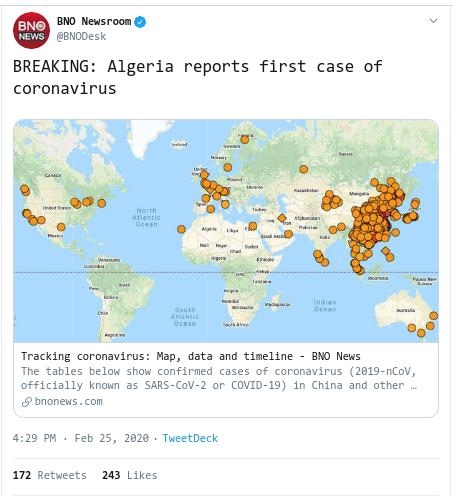

[1828/2000] d3af6c734cd4f1d8b333403c5a4a2e93942a0f7b9b2e0f017e29f9710d36fa1f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d3af6c734cd4f1d8b333403c5a4a2e93942a0f7b9b2e0f017e29f9710d36fa1f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d3af6c734cd4f1d8b333403c5a4a2e93942a0f7b9b2e0f017e29f9710d36fa1f.gz'
Failed to load target image.
[1829/2000] 75b5285ca7924ada0ba1aa25f2cde9dc596d50d563810a95105d7f98e33ed4af
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/75b5285ca7924ada0ba1aa25f2cde9dc596d50d563810a95105d7f98e33ed4af.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/75b5285ca7924ada0ba1aa25f2cde9dc596d50d563810a95105d7f98e33ed4af.gz'
Failed to load target image.
[1830/2000] 2ac9c42c654fe43922b7c1f55ccd70660d430619d40b5d863943da3612325631
[1831/2000] 454a36fdfb7246e34cb9486a9e46e5236dc329a8301738c


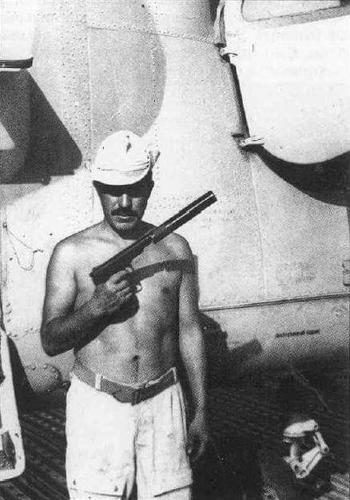

[1838/2000] ee5f2743287cec702669930562190d1ecd5d946ec83a9e406e107557eb8f76e0



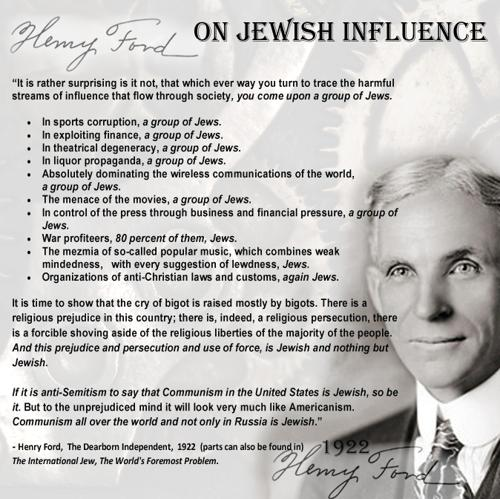

[1839/2000] f2600166507802d1cfc887c8bbd644e4c971a00f239b2b543794155b7f4d9306
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f2600166507802d1cfc887c8bbd644e4c971a00f239b2b543794155b7f4d9306.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f2600166507802d1cfc887c8bbd644e4c971a00f239b2b543794155b7f4d9306.gz'
Failed to load target image.
[1840/2000] 6f218af829fcfcaf15059bcdc2706c66fb46f83a49463794250ea1795ada9123
[1841/2000] bee1ae7f87a8424f6d8e07165d68ac2db5e910d5f3f4df880e06cb85ab8ce288
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bee1ae7f87a8424f6d8e07165d68ac2db5e910d5f3f4df880e06cb85ab8ce288.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bee1ae7f87a8424f6d8e07165d68ac2db5e910d5f3f4df880e06cb85ab8ce288.gz'
Failed to load target image.
[1842/2000] f1af339a28dc5d1c1577eaef1821a3ca7a1c1eaa915a12c


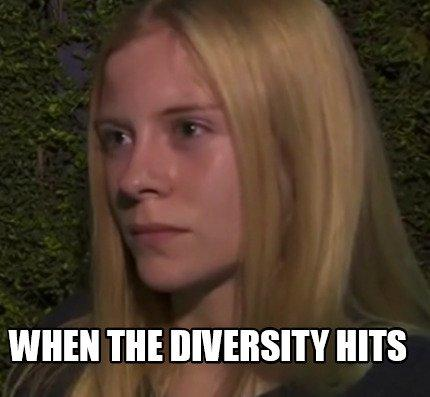

[1846/2000] a981ad3cf3eabea902f81444c93450d4cf1693244440682e673219ff1fd6c555



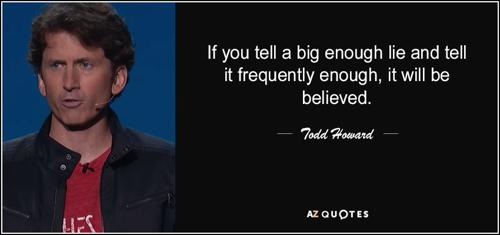

[1847/2000] 48c2e42d44148ed3bfe77299146fce76484ea016bdf6f60d1b7475b7c754ef20
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/48c2e42d44148ed3bfe77299146fce76484ea016bdf6f60d1b7475b7c754ef20.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/48c2e42d44148ed3bfe77299146fce76484ea016bdf6f60d1b7475b7c754ef20.gz'
Failed to load target image.
[1848/2000] a888b395000a654196feceff0825fb3f5b7f5d03a12fecf7dc67065ce13c7f02
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a888b395000a654196feceff0825fb3f5b7f5d03a12fecf7dc67065ce13c7f02.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a888b395000a654196feceff0825fb3f5b7f5d03a12fecf7dc67065ce13c7f02.gz'
Failed to load target image.
[1849/2000] 0477950769198cb7d4ee8fd4a0904b797d6e0037b7cbba4cb457e3f888e9b833
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


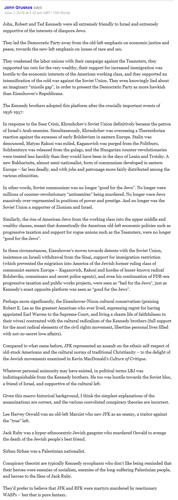

[1855/2000] ed7990ee024b268ae51e90b4d133b51c769c87fb3a5339267b32c01da599db4e



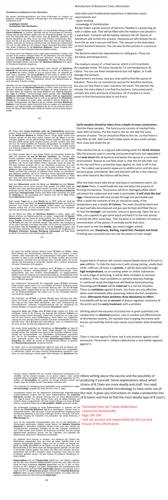

[1856/2000] 7c6c38466a18f55c2182f8f7ca17fed9a970344ce1af83a099f444dca720b957
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7c6c38466a18f55c2182f8f7ca17fed9a970344ce1af83a099f444dca720b957.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7c6c38466a18f55c2182f8f7ca17fed9a970344ce1af83a099f444dca720b957.gz'
Failed to load target image.
[1857/2000] f4b4e227e9d96b6c121702512e8aa764c5ebce2ba991a5d47f33afe4c98432f7



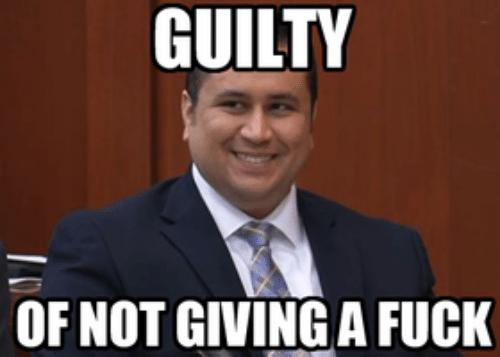

[1858/2000] 5d9ecce7dcdc8ccfe6e3202c480a8943e61d77b62c2c54f9c50d1b735cd6c244
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5d9ecce7dcdc8ccfe6e3202c480a8943e61d77b62c2c54f9c50d1b735cd6c244.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5d9ecce7dcdc8ccfe6e3202c480a8943e61d77b62c2c54f9c50d1b735cd6c244.gz'
Failed to load target image.
[1859/2000] 70a1a8d77b6ad523acef43cd4dbcd35d265772459cba6631b3e68a4a5256048c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/70a1a8d77b6ad523acef43cd4dbcd35d265772459cba6631b3e68a4a5256048c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/70a1a8d77b6ad523acef43cd4dbcd35d265772459cba6631b3e68a4a5256048c.gz'
Failed to load target image.
[1860/2000] 62e132ae487f139626c55eebd86a582174bab9a1a32a0b1effae01cb2200101b
[1861/2000] 3d75abfc72850bf32be1878d62ea70c3958347e6d1781d1


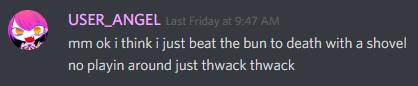

[1862/2000] 88230c81ed414a5e3d4cc82ccc1451d2ac140bc4411505f6eb5685fb501554b6
[1863/2000] 634fedb422f33340ccc36d60d39613ca69400d801de3ba7ba9d787b8b817ea27
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/634fedb422f33340ccc36d60d39613ca69400d801de3ba7ba9d787b8b817ea27.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/634fedb422f33340ccc36d60d39613ca69400d801de3ba7ba9d787b8b817ea27.gz'
Failed to load target image.
[1864/2000] 58f62e55ba5020d62e819ac3339d3c056f6f00e088a473320f07e195cd76a0bf
[1865/2000] af8b512ed2f5355ad53ca1214672fc8860fc089d71e6f477cd5d40b90ef0743e
[1866/2000] 97055ff0098fcaaee17016357c45b8c3d475b502113d73c25445856e837b0b0b
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/97055ff0098fcaaee17016357c45b8c3d475b502113d73c25445856e837b0b0b.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/970


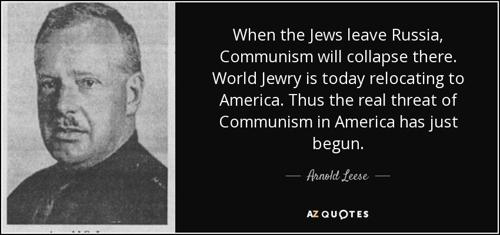

[1868/2000] 50f9e141a96b84ecf7d93194862b517ebc730066af4ad0a916629f8632e74942
[1869/2000] 4713bc04565d8225588b6fdec9ad564dac5df188954db15b824c7b3bd2431830
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4713bc04565d8225588b6fdec9ad564dac5df188954db15b824c7b3bd2431830.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4713bc04565d8225588b6fdec9ad564dac5df188954db15b824c7b3bd2431830.gz'
Failed to load target image.
[1870/2000] 77b4c633165ff82beb4c066c6f9b9efef2af7a739b7e39623a09e9a24178f550



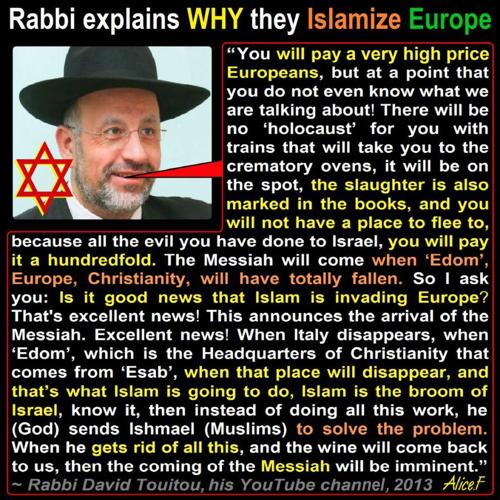

[1871/2000] 4d0d72e1705d50410b9b31c3fa1a03fbcbbf8f467a8c805626412b844c81159a
[1872/2000] 5ec0b0165a01bec3af9b4c4f7e6a657abb96d5b852301b725d1090eb4eeb76b3
[1873/2000] 05e7d0ed23cac3dd3b96f459eae0a058b7637da04a606d14e1b79ee2516e75fe
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/05e7d0ed23cac3dd3b96f459eae0a058b7637da04a606d14e1b79ee2516e75fe.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/05e7d0ed23cac3dd3b96f459eae0a058b7637da04a606d14e1b79ee2516e75fe.gz'
Failed to load target image.
[1874/2000] 6f15b995f1f0db1468bd5cbeca295408b8c12a668fb000f6fac8ca8c968acd11
[1875/2000] ff99d3b7bfdcb8c7f31998d4ea8e329bf04d2d1bd73bfc7deb3114d33e4d4907
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ff99d3b7bfdcb8c7f31998d4ea8e329bf04d2d1bd73bfc7deb3114d33e4d4907.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/ff9


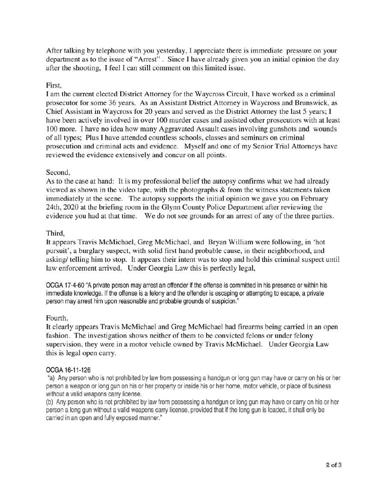

[1878/2000] 5d52ef084df2d4c1945b27f9bbd84a71918f2f833196e6701ab2e49d7f446232
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5d52ef084df2d4c1945b27f9bbd84a71918f2f833196e6701ab2e49d7f446232.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5d52ef084df2d4c1945b27f9bbd84a71918f2f833196e6701ab2e49d7f446232.gz'
Failed to load target image.
[1879/2000] a583b72e6a64c9a91abbd54c8b71bfa585cf3cd19697ff8a7b1ec0f30107aa15
[1880/2000] 07cd02433c24527ada45bff62907e8de85fdd10be030c07447797ade46c57569
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/07cd02433c24527ada45bff62907e8de85fdd10be030c07447797ade46c57569.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/07cd02433c24527ada45bff62907e8de85fdd10be030c07447797ade46c57569.gz'
Failed to load target image.
[1881/2000] 3977e218c145a5e560e76f05b2689cc486ec87fc63dce8d

[1888/2000] 43794b7ac70996142b2cf95ec052587ae24dd2b98127b43303bbbcb163104471
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/43794b7ac70996142b2cf95ec052587ae24dd2b98127b43303bbbcb163104471.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/43794b7ac70996142b2cf95ec052587ae24dd2b98127b43303bbbcb163104471.gz'
Failed to load target image.
[1889/2000] 37c72f079823a30d87d2bcf64497e5e0aa08aee84299cb8c0822b26dbd93db50
[1890/2000] 5d205f8d0cef96c5db0db87bc220f0542551488ed5c2fc6b77fbfb5e7371de97



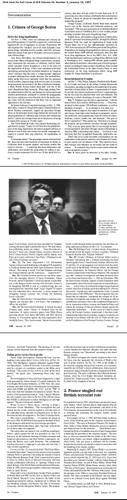

[1891/2000] b2342d10aee663a2d2a9d0c72f229256468f681cc1c8e0ac71442444339c9bfe



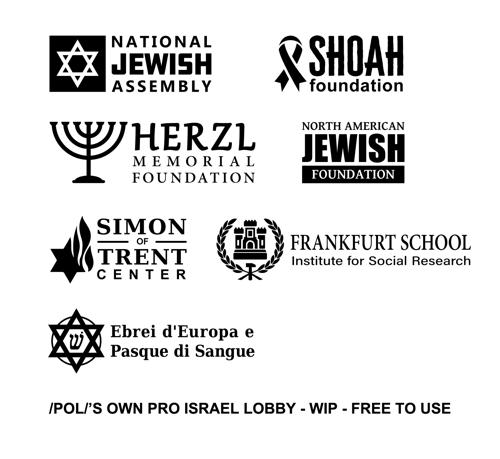

[1892/2000] bf362706a9fb985a129bfdbb8f1a8b630895545fcddf17b9937f862a9a67f43f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bf362706a9fb985a129bfdbb8f1a8b630895545fcddf17b9937f862a9a67f43f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/bf362706a9fb985a129bfdbb8f1a8b630895545fcddf17b9937f862a9a67f43f.gz'
Failed to load target image.
[1893/2000] 22137691b18c3aced3f498e54eff4b4b6c11ddd44888e1f2abd6bdb231c64cfc



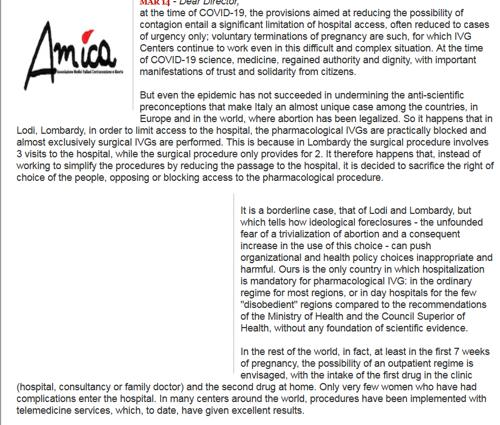

[1894/2000] a3b63757d4d7be64d4c53546c9d7a3eebeb8055c4a9902c24069c42eca77eab0
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a3b63757d4d7be64d4c53546c9d7a3eebeb8055c4a9902c24069c42eca77eab0.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/a3b63757d4d7be64d4c53546c9d7a3eebeb8055c4a9902c24069c42eca77eab0.gz'
Failed to load target image.
[1895/2000] ea8e1a8431b8154b286fd410b351c3c7f7790872acacbd0f6a50d69ce55bb6f9
[1896/2000] 7d1272b44bf4eafca851fc74807a16c769068694d384c550d108adeb949f114a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7d1272b44bf4eafca851fc74807a16c769068694d384c550d108adeb949f114a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7d1272b44bf4eafca851fc74807a16c769068694d384c550d108adeb949f114a.gz'
Failed to load target image.
[1897/2000] 3a2df31c2ea80b20d2d032192ed985f904cff3340cdf438


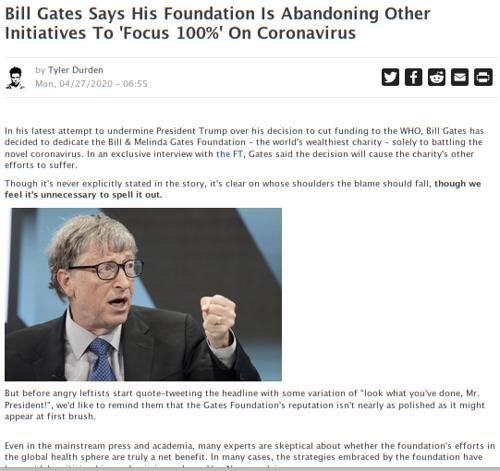

[1901/2000] 5ae075d28d6eb775f83cfa6e56ff93de29c6b699aded531767b1f29088af8def
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5ae075d28d6eb775f83cfa6e56ff93de29c6b699aded531767b1f29088af8def.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5ae075d28d6eb775f83cfa6e56ff93de29c6b699aded531767b1f29088af8def.gz'
Failed to load target image.
[1902/2000] 2e1fe24af4e3f5287c6c8602fc6c466831f7bf332dbe51bc5a08121acde90935
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2e1fe24af4e3f5287c6c8602fc6c466831f7bf332dbe51bc5a08121acde90935.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2e1fe24af4e3f5287c6c8602fc6c466831f7bf332dbe51bc5a08121acde90935.gz'
Failed to load target image.
[1903/2000] 147fca700f8bcfc565584cfbc78c14e6a0db31591ca0a8720d59aaff48a30d23
[1904/2000] aa9d8c31c80e193987b9b1c77117ffa7604f3f4a6558f71


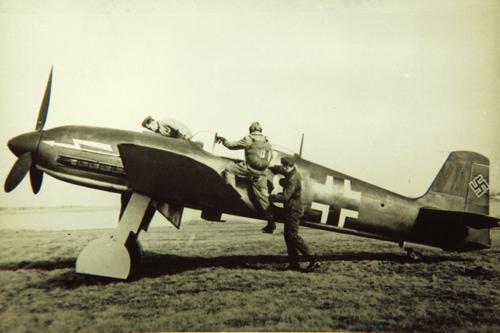

[1906/2000] 4ba59f65c96d104ab940c1f083d3f4faee454d493f098a8f0ae284b04e424a72
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4ba59f65c96d104ab940c1f083d3f4faee454d493f098a8f0ae284b04e424a72.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/4ba59f65c96d104ab940c1f083d3f4faee454d493f098a8f0ae284b04e424a72.gz'
Failed to load target image.
[1907/2000] d2f997ffd5f66d21b9fabe562c5aff476535d11bb807f290817530723b91f9e9
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d2f997ffd5f66d21b9fabe562c5aff476535d11bb807f290817530723b91f9e9.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/d2f997ffd5f66d21b9fabe562c5aff476535d11bb807f290817530723b91f9e9.gz'
Failed to load target image.
[1908/2000] 8f9b0892a61d8b72228308d1a56a2c88e92ed4889abfb8e6ab05ee50ff2e4867
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


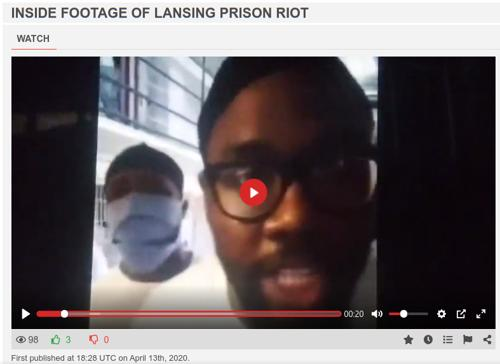

[1911/2000] 2691b99d46427c1b42f9433b281c2834495d8c900d61df425cc2514470b22763
[1912/2000] f38656762c1e70b2432c214c3efe6b21a971df5c16c043698606a15f032e06d7
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f38656762c1e70b2432c214c3efe6b21a971df5c16c043698606a15f032e06d7.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/f38656762c1e70b2432c214c3efe6b21a971df5c16c043698606a15f032e06d7.gz'
Failed to load target image.
[1913/2000] 8e6932b25e1abf20149e043e59ebcb5a0f22f4589f79248b8c2e47e7c93ee26a
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8e6932b25e1abf20149e043e59ebcb5a0f22f4589f79248b8c2e47e7c93ee26a.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8e6932b25e1abf20149e043e59ebcb5a0f22f4589f79248b8c2e47e7c93ee26a.gz'
Failed to load target image.
[1914/2000] 93235a7cbbbb5523cf6e271dab78adefd827dfc129cae32


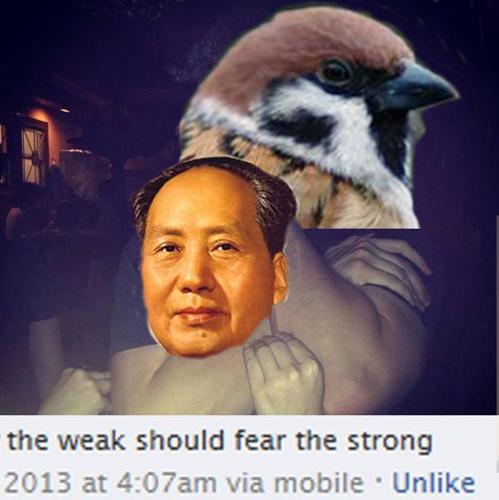

[1916/2000] 2d49b6a6d90ea4a2535bfec9c6969d6ab3883ef9d418cc61bfc4cc28f9cf4c8b



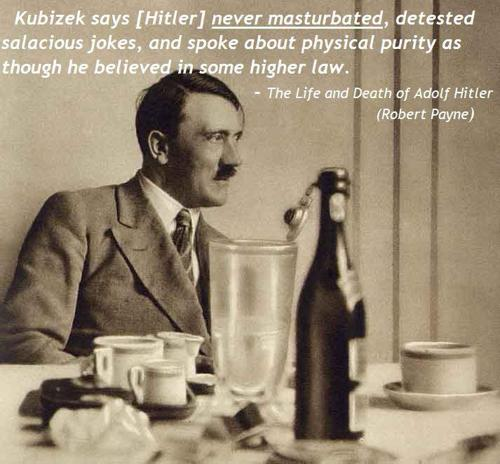

[1917/2000] 240b62d910a5915db689d3c2581cf2f190fdc5f69b21f0b1402c062a76d751aa
[1918/2000] a4812c1af9506b05174190ea61dfda875e2f7adc246d0c5799a8f750c329e22b
[1919/2000] 7a3b060e3af16e58cd32ee18078f963144d2fde239b6a1b951c7f3fc1e1c947f
[1920/2000] 4cca3fdffcbe75f33a3d543fe35644e5e25189602e6cb9a5f2495a72a2e82814
[1921/2000] 852f21994b3565fa364ac339418a74e9aae5b51bfe8daeb73466c4a7e705c266



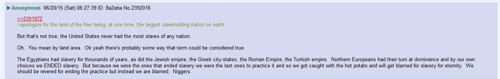

[1922/2000] 4c3b36aa9e88965982f4e89713eaa2256775ea635c65f83f1aae90842d5c4c94



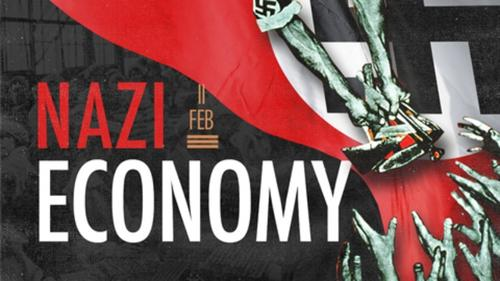

[1923/2000] 8cd419889ba91b74a7bfca95fbd9dd71f7434fd13eb1f95b4716a53c2c987291
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8cd419889ba91b74a7bfca95fbd9dd71f7434fd13eb1f95b4716a53c2c987291.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/8cd419889ba91b74a7bfca95fbd9dd71f7434fd13eb1f95b4716a53c2c987291.gz'
Failed to load target image.
[1924/2000] c30129da1c5207b7caaf6b41f3665d1baa1a32cf5eea1991bd1b73c100ec5cbe
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c30129da1c5207b7caaf6b41f3665d1baa1a32cf5eea1991bd1b73c100ec5cbe.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c30129da1c5207b7caaf6b41f3665d1baa1a32cf5eea1991bd1b73c100ec5cbe.gz'
Failed to load target image.
[1925/2000] 8cbaae8c93724585633ebbb47d3bda163b1914a94f20ca03cc9019d3a927bbdc
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


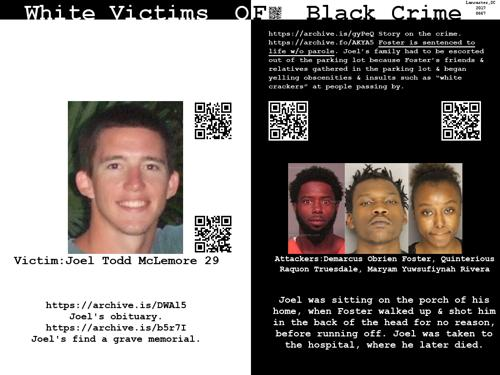

[1927/2000] c9244690b79aba4e97498f7d87d43b2b3d13149b46489bd99bd66990f511c3e6
[1928/2000] dee309455f823c892bcd3657ff8f1a18fe38c6fe6b5a3201dff3c7546423d521
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/dee309455f823c892bcd3657ff8f1a18fe38c6fe6b5a3201dff3c7546423d521.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/dee309455f823c892bcd3657ff8f1a18fe38c6fe6b5a3201dff3c7546423d521.gz'
Failed to load target image.
[1929/2000] 872cfefb0d641c1e44a54f02cbc7fab193b015ec52d02d4c15ef5e903abd2f57
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/872cfefb0d641c1e44a54f02cbc7fab193b015ec52d02d4c15ef5e903abd2f57.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/872cfefb0d641c1e44a54f02cbc7fab193b015ec52d02d4c15ef5e903abd2f57.gz'
Failed to load target image.
[1930/2000] 969160ac17ae76628a142c5ff593a4d5beec140bb585b5c


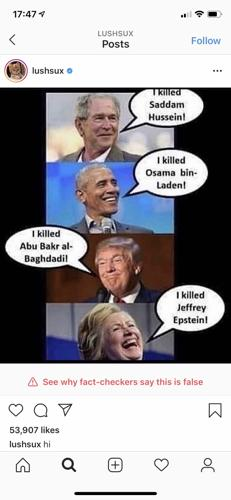

[1931/2000] b85687c40ebe0f0fe8acf2528638cecc13f7d6f713c56c6aa0f6968983257f83
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b85687c40ebe0f0fe8acf2528638cecc13f7d6f713c56c6aa0f6968983257f83.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b85687c40ebe0f0fe8acf2528638cecc13f7d6f713c56c6aa0f6968983257f83.gz'
Failed to load target image.
[1932/2000] 54a9210f010a3e99eaf42282a0a43e54d4b36947f602d5e866aaddf11585b124
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/54a9210f010a3e99eaf42282a0a43e54d4b36947f602d5e866aaddf11585b124.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/54a9210f010a3e99eaf42282a0a43e54d4b36947f602d5e866aaddf11585b124.gz'
Failed to load target image.
[1933/2000] 63c3f471826233dda841fece10a625a6c7716010be1f9fc49ba5ed2735cec960
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


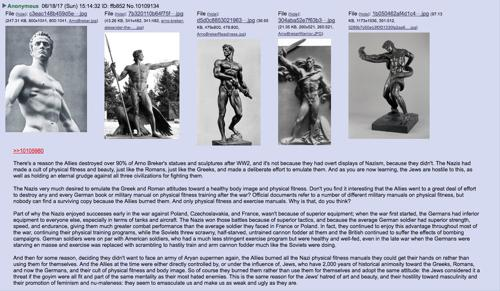

[1935/2000] 5191cccf2c6cd3b11cf78f75567899a571939d0bd654cc2812f99976839b6121
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5191cccf2c6cd3b11cf78f75567899a571939d0bd654cc2812f99976839b6121.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/5191cccf2c6cd3b11cf78f75567899a571939d0bd654cc2812f99976839b6121.gz'
Failed to load target image.
[1936/2000] 2cbd0c395a8c8720c8a47eee346fd5f0cafdf3386e2f6ed5f42d8b7228c9473c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2cbd0c395a8c8720c8a47eee346fd5f0cafdf3386e2f6ed5f42d8b7228c9473c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2cbd0c395a8c8720c8a47eee346fd5f0cafdf3386e2f6ed5f42d8b7228c9473c.gz'
Failed to load target image.
[1937/2000] d31db6cd9df6bc07822f7d21babc2b5ee366db279ffbe35970eb5b8351064915
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


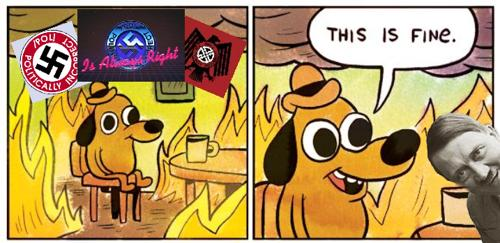

[1943/2000] c8c5a45688685ad1b9ac12f2f7bb683d674244f9921bc58eb91f7c2adddbffe0
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c8c5a45688685ad1b9ac12f2f7bb683d674244f9921bc58eb91f7c2adddbffe0.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c8c5a45688685ad1b9ac12f2f7bb683d674244f9921bc58eb91f7c2adddbffe0.gz'
Failed to load target image.
[1944/2000] 25b5973714d01f3747a1842d1c692110680204cf218cccb266af18d2c23ae3f2
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/25b5973714d01f3747a1842d1c692110680204cf218cccb266af18d2c23ae3f2.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/25b5973714d01f3747a1842d1c692110680204cf218cccb266af18d2c23ae3f2.gz'
Failed to load target image.
[1945/2000] 05a04ef11a1de6b2ac4a71e4a5d66c3478d8480b220427e884b47900f61d52d5
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


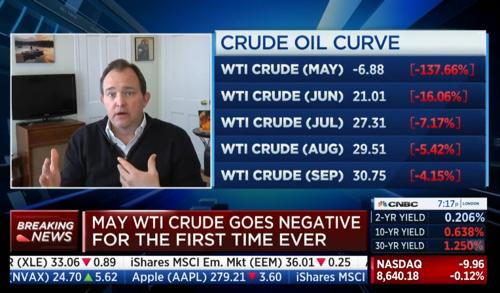

[1947/2000] e5b3ba6903547baf3a4f16d4a63e9af77e0dac03186fd0b2aeba219141633246
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e5b3ba6903547baf3a4f16d4a63e9af77e0dac03186fd0b2aeba219141633246.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/e5b3ba6903547baf3a4f16d4a63e9af77e0dac03186fd0b2aeba219141633246.gz'
Failed to load target image.
[1948/2000] e42aea93c7f9c7fbab763f838cdd92c87cf90fe191f0bf7030d2bf2c003b3af5



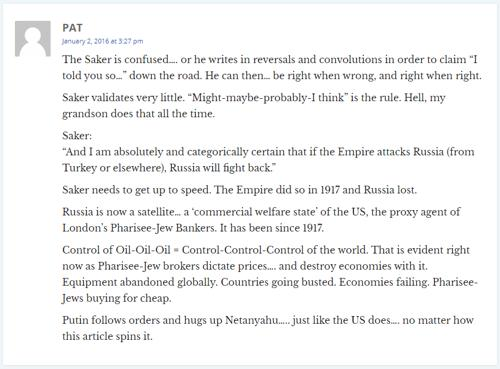

[1949/2000] 98c6903b7827a72666313a815a93146dda9ff93489ad6193e1e469155aab6e28



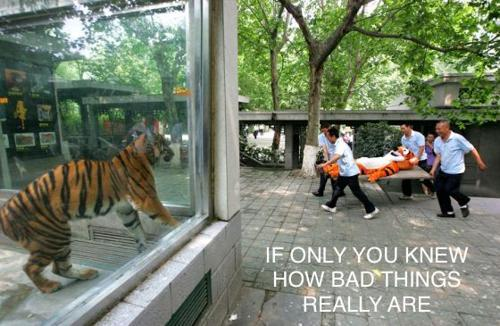

[1950/2000] eb1733987030ac302cc9887342e82568a0e7c8eb52794665c257e54660497c3c
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/eb1733987030ac302cc9887342e82568a0e7c8eb52794665c257e54660497c3c.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/eb1733987030ac302cc9887342e82568a0e7c8eb52794665c257e54660497c3c.gz'
Failed to load target image.
[1951/2000] 2d8e165360c421573b5613bc474a6ff340d1f19a61b437bb371bee8caca0d5ae
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2d8e165360c421573b5613bc474a6ff340d1f19a61b437bb371bee8caca0d5ae.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/2d8e165360c421573b5613bc474a6ff340d1f19a61b437bb371bee8caca0d5ae.gz'
Failed to load target image.
[1952/2000] 11693c3755a58611c83ce3eb0264d5adc732e36922f63acbf4a71288239d0512



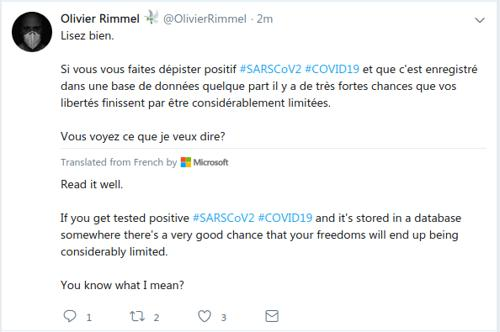

[1953/2000] 1d199ec2caa681a2d55d12c0c84ed7638e3e5d78add50fc044f220b26300ce43



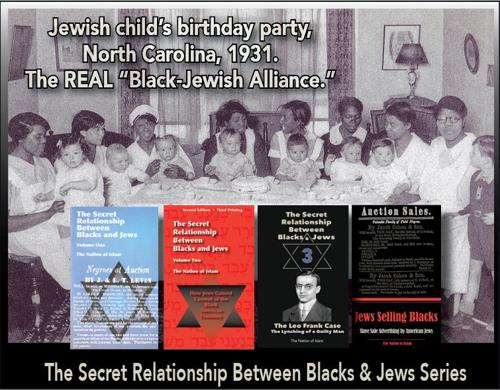

[1954/2000] c56cac856176e1496e32f2e58760cd2ca6035f5c4ca321b64b633811c74b6efd
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c56cac856176e1496e32f2e58760cd2ca6035f5c4ca321b64b633811c74b6efd.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/c56cac856176e1496e32f2e58760cd2ca6035f5c4ca321b64b633811c74b6efd.gz'
Failed to load target image.
[1955/2000] 7863fed99bd646b221996ea64242b803d7539f1707e164d9e2a33f9141ef2dc8
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7863fed99bd646b221996ea64242b803d7539f1707e164d9e2a33f9141ef2dc8.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/7863fed99bd646b221996ea64242b803d7539f1707e164d9e2a33f9141ef2dc8.gz'
Failed to load target image.
[1956/2000] 21d9edd06b3c9c5995936a428a2089e362532d25f2baff252e7aab17565888d1
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-meme


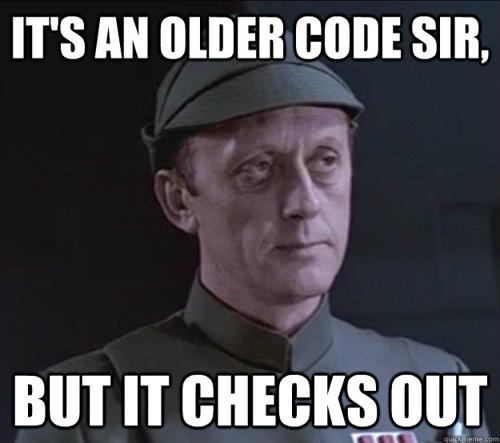

[1975/2000] d308d3219de51b7925d14b8f9da4b734061448192617a3a3715a26b9fd7698e3



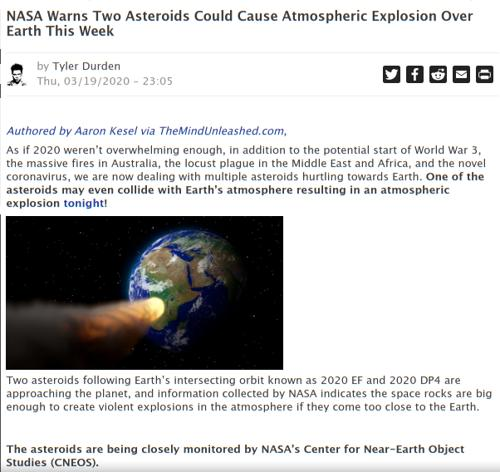

[1976/2000] 810e70ea04e5800a3366707b508ed84cf46ccce2b214c668b9c317b339b02fde
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/810e70ea04e5800a3366707b508ed84cf46ccce2b214c668b9c317b339b02fde.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/810e70ea04e5800a3366707b508ed84cf46ccce2b214c668b9c317b339b02fde.gz'
Failed to load target image.
[1977/2000] 73a224c962955eb2ff71a0c044d6548536662a0cf88ceb6f75eb9b13ff686e9f
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/73a224c962955eb2ff71a0c044d6548536662a0cf88ceb6f75eb9b13ff686e9f.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/73a224c962955eb2ff71a0c044d6548536662a0cf88ceb6f75eb9b13ff686e9f.gz'
Failed to load target image.
[1978/2000] 44fd2fefc9bac7dbbb629549e5f30a292b02ad4fc61050afa24610c51d3f4d0d



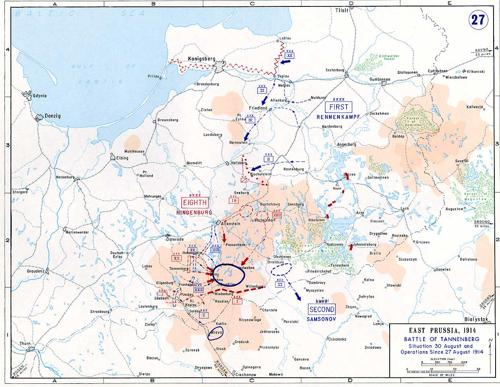

[1979/2000] eaaa475d7819a4aa1f5832152614be2bc357cd2a21d200bb0d60036d07386150
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/eaaa475d7819a4aa1f5832152614be2bc357cd2a21d200bb0d60036d07386150.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/eaaa475d7819a4aa1f5832152614be2bc357cd2a21d200bb0d60036d07386150.gz'
Failed to load target image.
[1980/2000] b61890712922d0cf06d3571c3948247cf2bbee4b3078def6a9a6acce65b21001
[Image error: /home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b61890712922d0cf06d3571c3948247cf2bbee4b3078def6a9a6acce65b21001.gz]
[Errno 2] No such file or directory: '/home/xiang_fang1/Desktop/meme/icwsm2021-memes-images/output/images/b61890712922d0cf06d3571c3948247cf2bbee4b3078def6a9a6acce65b21001.gz'
Failed to load target image.
[1981/2000] 07d4840c3231ad92668b4c51d0ca972eb7d8ee9c113ab0a118eb91beb5ab33ae
[1982/2000] e8518c2119a9ff556d1075557d92b6d2f6e60aeb4c6b633

In [81]:
# Load unlabeled CSV
unlabeled_df = pd.read_csv("unlabeled_2000.csv")

# Result columns
unlabeled_df["radical_prob"] = None
unlabeled_df["reason"] = None

# Iterate and classify
for i, row in unlabeled_df.iterrows():
    print(f"[{i+1}/{len(unlabeled_df)}] {row['sha256_hash']}")
    result = classify_with_explanation(few_shot_df, row["img_path"])
    
    if result:
        unlabeled_df.loc[i, "is_radical"] = result.get("is_radical")
        unlabeled_df.loc[i, "reason"] = result.get("reason")
        unlabeled_df.loc[i, "radical_prob"] = result.get("radical_prob")

        if result["is_radical"] == "radical":
            display_classified_result(row['sha256_hash'], row['img_path'], result['reason'], result["radical_prob"])
    
    # if i == 29: # first try 30 images
    #     break

# Save the updated DataFrame
unlabeled_df.to_csv("unlabeled_2000_labeled.csv", index=False)
print("Saved to unlabeled_2000_labeled.csv")

In [64]:
metadata_hash['sha256']['475a60e0bd9b497d4482adef0647c31edea8a58a8a3e4c8ae6148c07fcf920b1']

{'sha256': '475a60e0bd9b497d4482adef0647c31edea8a58a8a3e4c8ae6148c07fcf920b1',
 'md5': 'e1746b55d6253ec913422f645f1c31b2',
 'pHash': 'f717120199ccfc2d',
 'ftype': 'JPEG image data, JFIF standard 1.01, aspect ratio, density 1x1, segment length 16, baseline, precision 8, 2000x3008, frames 3',
 'path': 'output/images/475a60e0bd9b497d4482adef0647c31edea8a58a8a3e4c8ae6148c07fcf920b1.gz'}